Import the libraries

In [1]:
import torch, pdb
from torch.utils.data import DataLoader
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

visualization function

In [2]:
def view(tensor,ch = 1 , size = (28,28) , num = 16):
  data = tensor.detach().cpu().view(-1,ch,*size)
  grid = make_grid(data[:num], nrow = 4).permute(1,2,0)
  plt.imshow(grid)
  plt.show()

setup of the main parameters and hyperparameters

In [5]:
n_epochs = 200
info_step = 108
cur_step = 0
mean_gen_loss = 0
mean_disc_loss = 0
bs = 128
lr = 0.0001
z_dim = 64
loss = nn.BCEWithLogitsLoss()
device = 'cuda'
data = DataLoader(MNIST('.', download = True , transform= transforms.ToTensor()), batch_size = bs , shuffle = True)

##declare our models




Generator

In [4]:
def genBlock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.BatchNorm1d(out),
      nn.ReLU(True)
  )

class Generator(nn.Module):
  def __init__(self,z_dim = 64 , h_dim  = 128 , target = 784):
    super().__init__()
    self.gen = nn.Sequential(
        genBlock(z_dim,  h_dim),
        genBlock(h_dim, h_dim * 2),
        genBlock(h_dim * 2 , h_dim * 4),
        genBlock(h_dim * 4 , h_dim * 8),
        genBlock(h_dim * 8 , h_dim * 4),
        nn.Linear(h_dim * 4 , target),
        nn.Sigmoid()
    )

  def forward(self,noise):
    return self.gen(noise)

Noise Gen function

In [6]:
def genNoise(num , z_dim):
  return torch.randn(num , z_dim).to(device)

Discriminator

In [8]:
def discBlock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.LeakyReLU(0.2)
  )

class Discriminator(nn.Module):

  def __init__(self,h_dim = 256, i_dim  = 784):
    super().__init__()
    self.disc = nn.Sequential(
        discBlock(i_dim , h_dim * 4),
        discBlock(h_dim * 4 , h_dim * 8),
        discBlock(h_dim * 8 ,h_dim * 4),
        discBlock(h_dim *4 , 1)
    )

  def forward(self,image):
    return self.disc(image)

define our models

In [16]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters() , lr = lr)
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters() , lr = lr)

viewing smaple

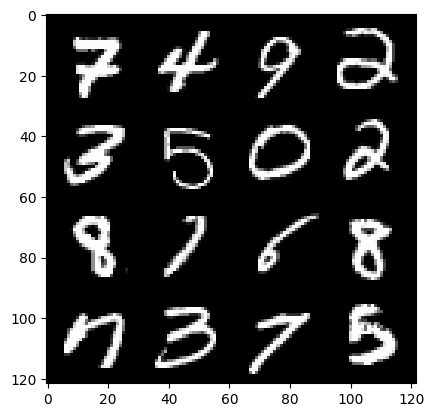

In [19]:
x,y = next(iter(data))
view(x)

##calculating the loss

Generator loss

In [10]:
def calc_gen_loss(loss_func,gen,disc,num,z_dim):
  noise = genNoise(num ,z_dim)
  fake = gen(noise)
  fake_disc_pred = disc(fake)
  fake_disc_target = torch.ones_like(fake_disc_pred)
  gen_loss = loss_func(fake_disc_pred,fake_disc_target)
  return gen_loss

Discriminator loss

In [15]:
def calc_disc_loss(loss_func,gen,disc,real,num,z_dim):
  noise = genNoise(num,z_dim)
  fake = gen(noise)
  fake_pred = disc(fake.detach())
  fake_target = torch.zeros_like(fake_pred)
  fake_loss = loss_func(fake_pred,fake_target)

  real_pred = disc(real)
  real_target = torch.ones_like(real_pred)
  real_loss = loss_func(real_pred,real_target)

  disc_loss = (fake_loss + real_loss)/2
  return disc_loss

# **Training our model**

 60000 / 128 = 468.75  = 469 steps in each epoch

 Each step is going to process 128 images = size of the batch (except the last step)


  0%|          | 0/469 [00:00<?, ?it/s]

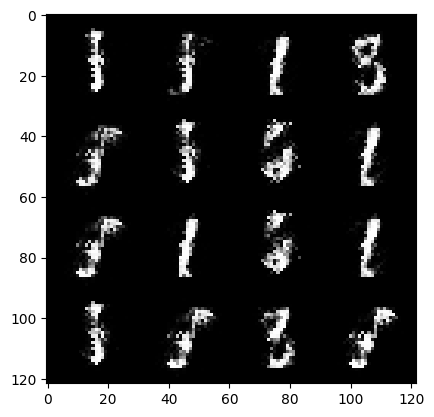

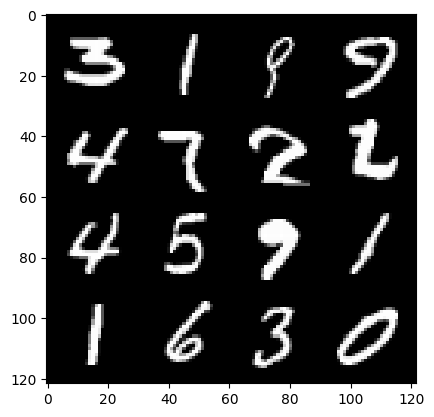

Epoch :0 , Step :5832 , Generator Loss :320.3322955254042 , Discriminator Loss :2.757013748898959


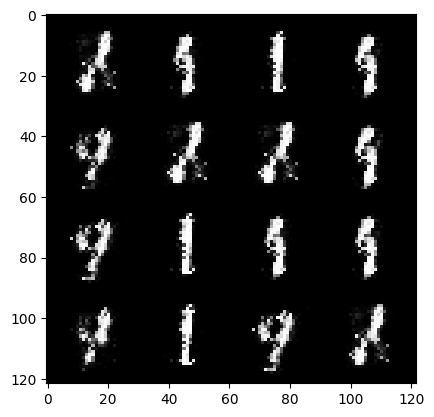

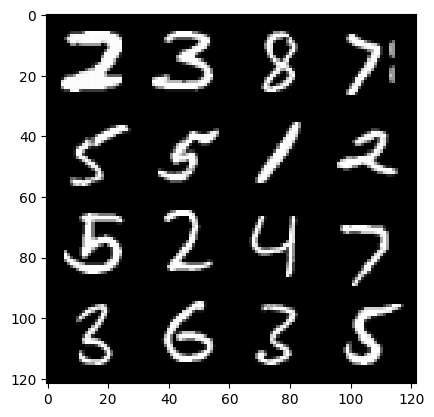

Epoch :0 , Step :5940 , Generator Loss :4.0117944589367625 , Discriminator Loss :0.12121366283476903


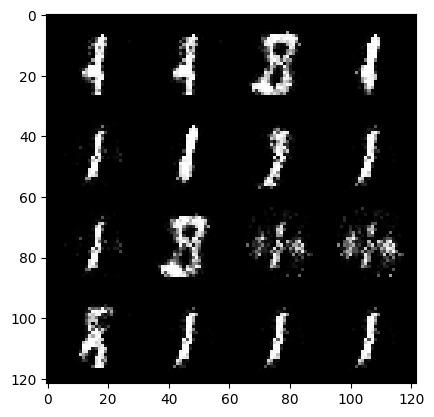

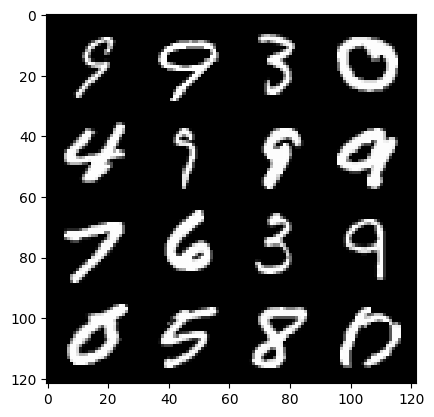

Epoch :0 , Step :6048 , Generator Loss :4.377524623164423 , Discriminator Loss :0.10270685811216633


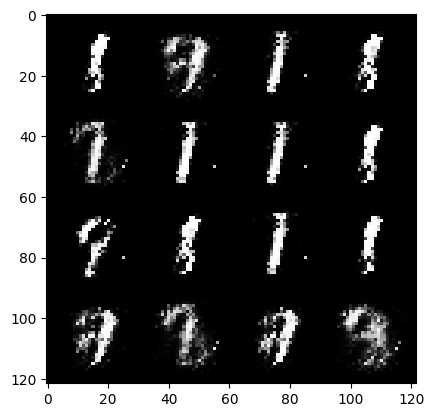

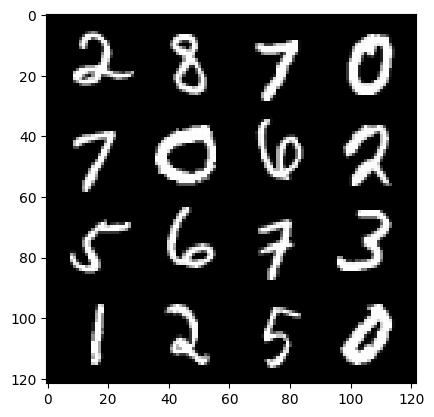

Epoch :0 , Step :6156 , Generator Loss :3.9295699441874476 , Discriminator Loss :0.11321211844268773


  0%|          | 0/469 [00:00<?, ?it/s]

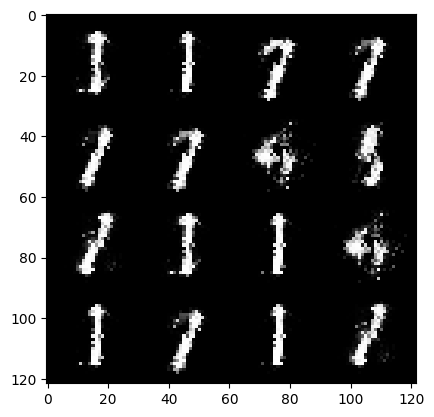

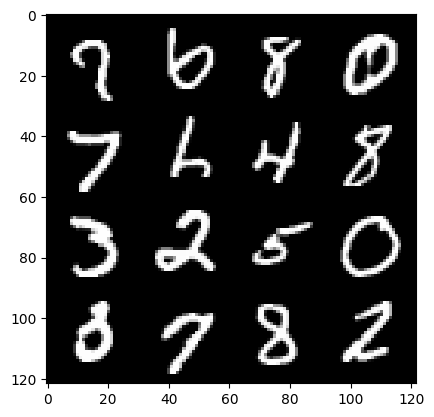

Epoch :1 , Step :6264 , Generator Loss :3.959479596879747 , Discriminator Loss :0.11141365700987753


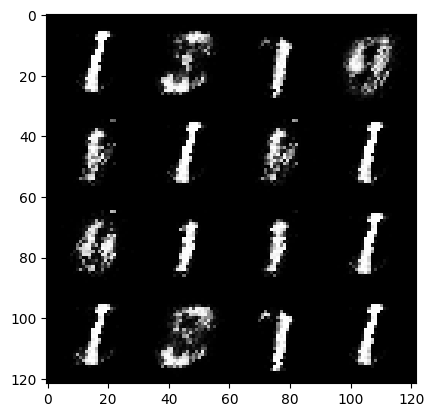

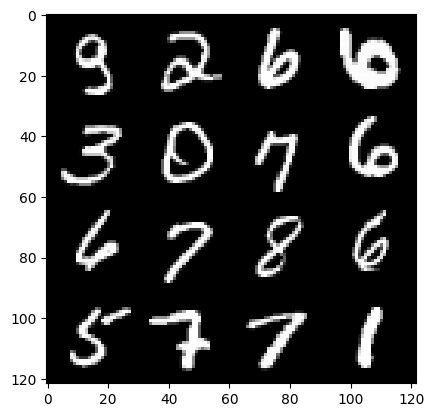

Epoch :1 , Step :6372 , Generator Loss :3.684135783601691 , Discriminator Loss :0.10619334421224065


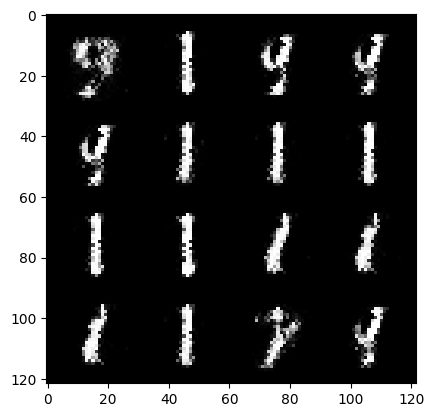

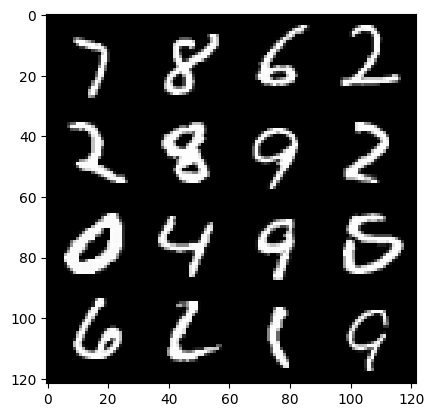

Epoch :1 , Step :6480 , Generator Loss :3.752113189962175 , Discriminator Loss :0.09903609514650369


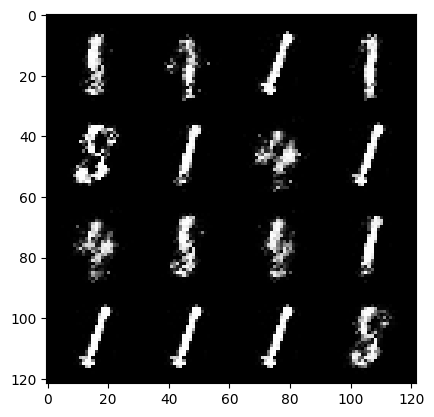

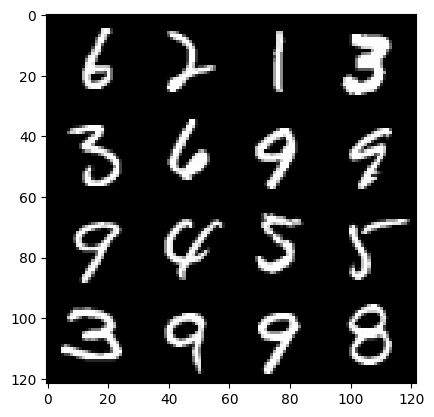

Epoch :1 , Step :6588 , Generator Loss :3.984575434967323 , Discriminator Loss :0.10755292557317904


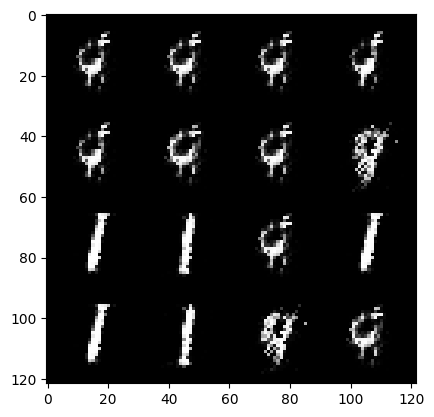

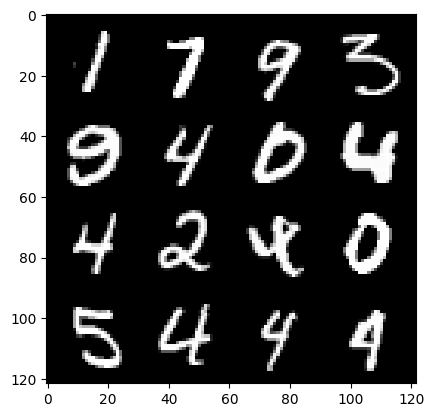

Epoch :1 , Step :6696 , Generator Loss :3.870484215241893 , Discriminator Loss :0.10804153178577067


  0%|          | 0/469 [00:00<?, ?it/s]

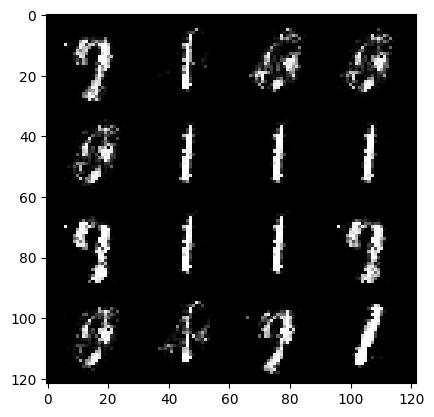

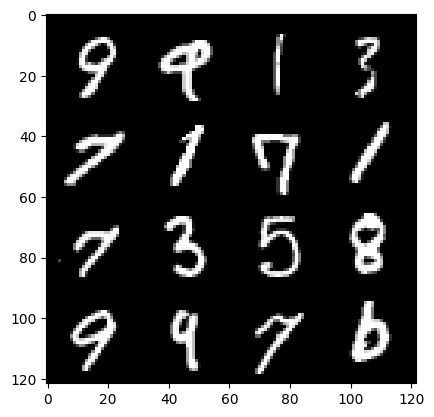

Epoch :2 , Step :6804 , Generator Loss :4.058246533075968 , Discriminator Loss :0.10255516241132112


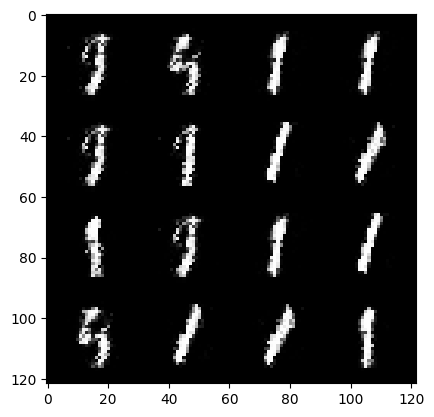

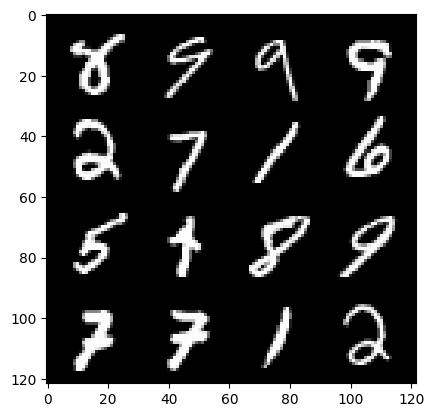

Epoch :2 , Step :6912 , Generator Loss :3.3959401581022477 , Discriminator Loss :0.12560287042072524


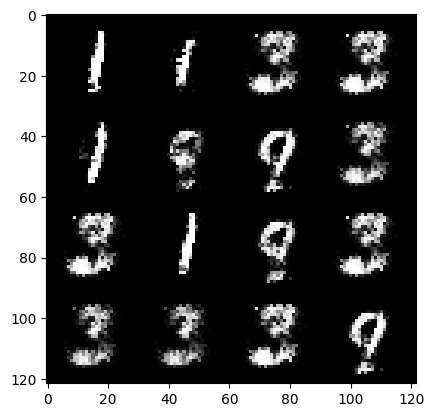

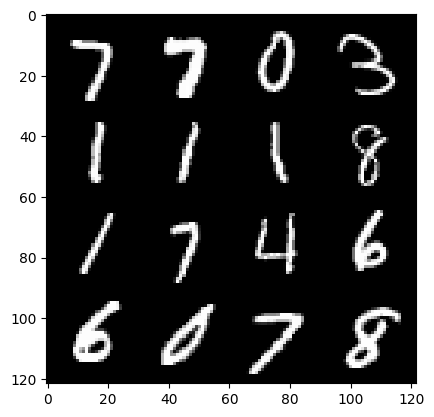

Epoch :2 , Step :7020 , Generator Loss :3.491489286775943 , Discriminator Loss :0.11339295000113819


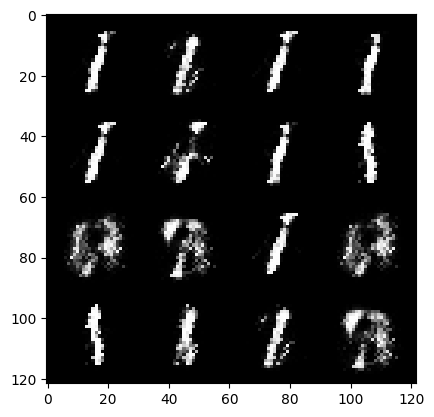

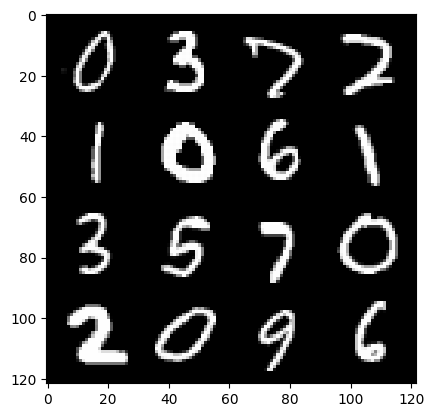

Epoch :2 , Step :7128 , Generator Loss :3.5898812369064075 , Discriminator Loss :0.13662361322591704


  0%|          | 0/469 [00:00<?, ?it/s]

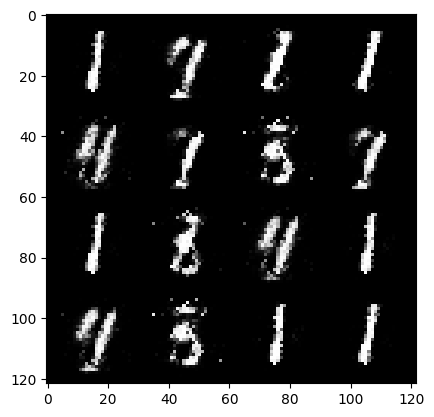

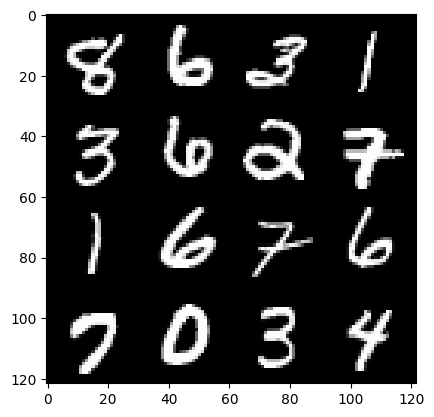

Epoch :3 , Step :7236 , Generator Loss :3.6303673541104344 , Discriminator Loss :0.12460354049862532


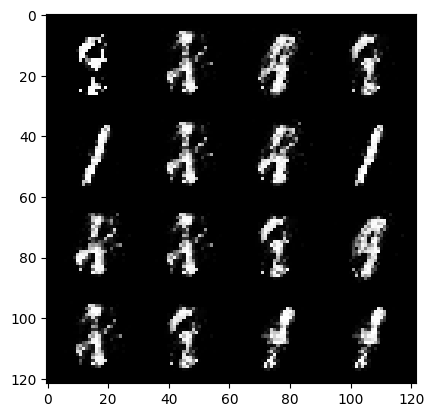

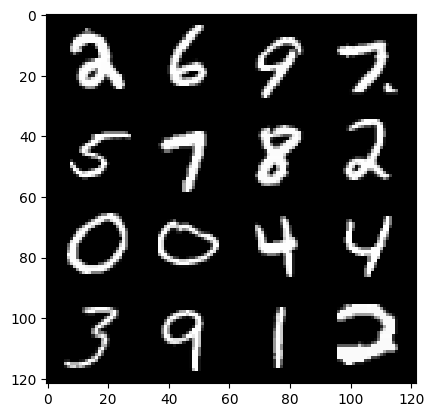

Epoch :3 , Step :7344 , Generator Loss :3.504491713311935 , Discriminator Loss :0.11112716100696064


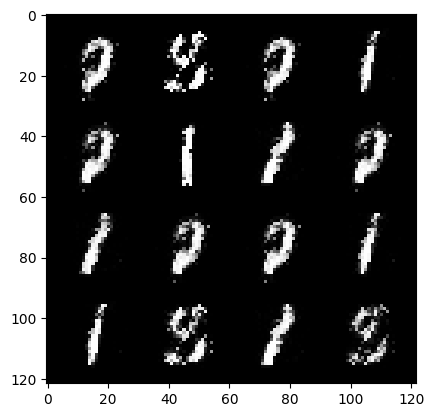

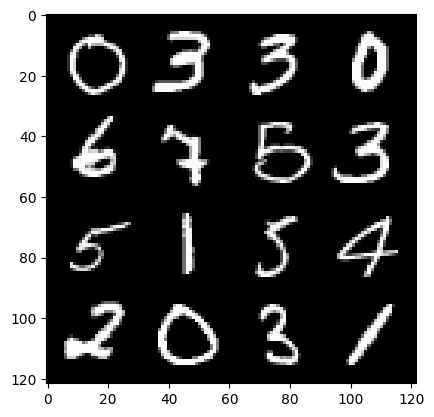

Epoch :3 , Step :7452 , Generator Loss :3.531364014855137 , Discriminator Loss :0.11185364152684259


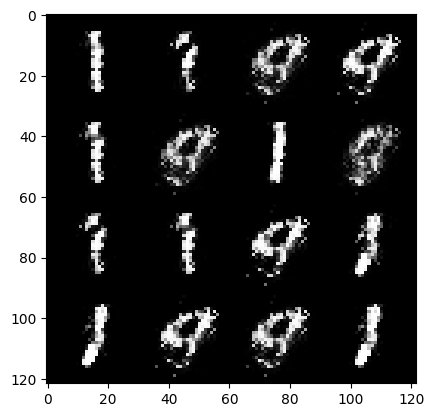

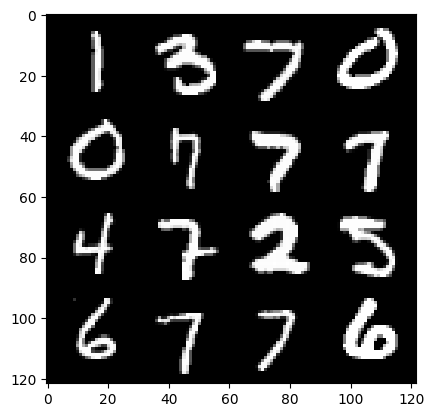

Epoch :3 , Step :7560 , Generator Loss :3.5922746040202935 , Discriminator Loss :0.11919723889204084


  0%|          | 0/469 [00:00<?, ?it/s]

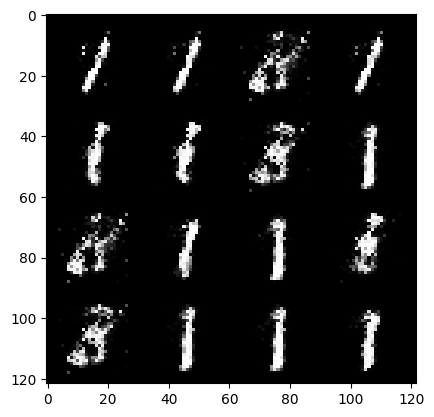

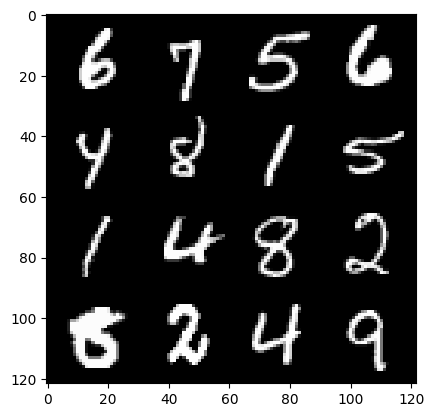

Epoch :4 , Step :7668 , Generator Loss :3.977927649462665 , Discriminator Loss :0.09242854029354125


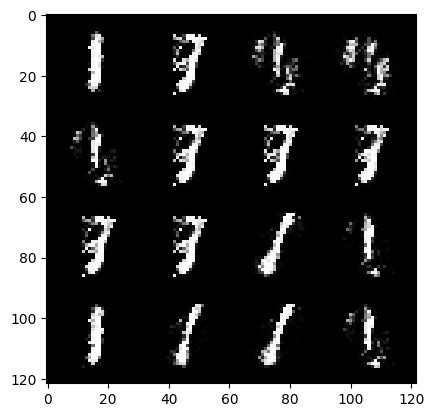

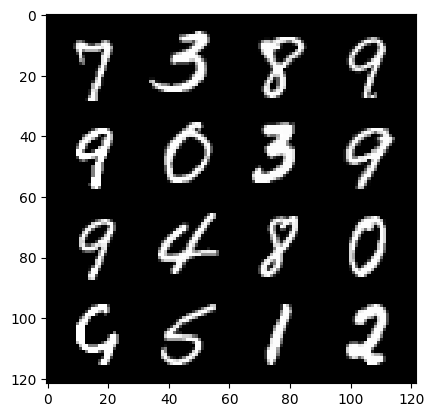

Epoch :4 , Step :7776 , Generator Loss :3.9392741410820573 , Discriminator Loss :0.10668131940204792


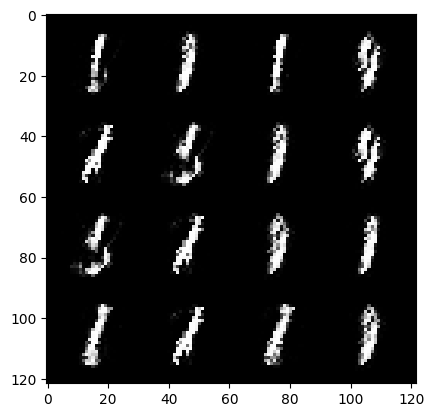

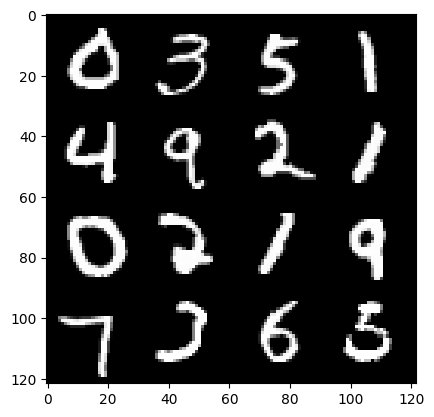

Epoch :4 , Step :7884 , Generator Loss :3.94501350985633 , Discriminator Loss :0.10753796473835357


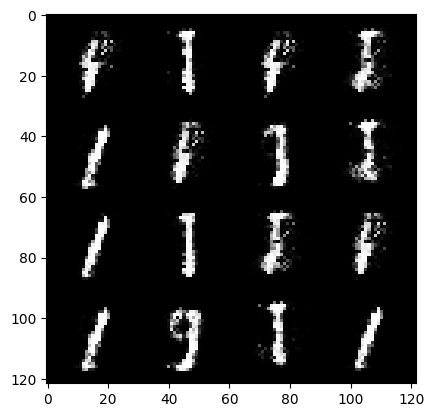

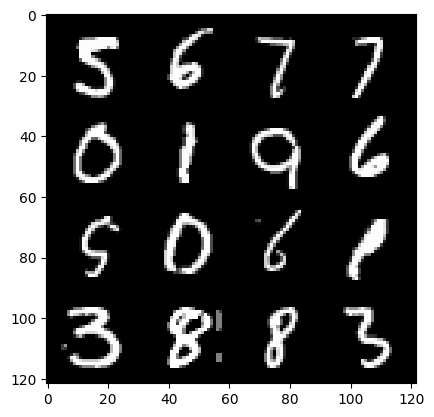

Epoch :4 , Step :7992 , Generator Loss :3.3401049022321345 , Discriminator Loss :0.12500708733029942


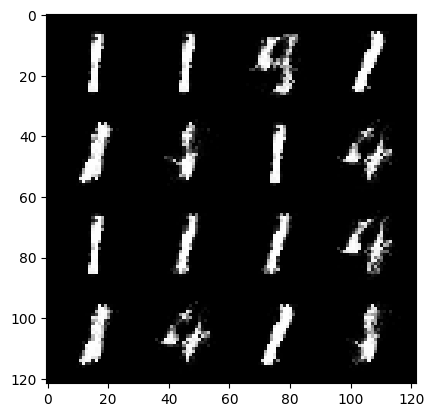

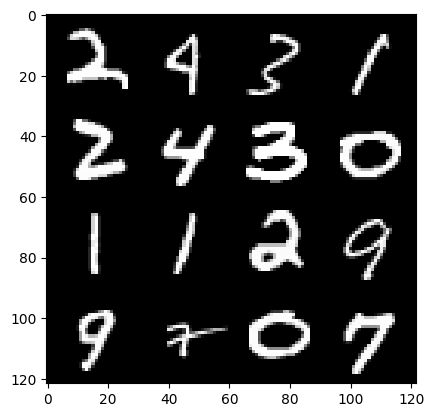

Epoch :4 , Step :8100 , Generator Loss :3.6235827980218107 , Discriminator Loss :0.1251222500232635


  0%|          | 0/469 [00:00<?, ?it/s]

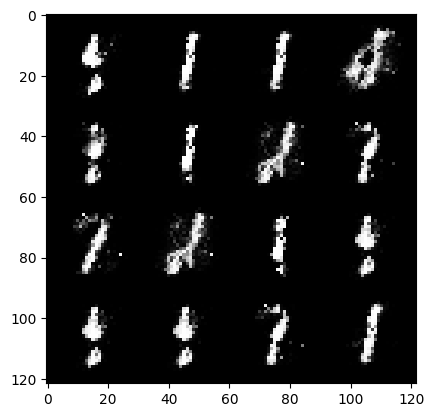

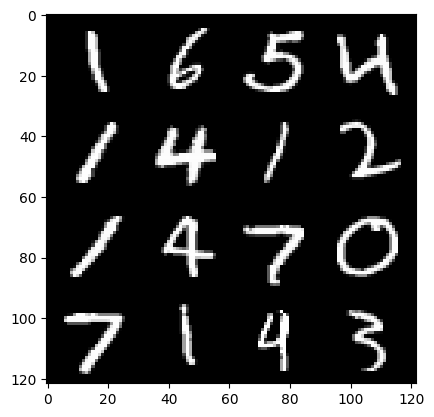

Epoch :5 , Step :8208 , Generator Loss :3.365540418359968 , Discriminator Loss :0.09520427441155467


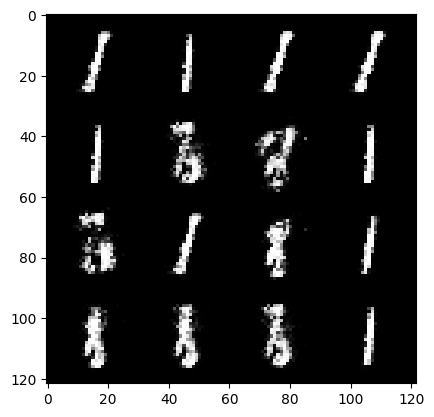

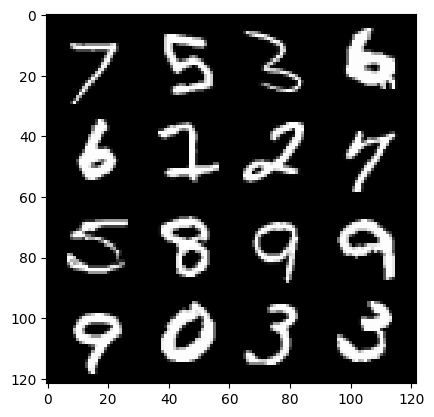

Epoch :5 , Step :8316 , Generator Loss :4.1520664912682985 , Discriminator Loss :0.1567080489670237


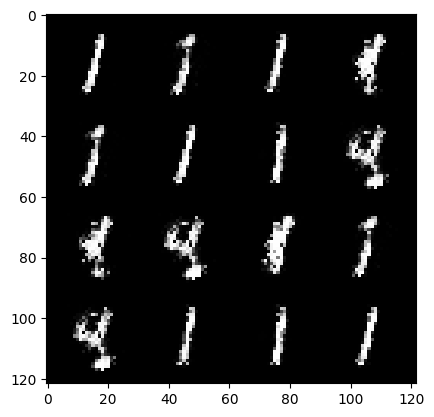

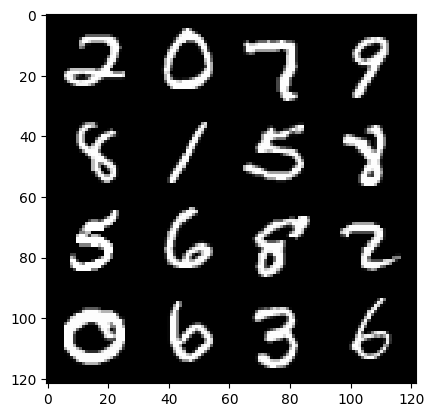

Epoch :5 , Step :8424 , Generator Loss :3.1652544229118926 , Discriminator Loss :0.13498405808651895


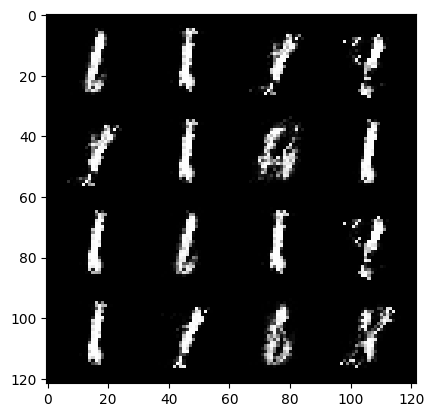

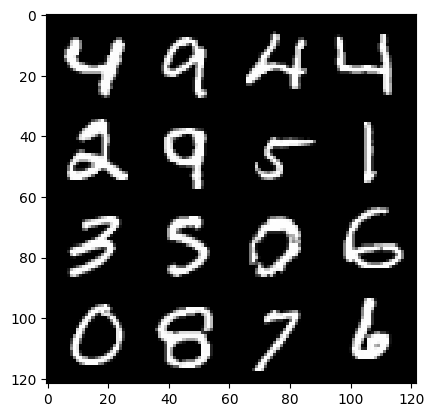

Epoch :5 , Step :8532 , Generator Loss :3.4148754256742957 , Discriminator Loss :0.10719491955306795


  0%|          | 0/469 [00:00<?, ?it/s]

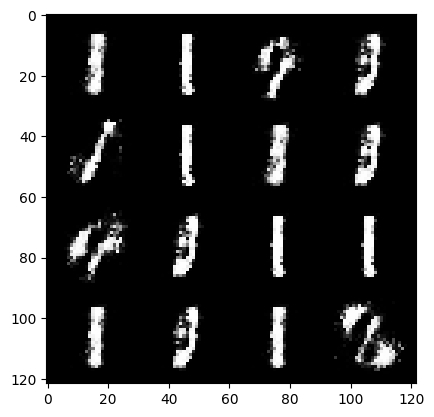

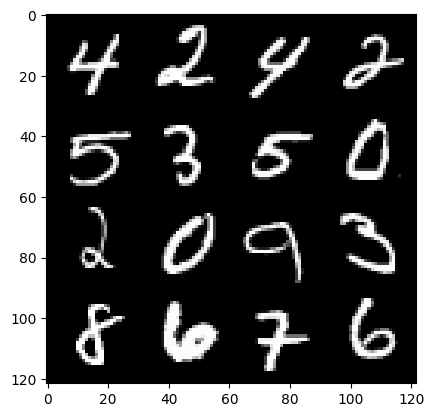

Epoch :6 , Step :8640 , Generator Loss :3.5058124308232905 , Discriminator Loss :0.148698934112434


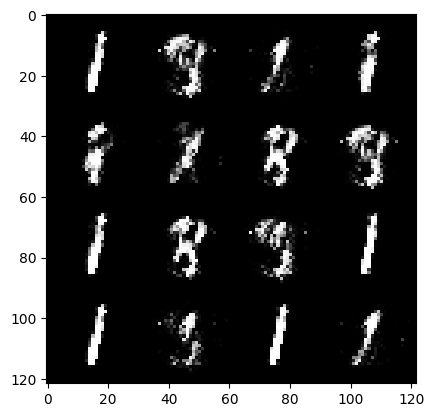

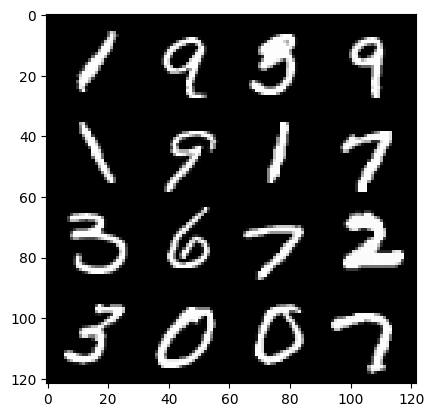

Epoch :6 , Step :8748 , Generator Loss :2.981266397017019 , Discriminator Loss :0.16054774186125512


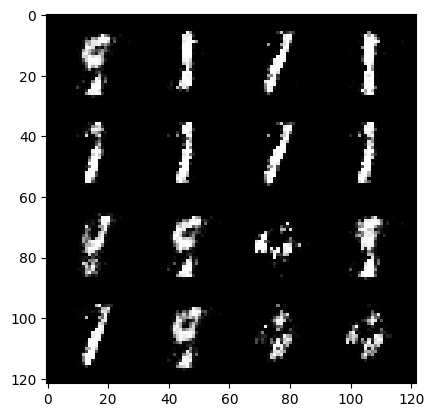

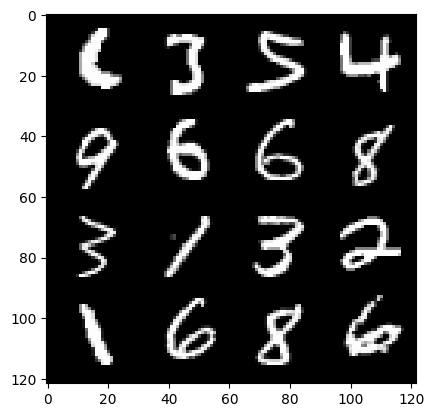

Epoch :6 , Step :8856 , Generator Loss :3.3648486402299658 , Discriminator Loss :0.13062485886944664


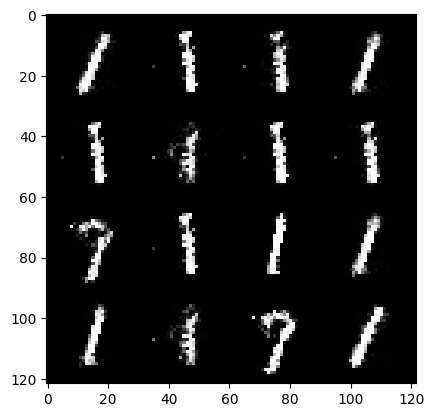

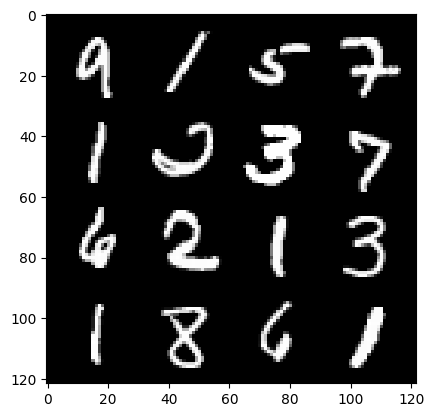

Epoch :6 , Step :8964 , Generator Loss :2.9080936842494545 , Discriminator Loss :0.1546506067668951


  0%|          | 0/469 [00:00<?, ?it/s]

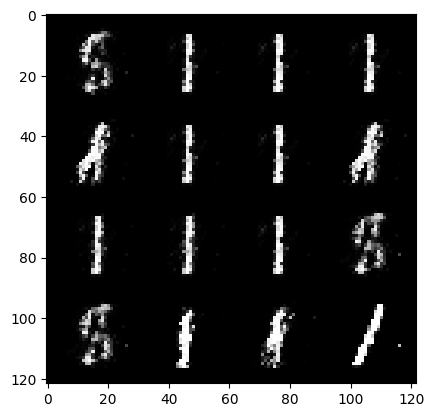

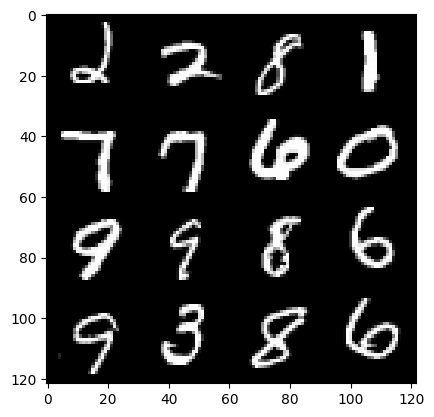

Epoch :7 , Step :9072 , Generator Loss :3.1840361158053083 , Discriminator Loss :0.12333801575005053


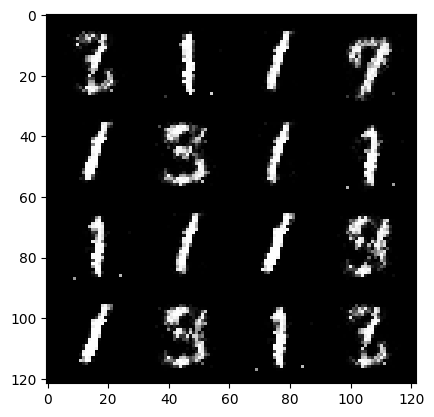

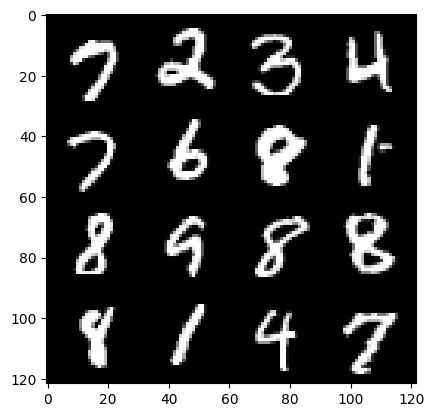

Epoch :7 , Step :9180 , Generator Loss :3.309544494858493 , Discriminator Loss :0.15800754677642267


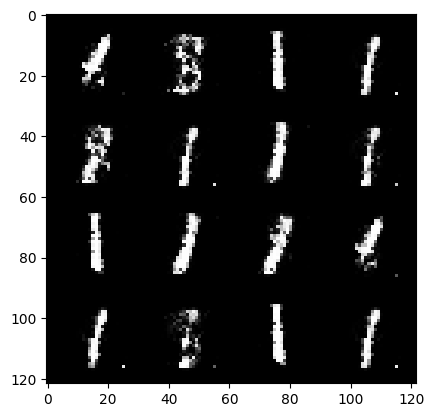

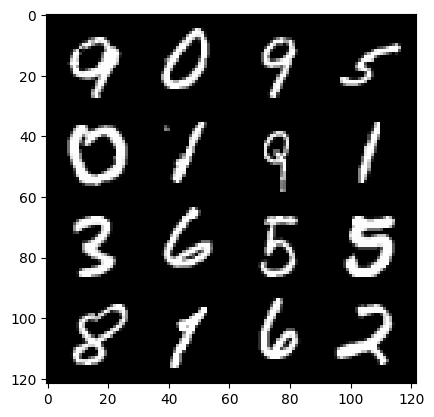

Epoch :7 , Step :9288 , Generator Loss :3.1587962243292083 , Discriminator Loss :0.11709717319657402


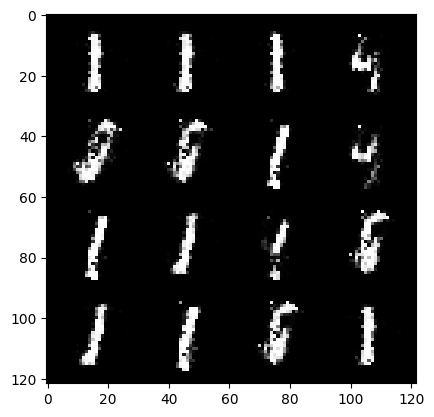

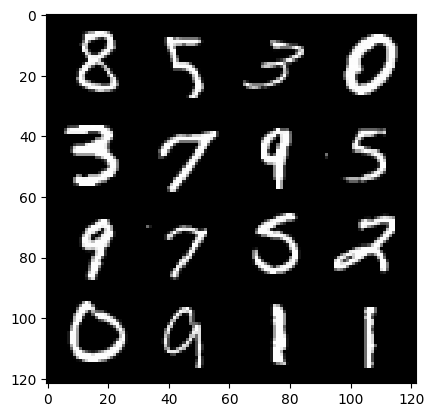

Epoch :7 , Step :9396 , Generator Loss :3.0533316687301344 , Discriminator Loss :0.12371598922268107


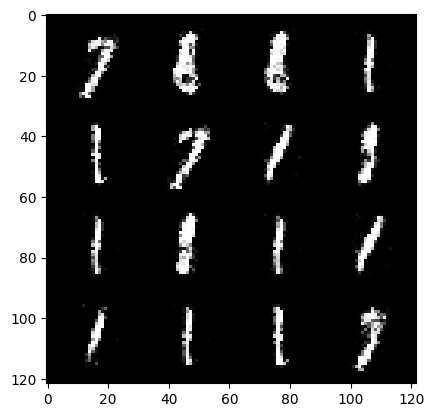

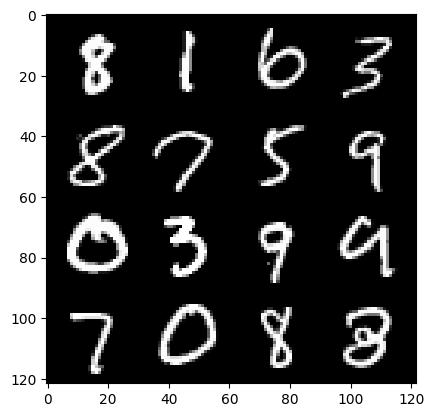

Epoch :7 , Step :9504 , Generator Loss :3.1356580456097927 , Discriminator Loss :0.1557389939962714


  0%|          | 0/469 [00:00<?, ?it/s]

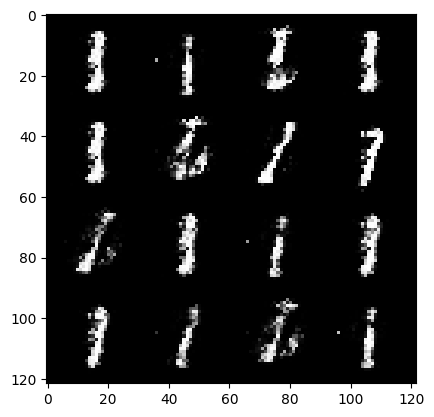

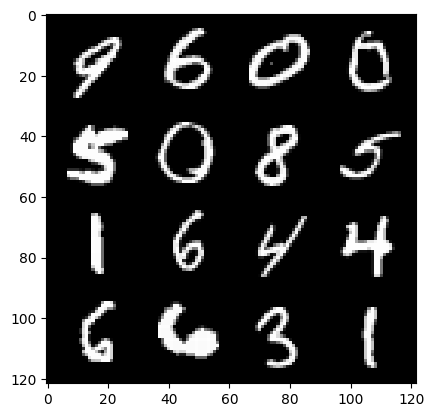

Epoch :8 , Step :9612 , Generator Loss :2.783082911261806 , Discriminator Loss :0.17312019007901347


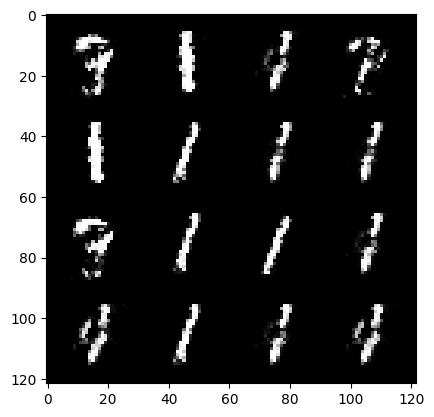

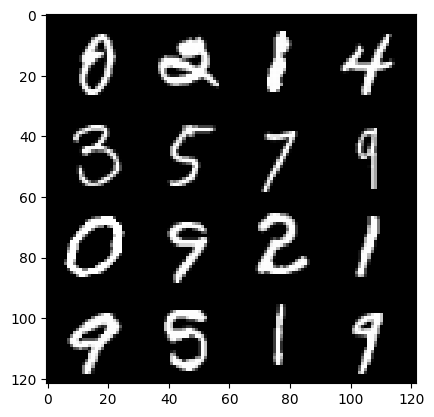

Epoch :8 , Step :9720 , Generator Loss :3.2113656202952066 , Discriminator Loss :0.12814783015184927


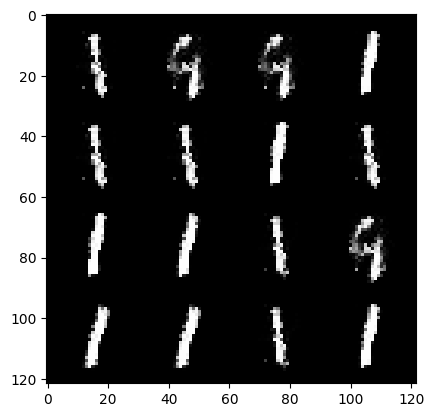

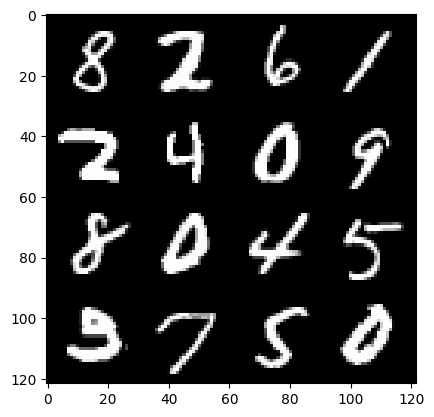

Epoch :8 , Step :9828 , Generator Loss :3.4818565116988283 , Discriminator Loss :0.1256704895446698


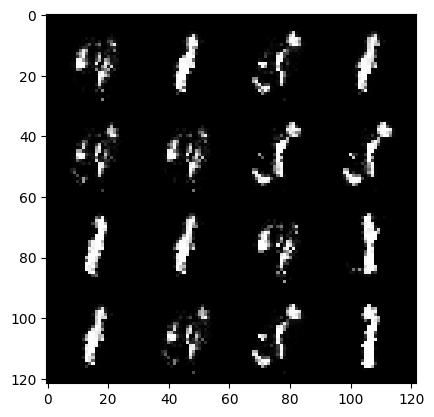

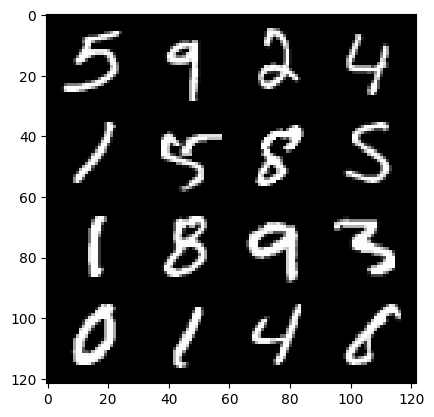

Epoch :8 , Step :9936 , Generator Loss :3.4015244620817673 , Discriminator Loss :0.11293070839235073


  0%|          | 0/469 [00:00<?, ?it/s]

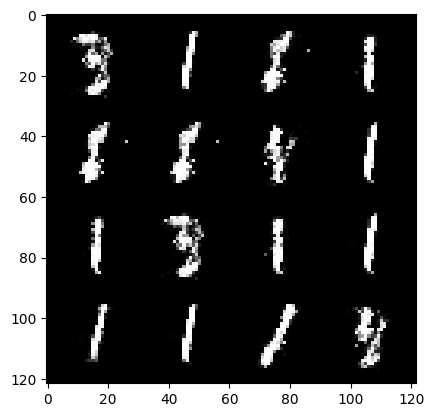

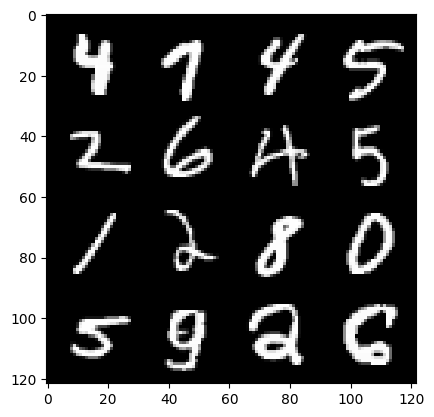

Epoch :9 , Step :10044 , Generator Loss :3.388043781121573 , Discriminator Loss :0.13515213587217867


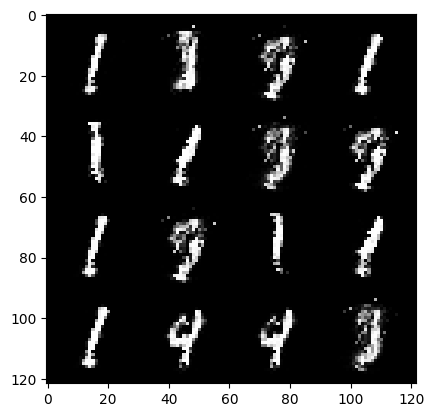

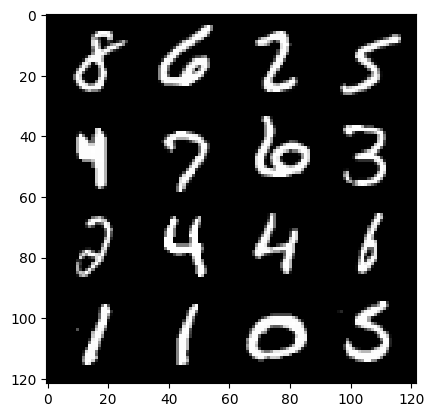

Epoch :9 , Step :10152 , Generator Loss :2.9907924047222845 , Discriminator Loss :0.13741996435931436


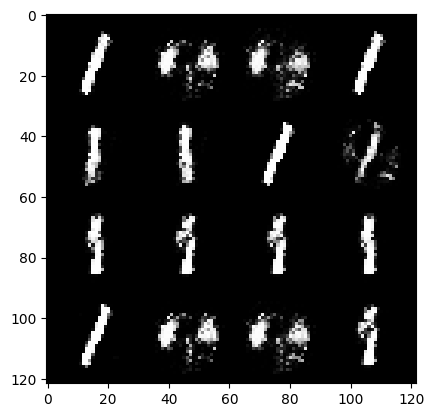

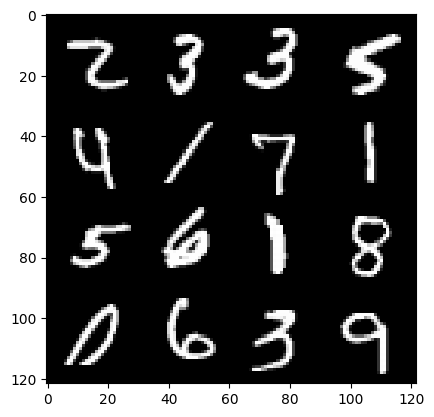

Epoch :9 , Step :10260 , Generator Loss :3.141823110757049 , Discriminator Loss :0.14560759991959285


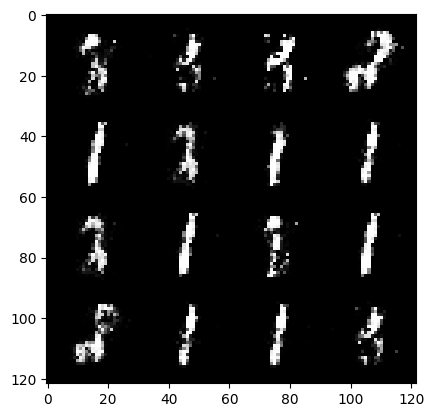

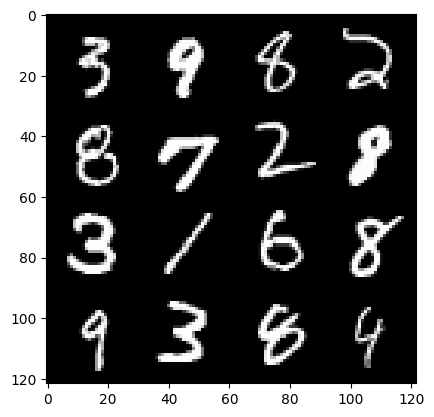

Epoch :9 , Step :10368 , Generator Loss :3.0443739405384775 , Discriminator Loss :0.16569162132563414


  0%|          | 0/469 [00:00<?, ?it/s]

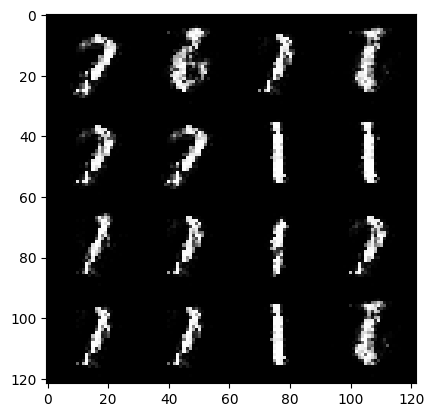

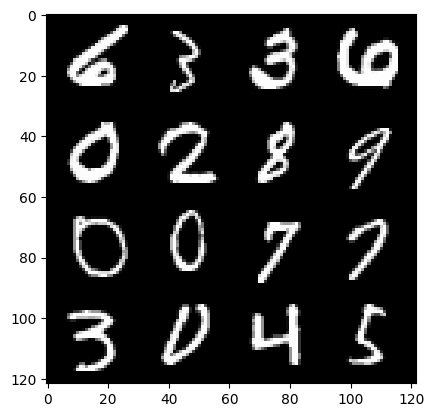

Epoch :10 , Step :10476 , Generator Loss :3.006064194220082 , Discriminator Loss :0.15537977577359588


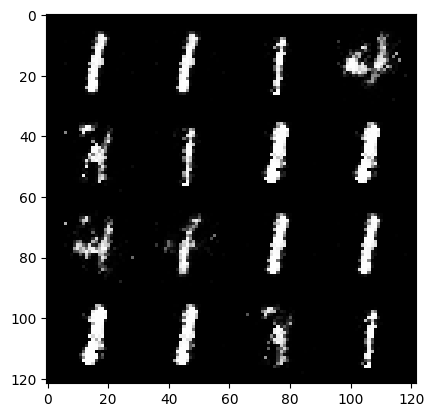

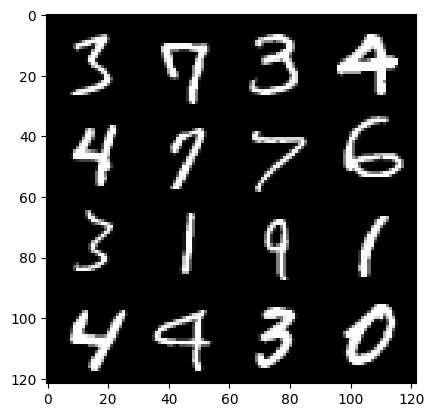

Epoch :10 , Step :10584 , Generator Loss :3.0295514839666855 , Discriminator Loss :0.12470028652913039


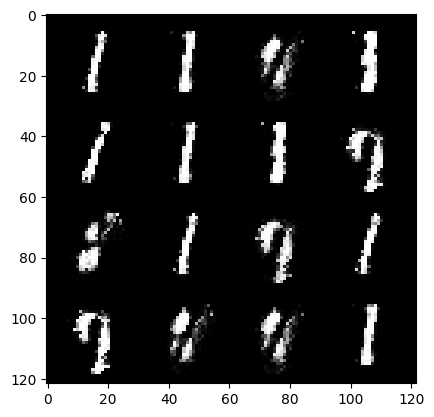

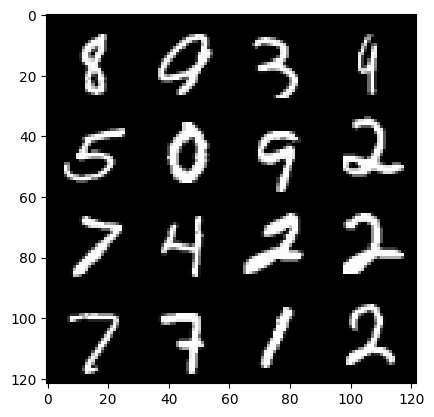

Epoch :10 , Step :10692 , Generator Loss :3.111179751378518 , Discriminator Loss :0.17943811471815455


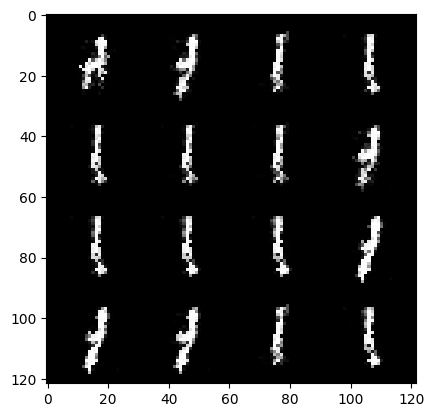

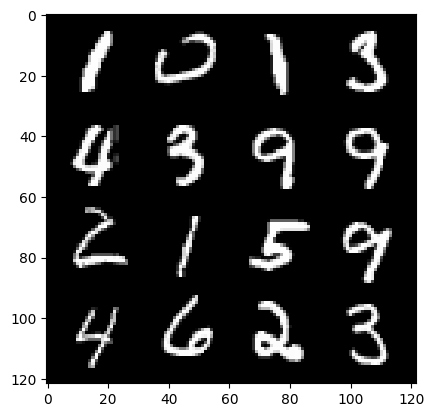

Epoch :10 , Step :10800 , Generator Loss :2.777324833251811 , Discriminator Loss :0.15310396823204228


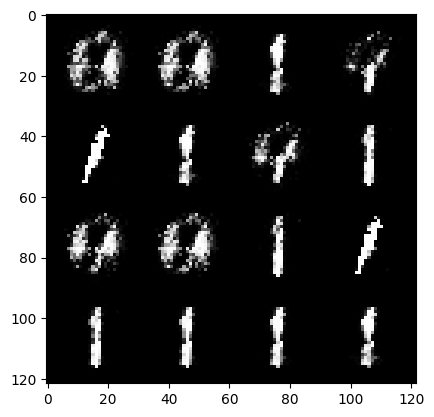

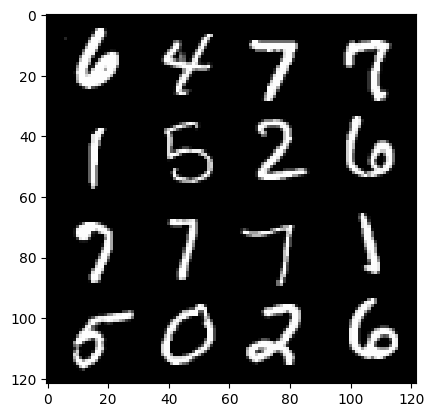

Epoch :10 , Step :10908 , Generator Loss :3.4902217542683625 , Discriminator Loss :0.14212118754922243


  0%|          | 0/469 [00:00<?, ?it/s]

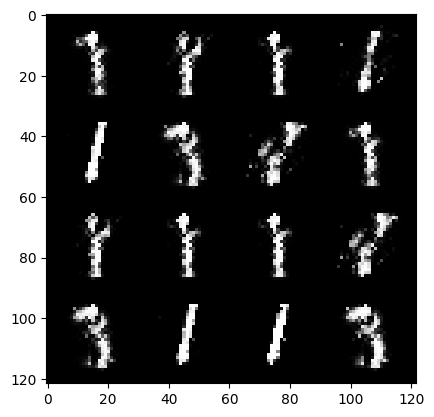

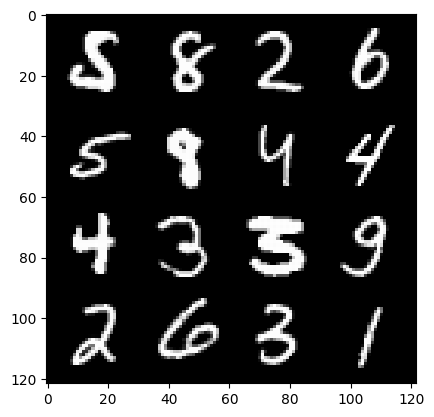

Epoch :11 , Step :11016 , Generator Loss :2.9272041850619837 , Discriminator Loss :0.14829054495526686


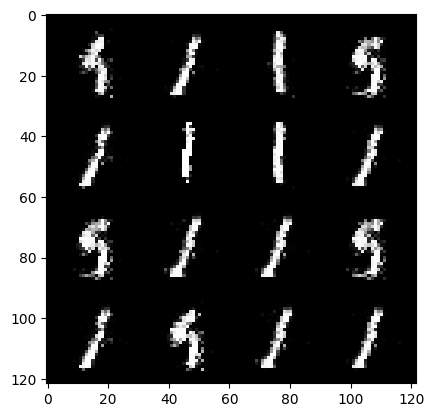

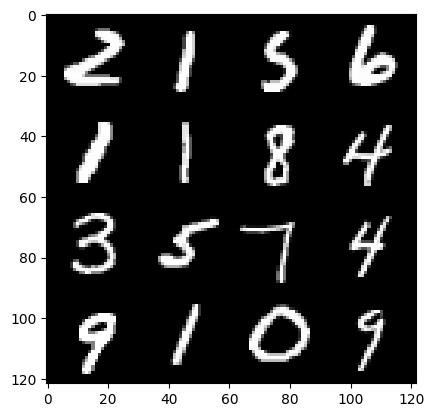

Epoch :11 , Step :11124 , Generator Loss :3.018439913237537 , Discriminator Loss :0.1449787682957119


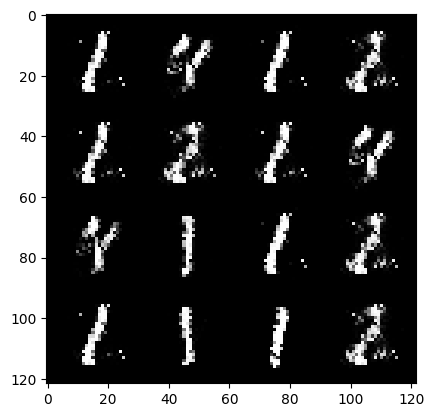

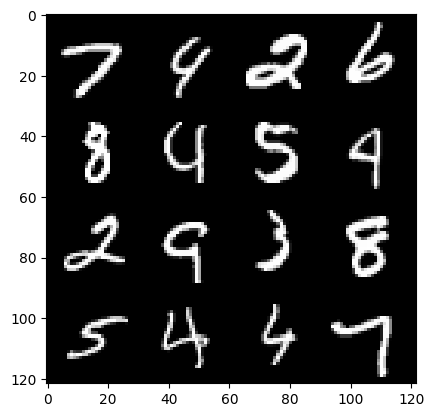

Epoch :11 , Step :11232 , Generator Loss :3.2916013046547206 , Discriminator Loss :0.1154526823234779


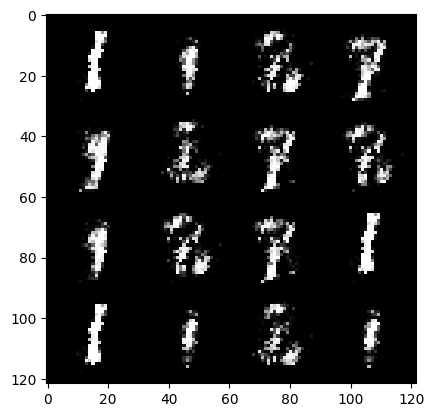

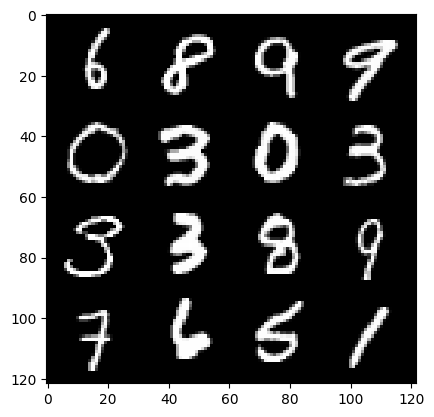

Epoch :11 , Step :11340 , Generator Loss :3.7255882598735677 , Discriminator Loss :0.08946830579252155


  0%|          | 0/469 [00:00<?, ?it/s]

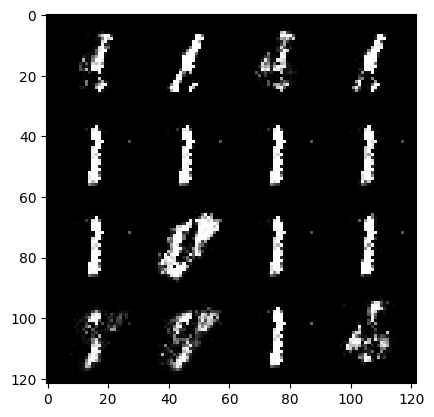

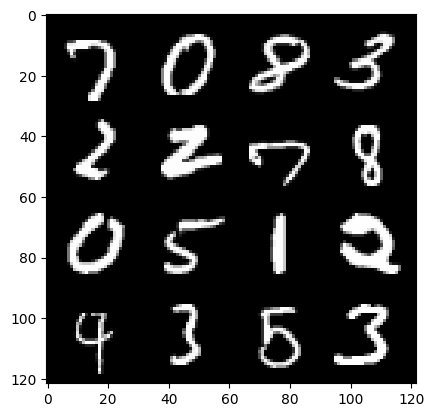

Epoch :12 , Step :11448 , Generator Loss :3.637103809250726 , Discriminator Loss :0.13248445790399008


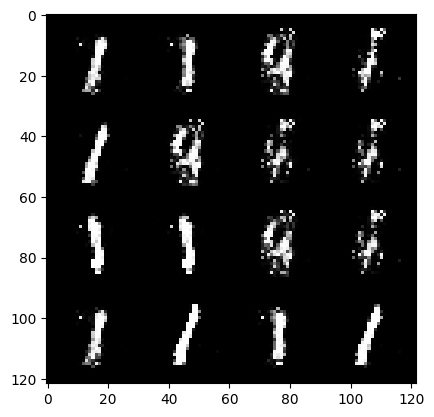

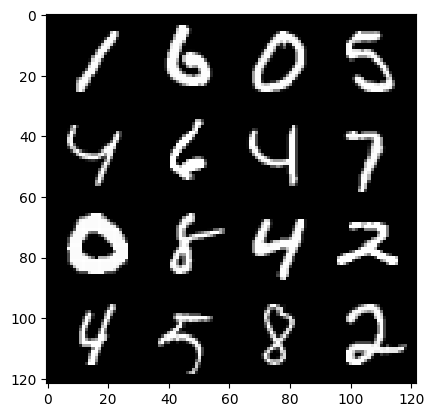

Epoch :12 , Step :11556 , Generator Loss :3.569832071110053 , Discriminator Loss :0.08950214110383836


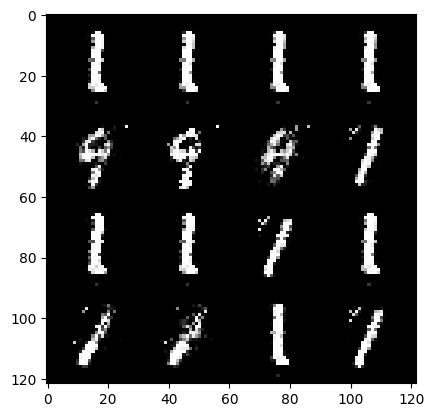

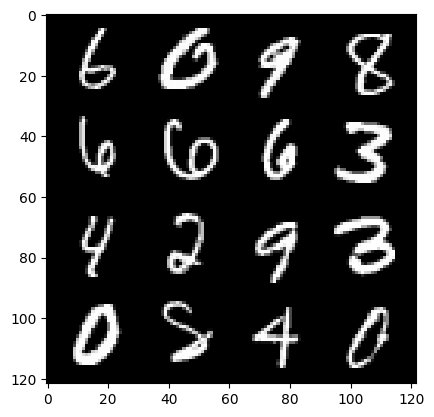

Epoch :12 , Step :11664 , Generator Loss :3.214661037480389 , Discriminator Loss :0.1355588555129039


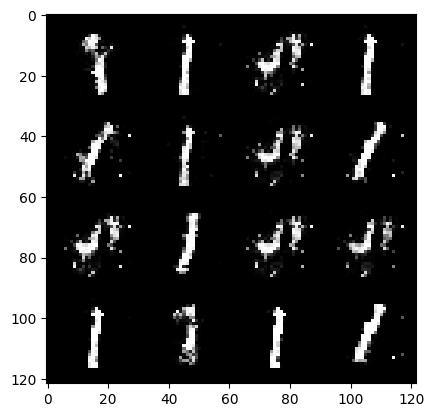

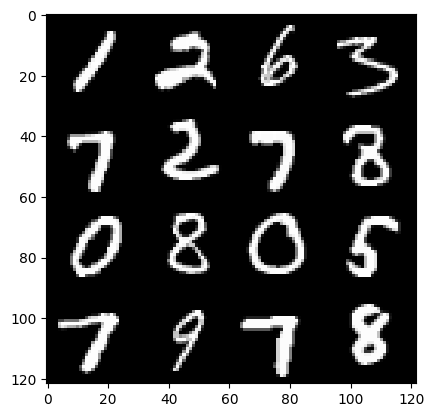

Epoch :12 , Step :11772 , Generator Loss :3.2471045520570545 , Discriminator Loss :0.11046545052280031


  0%|          | 0/469 [00:00<?, ?it/s]

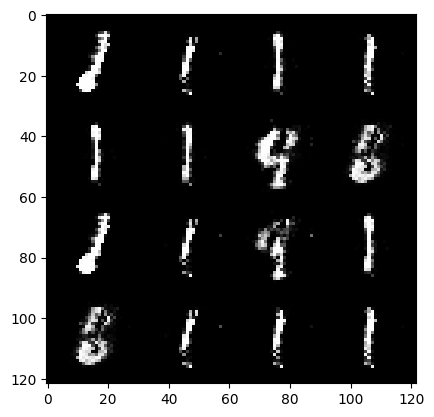

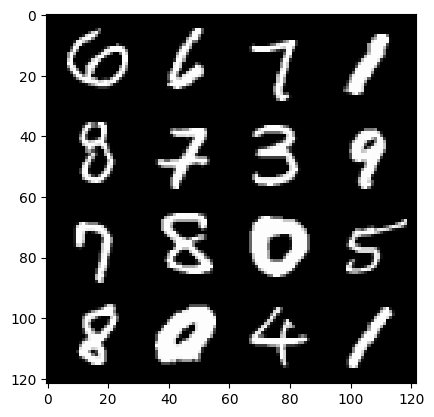

Epoch :13 , Step :11880 , Generator Loss :2.9881840767683823 , Discriminator Loss :0.16469784094779585


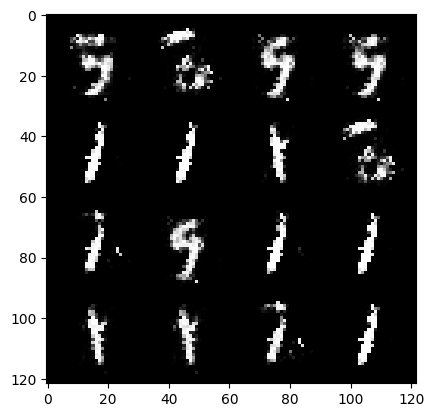

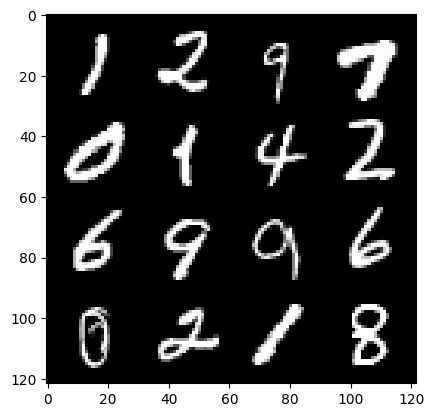

Epoch :13 , Step :11988 , Generator Loss :3.1916854293258092 , Discriminator Loss :0.2007230934169556


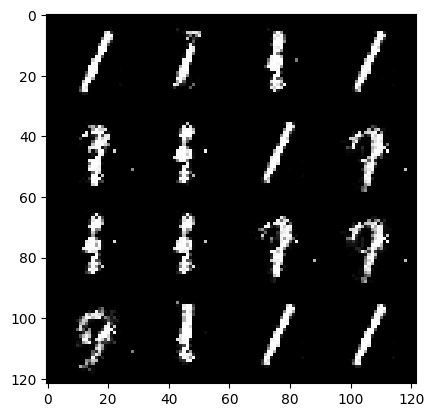

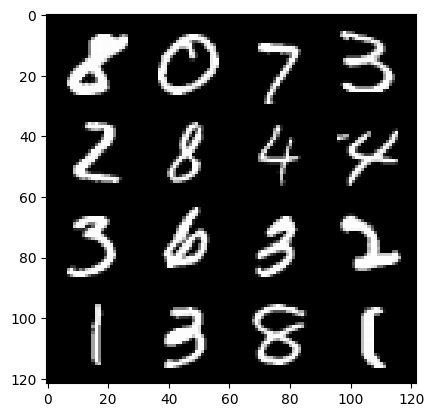

Epoch :13 , Step :12096 , Generator Loss :3.2180508088182527 , Discriminator Loss :0.11230600639073937


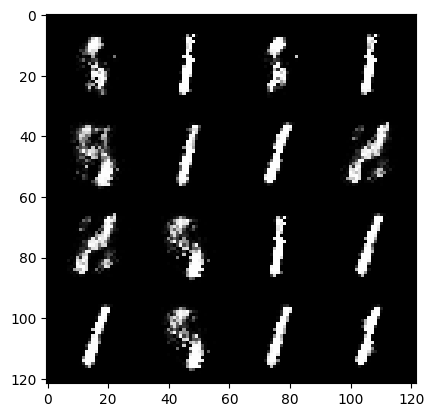

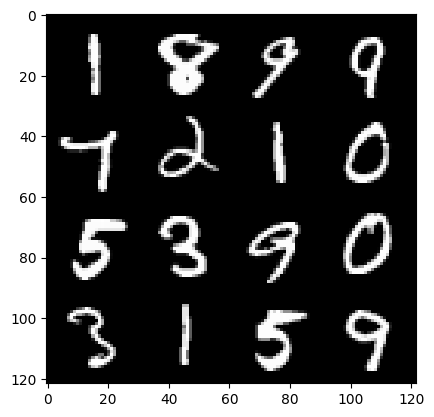

Epoch :13 , Step :12204 , Generator Loss :2.897393535684656 , Discriminator Loss :0.16168274964999269


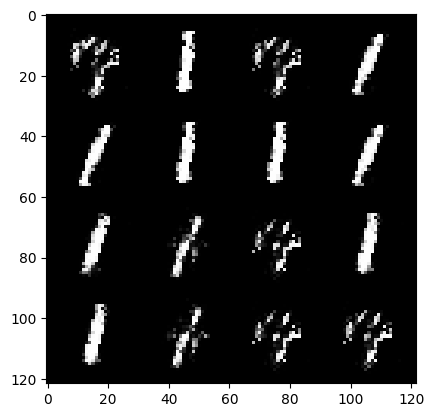

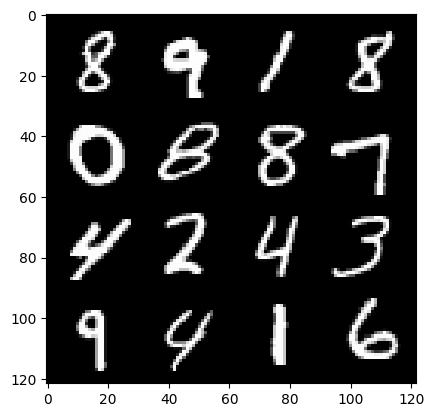

Epoch :13 , Step :12312 , Generator Loss :3.1536295413970943 , Discriminator Loss :0.12495536481340723


  0%|          | 0/469 [00:00<?, ?it/s]

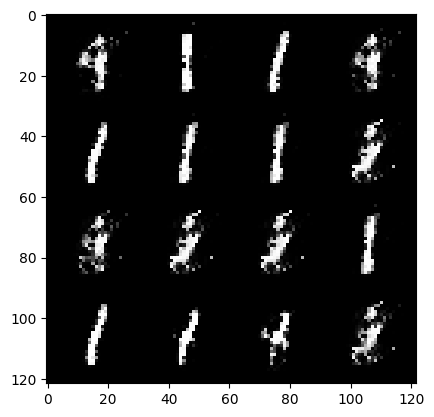

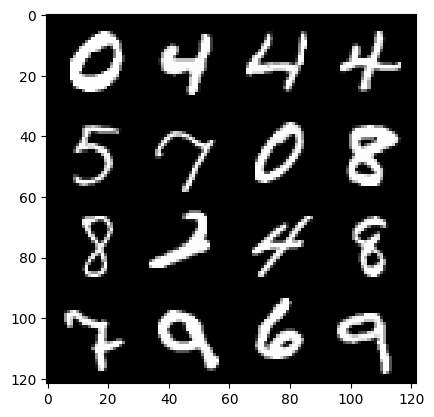

Epoch :14 , Step :12420 , Generator Loss :3.171456674734751 , Discriminator Loss :0.13357887203218763


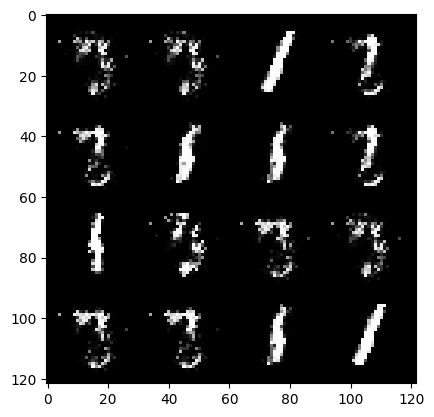

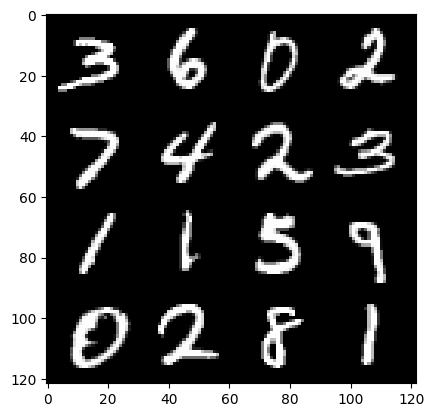

Epoch :14 , Step :12528 , Generator Loss :3.5983623663584385 , Discriminator Loss :0.1280888177592445


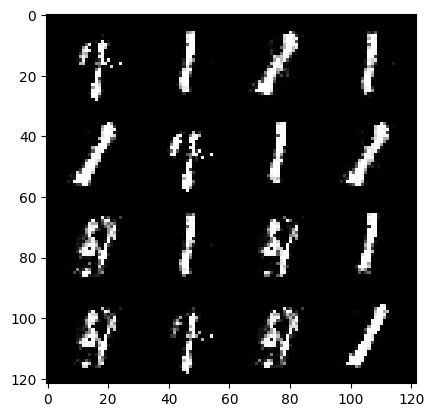

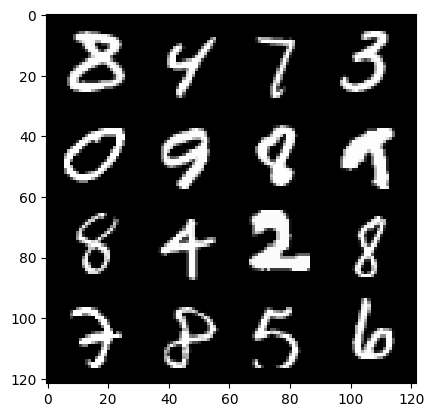

Epoch :14 , Step :12636 , Generator Loss :2.8238328297932953 , Discriminator Loss :0.15771497254846273


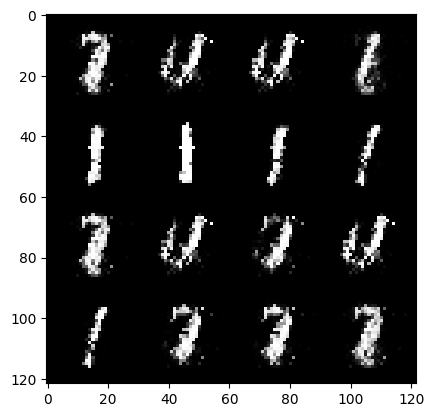

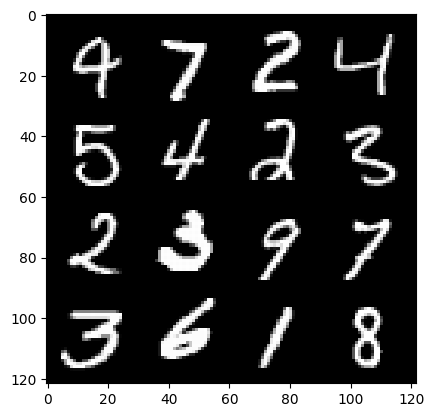

Epoch :14 , Step :12744 , Generator Loss :3.3348665612715265 , Discriminator Loss :0.13366539024368485


  0%|          | 0/469 [00:00<?, ?it/s]

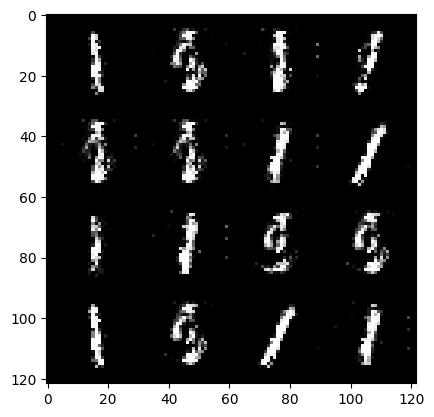

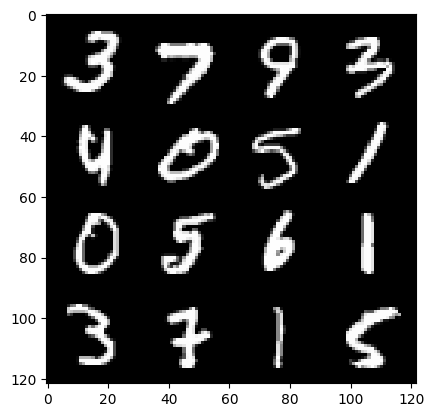

Epoch :15 , Step :12852 , Generator Loss :3.1067048598218845 , Discriminator Loss :0.13333678135165467


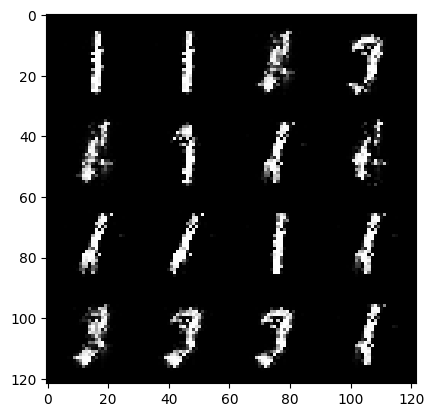

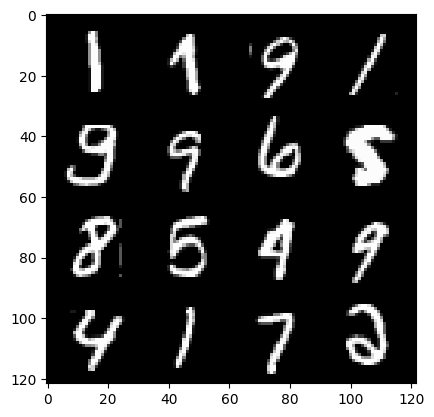

Epoch :15 , Step :12960 , Generator Loss :2.8154159541483277 , Discriminator Loss :0.16380260160399812


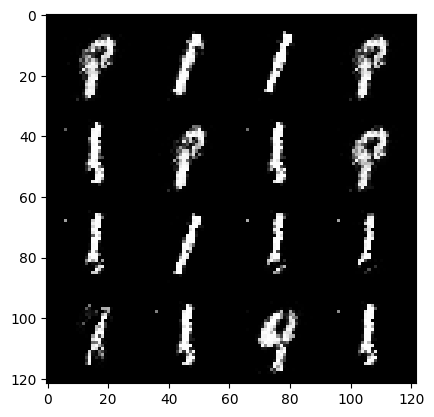

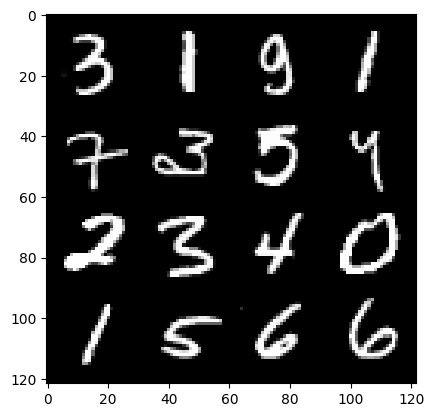

Epoch :15 , Step :13068 , Generator Loss :3.425137400627135 , Discriminator Loss :0.1436553731974628


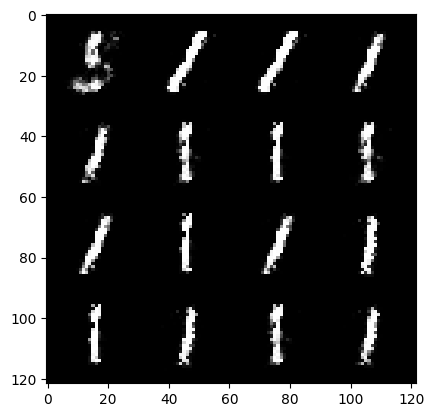

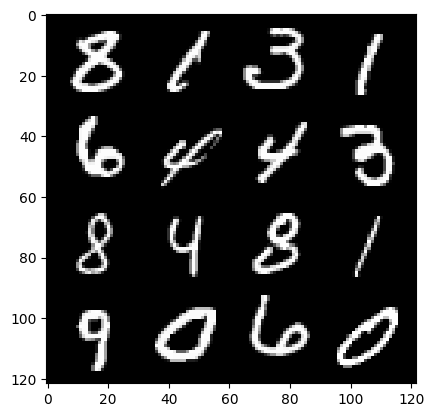

Epoch :15 , Step :13176 , Generator Loss :3.0605312056011615 , Discriminator Loss :0.16358870950837925


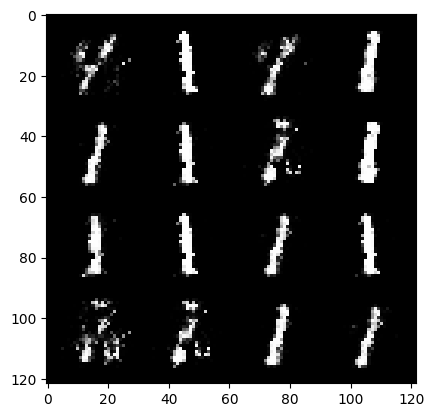

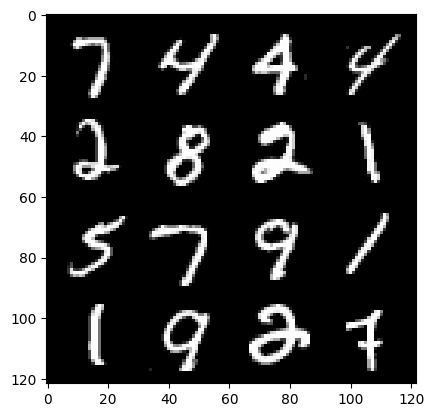

Epoch :15 , Step :13284 , Generator Loss :3.1813950781468985 , Discriminator Loss :0.1380079155787825


  0%|          | 0/469 [00:00<?, ?it/s]

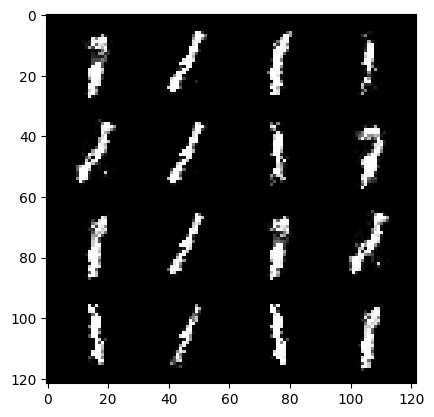

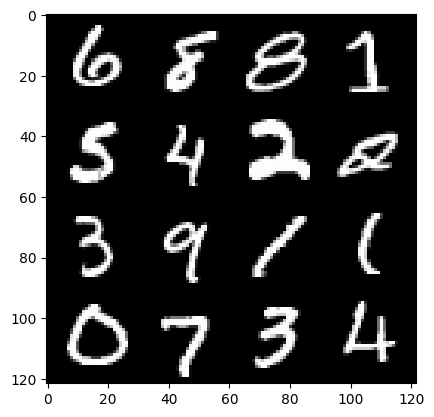

Epoch :16 , Step :13392 , Generator Loss :2.850863536198934 , Discriminator Loss :0.1757083655921397


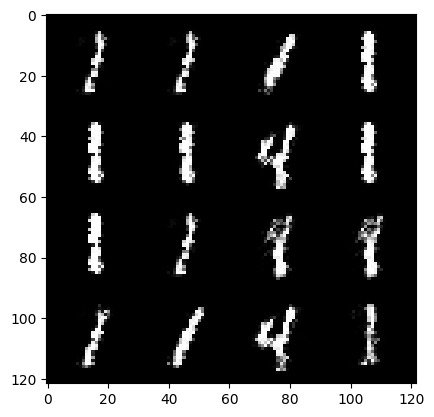

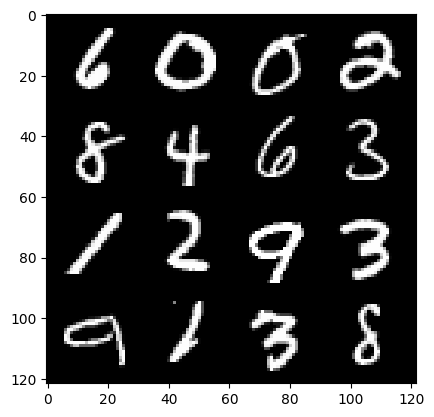

Epoch :16 , Step :13500 , Generator Loss :2.4587121826631058 , Discriminator Loss :0.15450638049730545


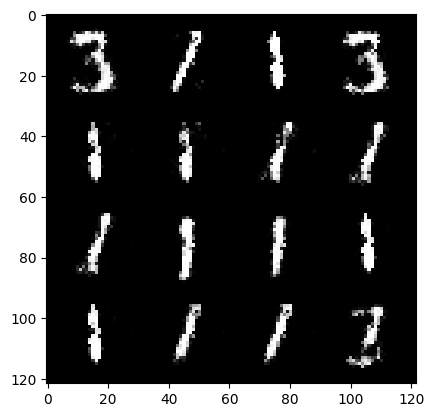

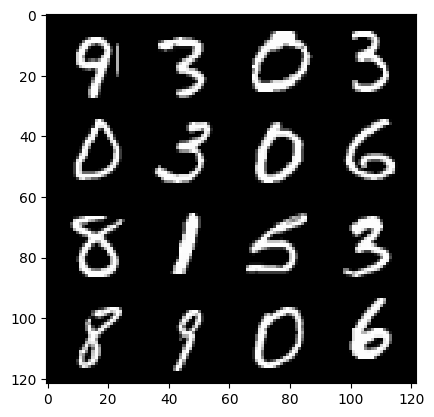

Epoch :16 , Step :13608 , Generator Loss :2.957214178862394 , Discriminator Loss :0.16102646422330974


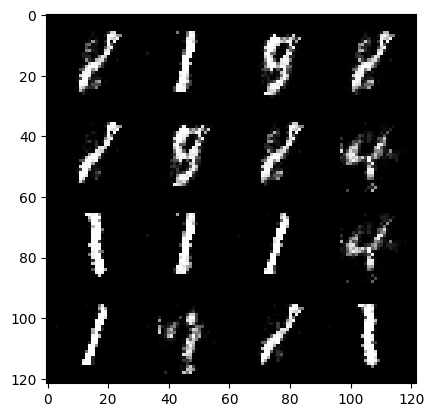

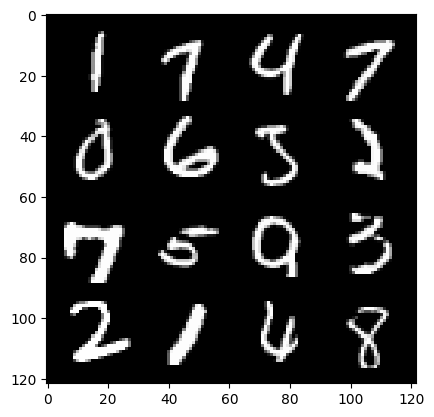

Epoch :16 , Step :13716 , Generator Loss :3.2442525890138416 , Discriminator Loss :0.16836162132245522


  0%|          | 0/469 [00:00<?, ?it/s]

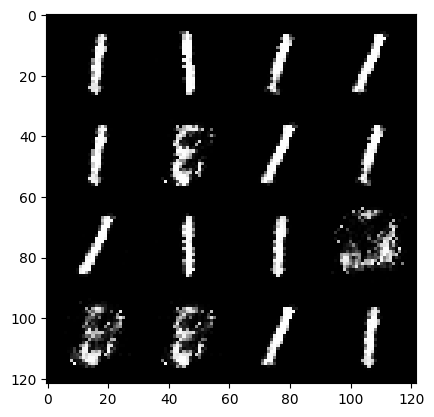

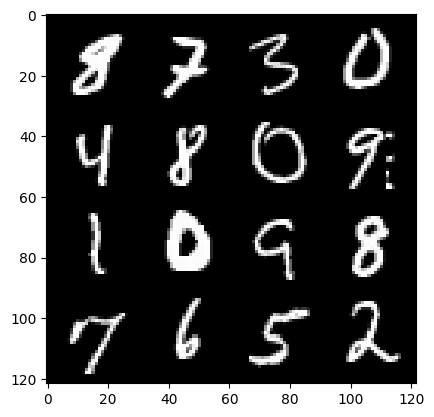

Epoch :17 , Step :13824 , Generator Loss :2.869722787980679 , Discriminator Loss :0.14298201766279003


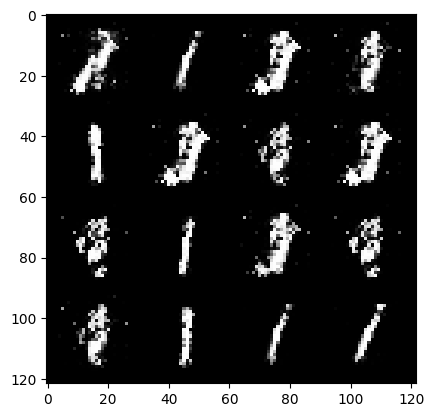

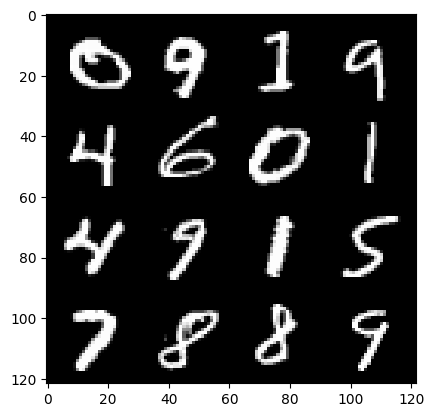

Epoch :17 , Step :13932 , Generator Loss :3.235034211918159 , Discriminator Loss :0.13157222864942417


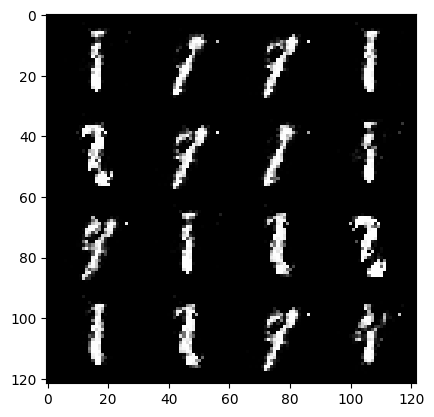

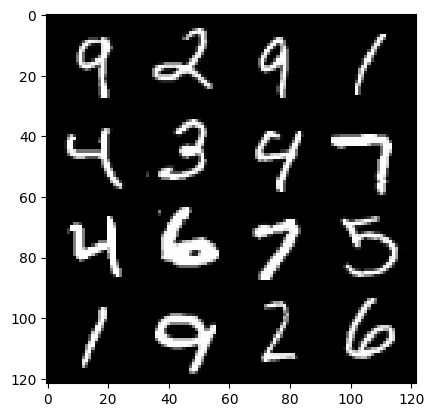

Epoch :17 , Step :14040 , Generator Loss :3.129307367183542 , Discriminator Loss :0.1406965797974004


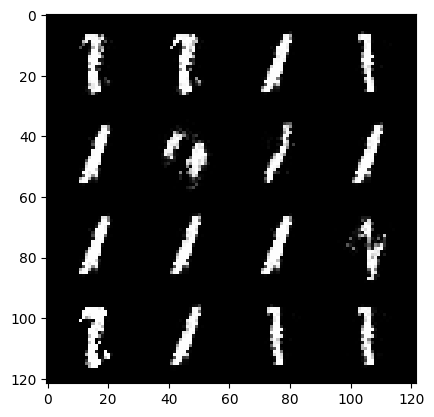

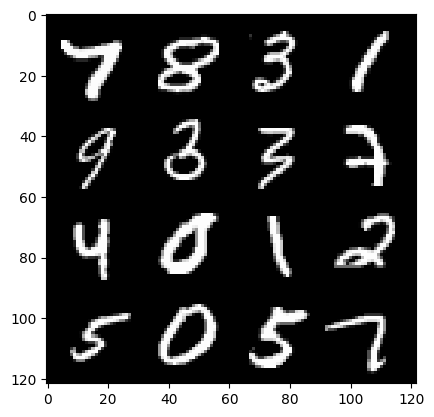

Epoch :17 , Step :14148 , Generator Loss :2.8069348931312565 , Discriminator Loss :0.14532013368551383


  0%|          | 0/469 [00:00<?, ?it/s]

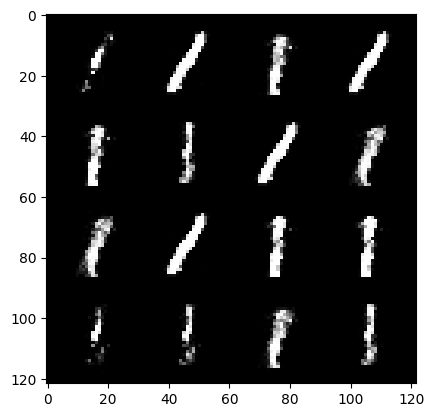

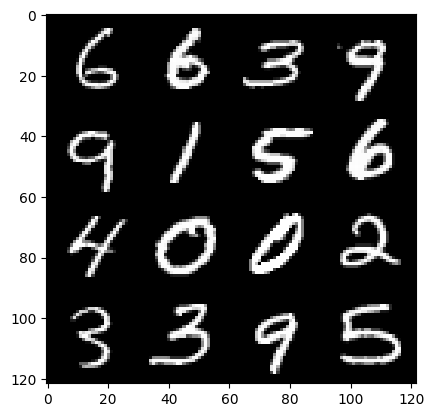

Epoch :18 , Step :14256 , Generator Loss :2.9591778009026126 , Discriminator Loss :0.1754800387554699


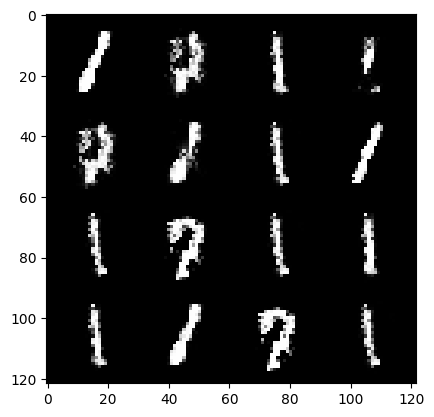

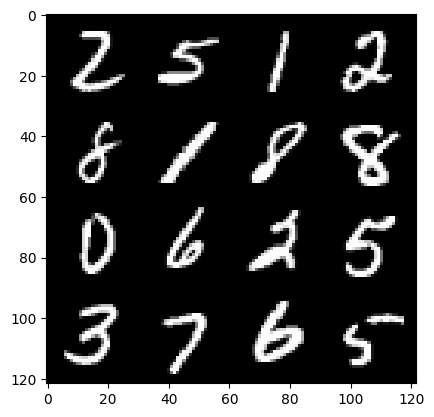

Epoch :18 , Step :14364 , Generator Loss :2.517418706858599 , Discriminator Loss :0.1721086553815338


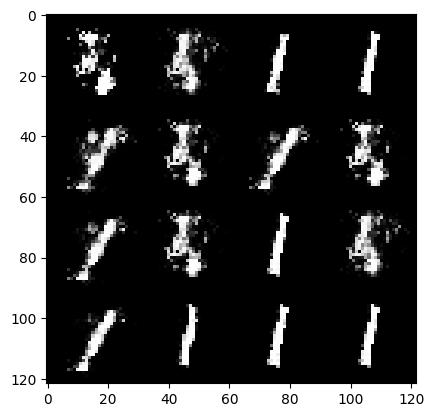

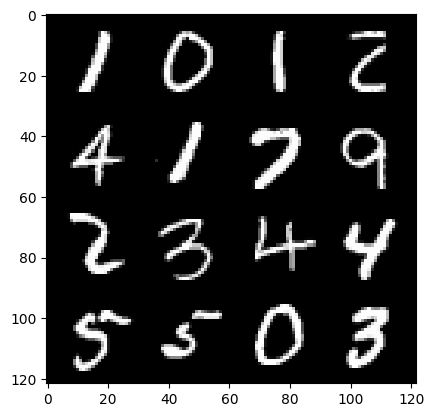

Epoch :18 , Step :14472 , Generator Loss :2.9538705967090744 , Discriminator Loss :0.1302728567410398


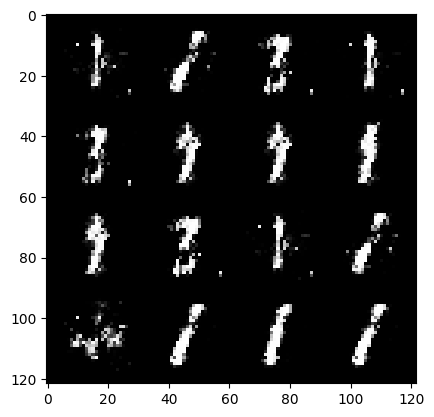

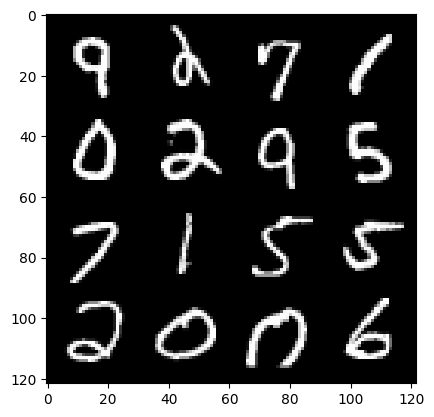

Epoch :18 , Step :14580 , Generator Loss :3.176453206274245 , Discriminator Loss :0.12126745890688012


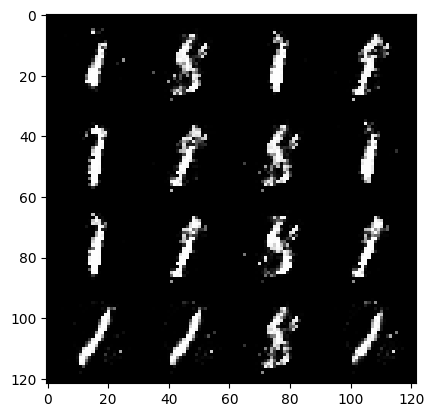

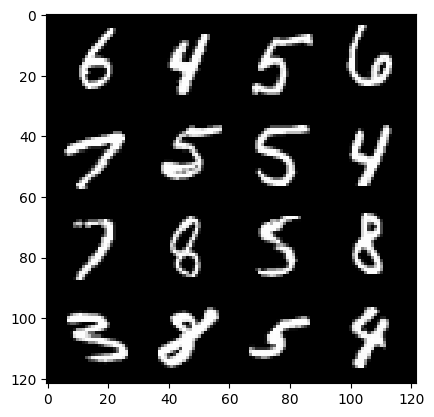

Epoch :18 , Step :14688 , Generator Loss :3.9567780781675257 , Discriminator Loss :0.1554788145478126


  0%|          | 0/469 [00:00<?, ?it/s]

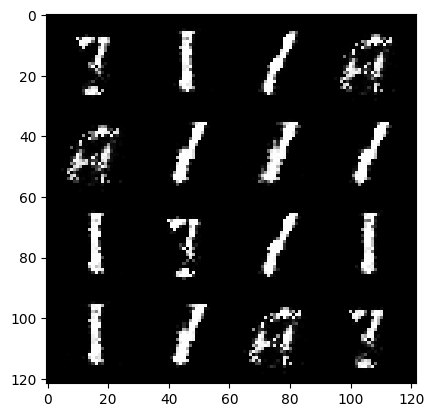

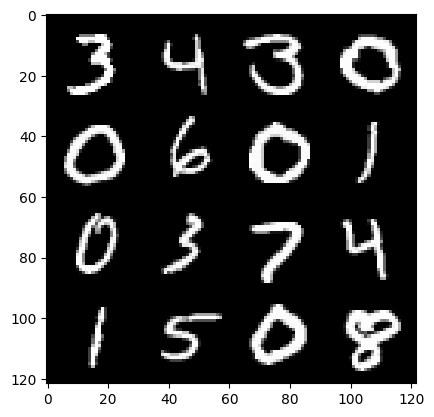

Epoch :19 , Step :14796 , Generator Loss :3.4089454964355177 , Discriminator Loss :0.11378457024693488


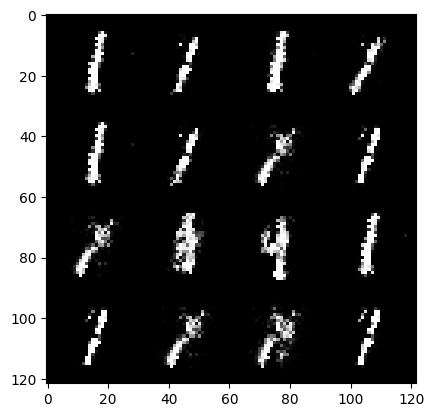

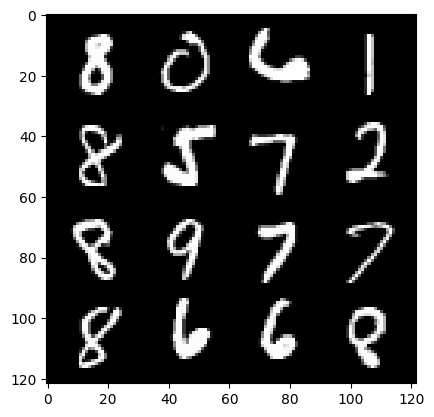

Epoch :19 , Step :14904 , Generator Loss :3.3783246322914415 , Discriminator Loss :0.1286580107968163


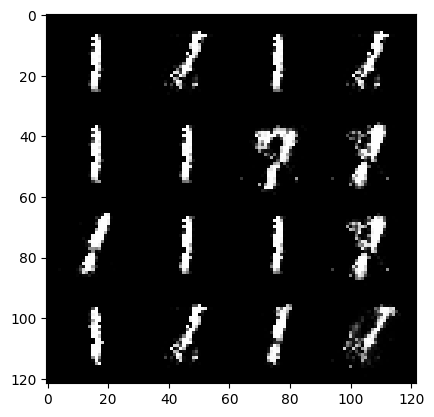

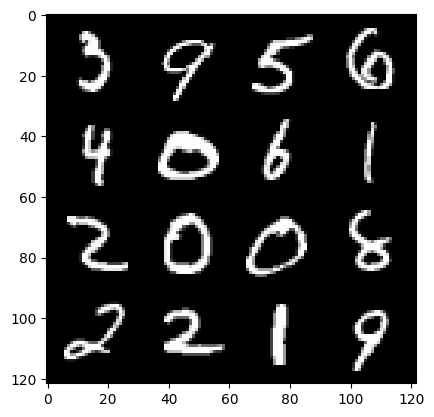

Epoch :19 , Step :15012 , Generator Loss :3.3481861948966976 , Discriminator Loss :0.1390470739592005


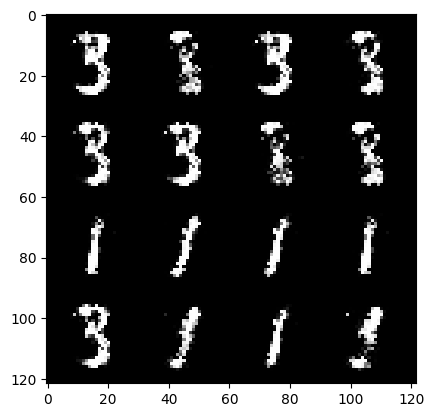

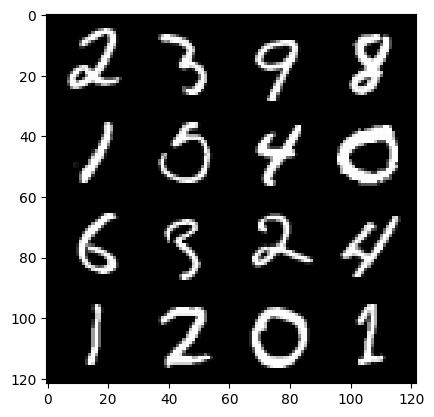

Epoch :19 , Step :15120 , Generator Loss :3.2491721356356575 , Discriminator Loss :0.16005354709233396


  0%|          | 0/469 [00:00<?, ?it/s]

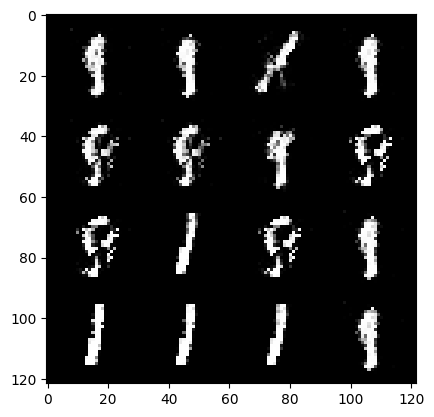

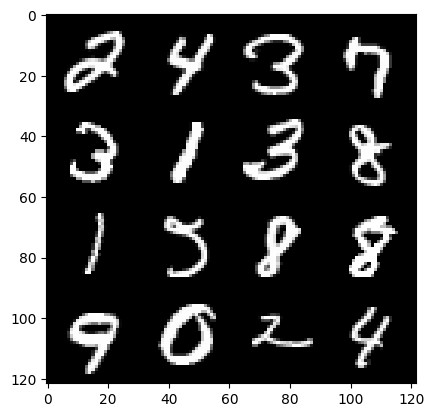

Epoch :20 , Step :15228 , Generator Loss :3.472190241018931 , Discriminator Loss :0.1284422409479265


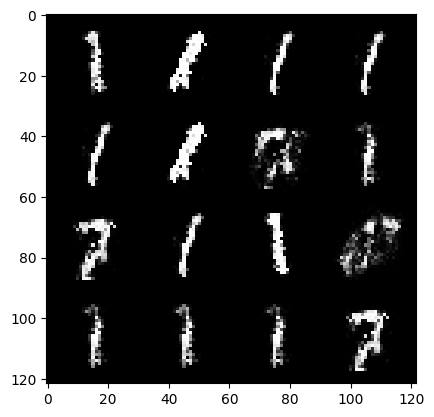

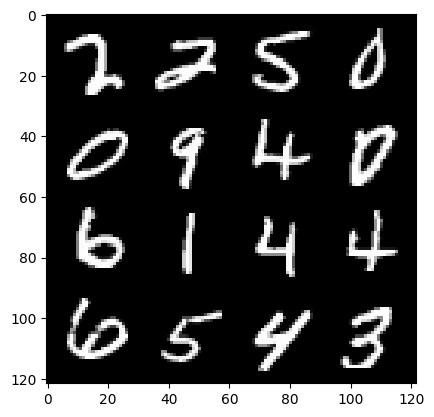

Epoch :20 , Step :15336 , Generator Loss :3.074078250814368 , Discriminator Loss :0.16382995165056657


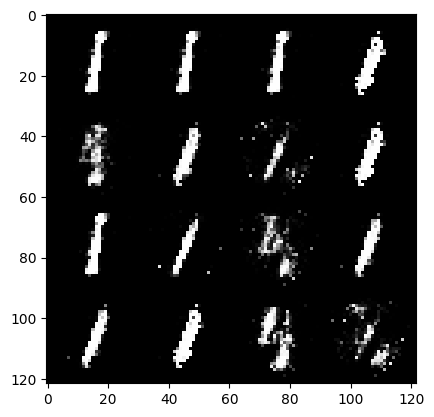

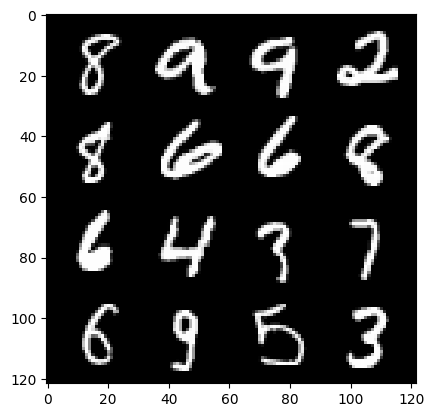

Epoch :20 , Step :15444 , Generator Loss :3.1073024758586167 , Discriminator Loss :0.12378931086924337


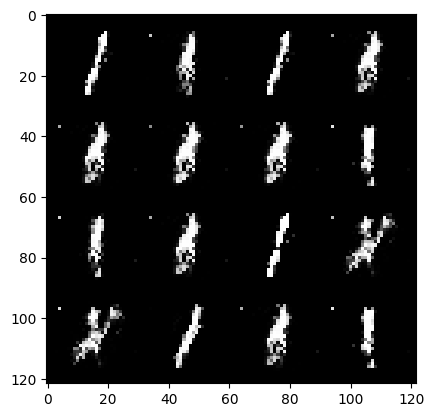

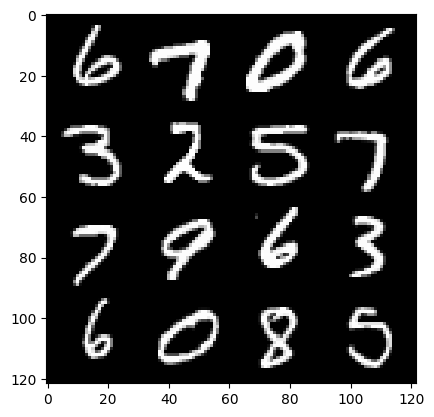

Epoch :20 , Step :15552 , Generator Loss :3.3922652204831434 , Discriminator Loss :0.1076340627408139


  0%|          | 0/469 [00:00<?, ?it/s]

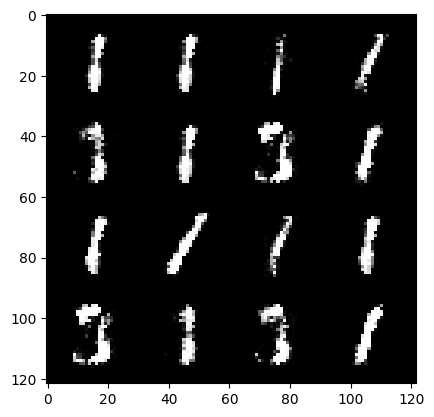

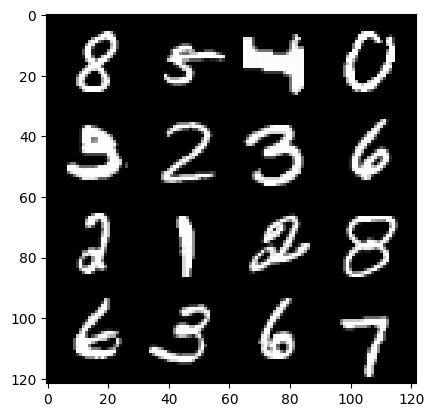

Epoch :21 , Step :15660 , Generator Loss :3.163955205016666 , Discriminator Loss :0.14003170950821156


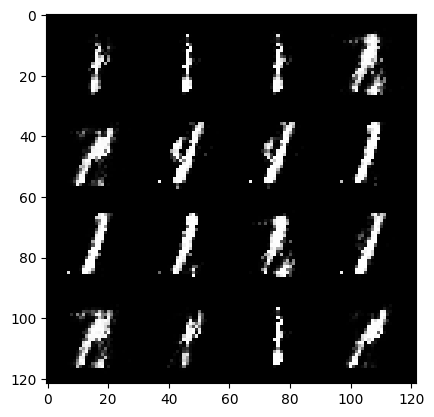

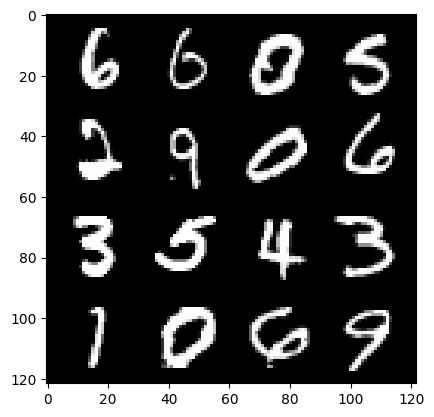

Epoch :21 , Step :15768 , Generator Loss :3.028892598770282 , Discriminator Loss :0.13772396398363299


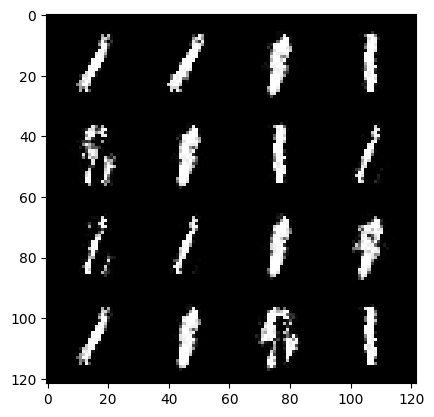

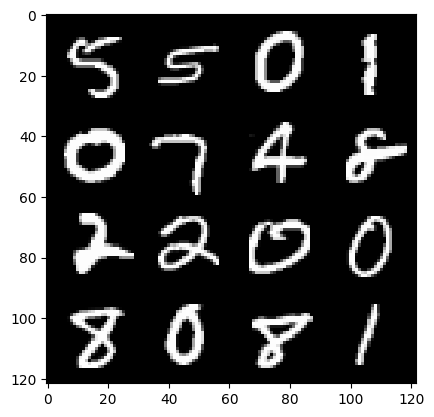

Epoch :21 , Step :15876 , Generator Loss :3.2526826748141517 , Discriminator Loss :0.16803650309642157


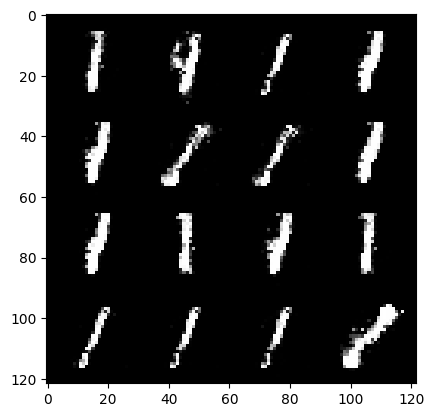

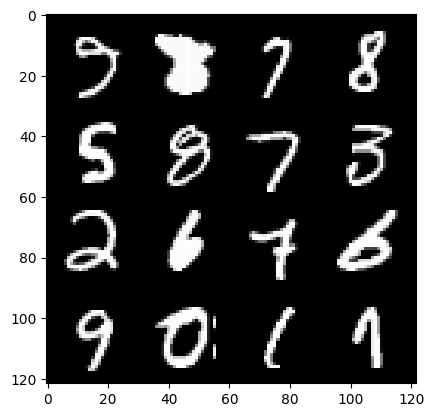

Epoch :21 , Step :15984 , Generator Loss :3.035278077478762 , Discriminator Loss :0.1752141495407731


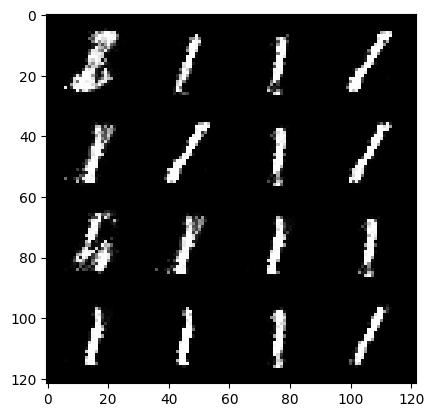

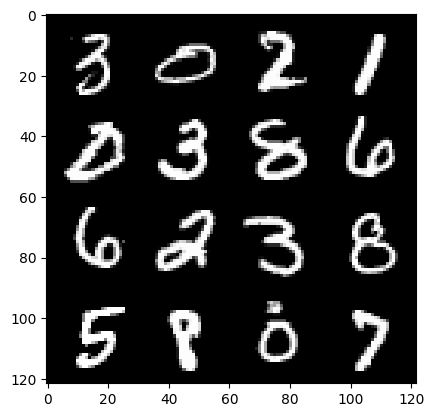

Epoch :21 , Step :16092 , Generator Loss :2.73614928457472 , Discriminator Loss :0.1614120265951863


  0%|          | 0/469 [00:00<?, ?it/s]

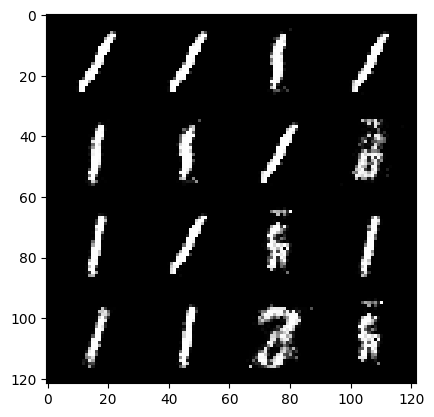

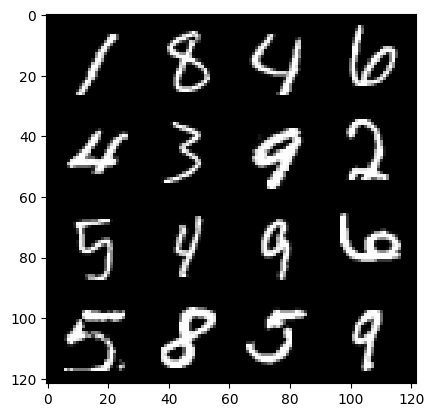

Epoch :22 , Step :16200 , Generator Loss :2.6125573118527727 , Discriminator Loss :0.1808788704651373


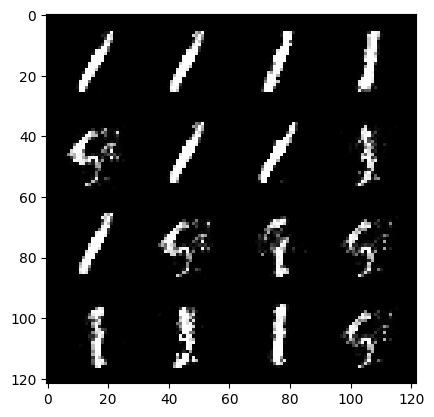

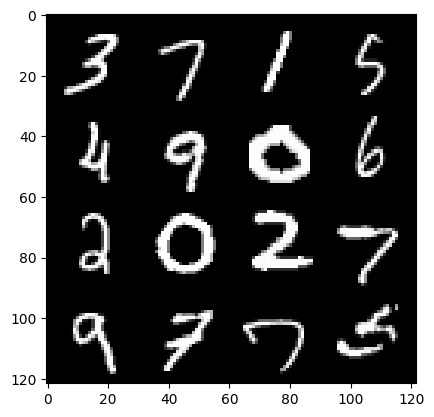

Epoch :22 , Step :16308 , Generator Loss :2.8447001995863737 , Discriminator Loss :0.14968831271485045


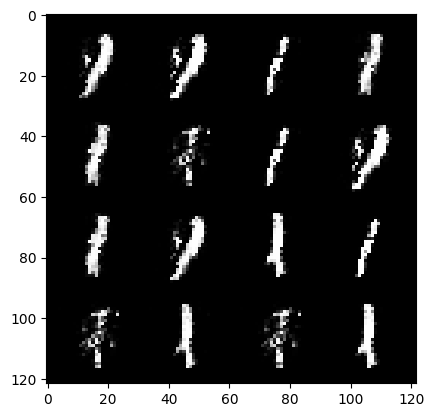

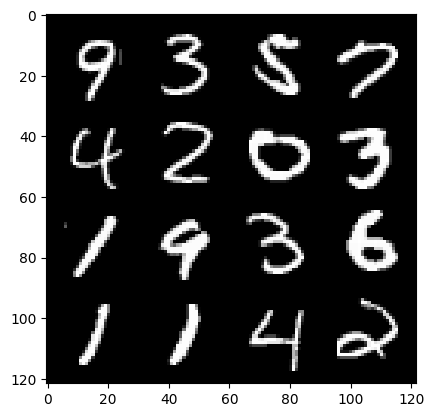

Epoch :22 , Step :16416 , Generator Loss :3.0420224556216473 , Discriminator Loss :0.12520128253985333


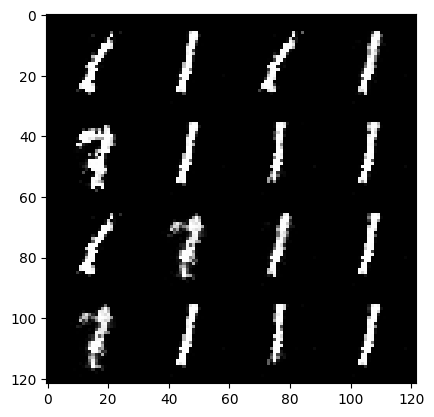

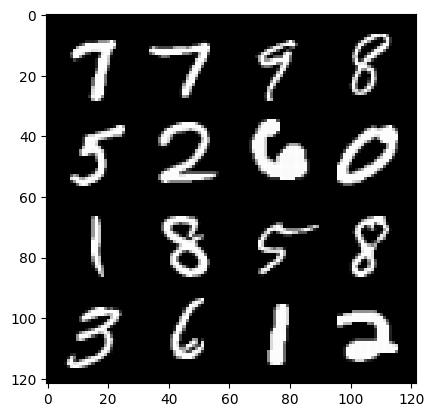

Epoch :22 , Step :16524 , Generator Loss :3.117587433920968 , Discriminator Loss :0.14853234527011716


  0%|          | 0/469 [00:00<?, ?it/s]

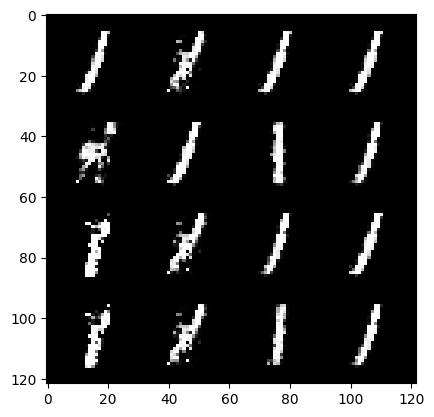

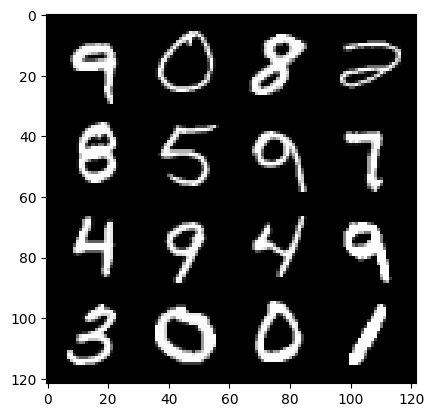

Epoch :23 , Step :16632 , Generator Loss :3.033021337456171 , Discriminator Loss :0.1188561039528361


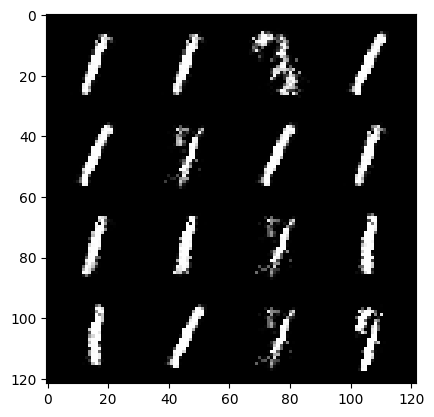

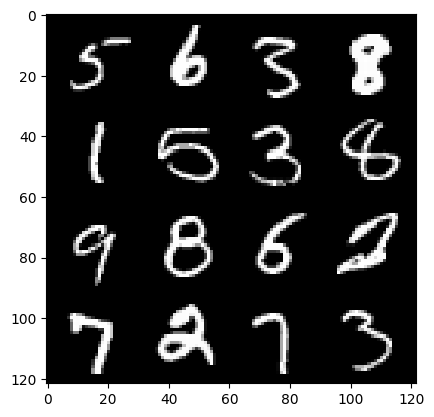

Epoch :23 , Step :16740 , Generator Loss :3.1899762926278292 , Discriminator Loss :0.12611111260398677


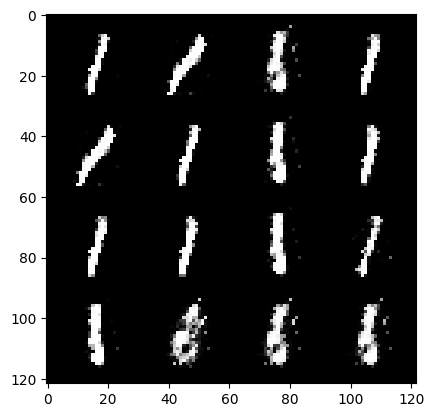

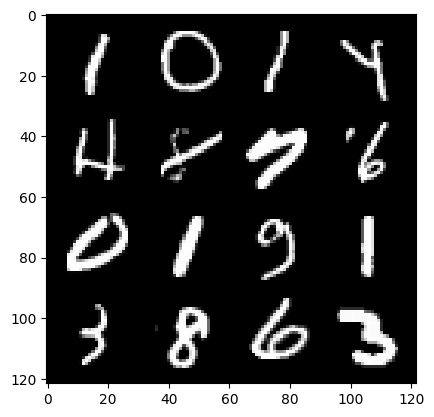

Epoch :23 , Step :16848 , Generator Loss :3.1628862266187316 , Discriminator Loss :0.12743528176926908


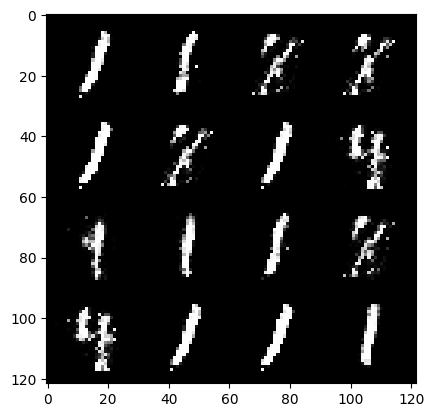

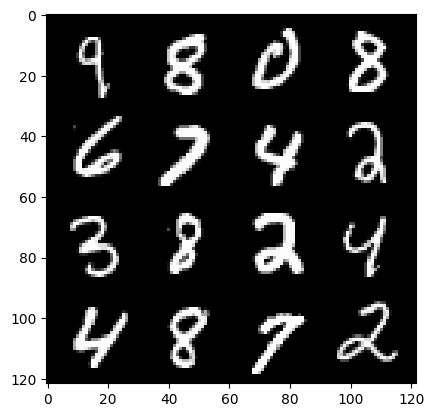

Epoch :23 , Step :16956 , Generator Loss :3.343886521127489 , Discriminator Loss :0.12289040335626514


  0%|          | 0/469 [00:00<?, ?it/s]

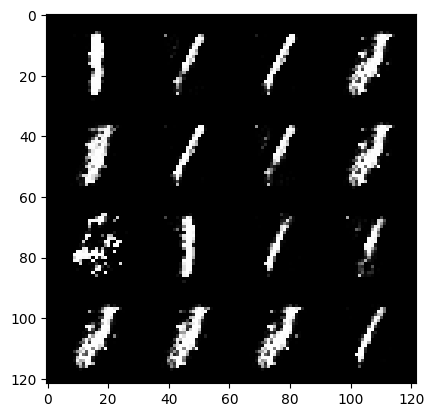

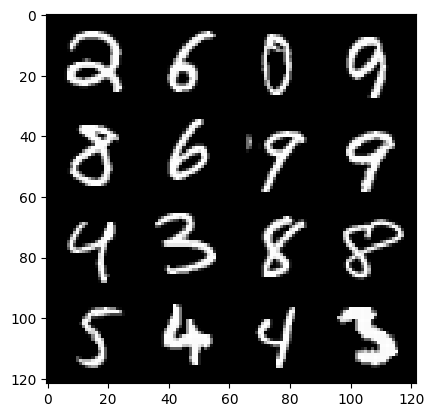

Epoch :24 , Step :17064 , Generator Loss :3.443286979639971 , Discriminator Loss :0.1295040670989288


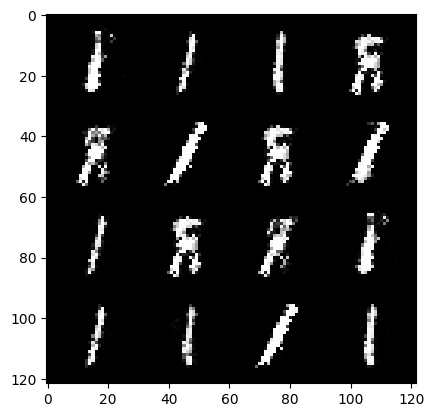

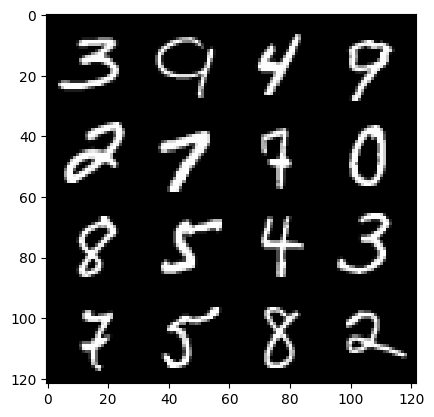

Epoch :24 , Step :17172 , Generator Loss :2.9003968216754763 , Discriminator Loss :0.13200455724641133


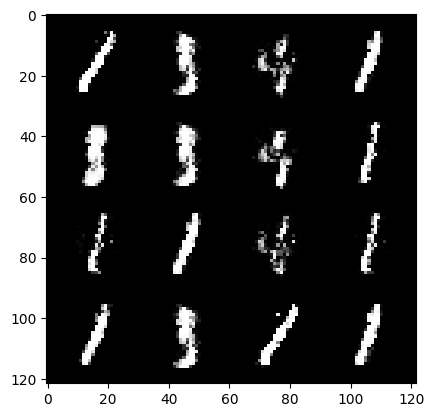

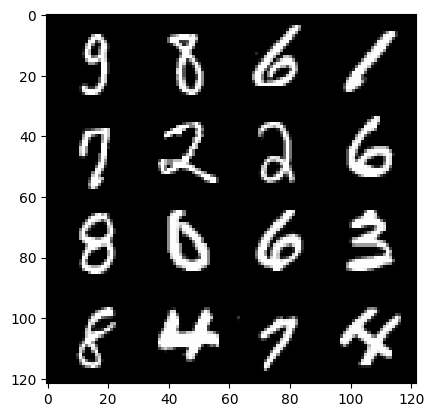

Epoch :24 , Step :17280 , Generator Loss :3.226240679069802 , Discriminator Loss :0.15897026851221363


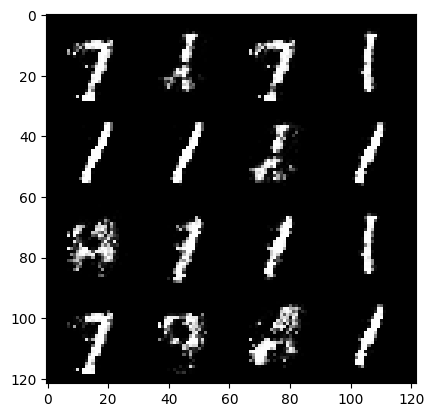

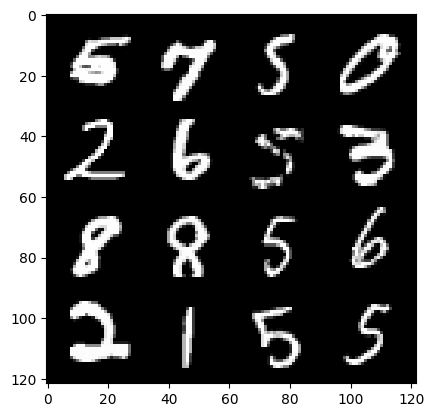

Epoch :24 , Step :17388 , Generator Loss :2.676261606039824 , Discriminator Loss :0.18421690255679468


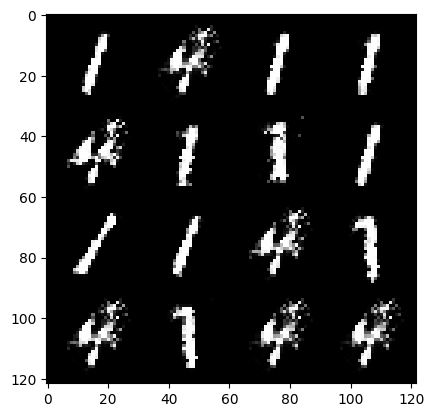

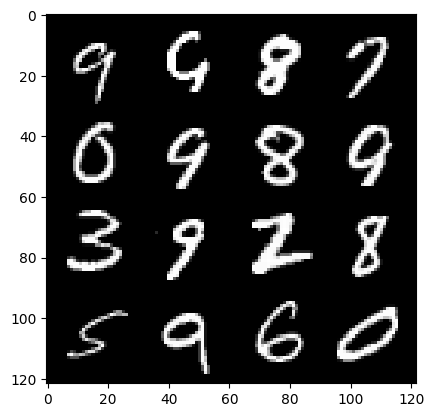

Epoch :24 , Step :17496 , Generator Loss :2.769847710927327 , Discriminator Loss :0.15024561317706545


  0%|          | 0/469 [00:00<?, ?it/s]

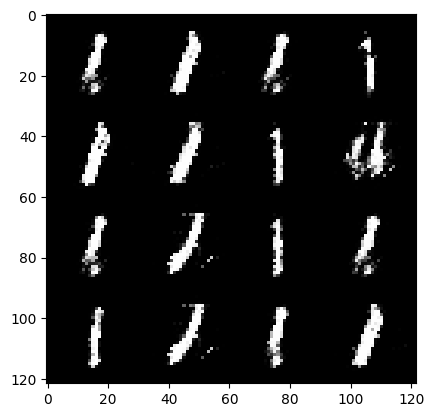

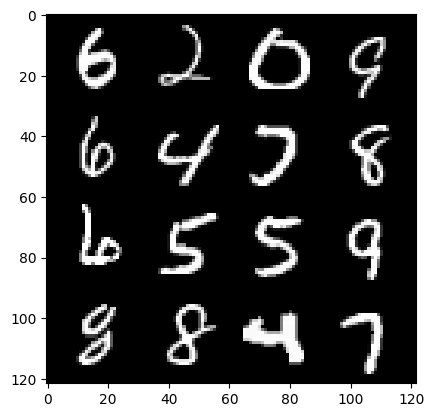

Epoch :25 , Step :17604 , Generator Loss :2.8072832955254445 , Discriminator Loss :0.18155360587493136


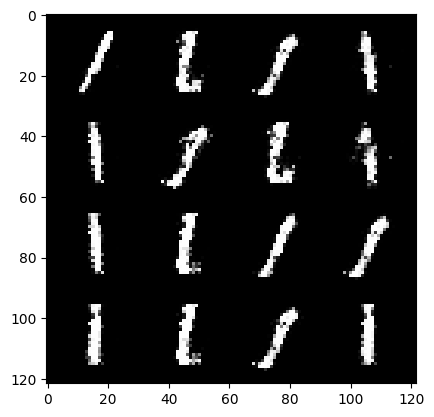

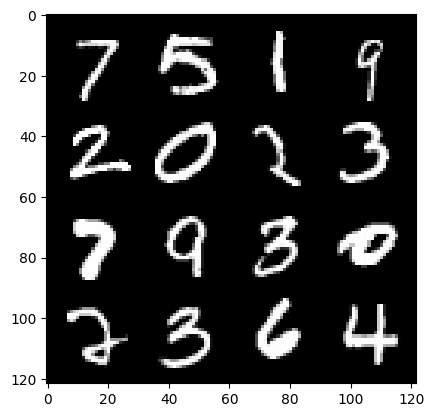

Epoch :25 , Step :17712 , Generator Loss :2.708376427491506 , Discriminator Loss :0.16357072566946354


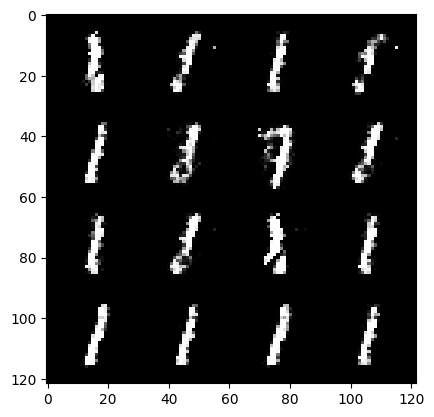

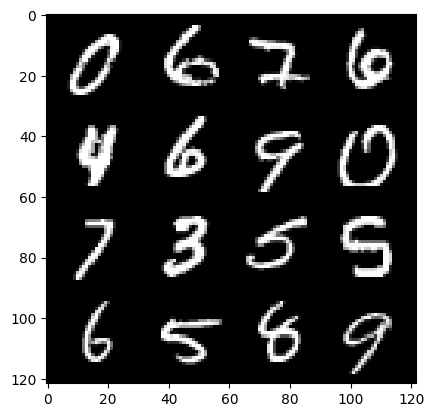

Epoch :25 , Step :17820 , Generator Loss :3.1334547996520996 , Discriminator Loss :0.11343510976682109


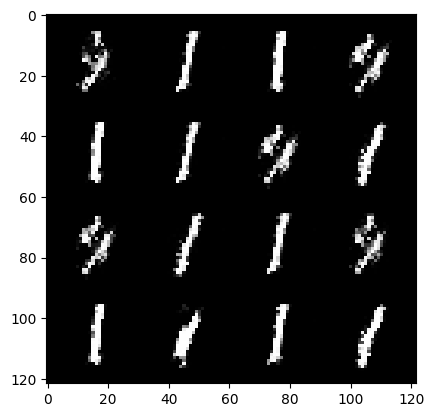

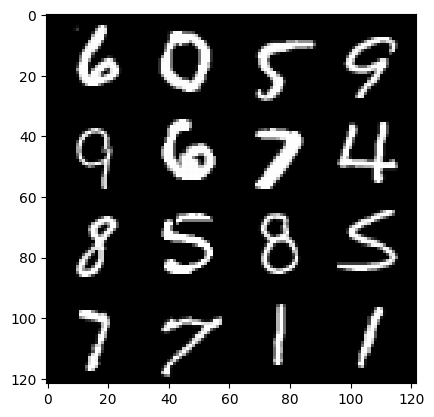

Epoch :25 , Step :17928 , Generator Loss :3.2296903354150284 , Discriminator Loss :0.15340519586095097


  0%|          | 0/469 [00:00<?, ?it/s]

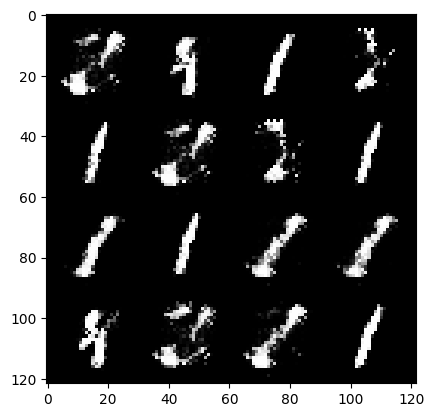

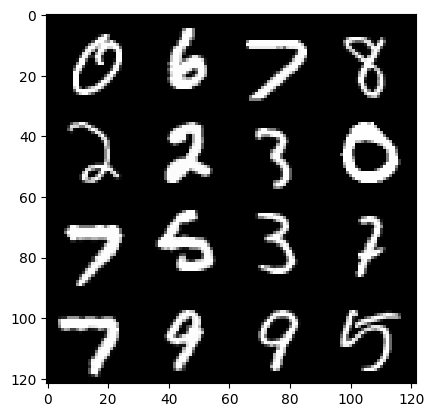

Epoch :26 , Step :18036 , Generator Loss :3.222439770345335 , Discriminator Loss :0.16606237966981213


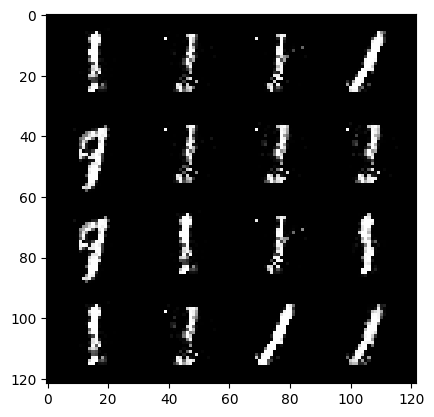

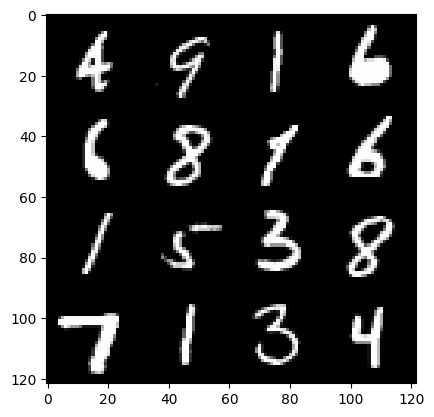

Epoch :26 , Step :18144 , Generator Loss :3.2341706377488593 , Discriminator Loss :0.10881951154658086


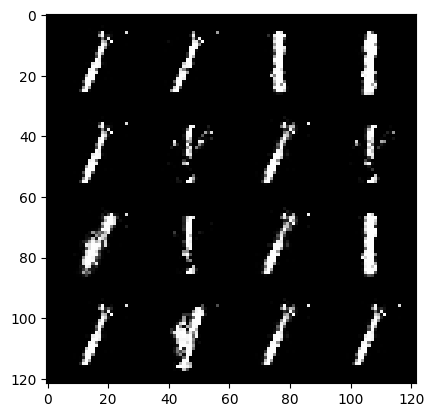

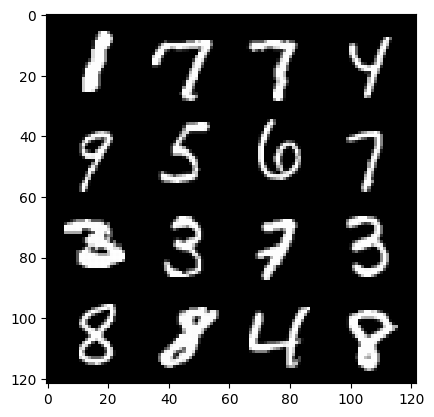

Epoch :26 , Step :18252 , Generator Loss :3.1327004410602415 , Discriminator Loss :0.1742432017431215


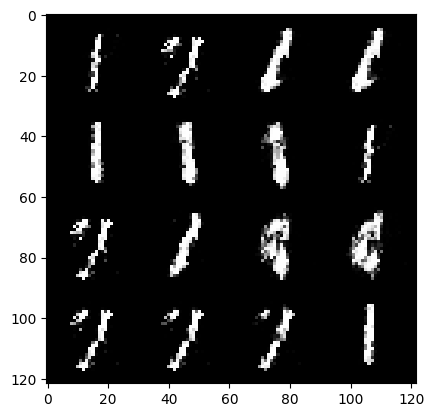

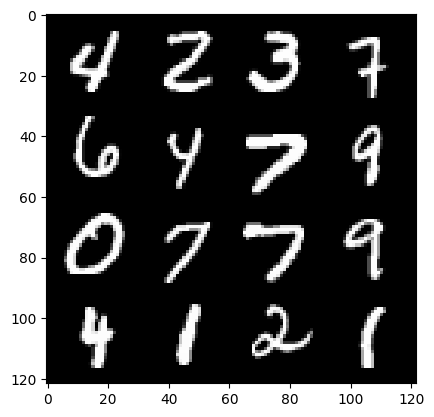

Epoch :26 , Step :18360 , Generator Loss :2.7501607471042213 , Discriminator Loss :0.1360659354400856


  0%|          | 0/469 [00:00<?, ?it/s]

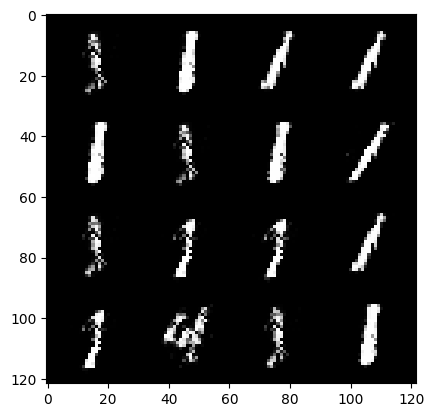

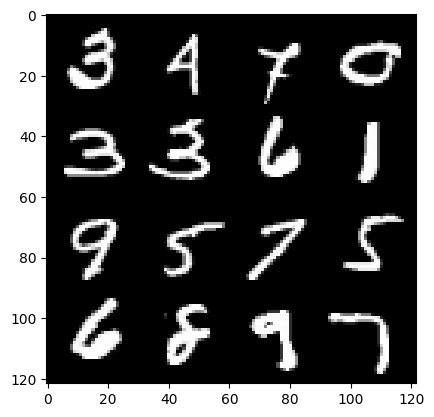

Epoch :27 , Step :18468 , Generator Loss :2.923366372232083 , Discriminator Loss :0.14725200838788793


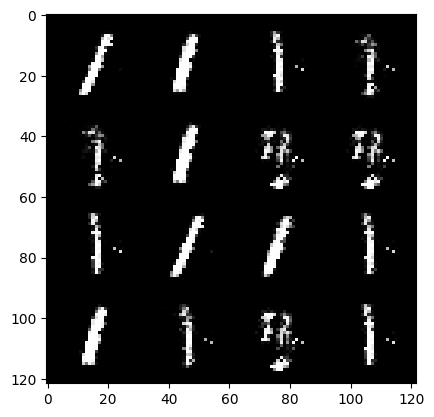

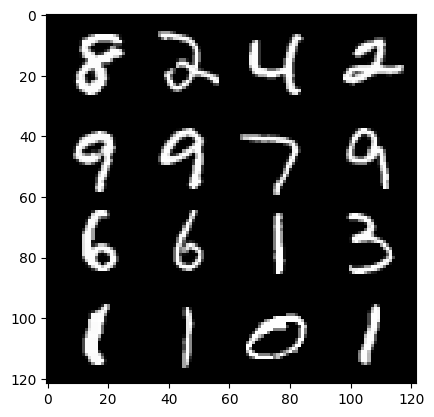

Epoch :27 , Step :18576 , Generator Loss :2.7664618646657013 , Discriminator Loss :0.16106669556487485


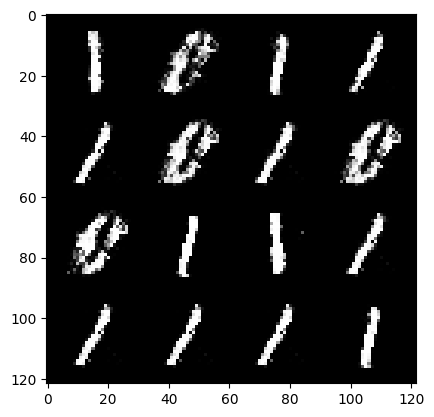

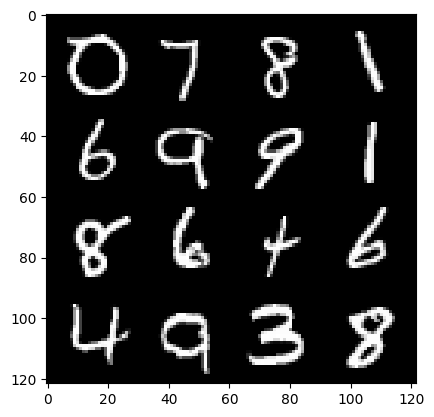

Epoch :27 , Step :18684 , Generator Loss :3.1641234954198207 , Discriminator Loss :0.1734532119568299


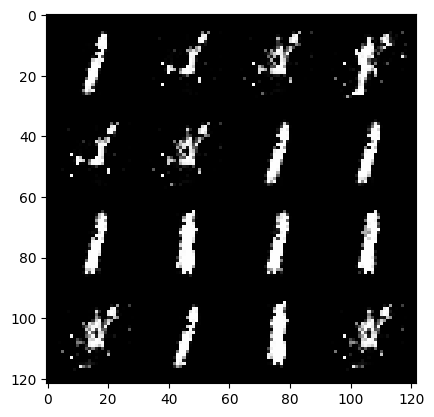

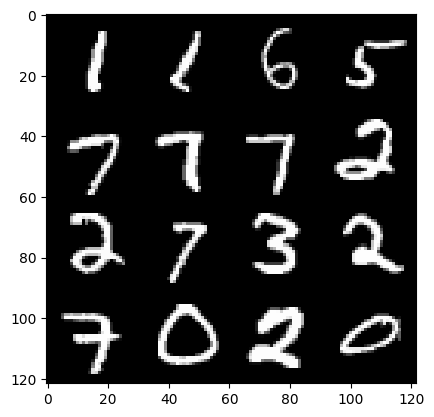

Epoch :27 , Step :18792 , Generator Loss :3.061966200669606 , Discriminator Loss :0.12709276367806727


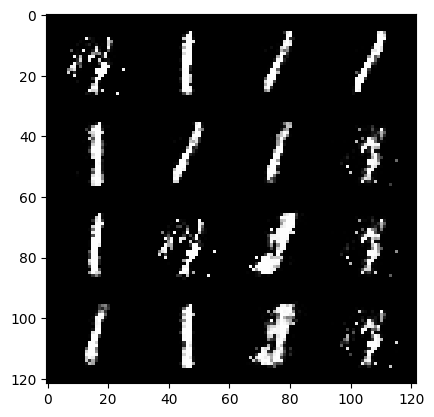

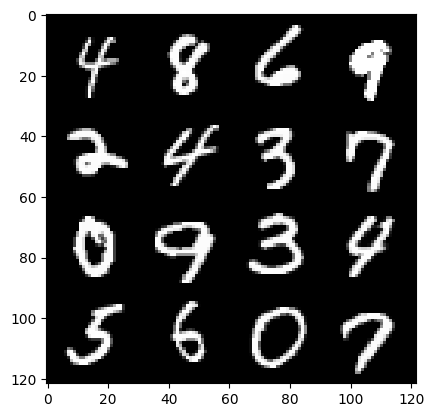

Epoch :27 , Step :18900 , Generator Loss :3.6508061091105146 , Discriminator Loss :0.09822019631112064


  0%|          | 0/469 [00:00<?, ?it/s]

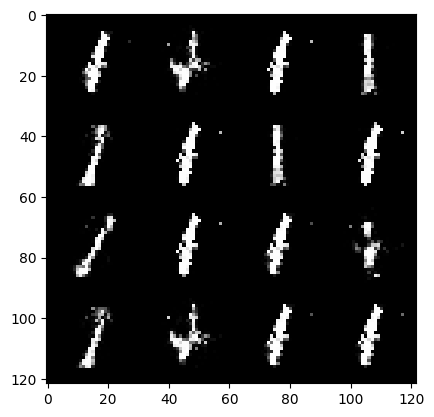

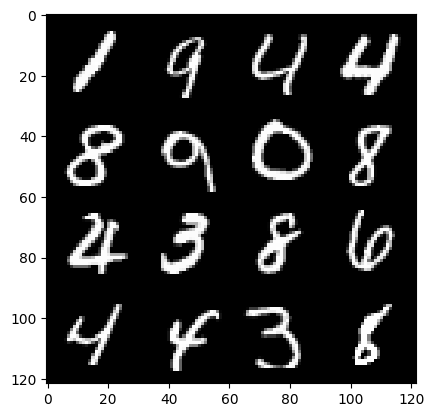

Epoch :28 , Step :19008 , Generator Loss :2.865583644972906 , Discriminator Loss :0.16689082766296695


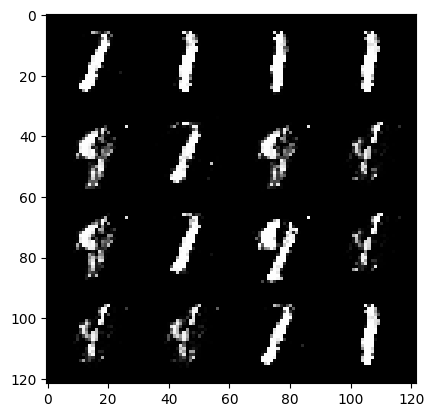

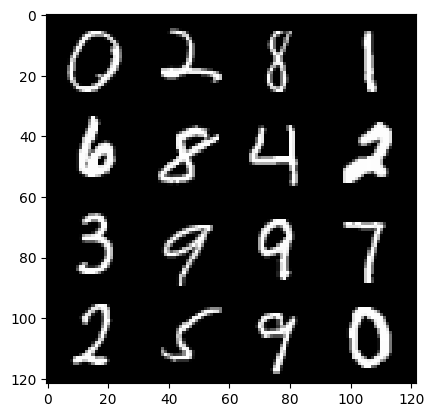

Epoch :28 , Step :19116 , Generator Loss :3.1734753670515836 , Discriminator Loss :0.16166711646925525


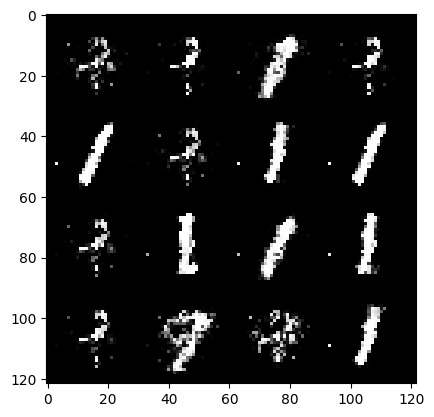

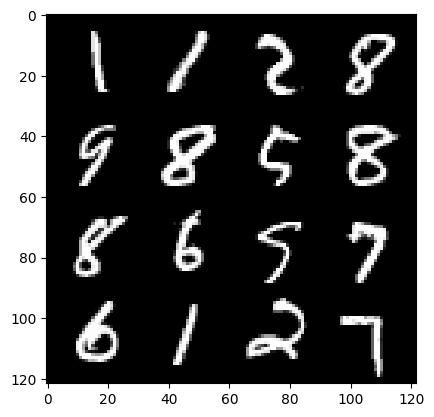

Epoch :28 , Step :19224 , Generator Loss :3.0168761677212173 , Discriminator Loss :0.1517127888208186


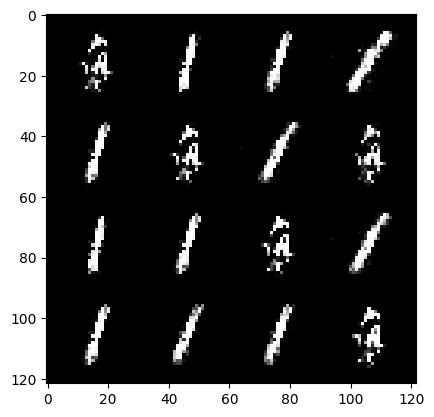

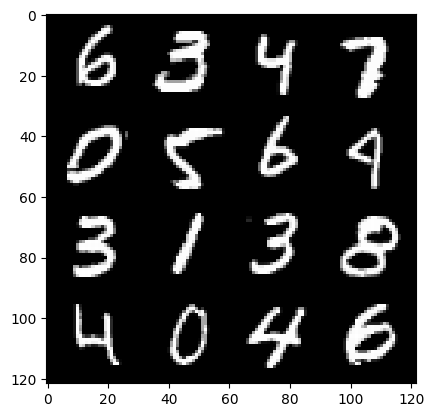

Epoch :28 , Step :19332 , Generator Loss :3.12552637303317 , Discriminator Loss :0.12558218595330362


  0%|          | 0/469 [00:00<?, ?it/s]

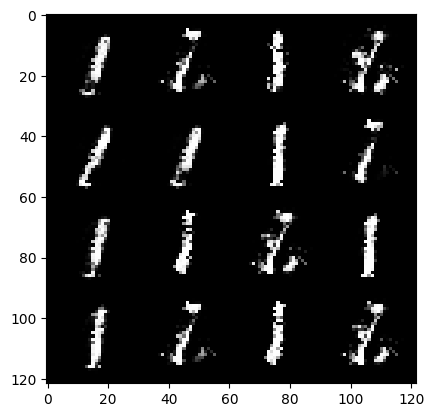

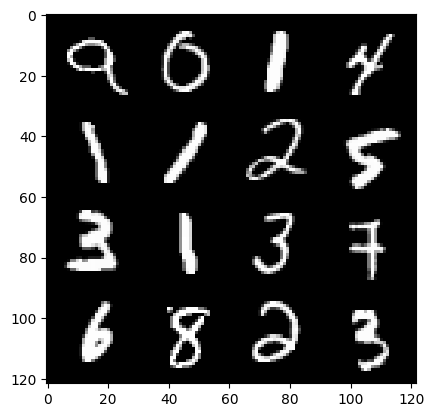

Epoch :29 , Step :19440 , Generator Loss :3.6098836329248205 , Discriminator Loss :0.1223086451214773


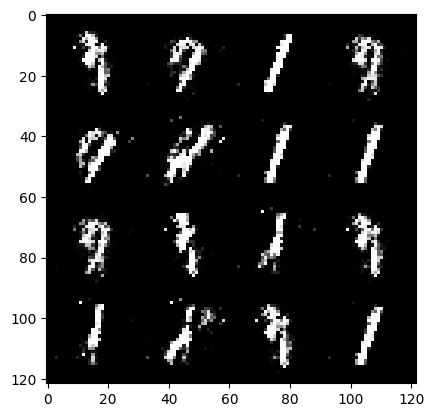

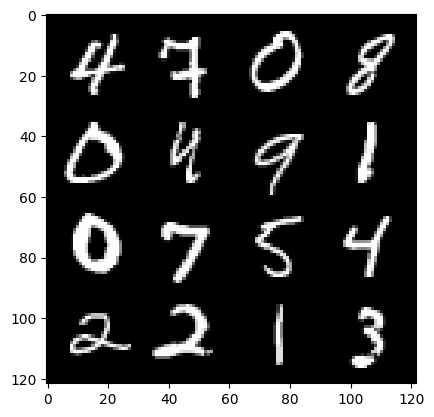

Epoch :29 , Step :19548 , Generator Loss :3.3841056161456646 , Discriminator Loss :0.172167477508386


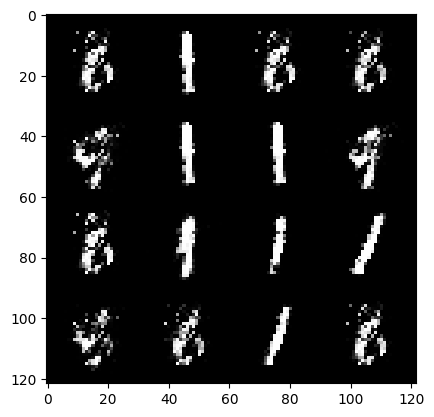

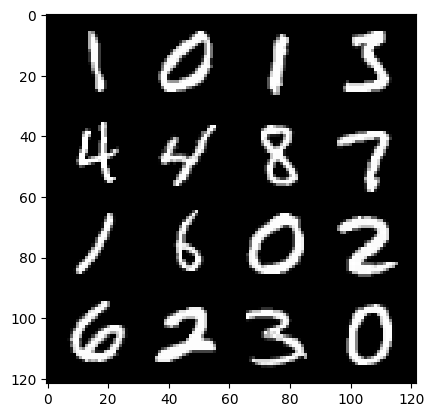

Epoch :29 , Step :19656 , Generator Loss :3.1136093073421054 , Discriminator Loss :0.12763655634114038


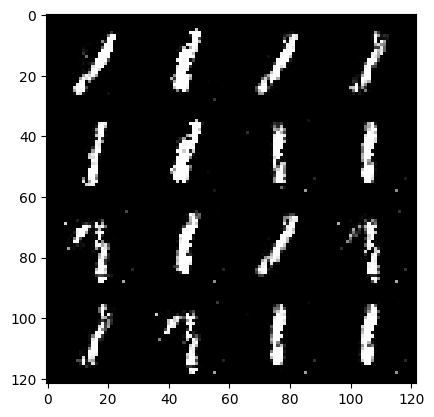

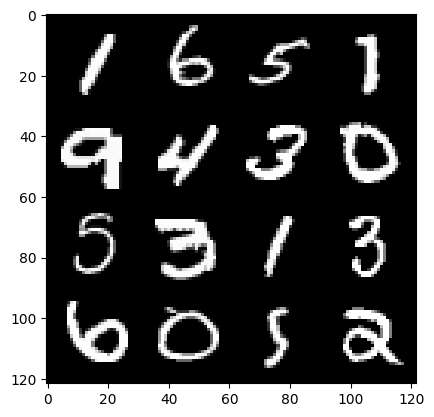

Epoch :29 , Step :19764 , Generator Loss :3.222906565224682 , Discriminator Loss :0.13811514533504288


  0%|          | 0/469 [00:00<?, ?it/s]

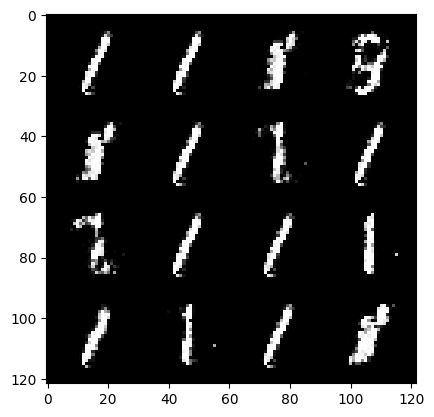

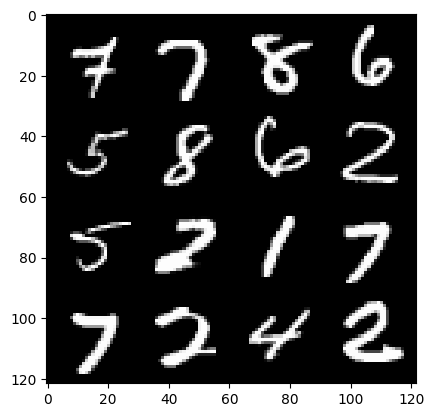

Epoch :30 , Step :19872 , Generator Loss :2.9542569209028167 , Discriminator Loss :0.19317635548887427


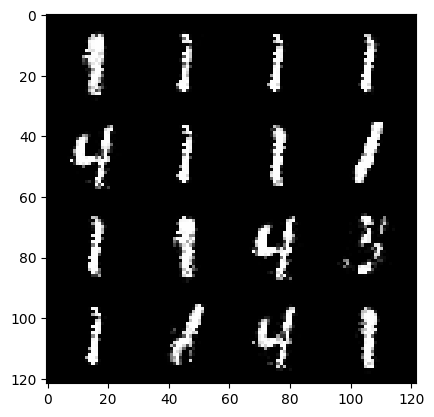

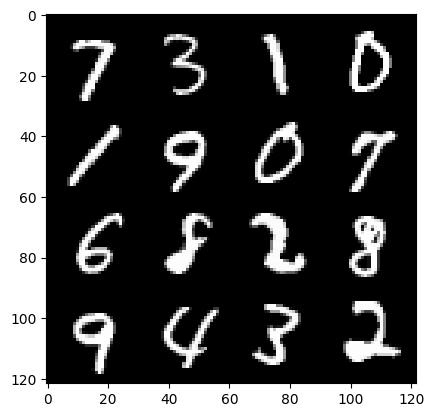

Epoch :30 , Step :19980 , Generator Loss :2.741754010871607 , Discriminator Loss :0.1413410753011703


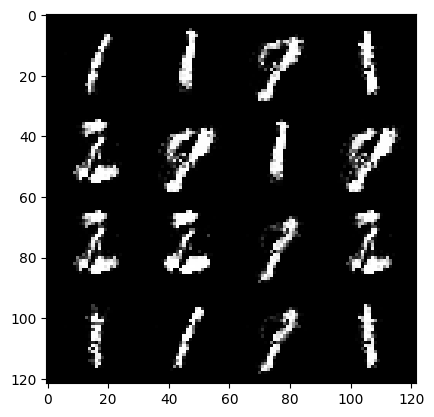

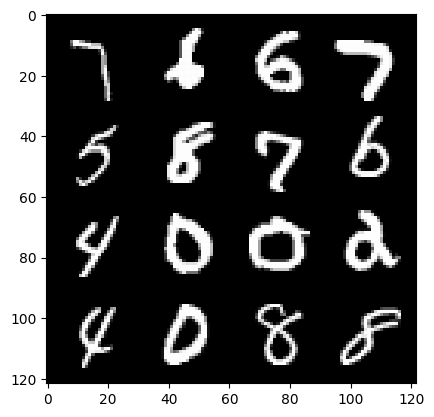

Epoch :30 , Step :20088 , Generator Loss :3.025996839558636 , Discriminator Loss :0.19420831133094096


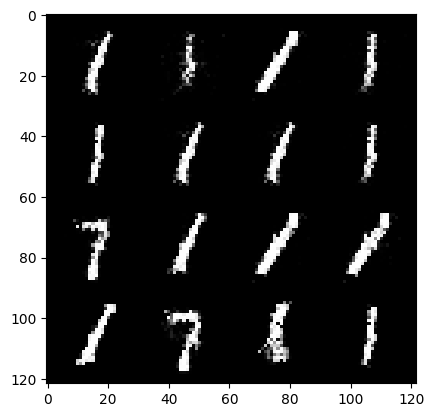

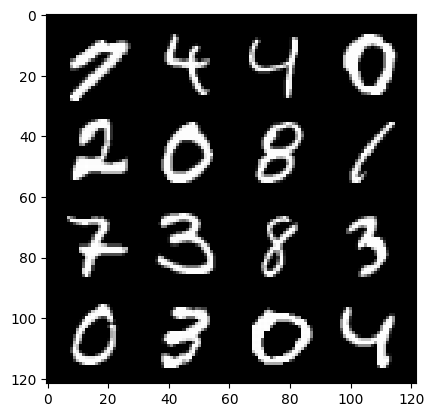

Epoch :30 , Step :20196 , Generator Loss :2.6213276165503046 , Discriminator Loss :0.19658129758856902


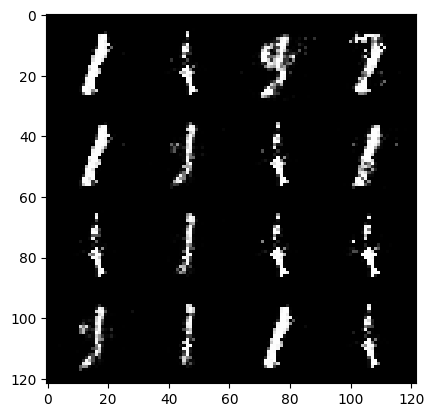

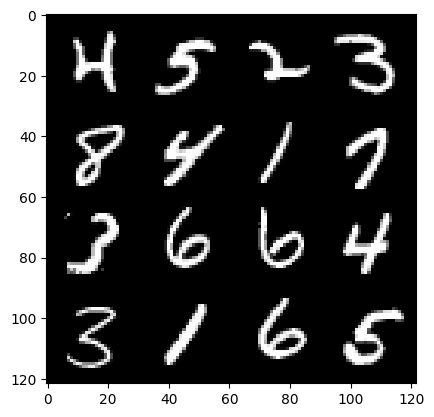

Epoch :30 , Step :20304 , Generator Loss :2.5821254054705305 , Discriminator Loss :0.15378360912479735


  0%|          | 0/469 [00:00<?, ?it/s]

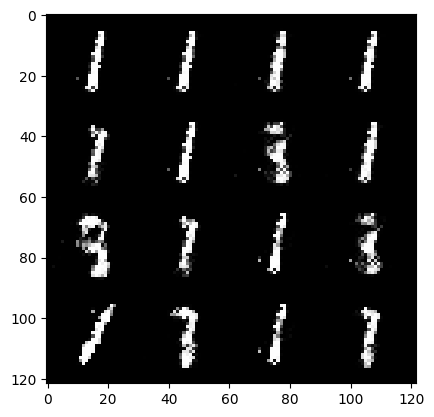

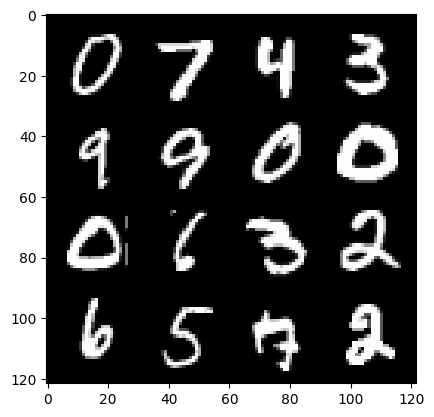

Epoch :31 , Step :20412 , Generator Loss :3.0765711179486033 , Discriminator Loss :0.11872908438521403


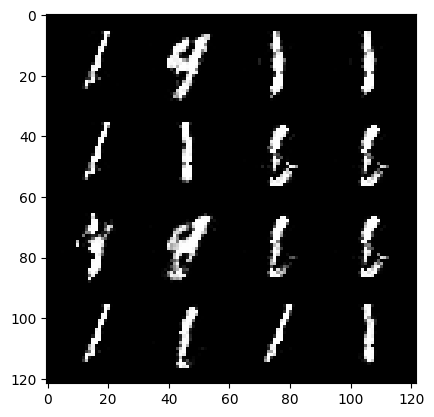

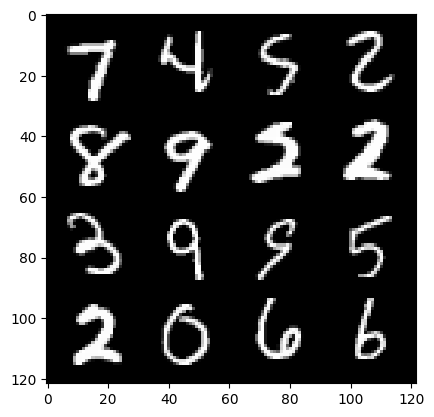

Epoch :31 , Step :20520 , Generator Loss :3.136413402027554 , Discriminator Loss :0.14115816761774044


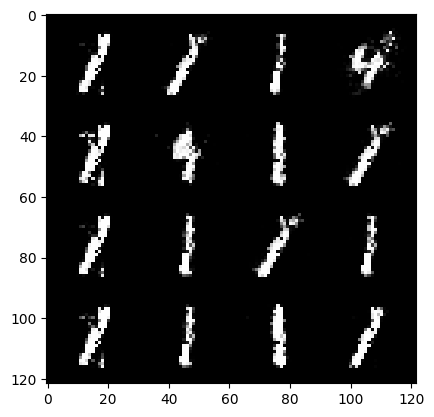

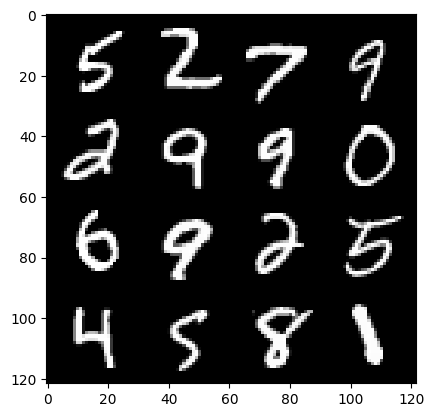

Epoch :31 , Step :20628 , Generator Loss :3.021708437690028 , Discriminator Loss :0.15023581042057937


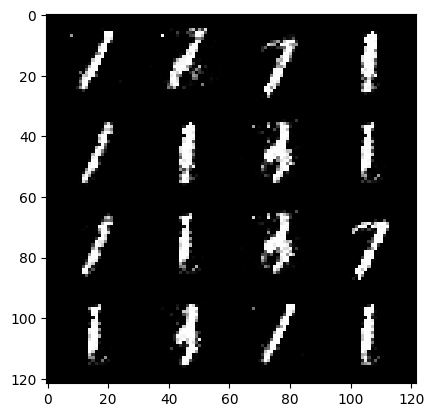

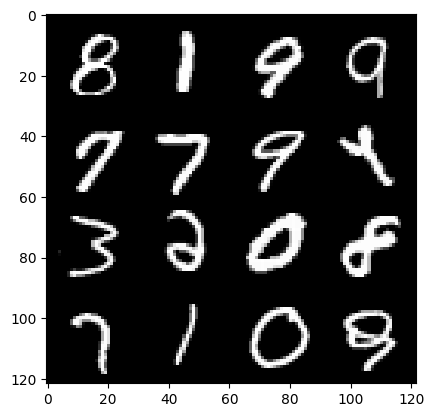

Epoch :31 , Step :20736 , Generator Loss :3.0092458327611276 , Discriminator Loss :0.13567161373794082


  0%|          | 0/469 [00:00<?, ?it/s]

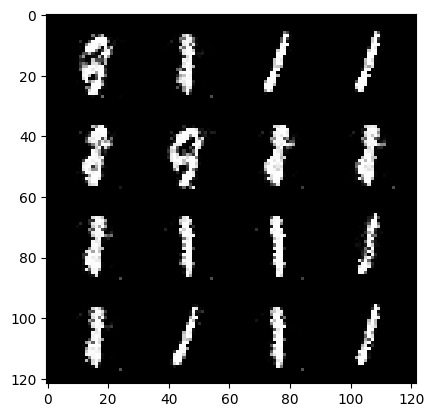

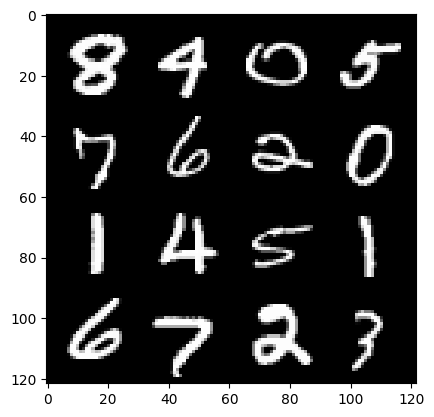

Epoch :32 , Step :20844 , Generator Loss :3.045896004747461 , Discriminator Loss :0.17347892187535763


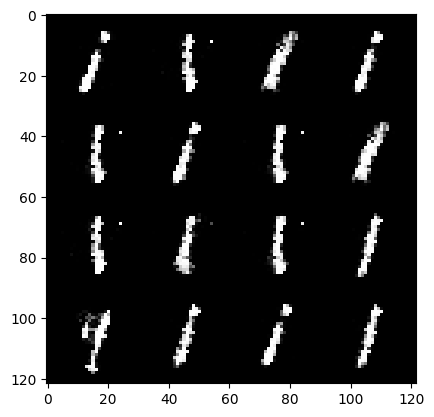

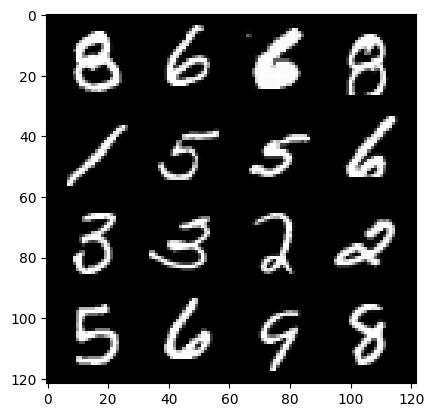

Epoch :32 , Step :20952 , Generator Loss :2.7784285258363797 , Discriminator Loss :0.1439728112546383


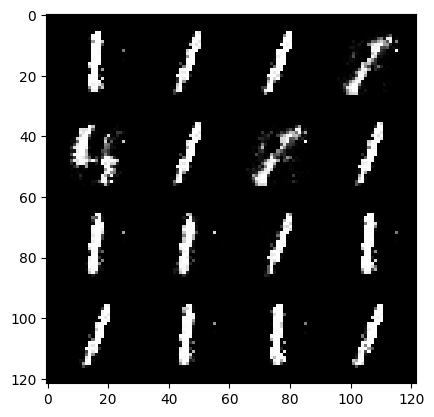

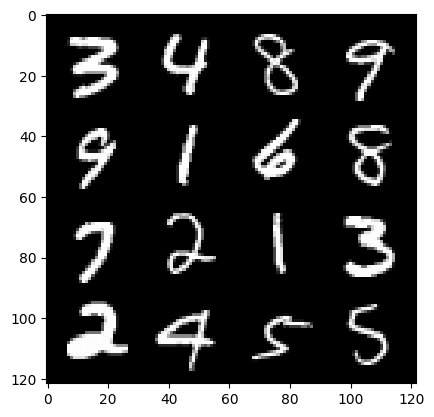

Epoch :32 , Step :21060 , Generator Loss :2.8393184034912684 , Discriminator Loss :0.14687092629847692


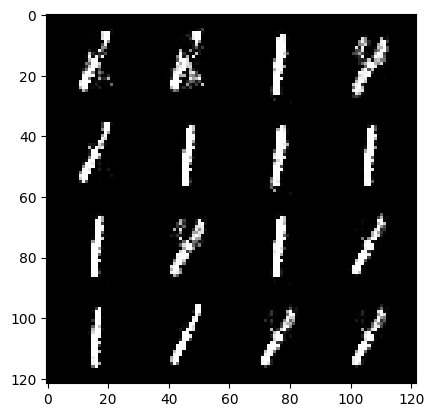

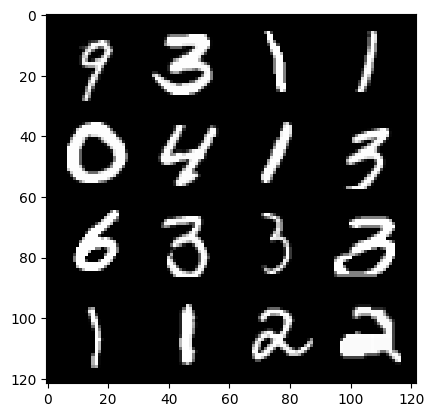

Epoch :32 , Step :21168 , Generator Loss :3.005311745184439 , Discriminator Loss :0.13511926673904615


  0%|          | 0/469 [00:00<?, ?it/s]

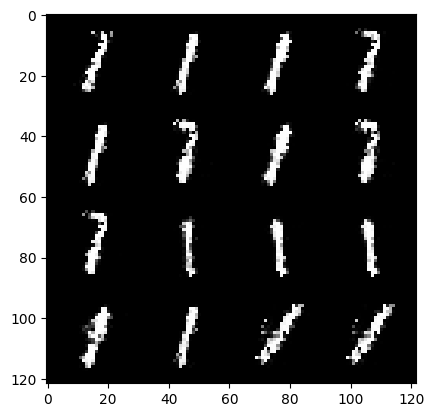

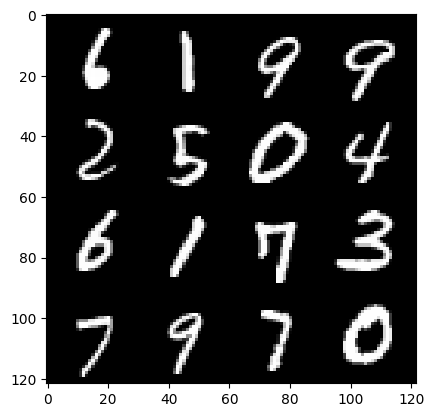

Epoch :33 , Step :21276 , Generator Loss :3.2032196499683248 , Discriminator Loss :0.14132745601926688


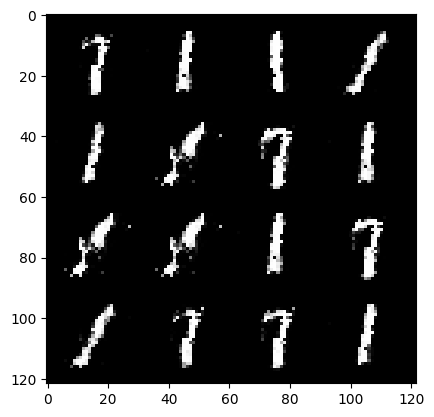

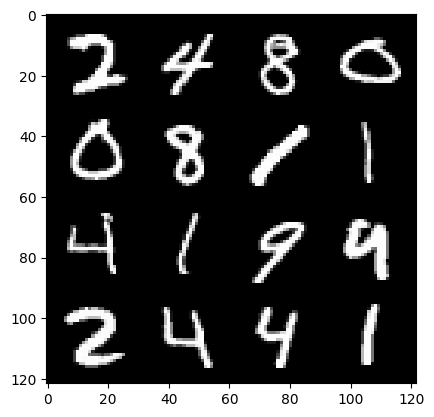

Epoch :33 , Step :21384 , Generator Loss :2.8399195273717237 , Discriminator Loss :0.15320311631593445


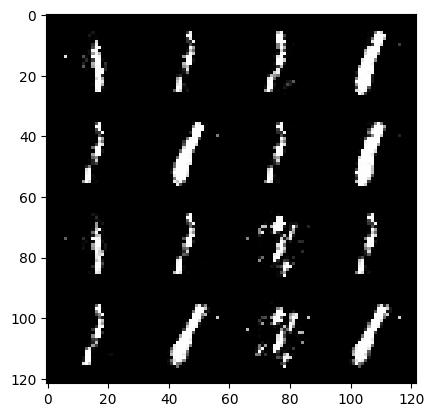

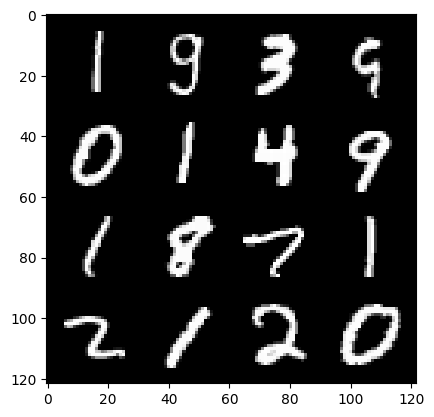

Epoch :33 , Step :21492 , Generator Loss :2.93788653170621 , Discriminator Loss :0.15441743049908574


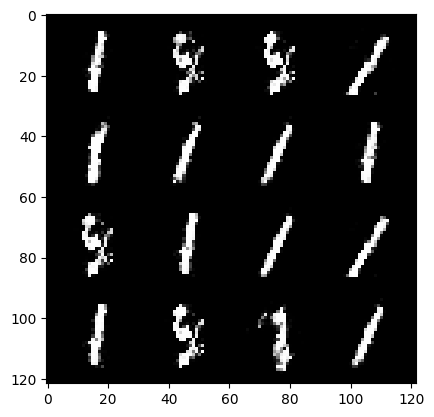

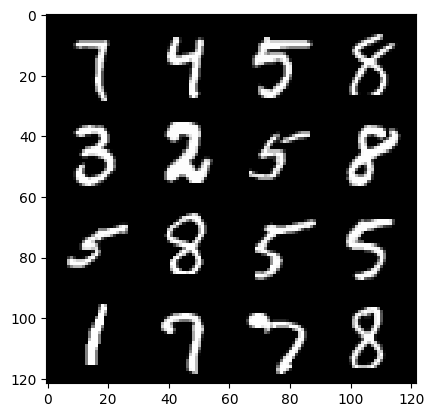

Epoch :33 , Step :21600 , Generator Loss :2.748956459539907 , Discriminator Loss :0.1500055201489616


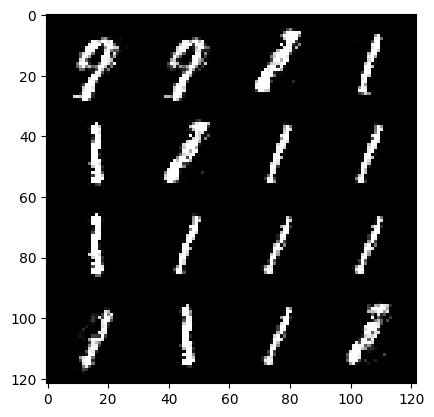

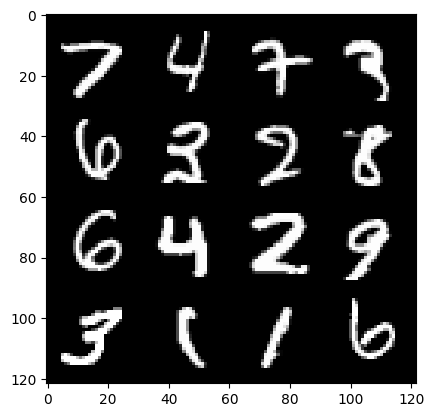

Epoch :33 , Step :21708 , Generator Loss :2.6866583559248176 , Discriminator Loss :0.1728227414466717


  0%|          | 0/469 [00:00<?, ?it/s]

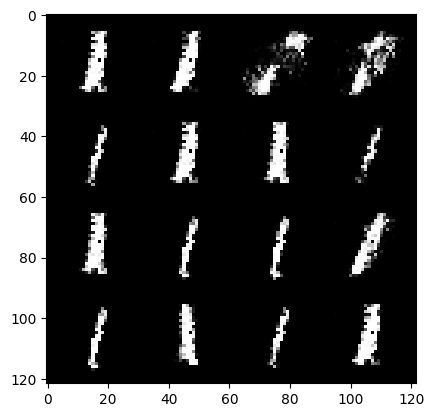

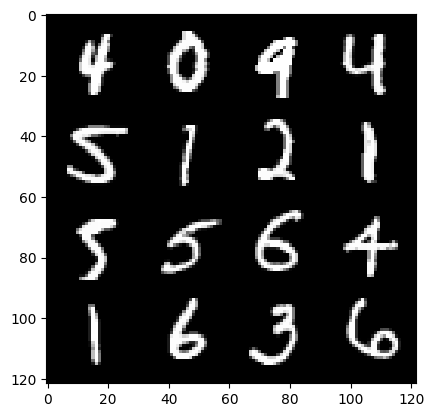

Epoch :34 , Step :21816 , Generator Loss :3.089694504384641 , Discriminator Loss :0.1275383905611105


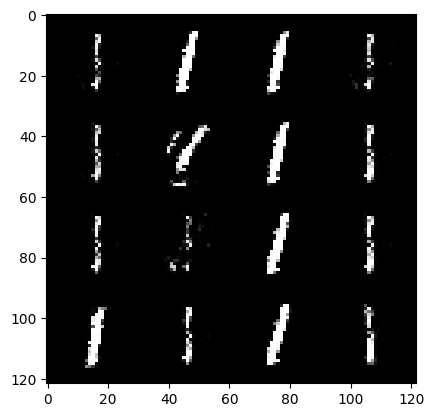

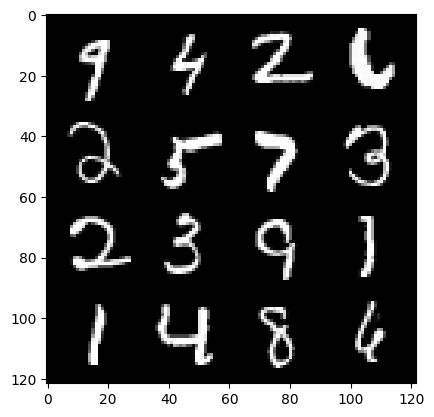

Epoch :34 , Step :21924 , Generator Loss :2.8750061701845238 , Discriminator Loss :0.15221018889160062


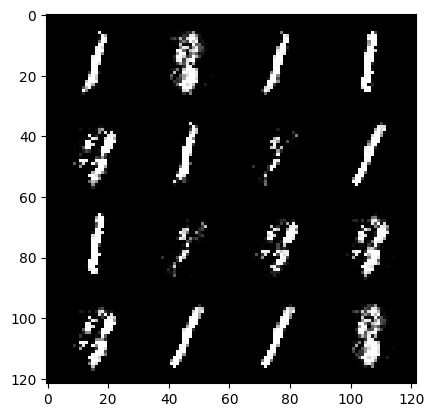

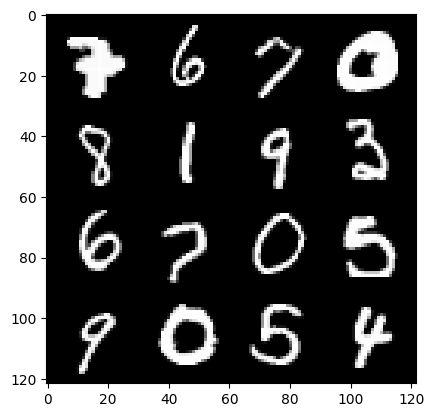

Epoch :34 , Step :22032 , Generator Loss :3.3478736722910845 , Discriminator Loss :0.11888482366447098


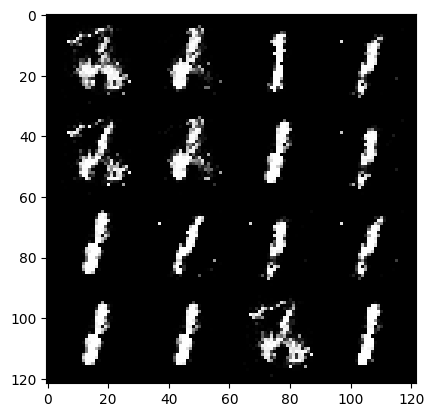

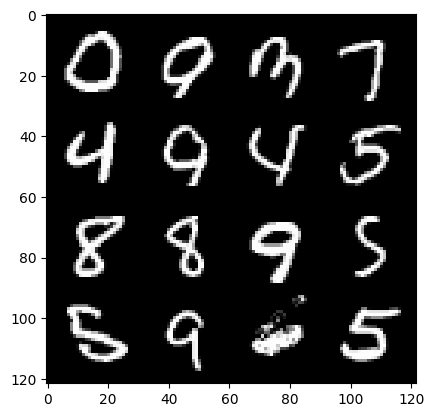

Epoch :34 , Step :22140 , Generator Loss :3.609356292971858 , Discriminator Loss :0.12761254946666734


  0%|          | 0/469 [00:00<?, ?it/s]

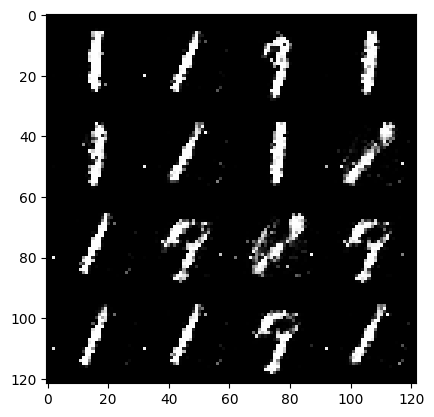

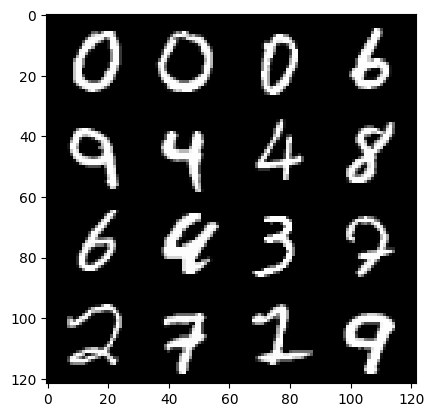

Epoch :35 , Step :22248 , Generator Loss :3.326564247961398 , Discriminator Loss :0.14205541875627306


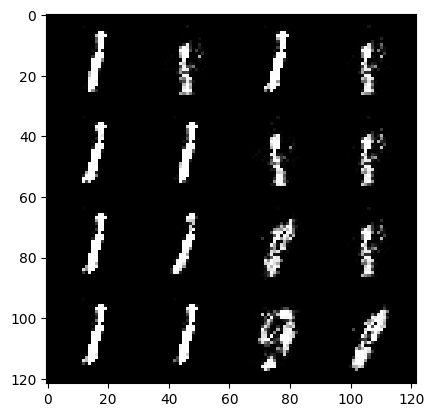

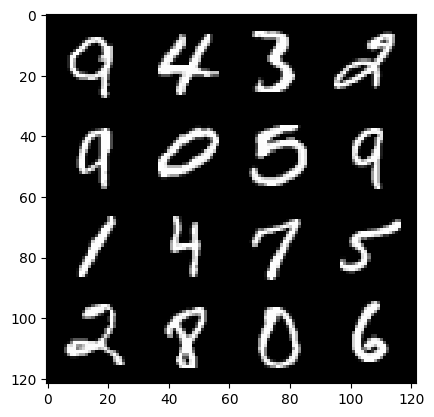

Epoch :35 , Step :22356 , Generator Loss :3.2510091839013278 , Discriminator Loss :0.142510015172539


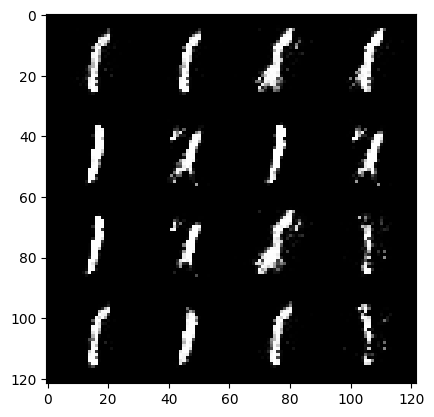

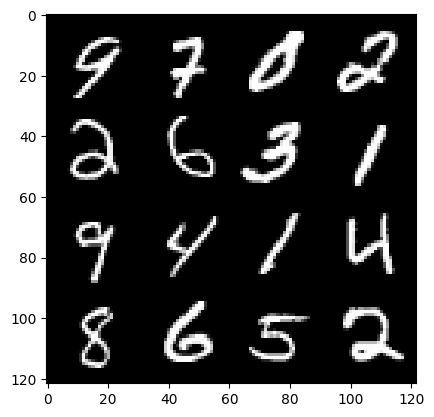

Epoch :35 , Step :22464 , Generator Loss :3.1814167654072807 , Discriminator Loss :0.14038003029094803


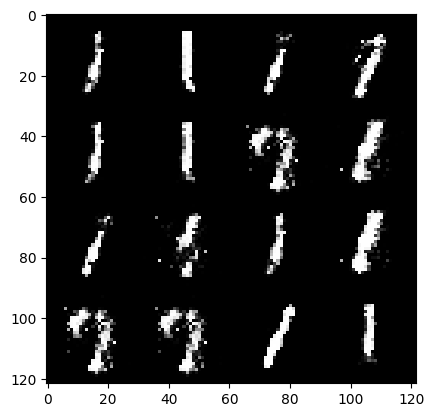

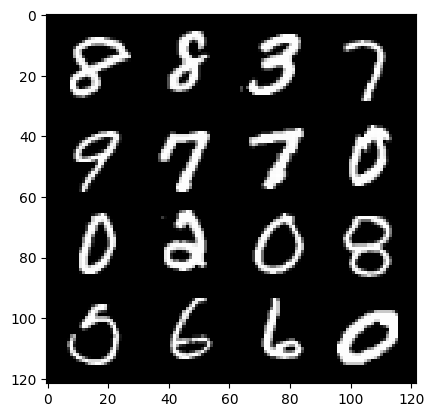

Epoch :35 , Step :22572 , Generator Loss :2.985687518561329 , Discriminator Loss :0.15983783626170064


  0%|          | 0/469 [00:00<?, ?it/s]

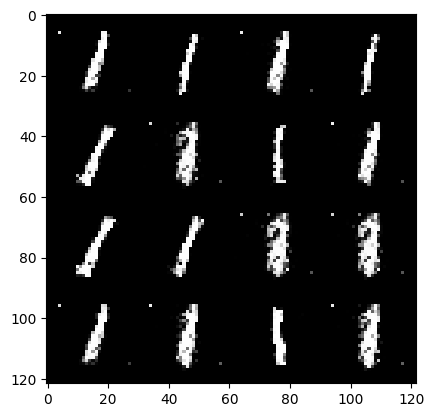

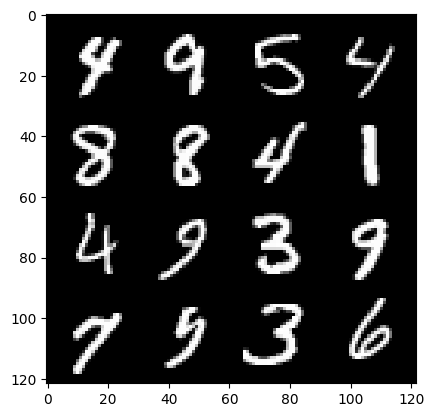

Epoch :36 , Step :22680 , Generator Loss :3.0917712118890575 , Discriminator Loss :0.1439811931923032


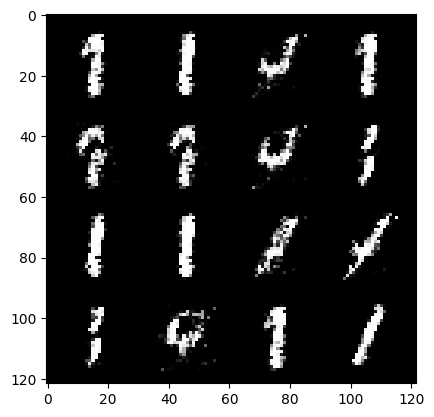

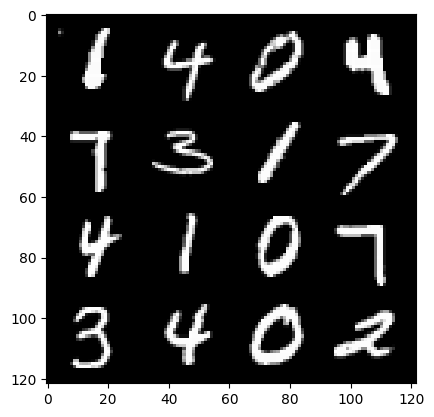

Epoch :36 , Step :22788 , Generator Loss :2.6778208613395695 , Discriminator Loss :0.17124136737375348


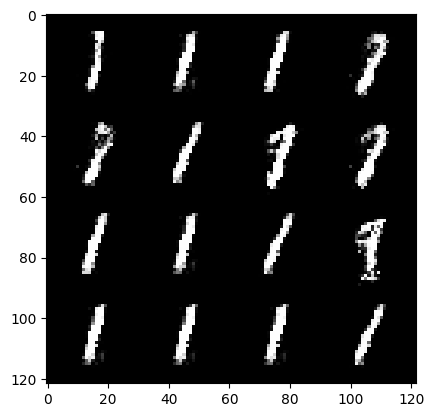

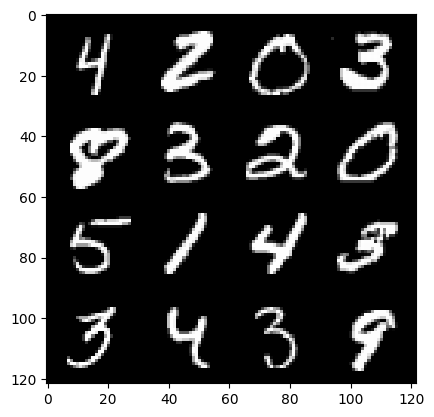

Epoch :36 , Step :22896 , Generator Loss :2.6583366923862024 , Discriminator Loss :0.165721271187067


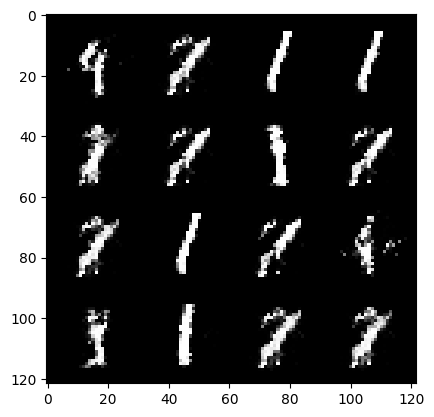

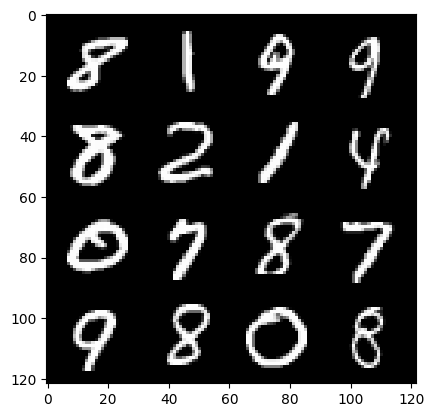

Epoch :36 , Step :23004 , Generator Loss :2.9606337392771676 , Discriminator Loss :0.1486349795013666


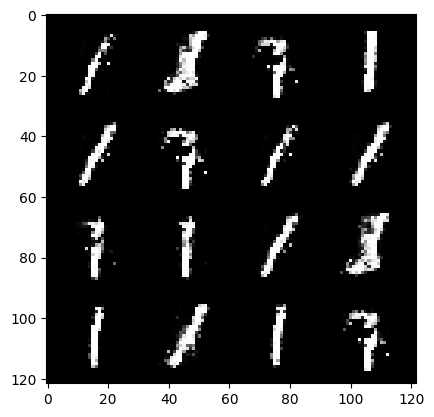

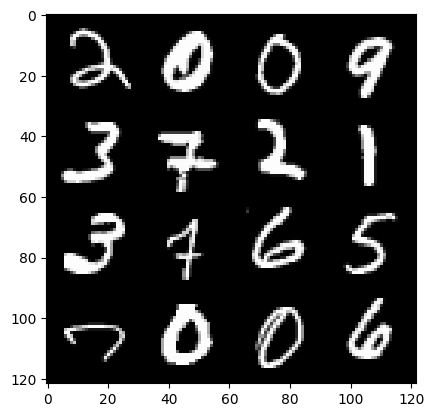

Epoch :36 , Step :23112 , Generator Loss :3.1251628641728995 , Discriminator Loss :0.13132240806050882


  0%|          | 0/469 [00:00<?, ?it/s]

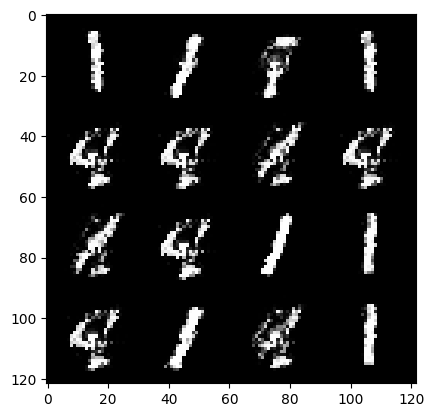

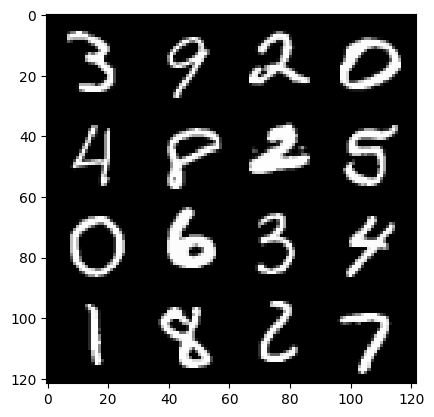

Epoch :37 , Step :23220 , Generator Loss :3.234793497456445 , Discriminator Loss :0.18058052127835922


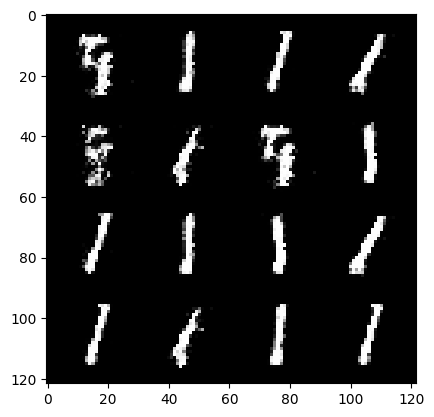

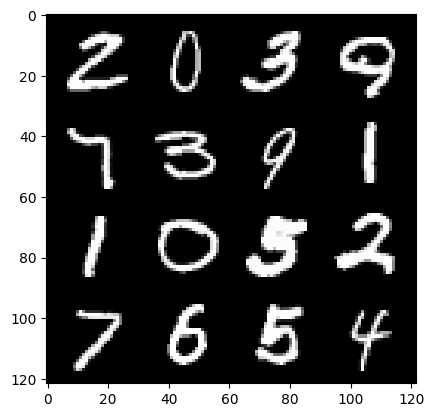

Epoch :37 , Step :23328 , Generator Loss :2.6798173785209665 , Discriminator Loss :0.15712146136771746


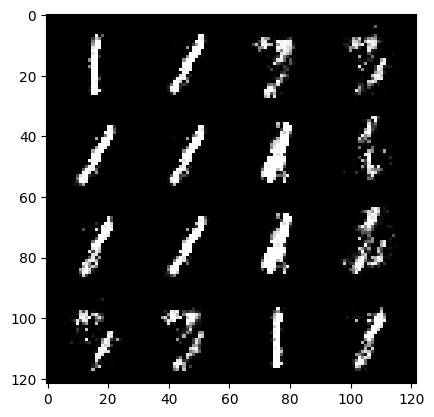

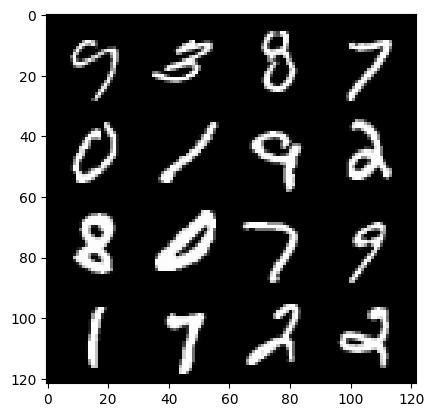

Epoch :37 , Step :23436 , Generator Loss :2.877783841556974 , Discriminator Loss :0.1616470626796838


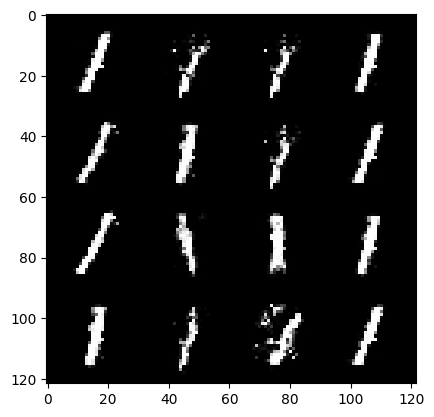

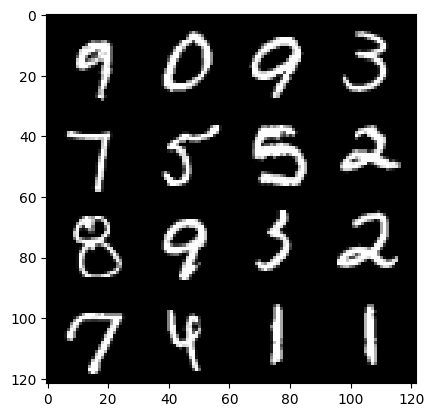

Epoch :37 , Step :23544 , Generator Loss :2.940378897719914 , Discriminator Loss :0.14830976972977328


  0%|          | 0/469 [00:00<?, ?it/s]

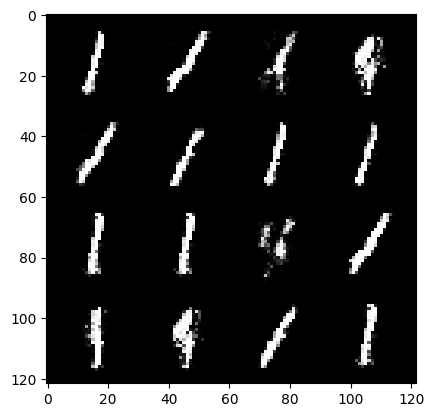

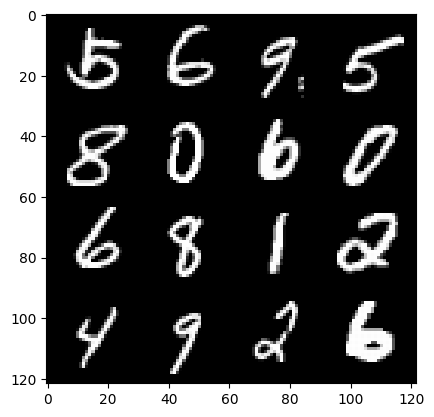

Epoch :38 , Step :23652 , Generator Loss :2.8804750663262824 , Discriminator Loss :0.1760644605038343


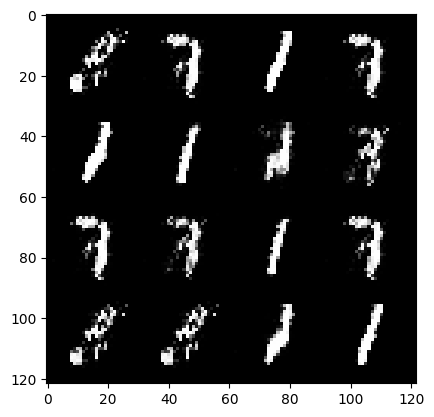

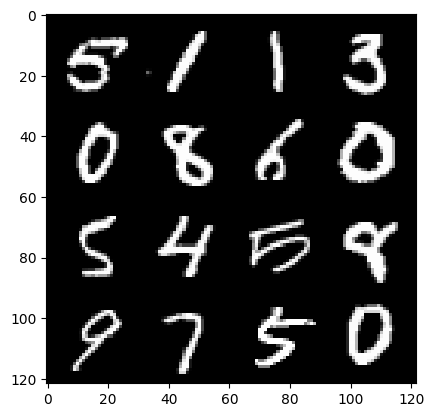

Epoch :38 , Step :23760 , Generator Loss :2.702719339617975 , Discriminator Loss :0.16345370533289727


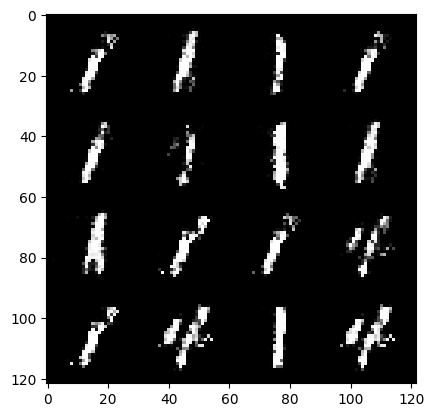

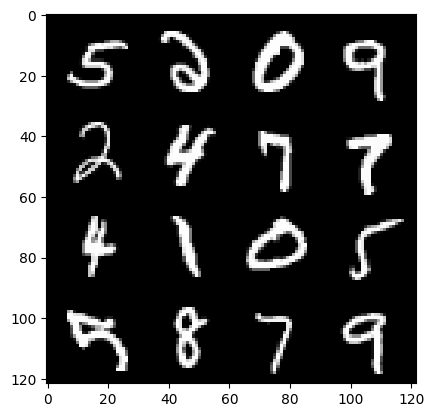

Epoch :38 , Step :23868 , Generator Loss :2.9332150022188808 , Discriminator Loss :0.14119734394329567


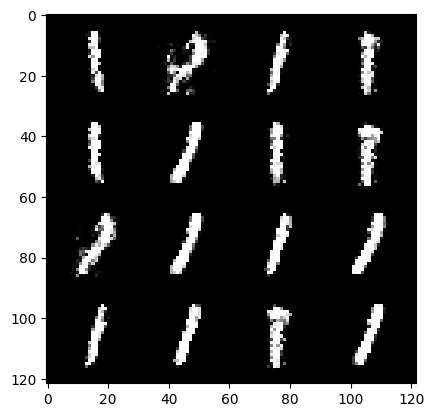

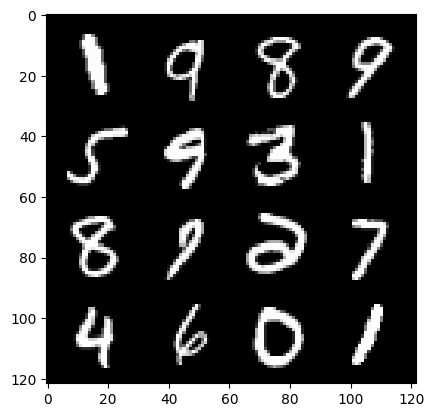

Epoch :38 , Step :23976 , Generator Loss :3.1199367752781613 , Discriminator Loss :0.12609693963356594


  0%|          | 0/469 [00:00<?, ?it/s]

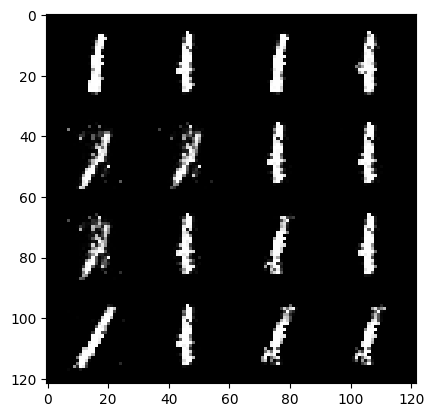

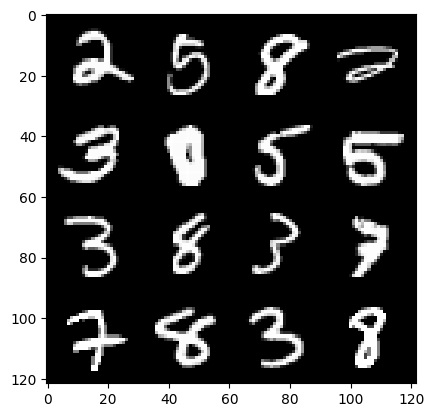

Epoch :39 , Step :24084 , Generator Loss :3.174933038375997 , Discriminator Loss :0.1376108519250043


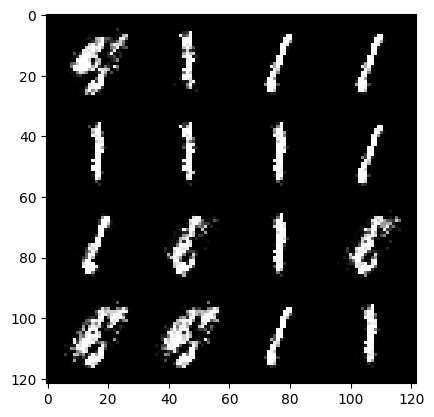

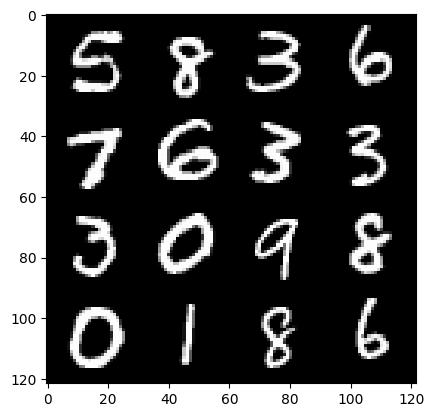

Epoch :39 , Step :24192 , Generator Loss :3.1851588862913633 , Discriminator Loss :0.13761927228834897


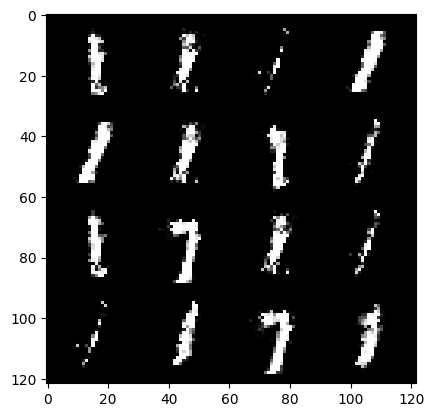

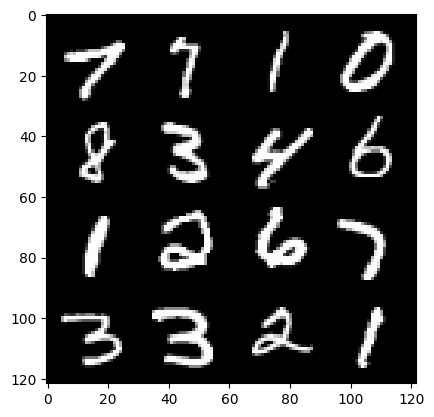

Epoch :39 , Step :24300 , Generator Loss :3.2099611869564764 , Discriminator Loss :0.1363349511046653


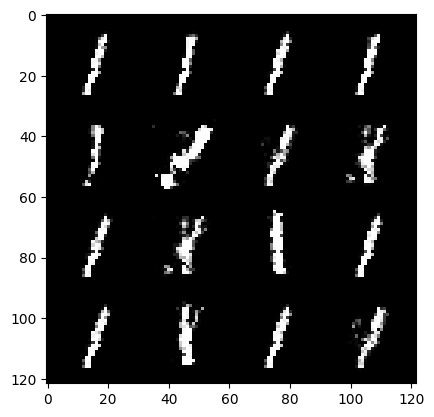

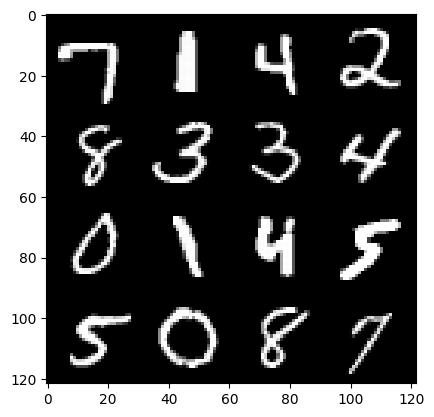

Epoch :39 , Step :24408 , Generator Loss :2.8499549119560816 , Discriminator Loss :0.15034455323108917


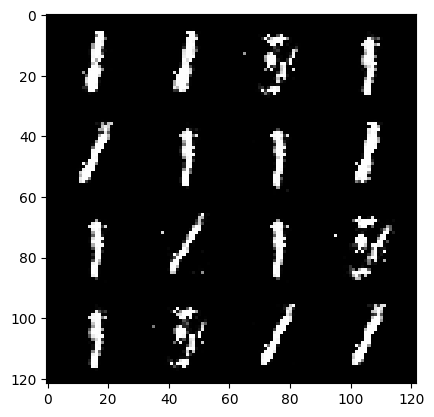

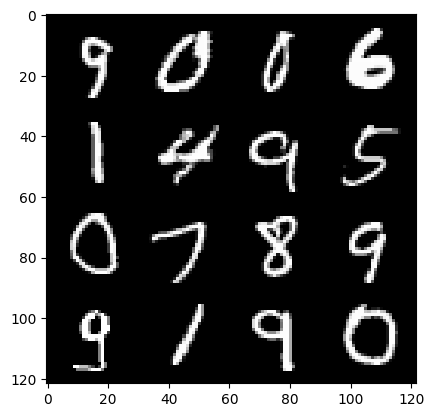

Epoch :39 , Step :24516 , Generator Loss :3.0646908989659054 , Discriminator Loss :0.11493594309797996


  0%|          | 0/469 [00:00<?, ?it/s]

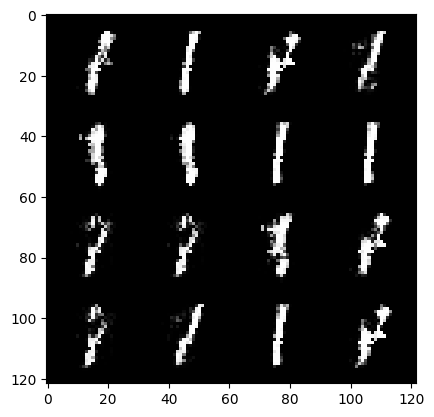

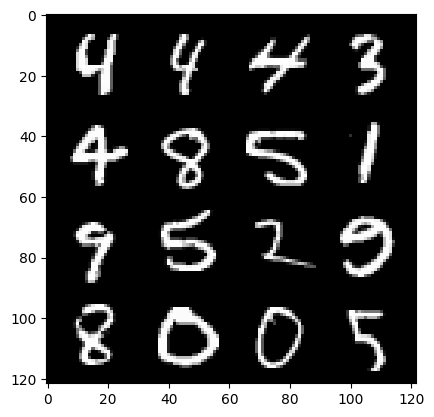

Epoch :40 , Step :24624 , Generator Loss :3.482193414811735 , Discriminator Loss :0.10713864643885582


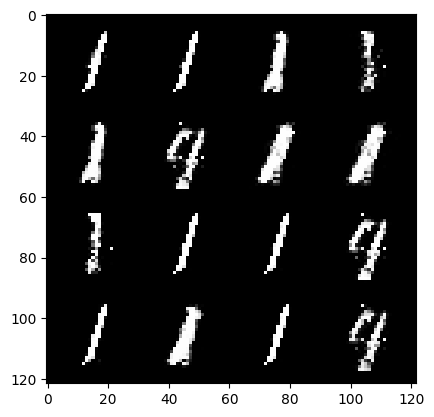

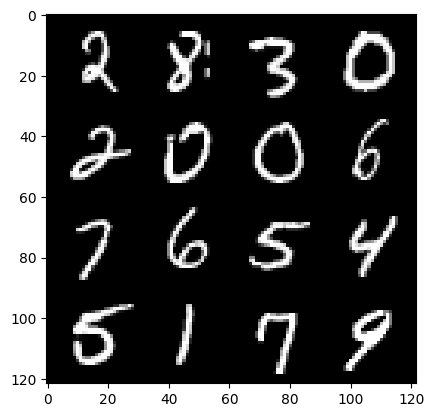

Epoch :40 , Step :24732 , Generator Loss :3.504162613992336 , Discriminator Loss :0.09739739302959713


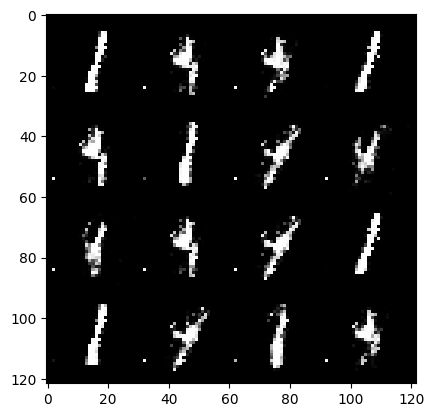

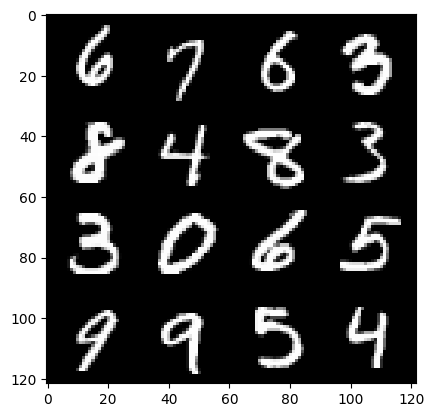

Epoch :40 , Step :24840 , Generator Loss :3.5783000323507537 , Discriminator Loss :0.10571820840791421


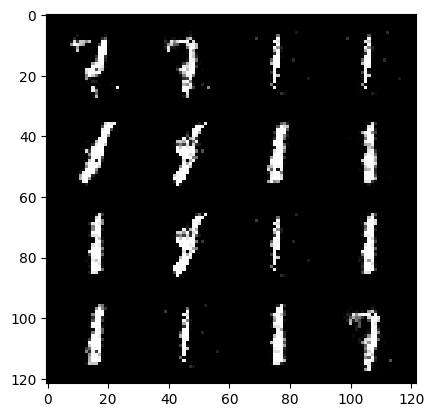

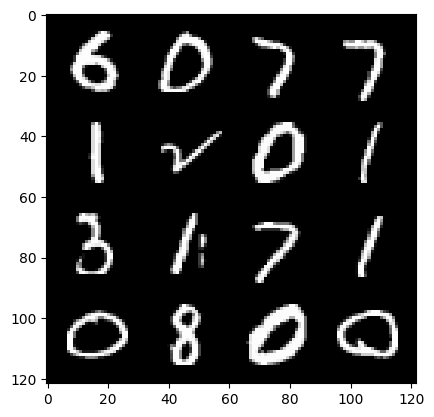

Epoch :40 , Step :24948 , Generator Loss :3.559926127945935 , Discriminator Loss :0.1055364902993595


  0%|          | 0/469 [00:00<?, ?it/s]

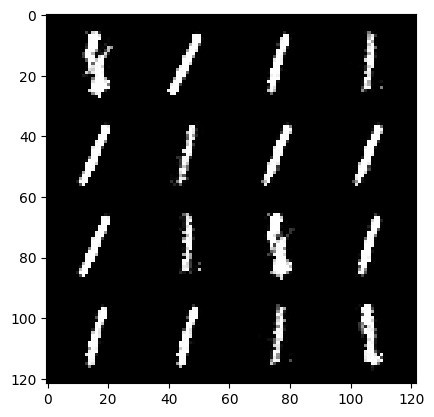

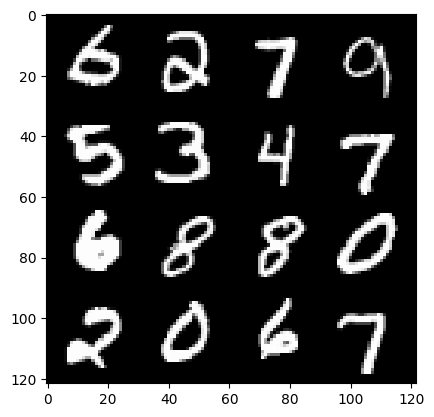

Epoch :41 , Step :25056 , Generator Loss :3.220864342318641 , Discriminator Loss :0.1316736398126791


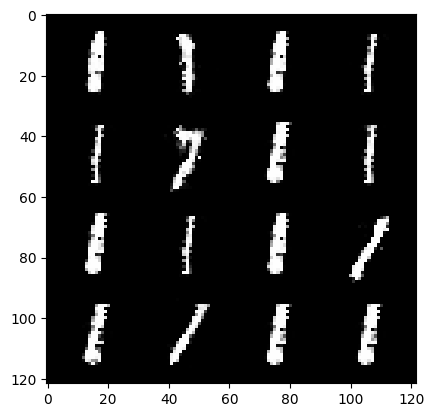

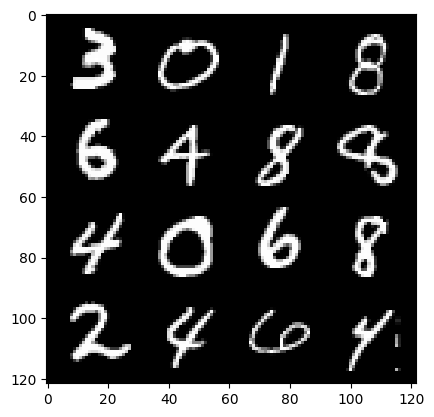

Epoch :41 , Step :25164 , Generator Loss :3.0097937032028494 , Discriminator Loss :0.14256290812045327


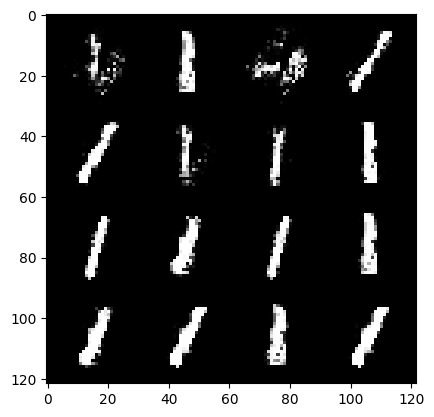

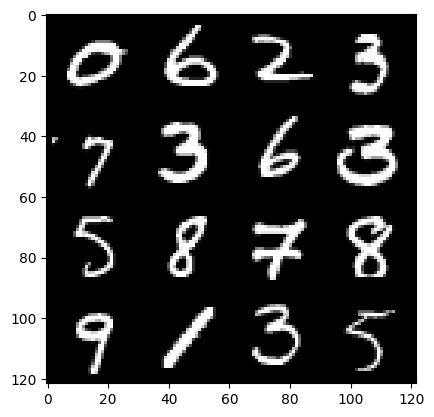

Epoch :41 , Step :25272 , Generator Loss :3.0720147468425627 , Discriminator Loss :0.15355512592941523


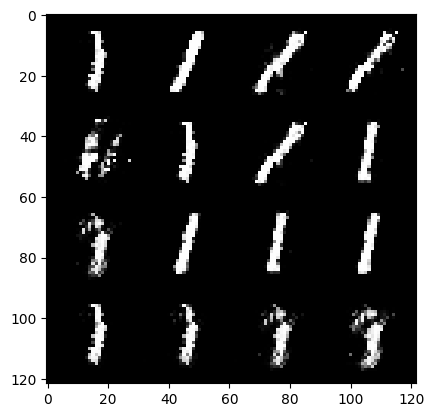

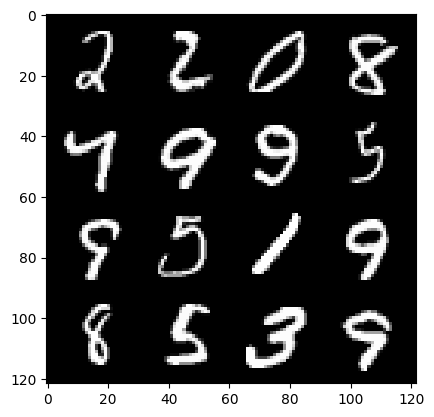

Epoch :41 , Step :25380 , Generator Loss :2.7772891742211794 , Discriminator Loss :0.1536257707134441


  0%|          | 0/469 [00:00<?, ?it/s]

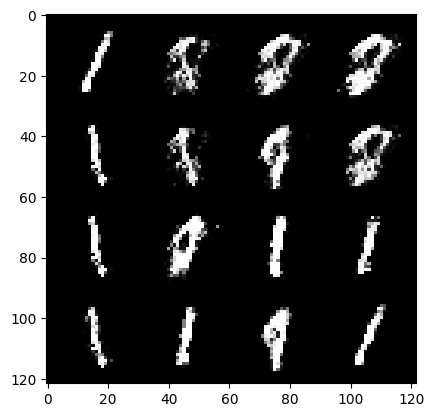

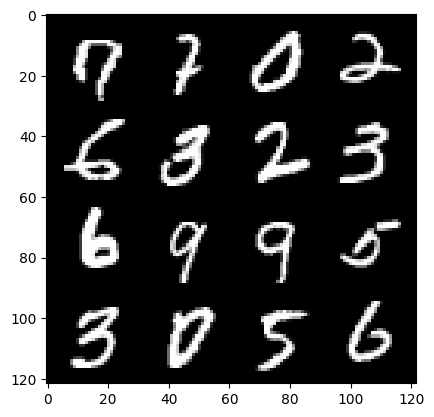

Epoch :42 , Step :25488 , Generator Loss :2.812367419401805 , Discriminator Loss :0.16418421613397421


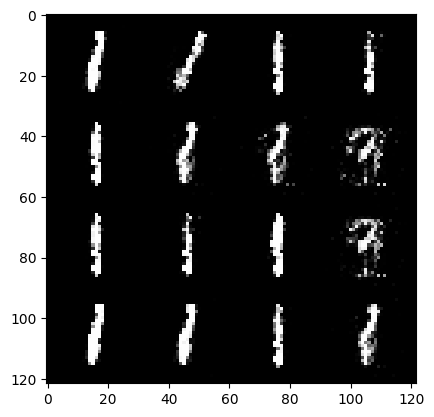

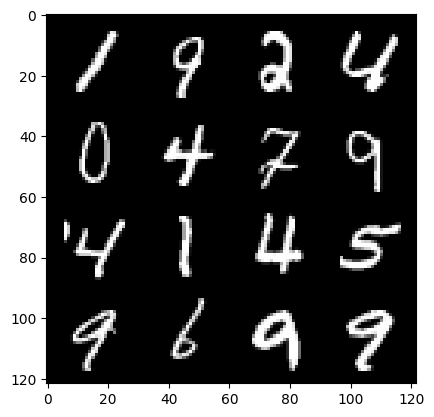

Epoch :42 , Step :25596 , Generator Loss :2.8144292191222853 , Discriminator Loss :0.15651055163255442


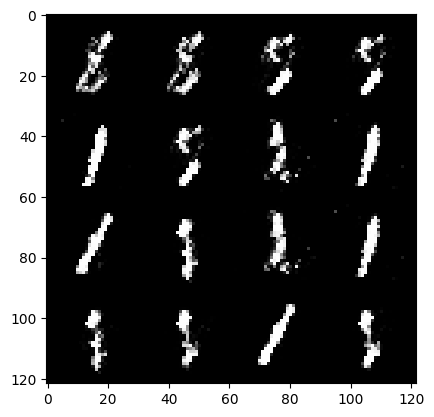

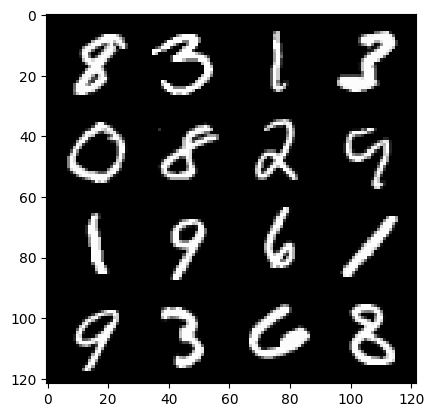

Epoch :42 , Step :25704 , Generator Loss :3.081790932902583 , Discriminator Loss :0.14116101932746392


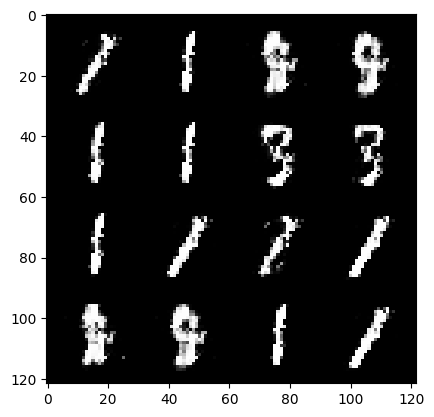

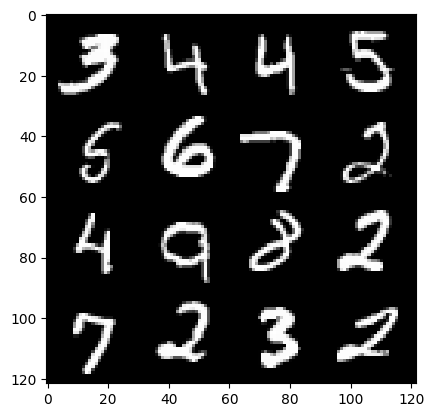

Epoch :42 , Step :25812 , Generator Loss :3.1787715311403617 , Discriminator Loss :0.1450224884406284


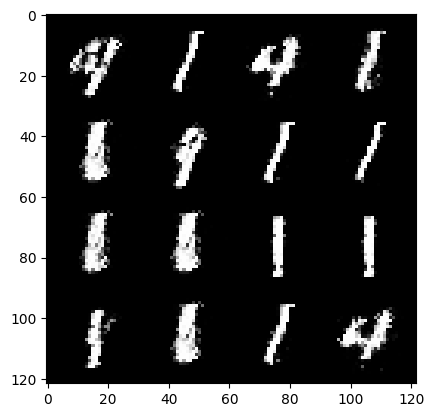

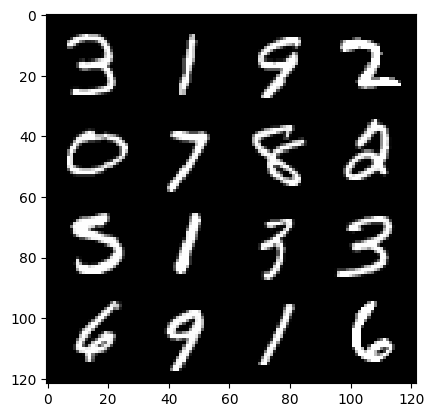

Epoch :42 , Step :25920 , Generator Loss :3.425090549168762 , Discriminator Loss :0.13801047247317105


  0%|          | 0/469 [00:00<?, ?it/s]

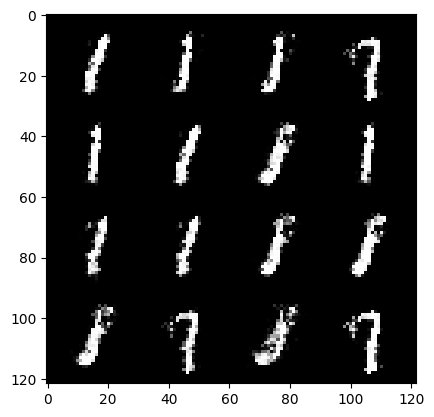

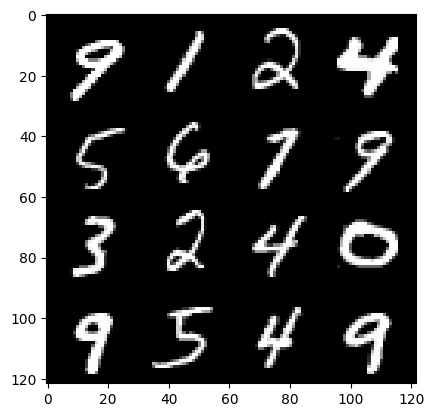

Epoch :43 , Step :26028 , Generator Loss :2.889932773731374 , Discriminator Loss :0.16824549402075797


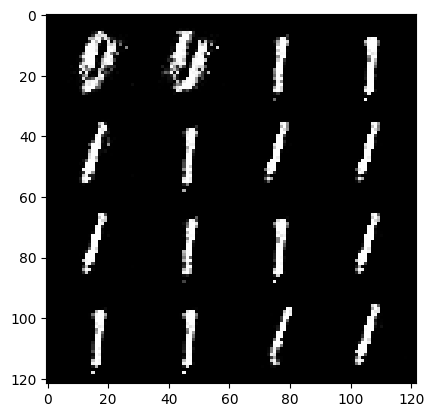

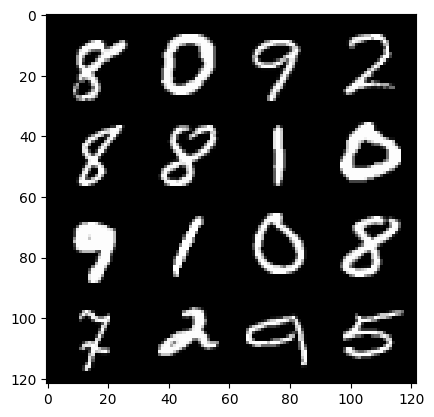

Epoch :43 , Step :26136 , Generator Loss :2.917793920746556 , Discriminator Loss :0.13763085600954514


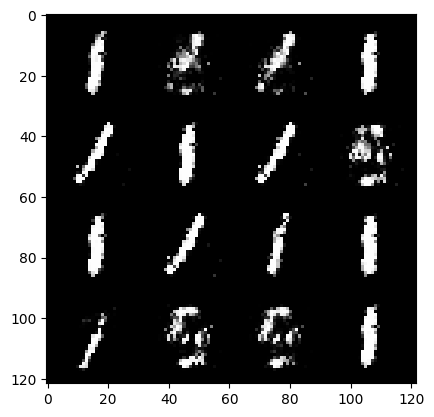

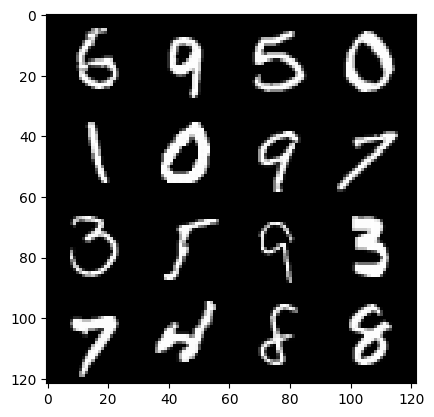

Epoch :43 , Step :26244 , Generator Loss :3.269859007111302 , Discriminator Loss :0.17170838197624258


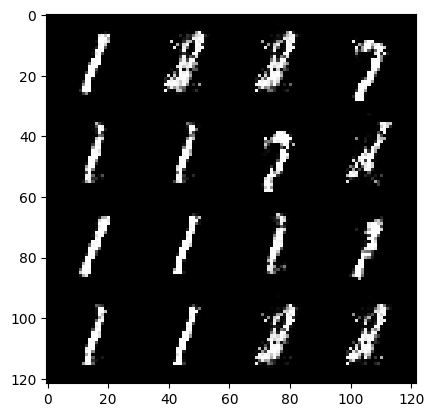

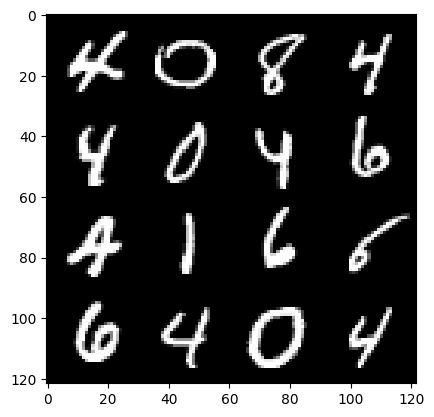

Epoch :43 , Step :26352 , Generator Loss :2.9478635213993205 , Discriminator Loss :0.15497270226478568


  0%|          | 0/469 [00:00<?, ?it/s]

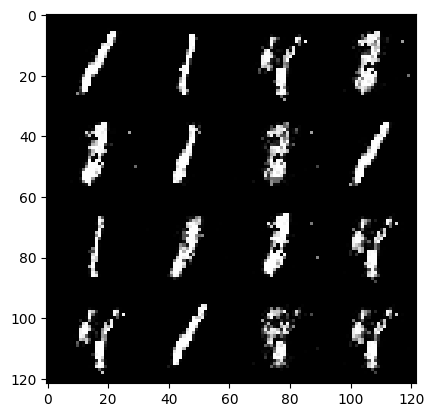

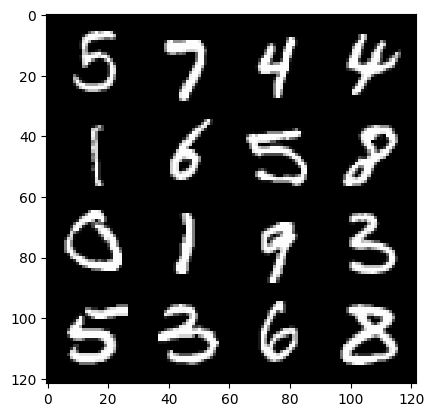

Epoch :44 , Step :26460 , Generator Loss :3.0742167609709274 , Discriminator Loss :0.17951405979692933


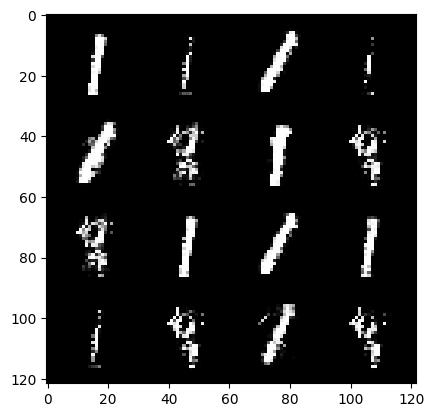

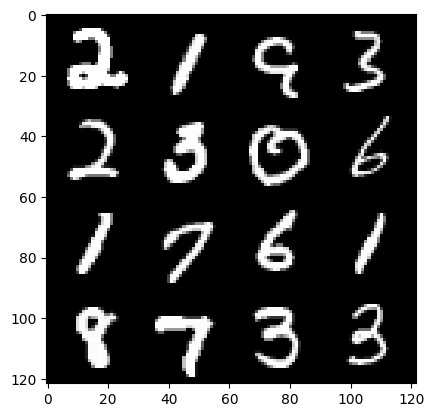

Epoch :44 , Step :26568 , Generator Loss :2.7550795608096657 , Discriminator Loss :0.15219141335950961


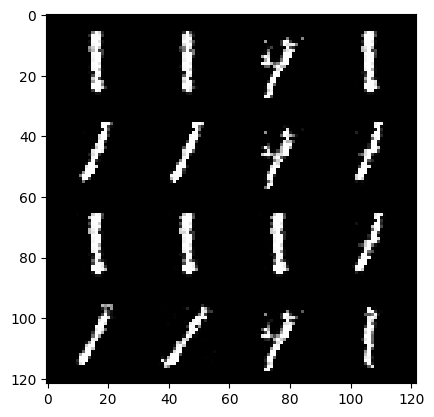

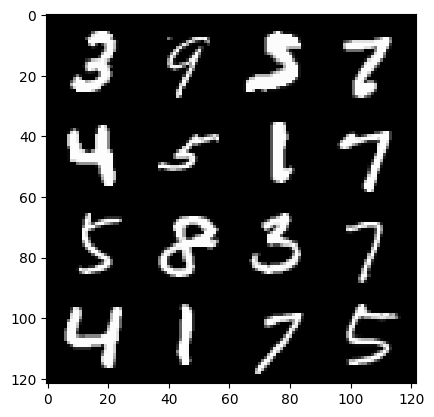

Epoch :44 , Step :26676 , Generator Loss :2.5011596216095806 , Discriminator Loss :0.1777387233795943


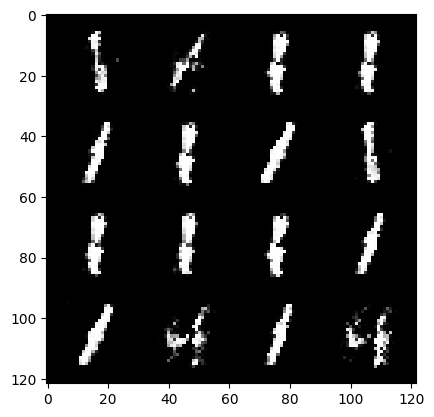

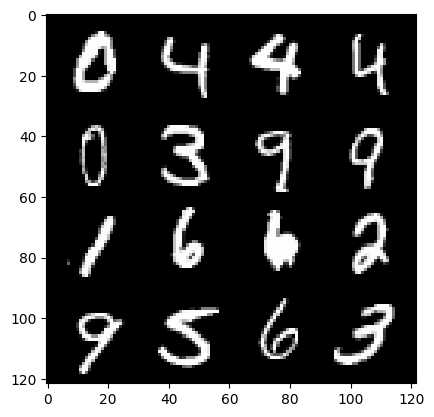

Epoch :44 , Step :26784 , Generator Loss :2.6565877464082495 , Discriminator Loss :0.14383895757297677


  0%|          | 0/469 [00:00<?, ?it/s]

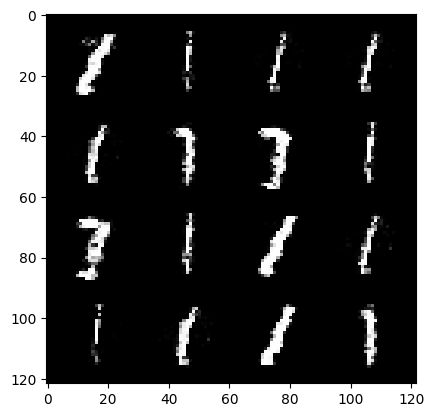

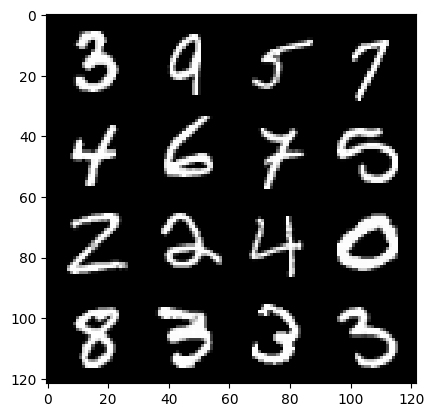

Epoch :45 , Step :26892 , Generator Loss :2.841464201609292 , Discriminator Loss :0.16110535407507864


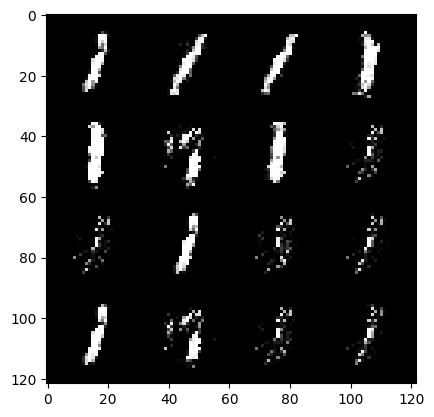

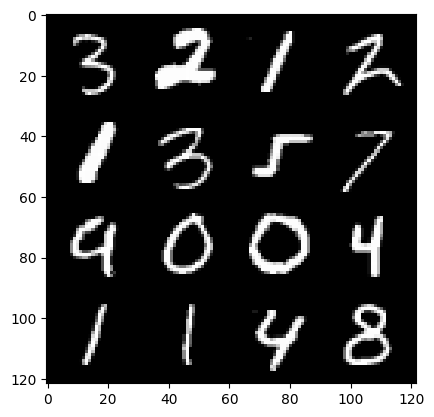

Epoch :45 , Step :27000 , Generator Loss :2.5939389423087786 , Discriminator Loss :0.180133823029421


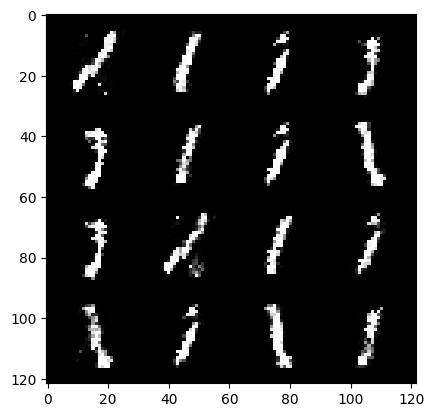

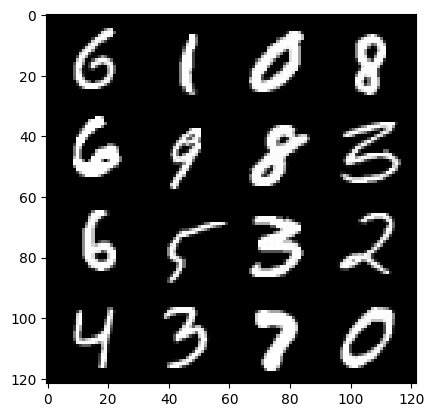

Epoch :45 , Step :27108 , Generator Loss :2.6832719710138124 , Discriminator Loss :0.14550636018867852


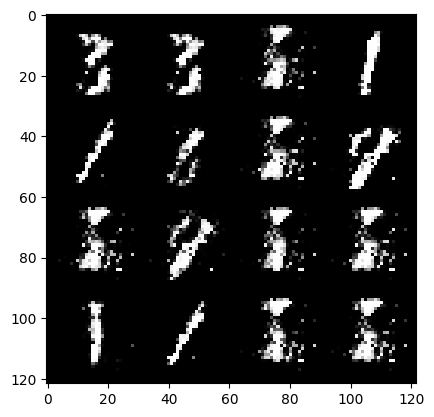

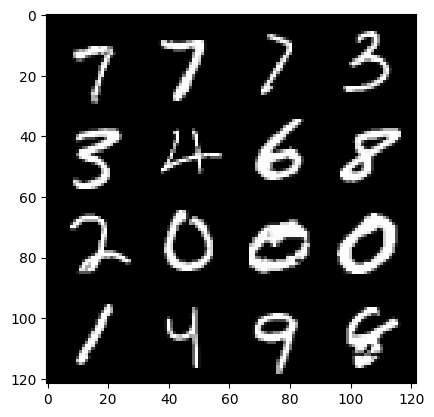

Epoch :45 , Step :27216 , Generator Loss :3.0296569002999205 , Discriminator Loss :0.1973217545698086


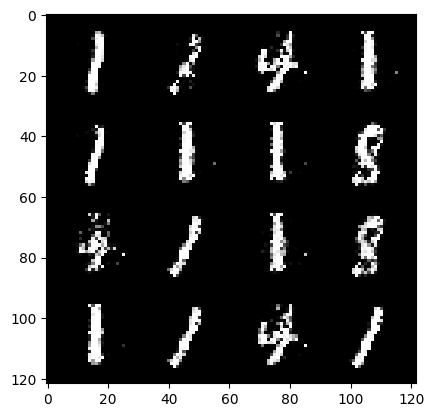

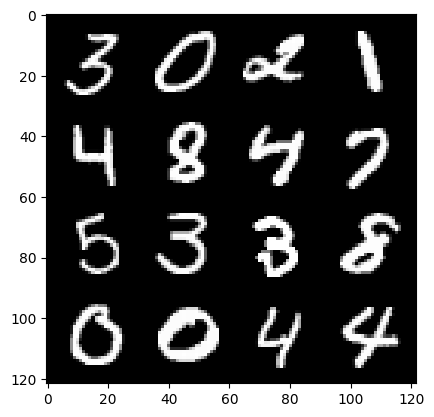

Epoch :45 , Step :27324 , Generator Loss :2.88622632291582 , Discriminator Loss :0.12495732148764313


  0%|          | 0/469 [00:00<?, ?it/s]

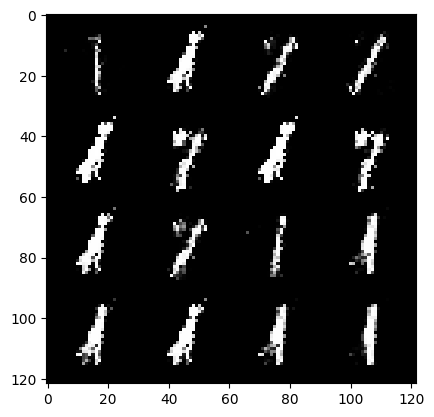

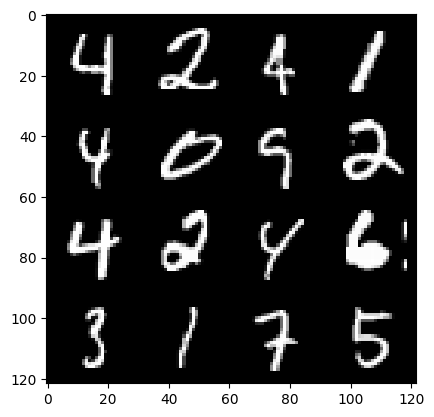

Epoch :46 , Step :27432 , Generator Loss :3.1297408055376126 , Discriminator Loss :0.1305856051406375


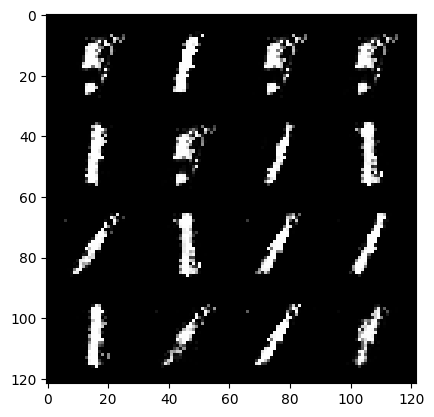

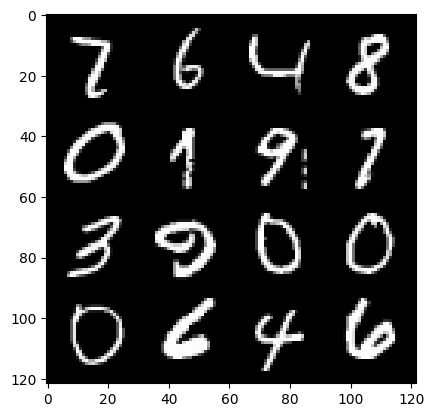

Epoch :46 , Step :27540 , Generator Loss :3.2753770859153186 , Discriminator Loss :0.16120905029001067


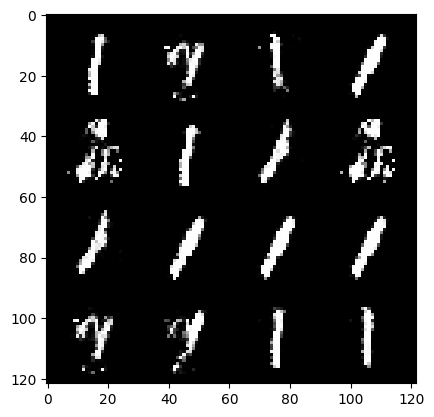

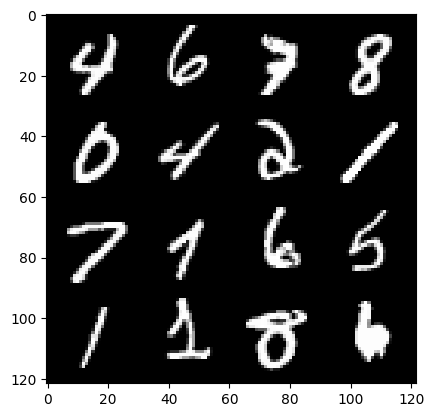

Epoch :46 , Step :27648 , Generator Loss :2.8347954242317766 , Discriminator Loss :0.1656880415286179


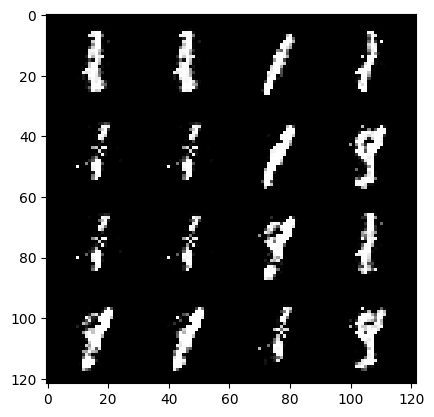

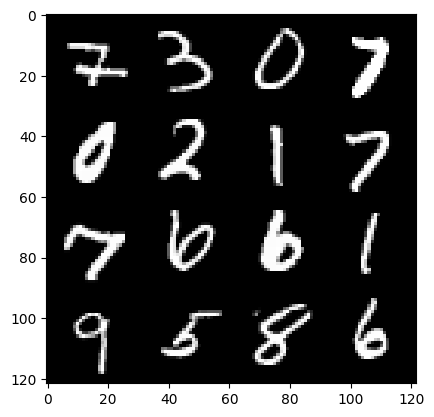

Epoch :46 , Step :27756 , Generator Loss :2.7089688557165648 , Discriminator Loss :0.14759960563646427


  0%|          | 0/469 [00:00<?, ?it/s]

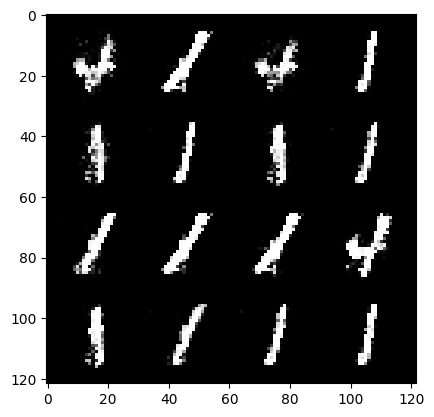

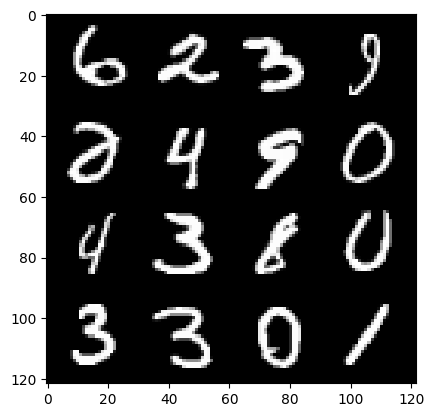

Epoch :47 , Step :27864 , Generator Loss :2.8071922858556113 , Discriminator Loss :0.16413659064306163


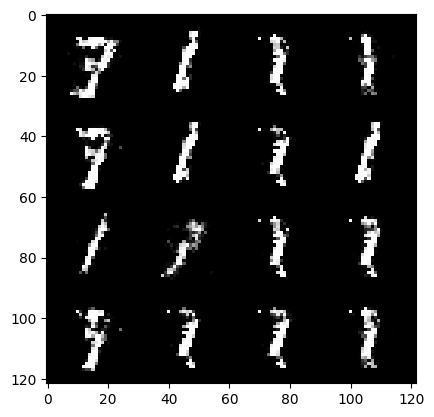

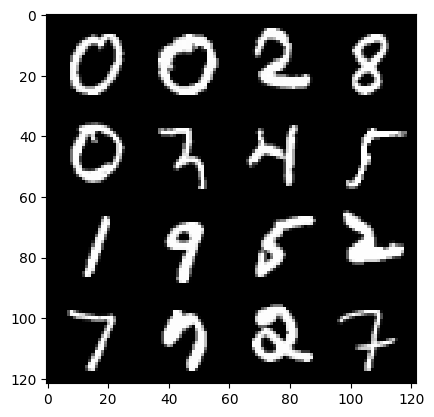

Epoch :47 , Step :27972 , Generator Loss :3.129547242765073 , Discriminator Loss :0.12364673138492635


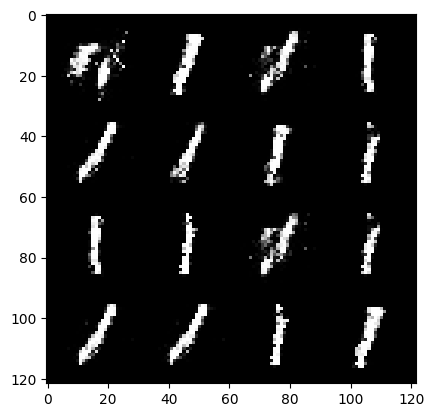

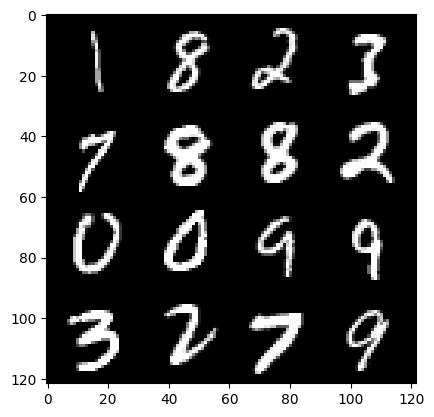

Epoch :47 , Step :28080 , Generator Loss :3.2432159384091697 , Discriminator Loss :0.1517048228739036


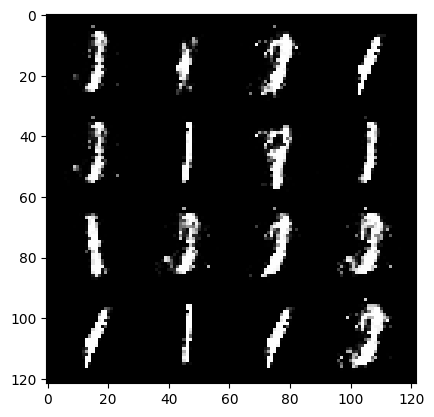

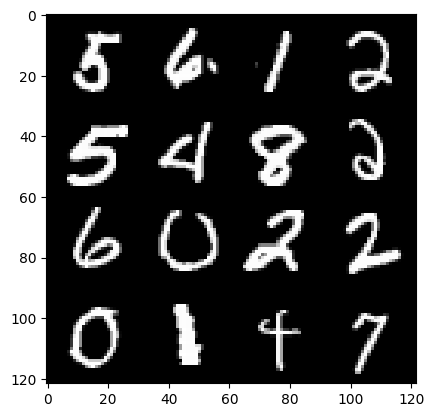

Epoch :47 , Step :28188 , Generator Loss :2.8490239072729038 , Discriminator Loss :0.15477484457746699


  0%|          | 0/469 [00:00<?, ?it/s]

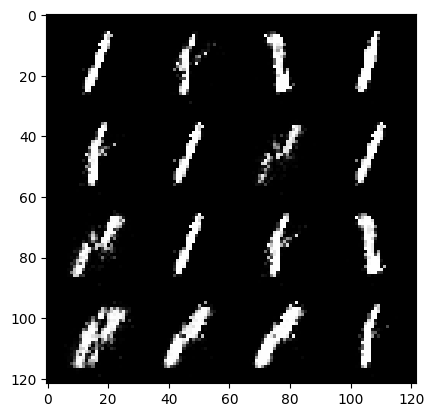

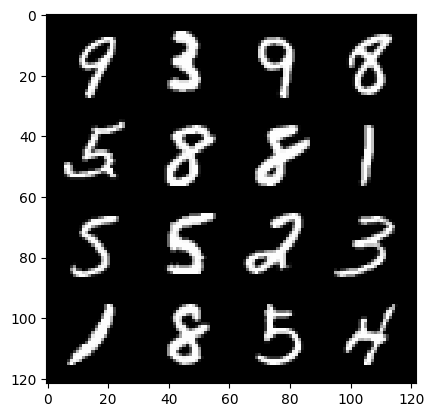

Epoch :48 , Step :28296 , Generator Loss :3.4464239235277514 , Discriminator Loss :0.1330198321008572


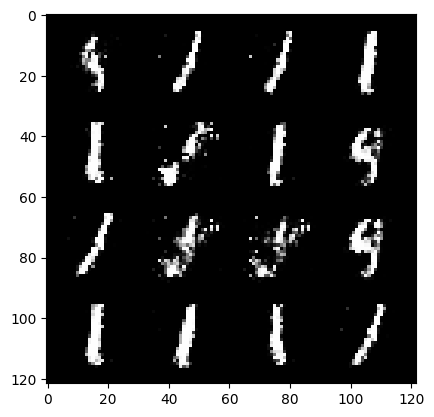

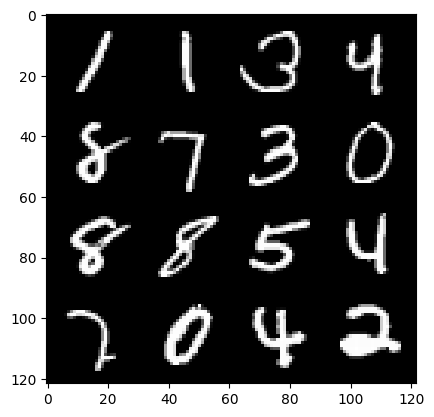

Epoch :48 , Step :28404 , Generator Loss :2.7619043147122424 , Discriminator Loss :0.1543841300601209


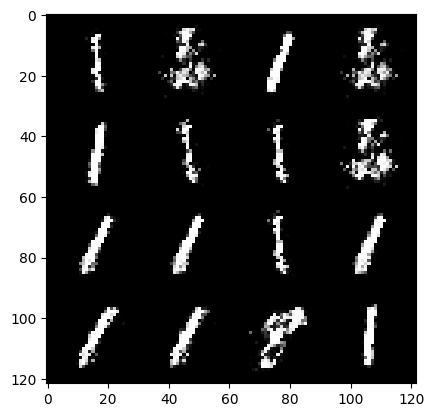

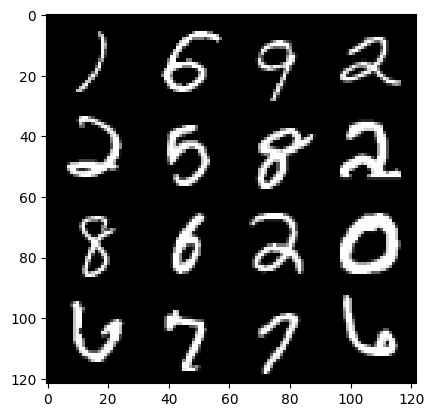

Epoch :48 , Step :28512 , Generator Loss :2.737318235415001 , Discriminator Loss :0.1657465096839048


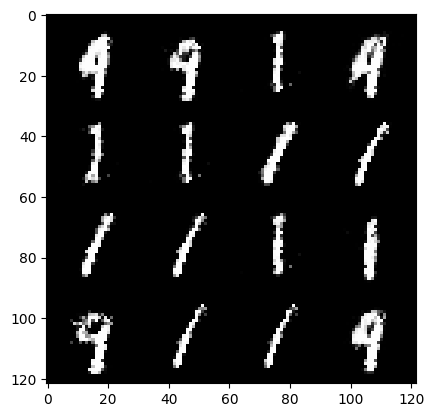

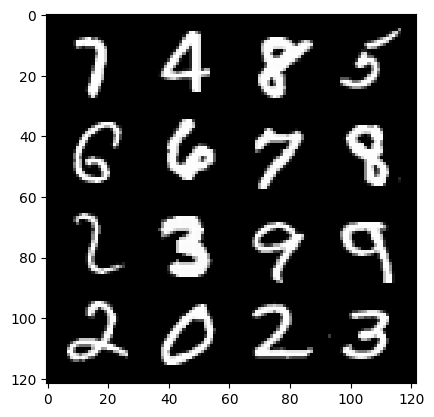

Epoch :48 , Step :28620 , Generator Loss :2.673478991897017 , Discriminator Loss :0.18493563371400037


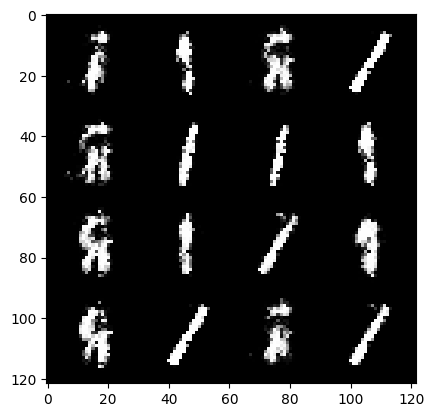

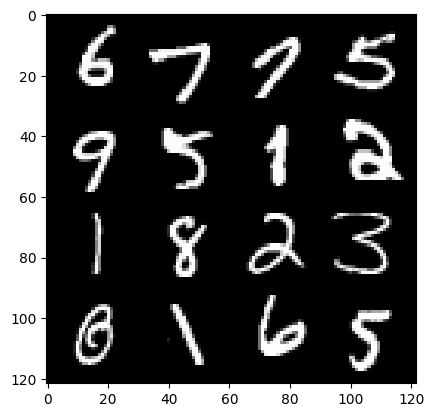

Epoch :48 , Step :28728 , Generator Loss :2.8942690094312025 , Discriminator Loss :0.17742721246624435


  0%|          | 0/469 [00:00<?, ?it/s]

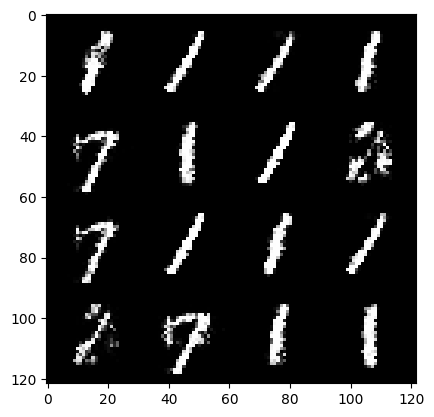

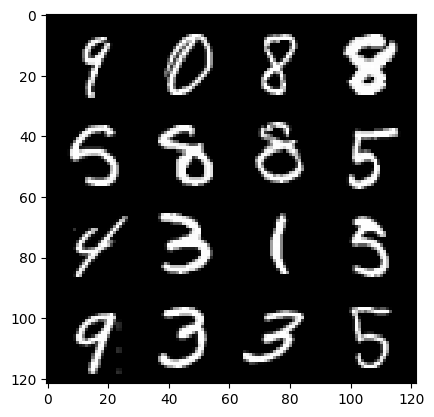

Epoch :49 , Step :28836 , Generator Loss :2.5001945528719154 , Discriminator Loss :0.1895713447420684


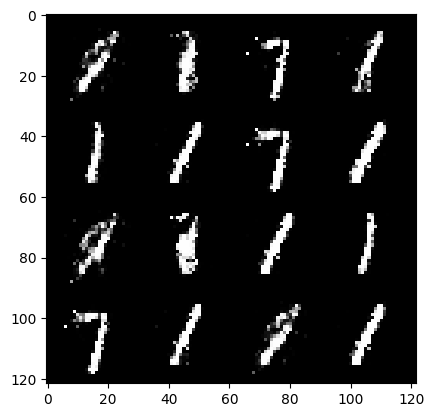

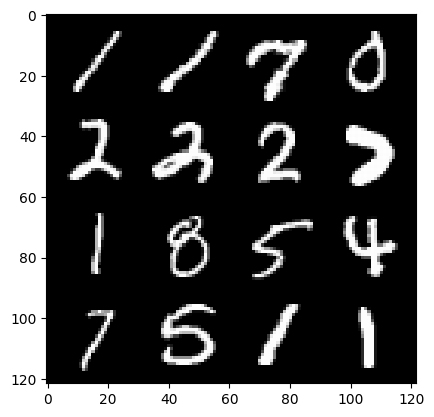

Epoch :49 , Step :28944 , Generator Loss :2.565486298667059 , Discriminator Loss :0.18809849334259823


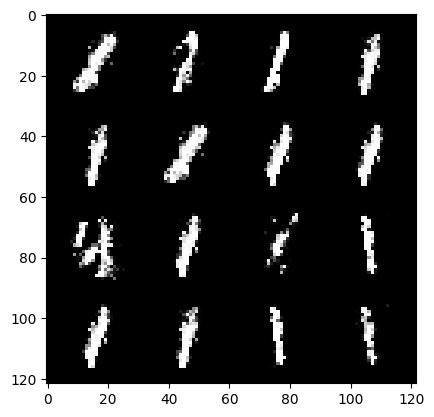

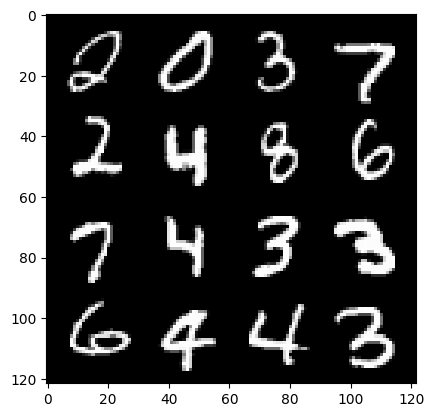

Epoch :49 , Step :29052 , Generator Loss :2.54244824471297 , Discriminator Loss :0.17477707730399247


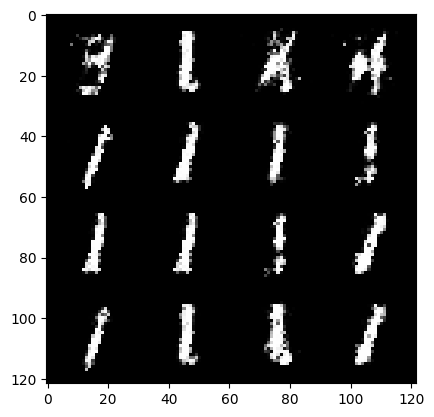

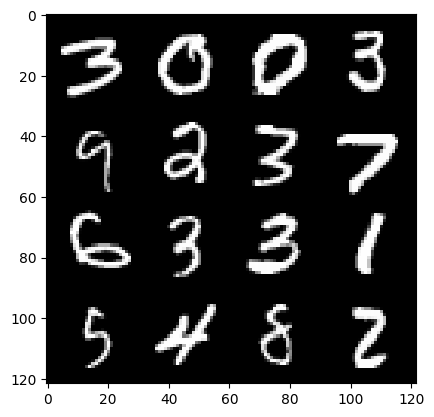

Epoch :49 , Step :29160 , Generator Loss :2.5828492531069993 , Discriminator Loss :0.19869310595095155


  0%|          | 0/469 [00:00<?, ?it/s]

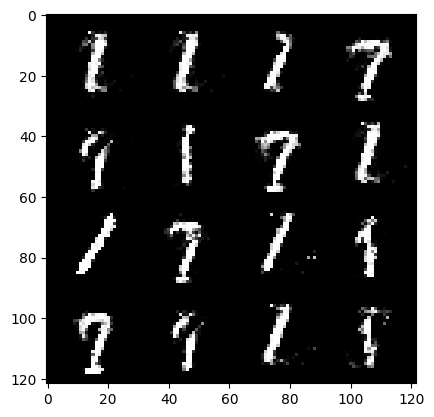

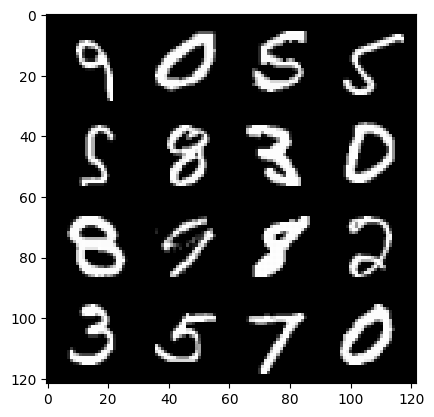

Epoch :50 , Step :29268 , Generator Loss :2.4311600250226477 , Discriminator Loss :0.22174360747966504


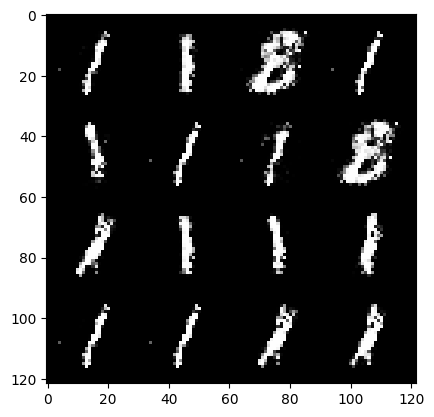

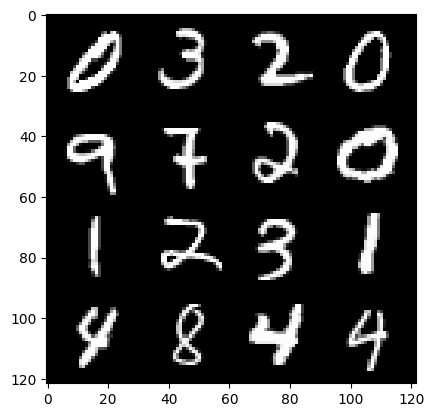

Epoch :50 , Step :29376 , Generator Loss :2.382653488053214 , Discriminator Loss :0.20391940670432868


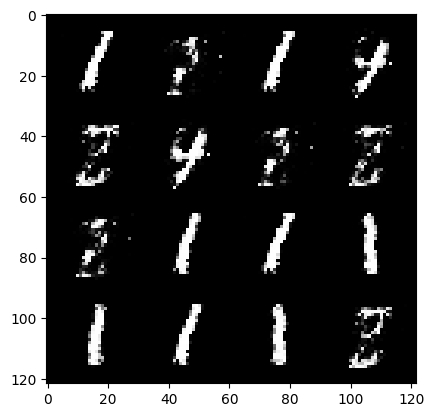

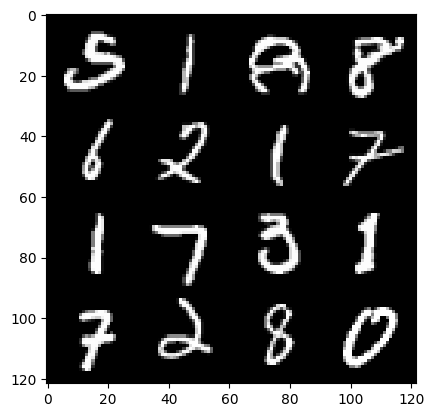

Epoch :50 , Step :29484 , Generator Loss :2.4161599940723826 , Discriminator Loss :0.18069398913670467


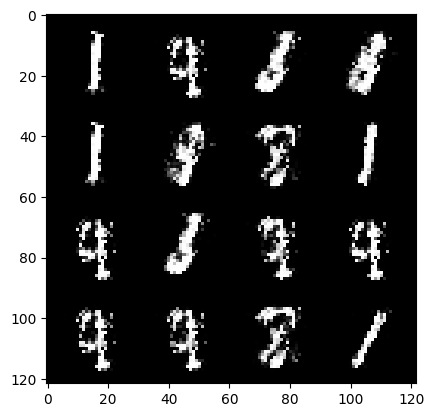

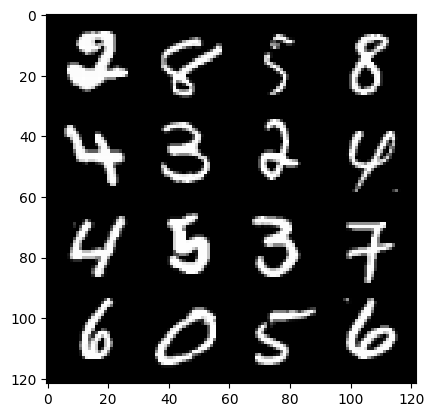

Epoch :50 , Step :29592 , Generator Loss :2.7601426265857842 , Discriminator Loss :0.184982460613052


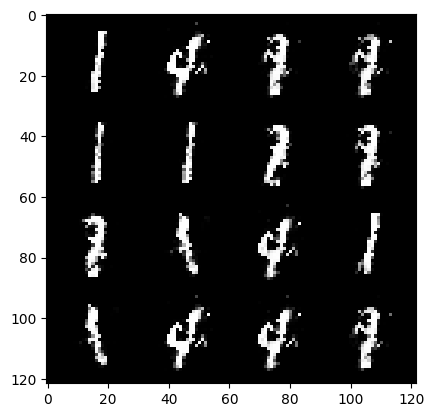

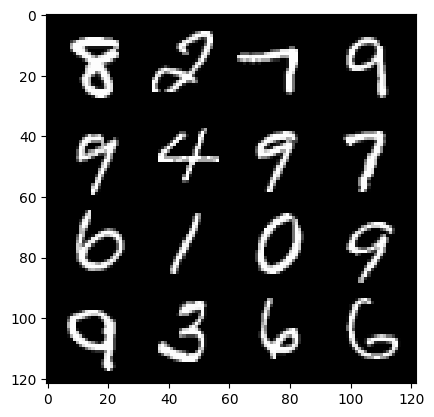

Epoch :50 , Step :29700 , Generator Loss :2.7025950087441335 , Discriminator Loss :0.19683705491048312


  0%|          | 0/469 [00:00<?, ?it/s]

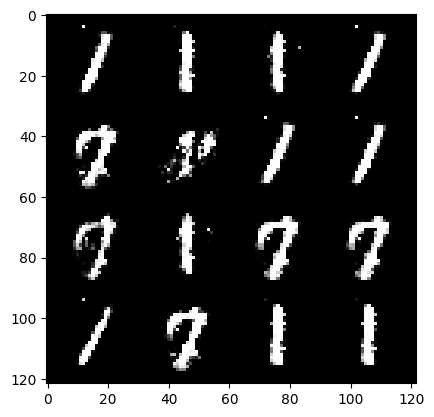

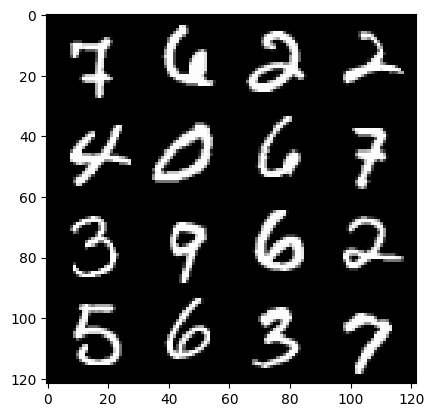

Epoch :51 , Step :29808 , Generator Loss :2.589321829654553 , Discriminator Loss :0.20789980860771953


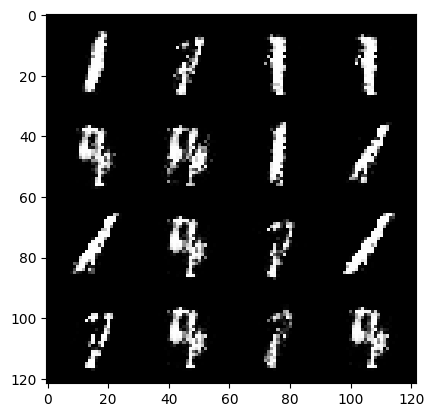

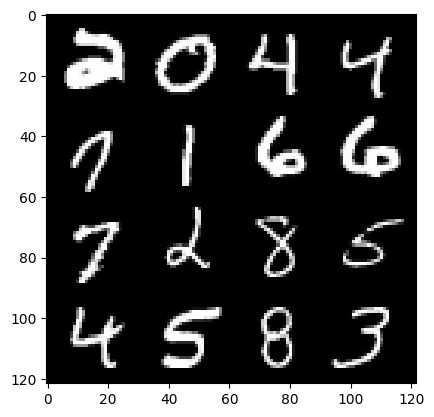

Epoch :51 , Step :29916 , Generator Loss :2.470083486150812 , Discriminator Loss :0.1797755499266916


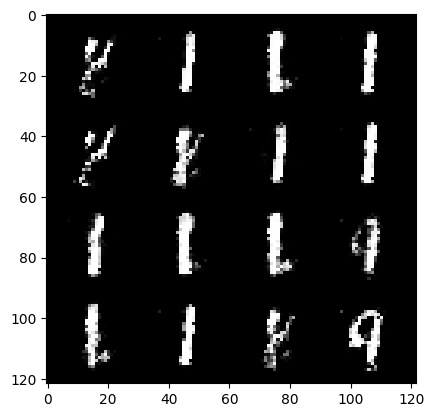

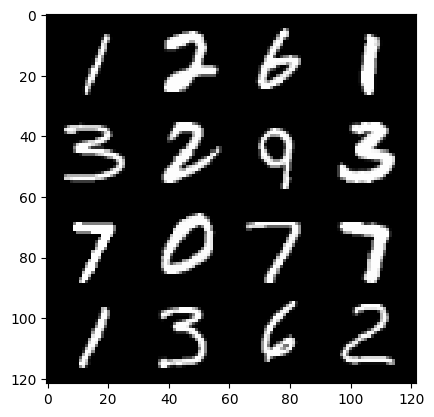

Epoch :51 , Step :30024 , Generator Loss :2.5393214777663893 , Discriminator Loss :0.15627418699915763


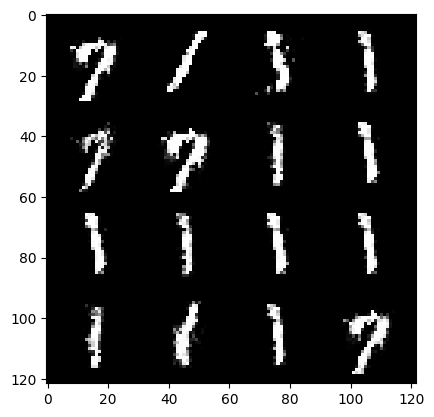

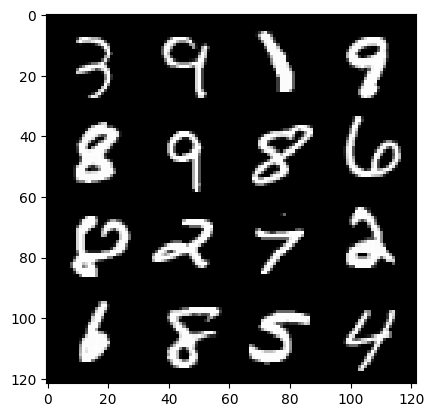

Epoch :51 , Step :30132 , Generator Loss :2.768535516880176 , Discriminator Loss :0.18648513123668994


  0%|          | 0/469 [00:00<?, ?it/s]

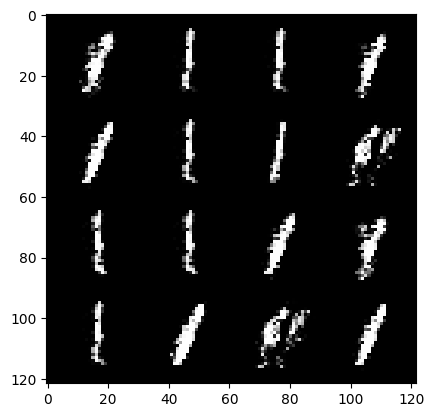

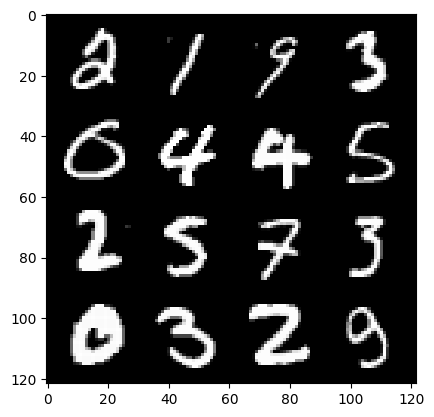

Epoch :52 , Step :30240 , Generator Loss :2.5923311489599716 , Discriminator Loss :0.19919467655320955


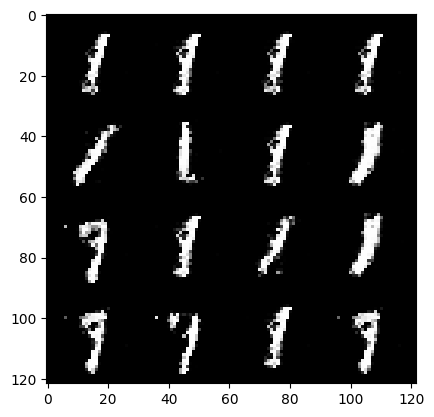

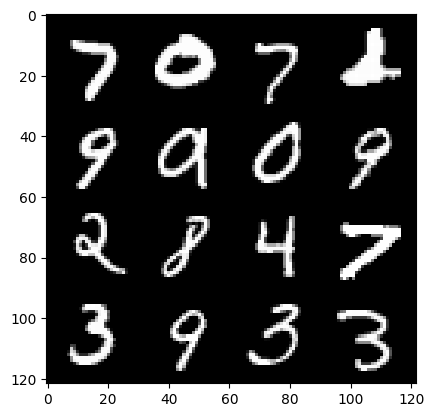

Epoch :52 , Step :30348 , Generator Loss :2.7532561288939585 , Discriminator Loss :0.1799200536614215


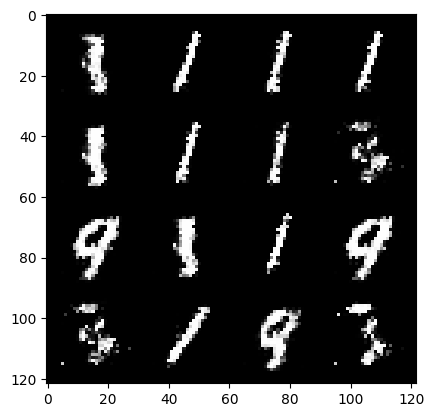

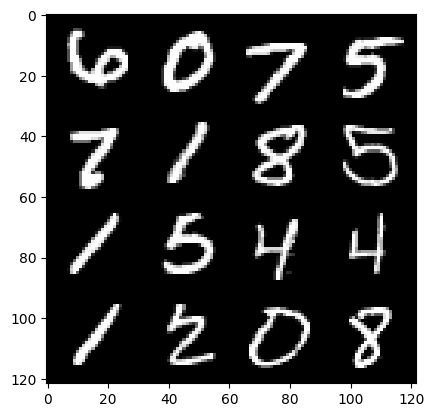

Epoch :52 , Step :30456 , Generator Loss :2.363093367329351 , Discriminator Loss :0.21917335592486242


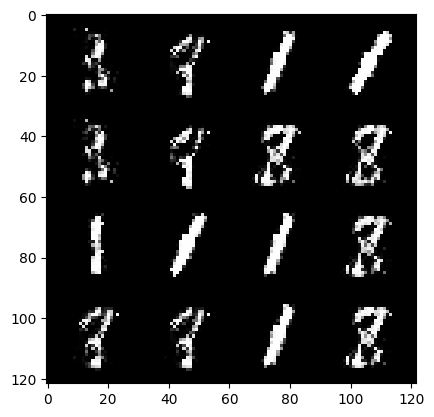

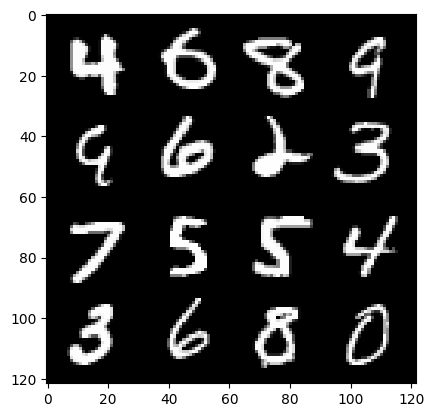

Epoch :52 , Step :30564 , Generator Loss :2.47966871658961 , Discriminator Loss :0.16826825043945415


  0%|          | 0/469 [00:00<?, ?it/s]

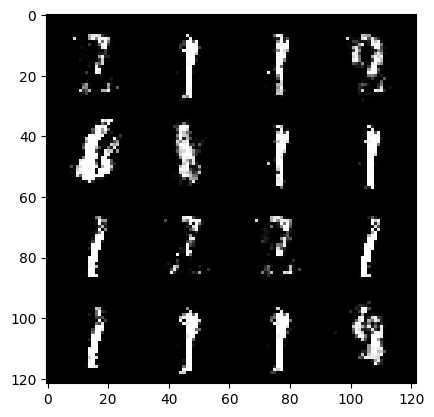

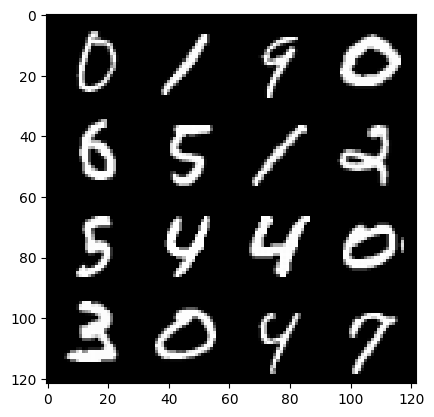

Epoch :53 , Step :30672 , Generator Loss :2.678603156849192 , Discriminator Loss :0.16393990656016047


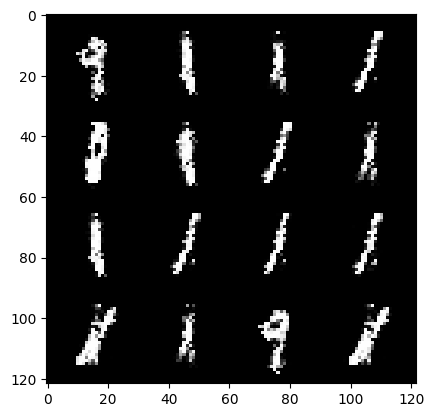

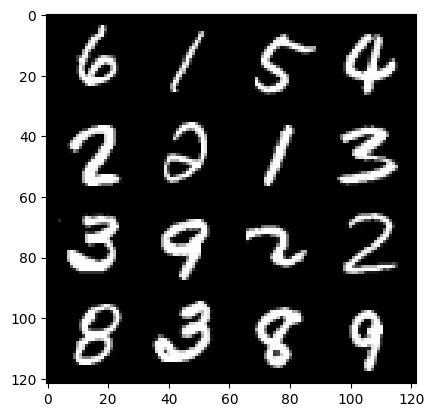

Epoch :53 , Step :30780 , Generator Loss :2.898840946179849 , Discriminator Loss :0.15600160254096543


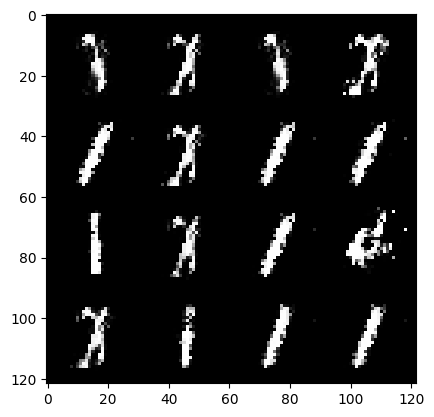

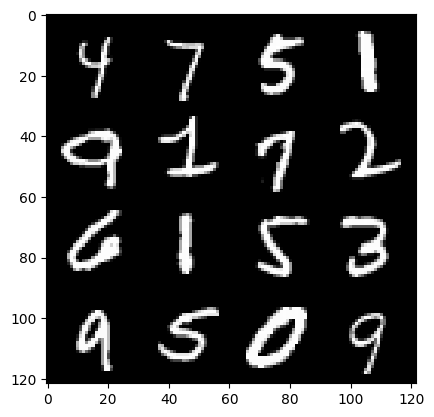

Epoch :53 , Step :30888 , Generator Loss :3.037483482449142 , Discriminator Loss :0.15120693999860016


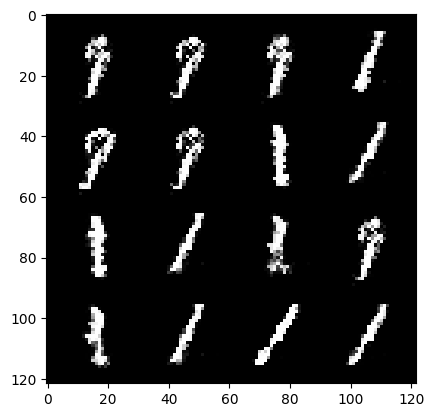

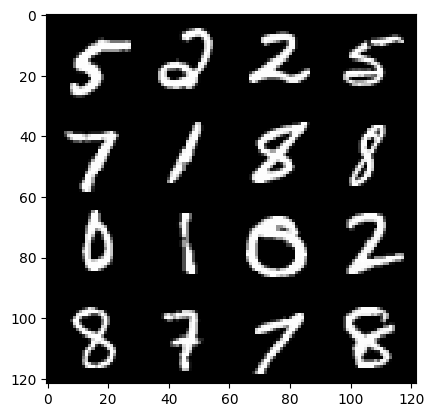

Epoch :53 , Step :30996 , Generator Loss :3.017489760010331 , Discriminator Loss :0.15677122958004477


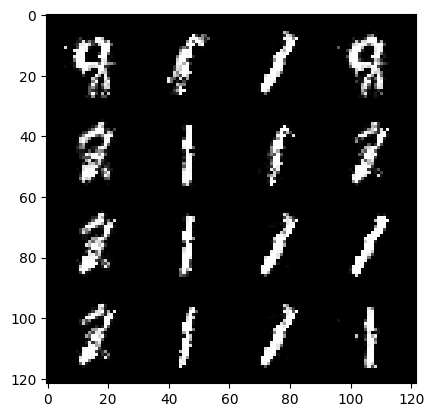

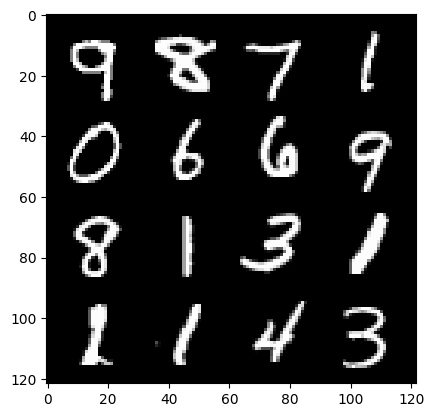

Epoch :53 , Step :31104 , Generator Loss :2.786467561015375 , Discriminator Loss :0.1594791619314088


  0%|          | 0/469 [00:00<?, ?it/s]

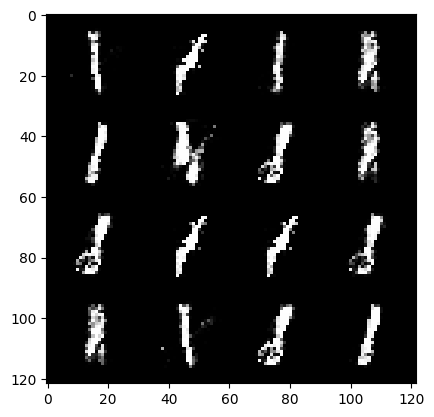

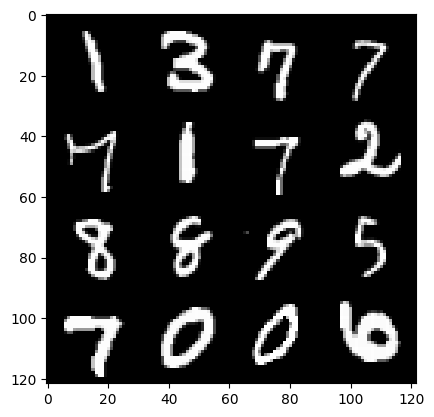

Epoch :54 , Step :31212 , Generator Loss :2.735093372839469 , Discriminator Loss :0.1425922219813974


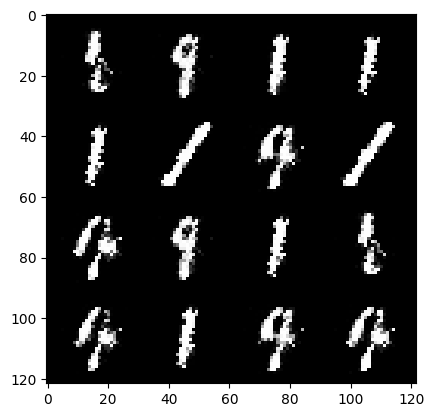

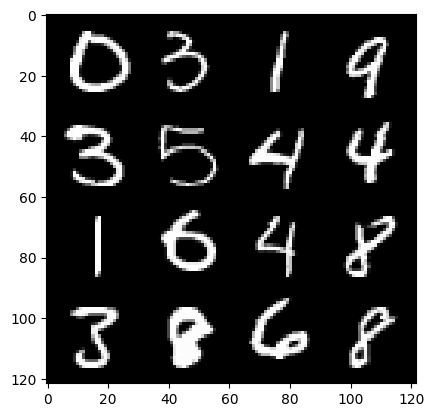

Epoch :54 , Step :31320 , Generator Loss :2.8289950975665334 , Discriminator Loss :0.15414825530239828


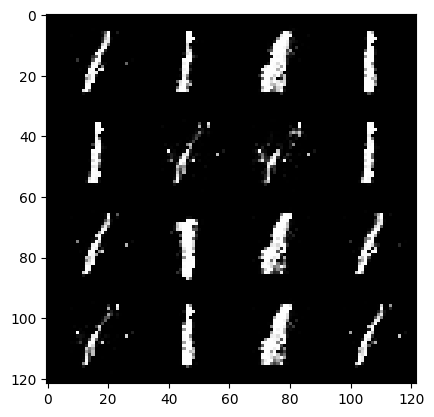

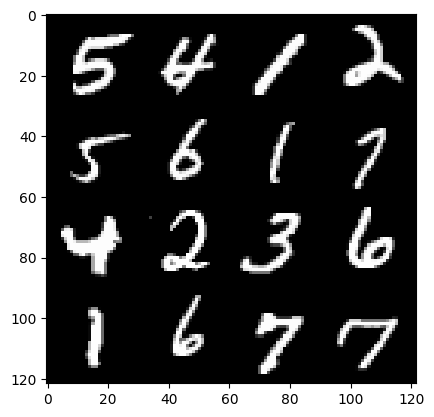

Epoch :54 , Step :31428 , Generator Loss :3.148119390010834 , Discriminator Loss :0.13591027221883883


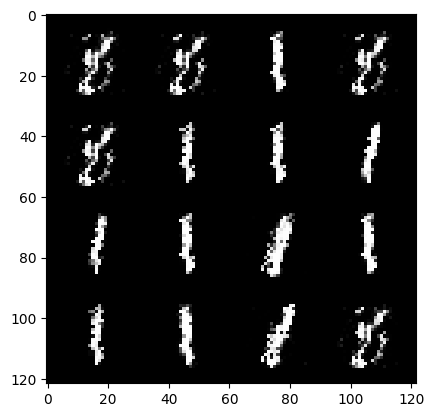

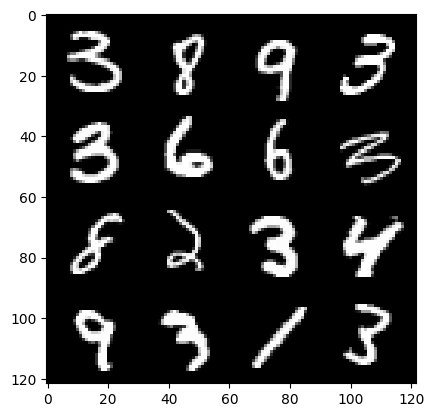

Epoch :54 , Step :31536 , Generator Loss :3.3751214234917253 , Discriminator Loss :0.12922628327376315


  0%|          | 0/469 [00:00<?, ?it/s]

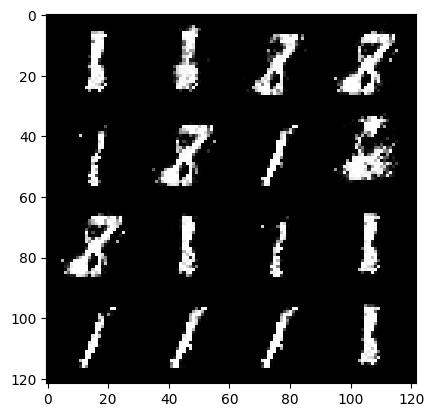

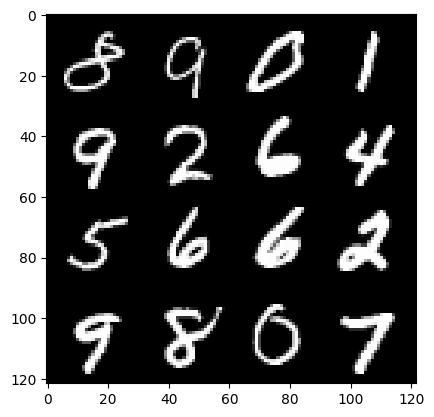

Epoch :55 , Step :31644 , Generator Loss :3.1424630505067315 , Discriminator Loss :0.16265738589896098


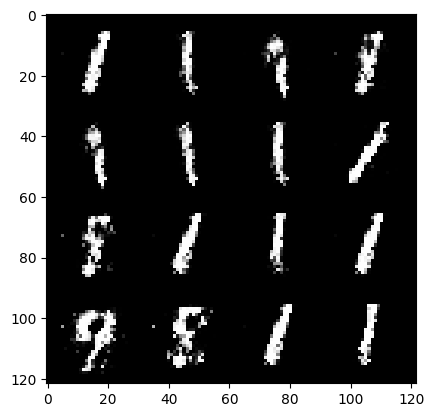

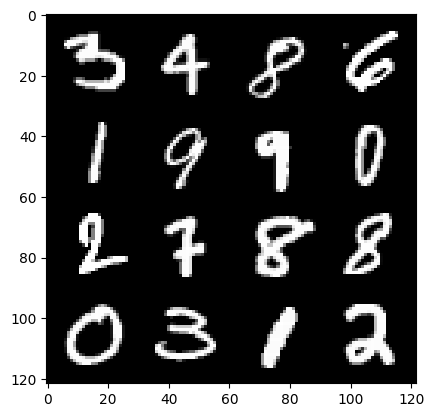

Epoch :55 , Step :31752 , Generator Loss :3.2577123200451883 , Discriminator Loss :0.1778777563185603


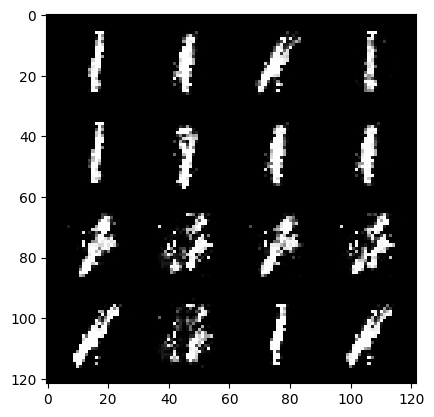

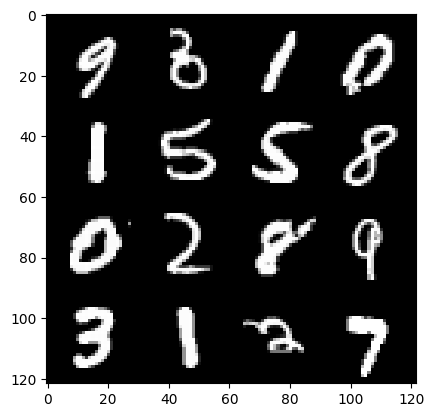

Epoch :55 , Step :31860 , Generator Loss :2.6305447176650727 , Discriminator Loss :0.210632395758121


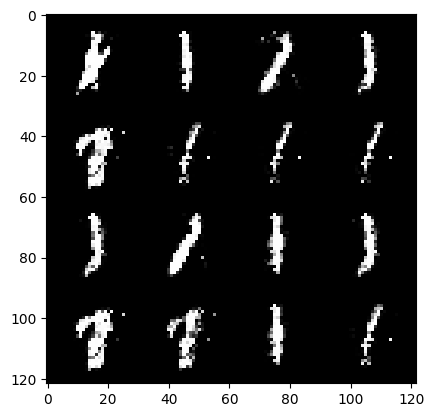

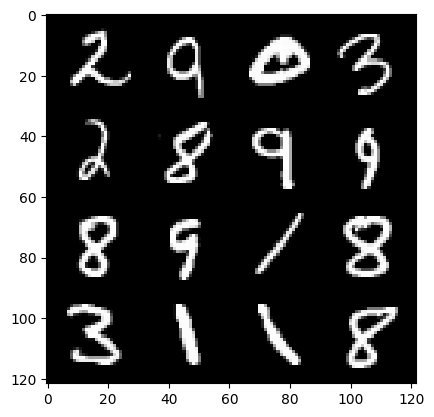

Epoch :55 , Step :31968 , Generator Loss :2.7273152426437104 , Discriminator Loss :0.1694039258829974


  0%|          | 0/469 [00:00<?, ?it/s]

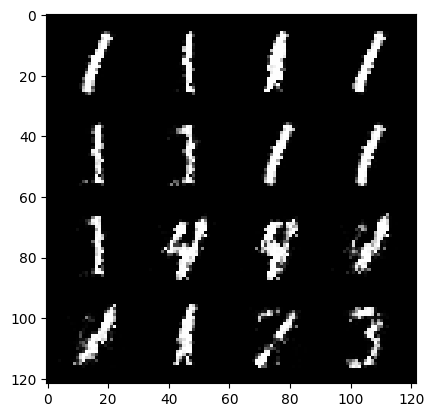

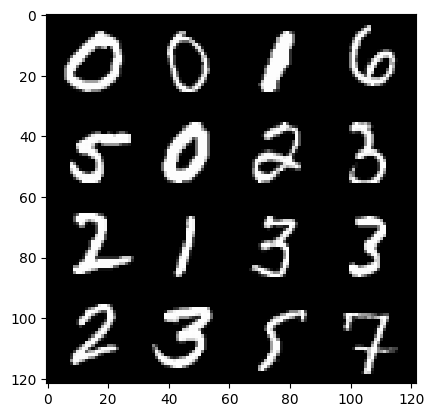

Epoch :56 , Step :32076 , Generator Loss :2.6838432616657686 , Discriminator Loss :0.17302392223091045


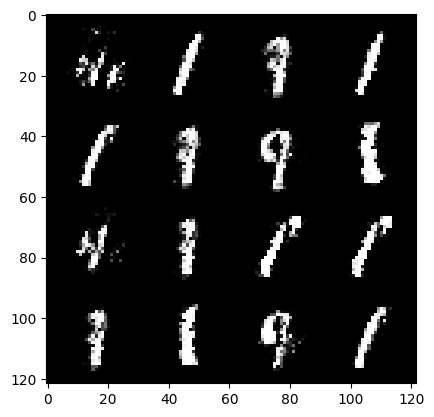

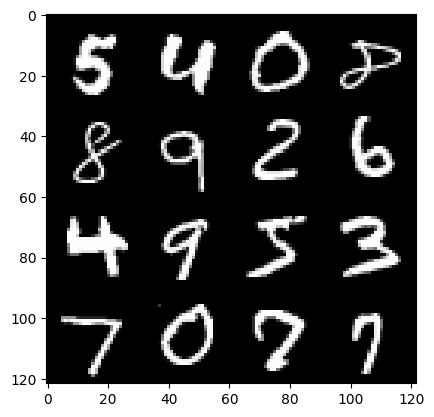

Epoch :56 , Step :32184 , Generator Loss :2.5326995695078818 , Discriminator Loss :0.18499974209677286


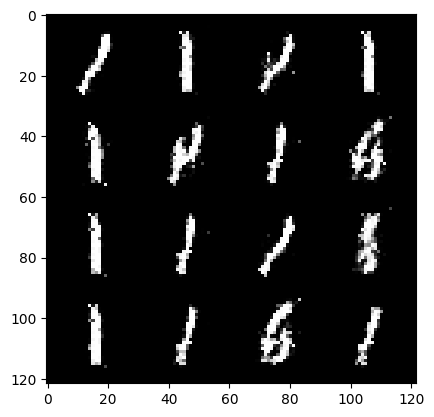

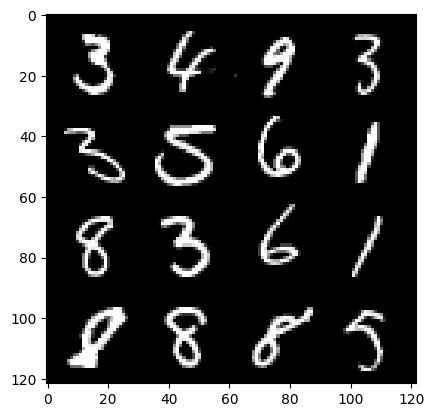

Epoch :56 , Step :32292 , Generator Loss :2.5970346287444777 , Discriminator Loss :0.20792083580184859


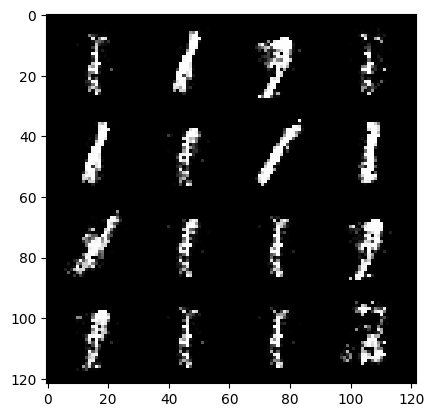

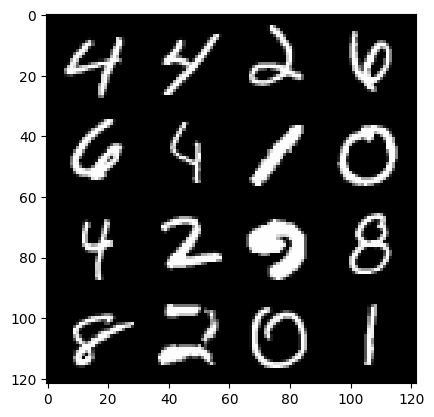

Epoch :56 , Step :32400 , Generator Loss :2.4769774918202994 , Discriminator Loss :0.21022274772878047


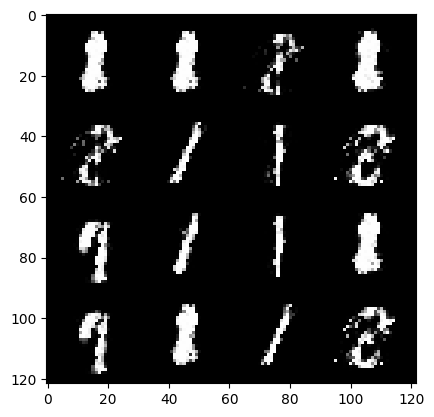

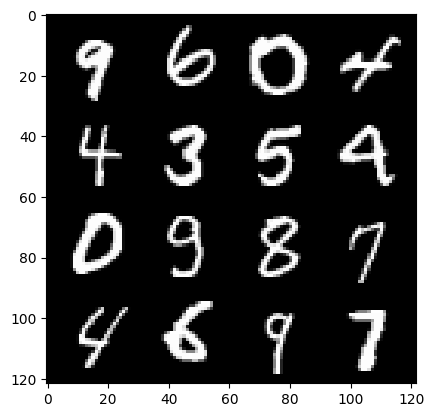

Epoch :56 , Step :32508 , Generator Loss :2.707798765765296 , Discriminator Loss :0.17764890973490705


  0%|          | 0/469 [00:00<?, ?it/s]

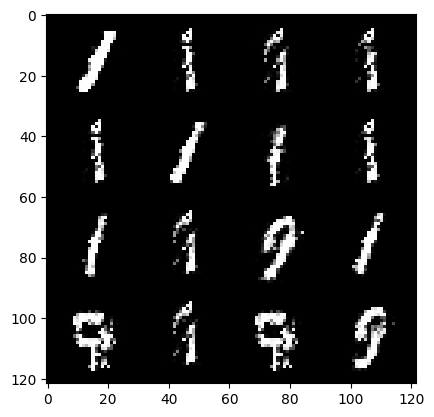

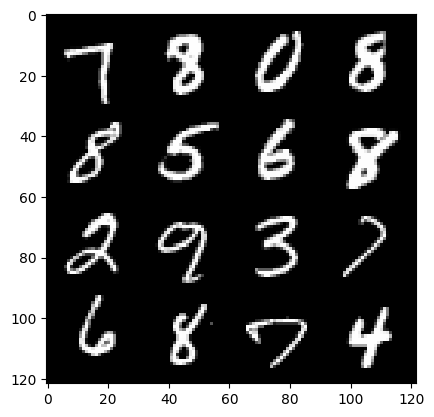

Epoch :57 , Step :32616 , Generator Loss :2.4419069047327384 , Discriminator Loss :0.22023610860385287


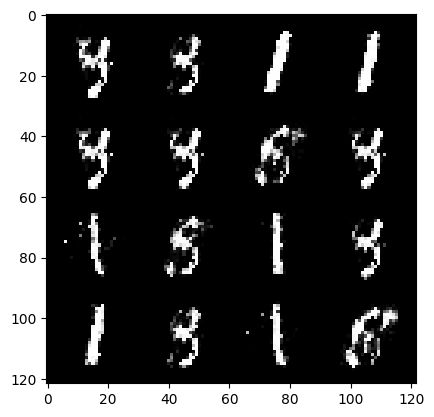

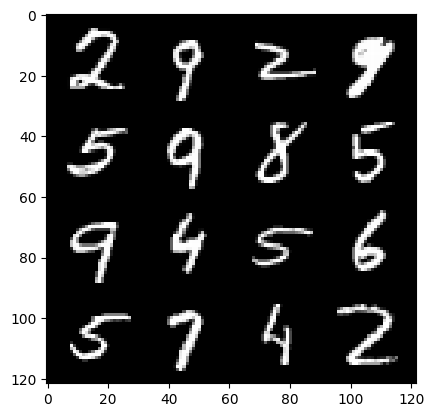

Epoch :57 , Step :32724 , Generator Loss :2.5899998589798243 , Discriminator Loss :0.1658761027372546


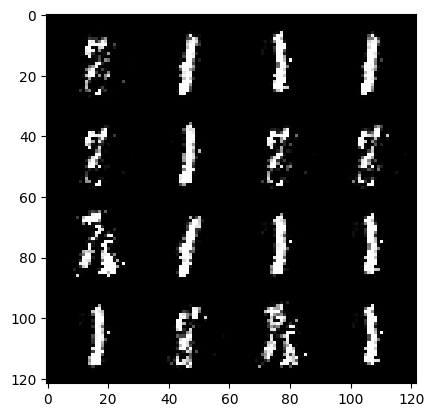

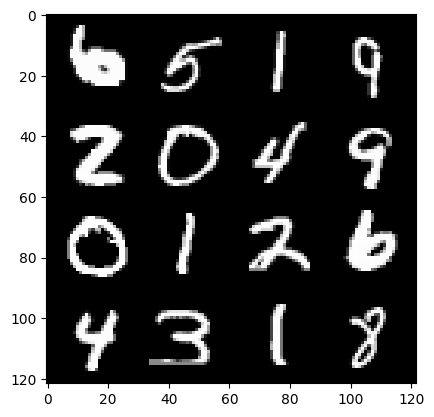

Epoch :57 , Step :32832 , Generator Loss :2.7658128760479115 , Discriminator Loss :0.17209063760108423


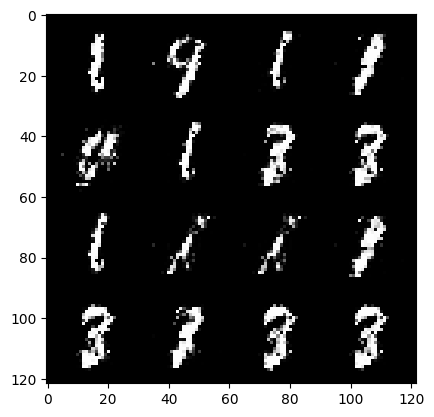

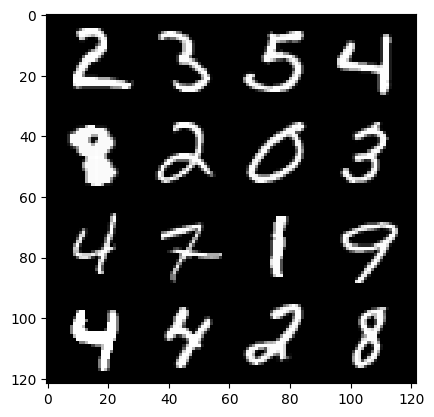

Epoch :57 , Step :32940 , Generator Loss :2.998995705887124 , Discriminator Loss :0.14899489469826221


  0%|          | 0/469 [00:00<?, ?it/s]

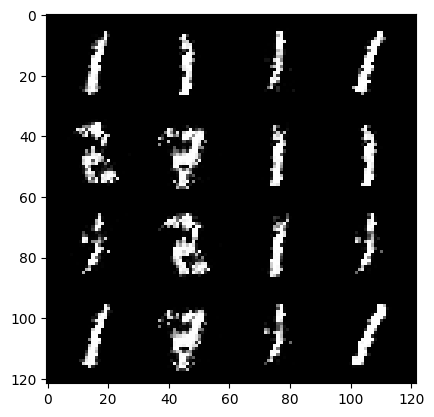

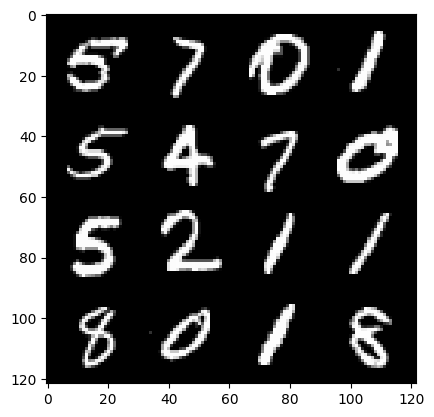

Epoch :58 , Step :33048 , Generator Loss :3.0201766292254133 , Discriminator Loss :0.13927697624873234


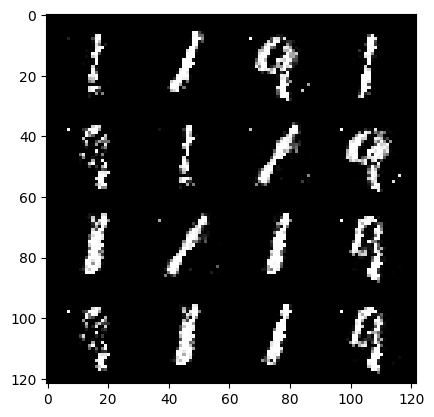

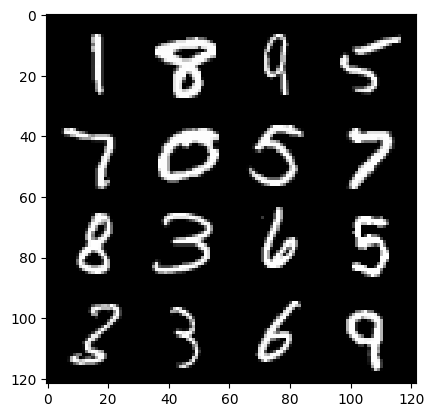

Epoch :58 , Step :33156 , Generator Loss :3.0497315592236 , Discriminator Loss :0.14728255742401988


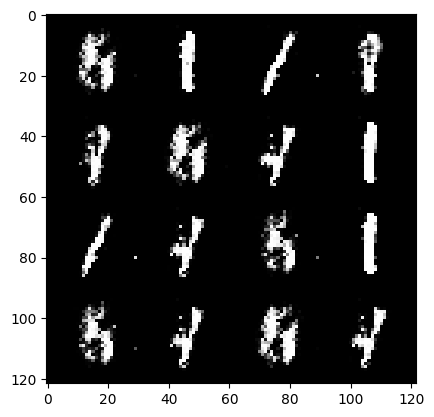

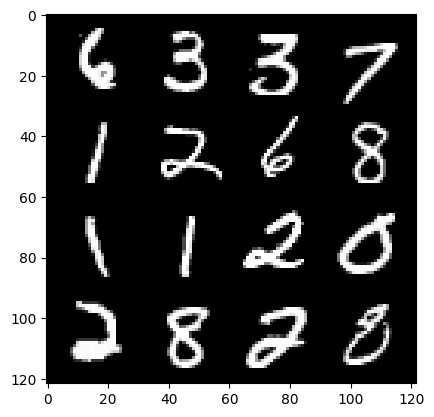

Epoch :58 , Step :33264 , Generator Loss :3.0841651934164527 , Discriminator Loss :0.16326576781769592


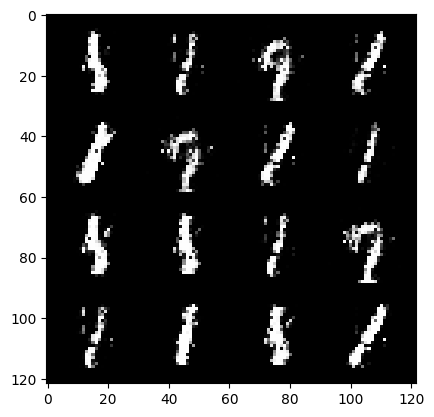

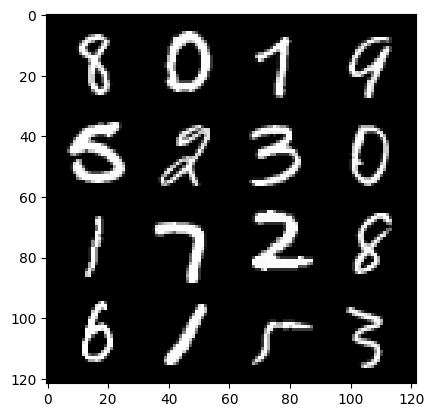

Epoch :58 , Step :33372 , Generator Loss :3.222626059143634 , Discriminator Loss :0.145138422165204


  0%|          | 0/469 [00:00<?, ?it/s]

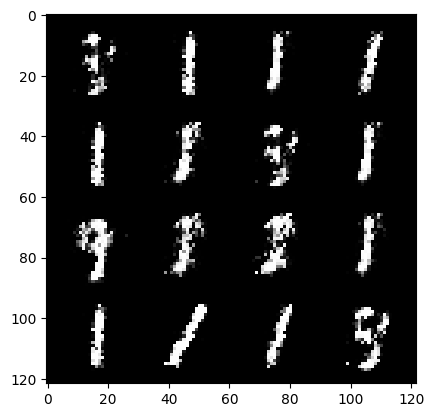

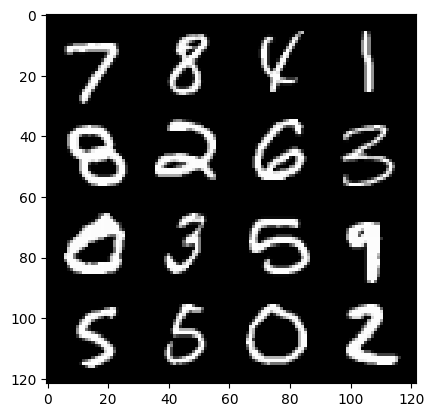

Epoch :59 , Step :33480 , Generator Loss :2.9997825247270096 , Discriminator Loss :0.17512794163216047


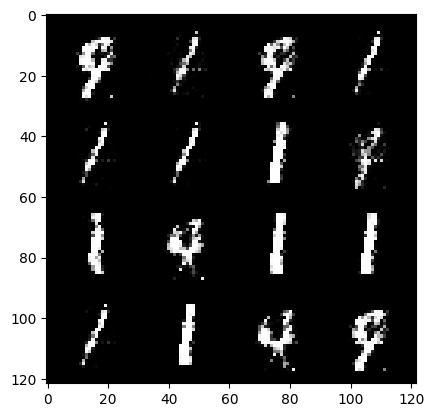

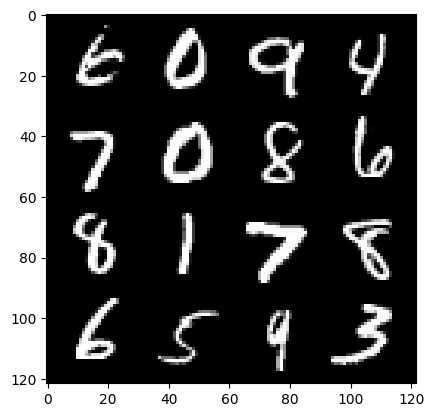

Epoch :59 , Step :33588 , Generator Loss :2.768701034563559 , Discriminator Loss :0.15223436002378116


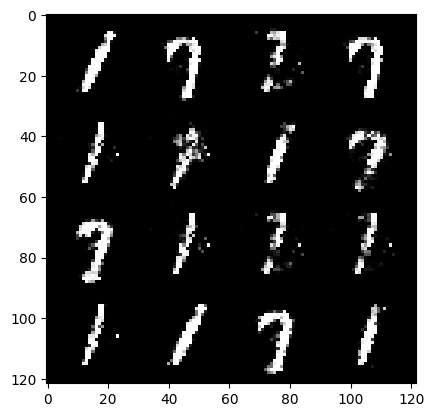

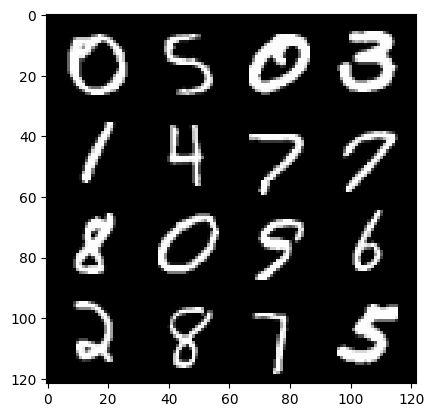

Epoch :59 , Step :33696 , Generator Loss :2.870868199401431 , Discriminator Loss :0.1599571372347849


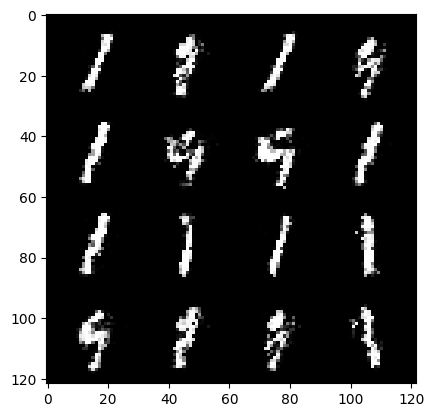

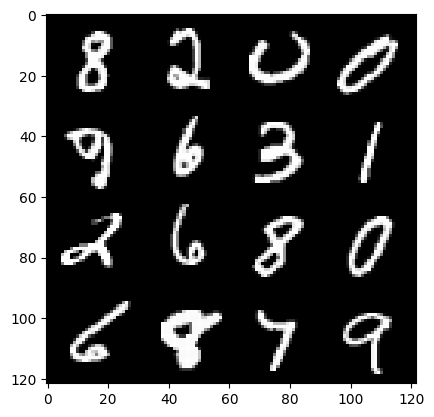

Epoch :59 , Step :33804 , Generator Loss :2.863780004006845 , Discriminator Loss :0.15256461266566207


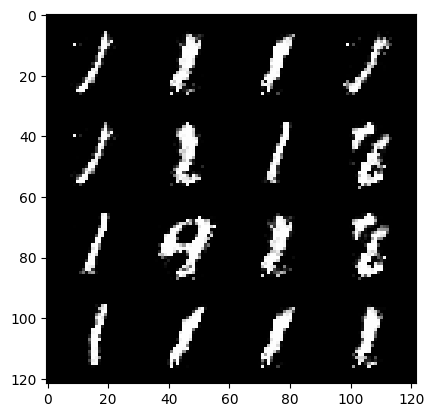

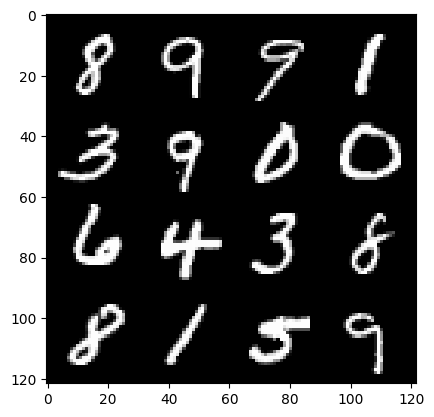

Epoch :59 , Step :33912 , Generator Loss :2.7096550906146013 , Discriminator Loss :0.17739173949316694


  0%|          | 0/469 [00:00<?, ?it/s]

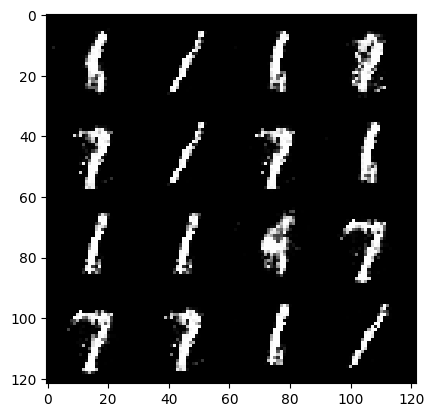

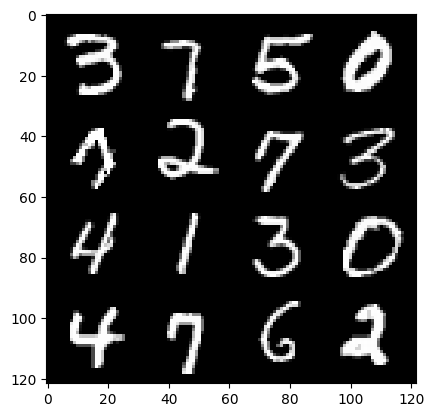

Epoch :60 , Step :34020 , Generator Loss :2.5731620369134127 , Discriminator Loss :0.22139456054126783


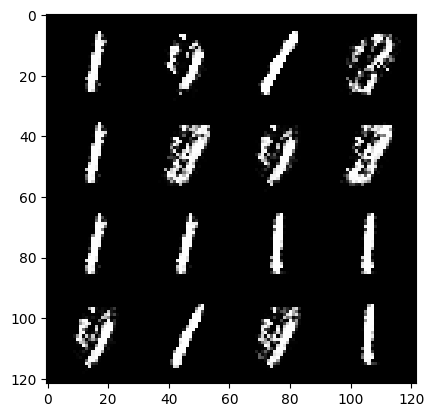

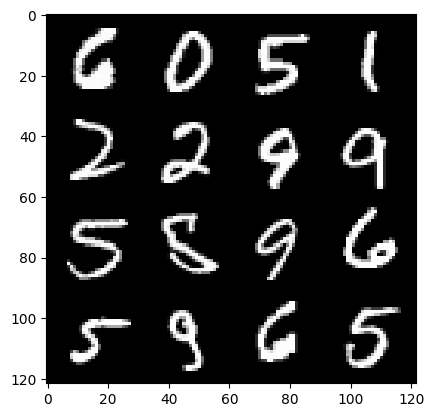

Epoch :60 , Step :34128 , Generator Loss :2.5951905272625124 , Discriminator Loss :0.14711661126326633


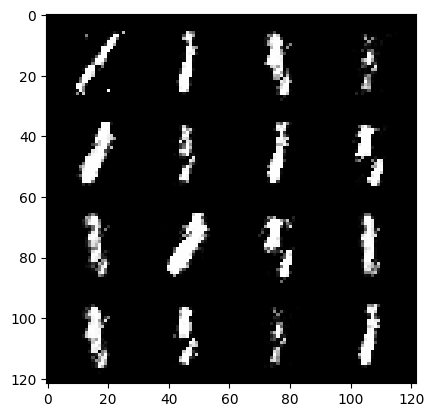

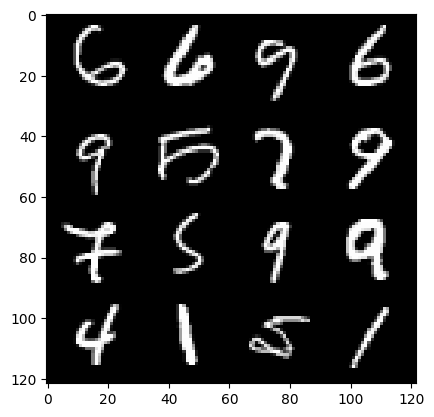

Epoch :60 , Step :34236 , Generator Loss :2.899129344357384 , Discriminator Loss :0.17820468993374594


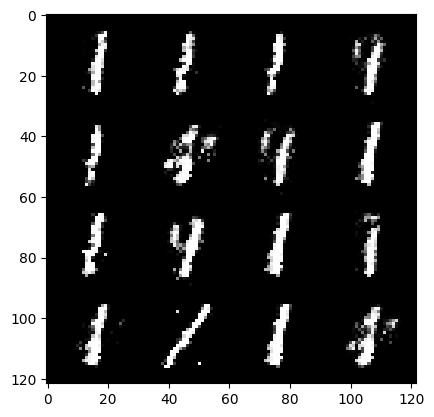

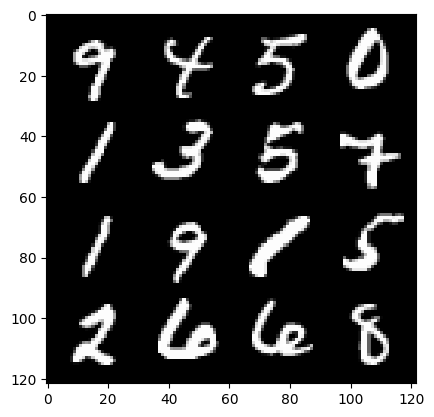

Epoch :60 , Step :34344 , Generator Loss :2.667899840407901 , Discriminator Loss :0.16355970501899722


  0%|          | 0/469 [00:00<?, ?it/s]

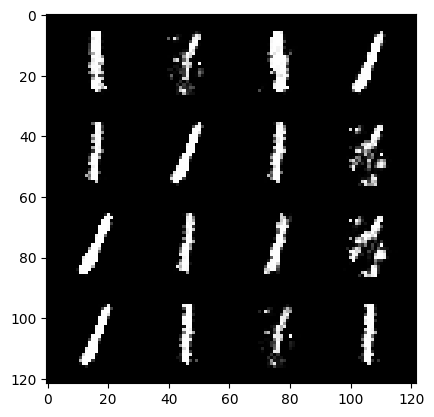

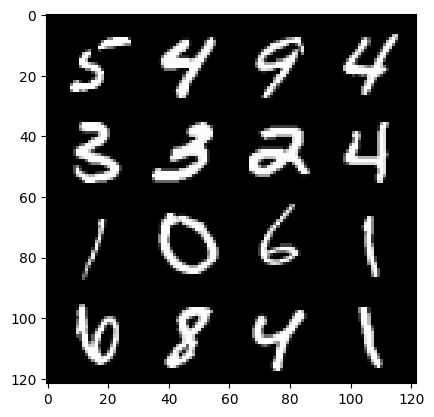

Epoch :61 , Step :34452 , Generator Loss :2.713367225947203 , Discriminator Loss :0.1819163871308167


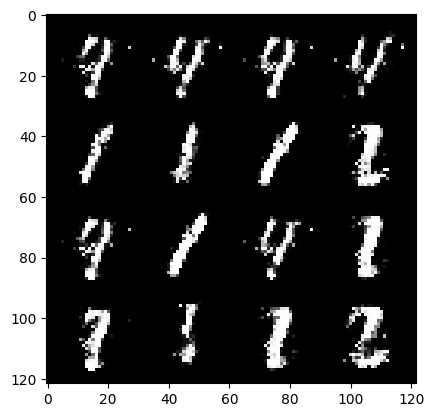

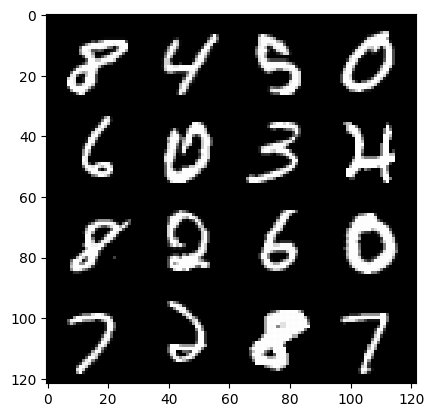

Epoch :61 , Step :34560 , Generator Loss :2.775692571092536 , Discriminator Loss :0.1749197076316233


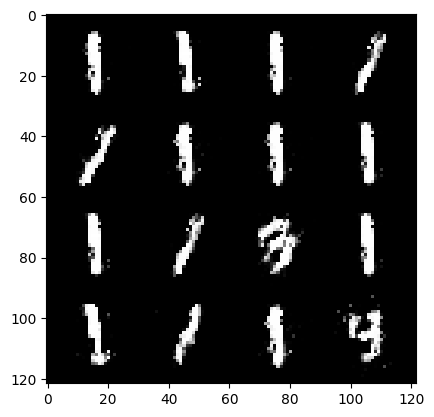

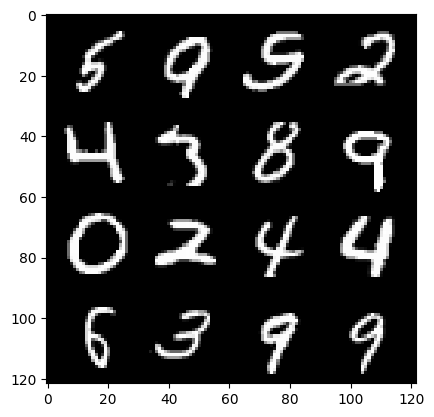

Epoch :61 , Step :34668 , Generator Loss :2.705214663788125 , Discriminator Loss :0.21589095918116746


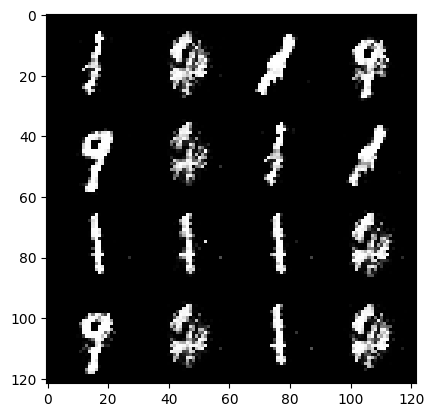

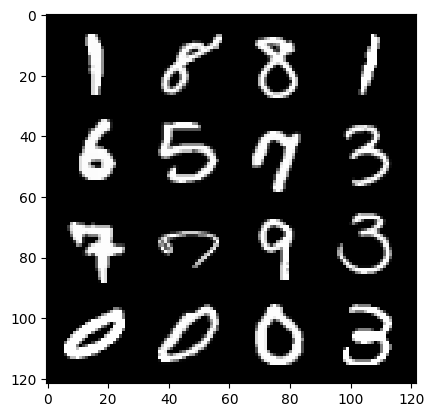

Epoch :61 , Step :34776 , Generator Loss :2.585743199895928 , Discriminator Loss :0.18661030623371955


  0%|          | 0/469 [00:00<?, ?it/s]

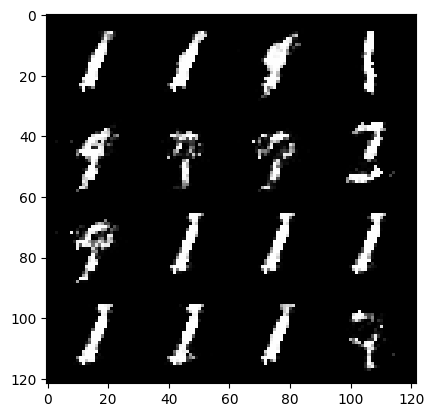

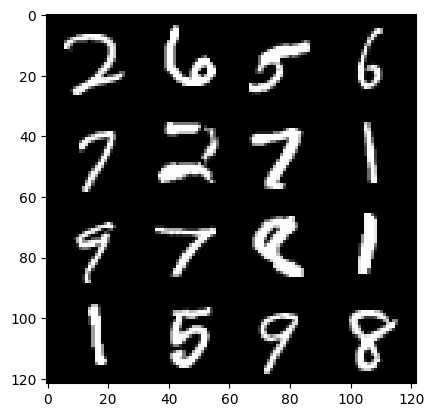

Epoch :62 , Step :34884 , Generator Loss :2.4495491054322986 , Discriminator Loss :0.1856332151564183


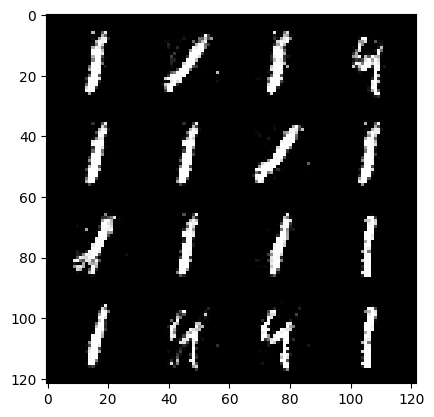

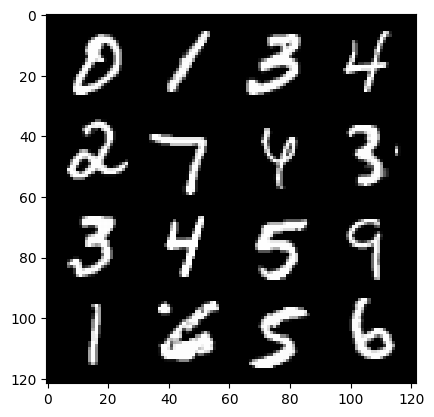

Epoch :62 , Step :34992 , Generator Loss :2.7208644681506686 , Discriminator Loss :0.17678955266321147


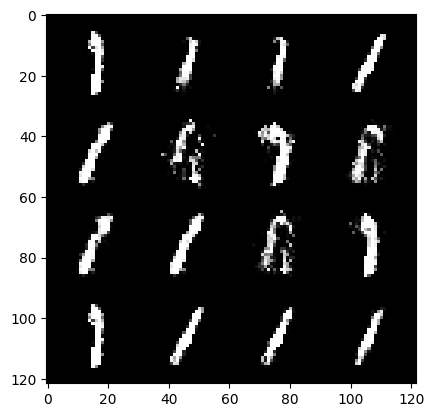

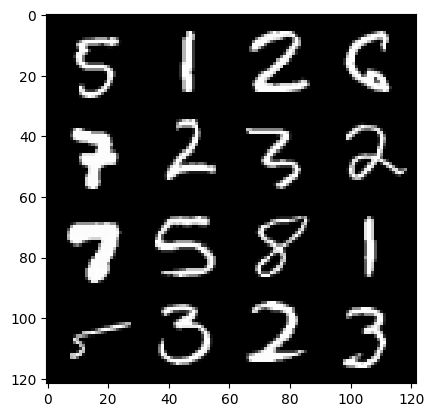

Epoch :62 , Step :35100 , Generator Loss :2.796152896351285 , Discriminator Loss :0.15590911634542326


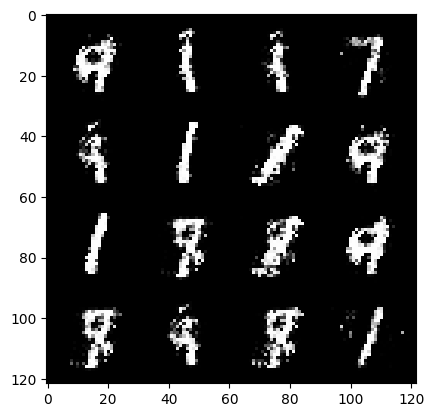

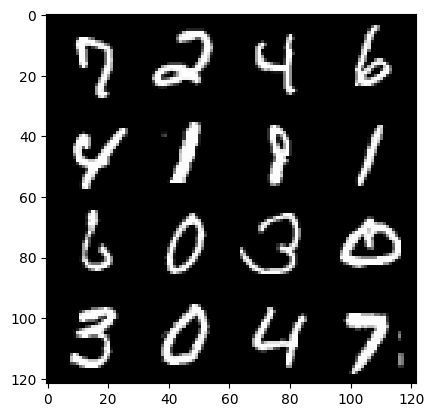

Epoch :62 , Step :35208 , Generator Loss :2.92105468555733 , Discriminator Loss :0.16425696725922606


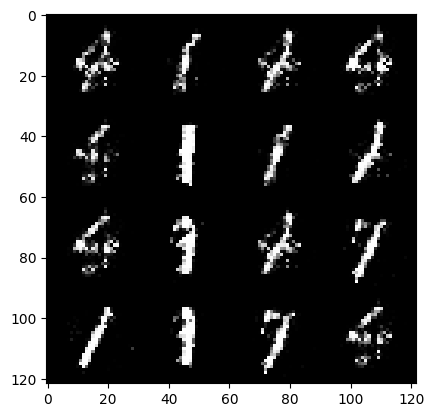

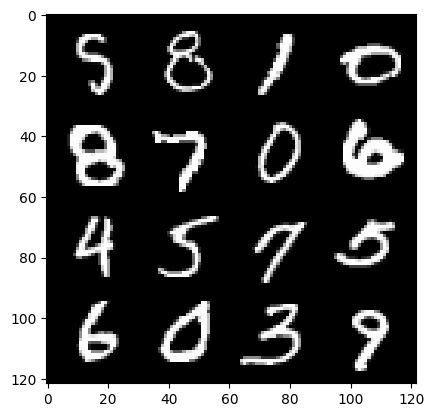

Epoch :62 , Step :35316 , Generator Loss :2.8465278744697575 , Discriminator Loss :0.209788961680951


  0%|          | 0/469 [00:00<?, ?it/s]

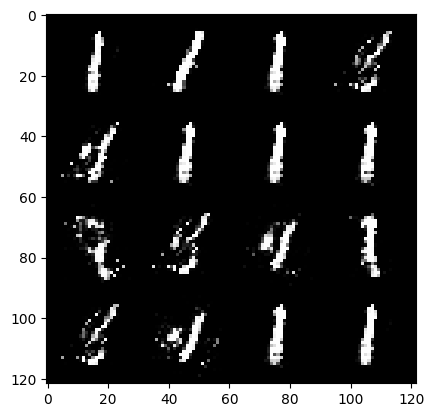

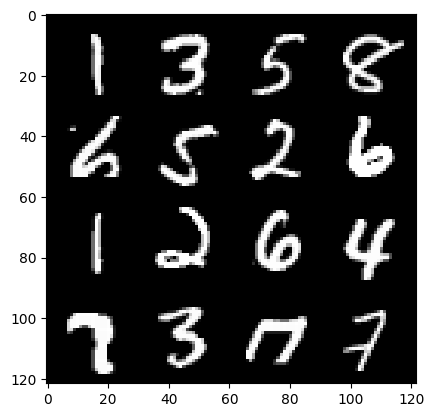

Epoch :63 , Step :35424 , Generator Loss :3.1511086004751707 , Discriminator Loss :0.1696699354107733


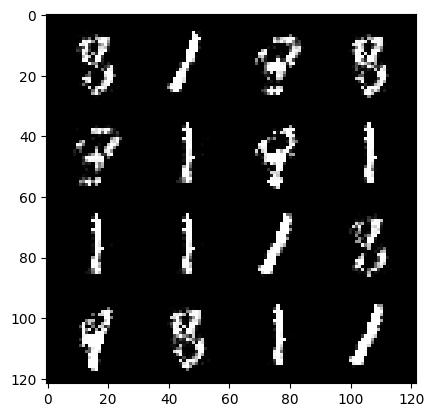

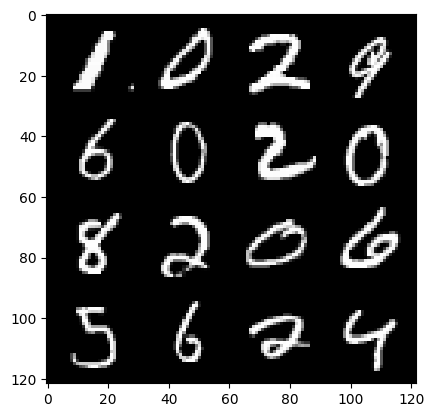

Epoch :63 , Step :35532 , Generator Loss :2.9336940955232693 , Discriminator Loss :0.1761447372673838


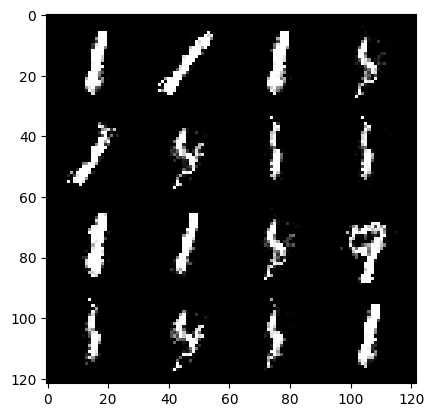

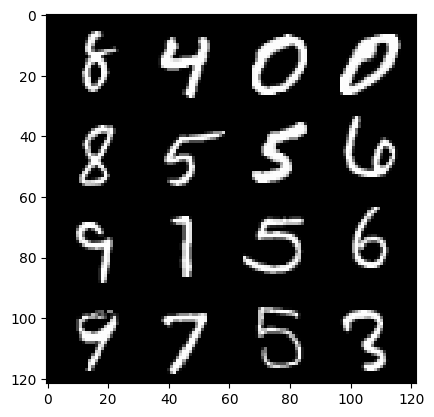

Epoch :63 , Step :35640 , Generator Loss :2.811170677344004 , Discriminator Loss :0.17571139708161357


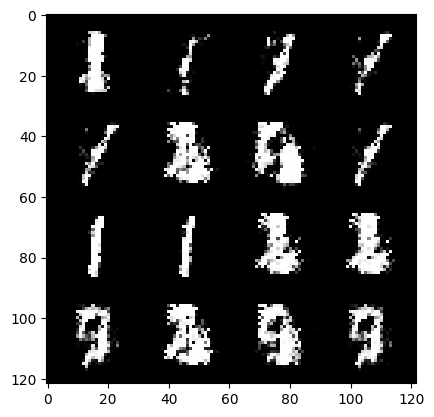

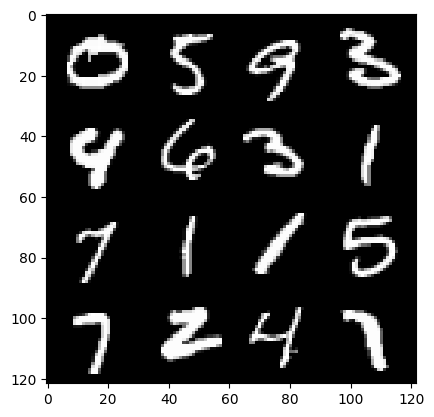

Epoch :63 , Step :35748 , Generator Loss :3.0507124265034986 , Discriminator Loss :0.14458034422110633


  0%|          | 0/469 [00:00<?, ?it/s]

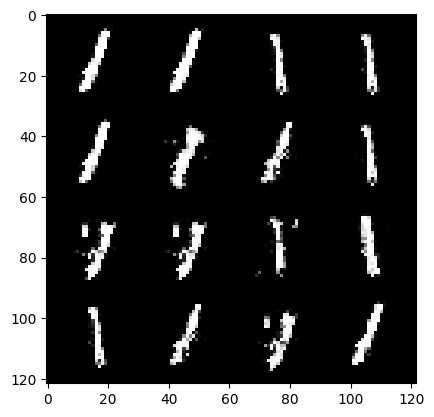

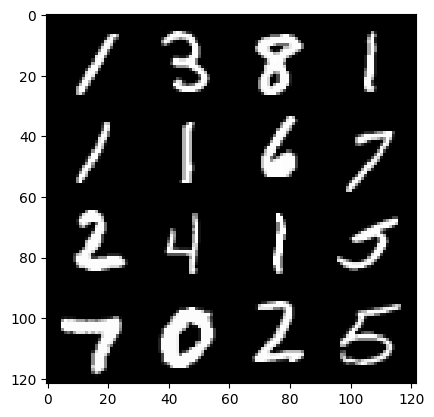

Epoch :64 , Step :35856 , Generator Loss :2.9150079003086797 , Discriminator Loss :0.16580624823217044


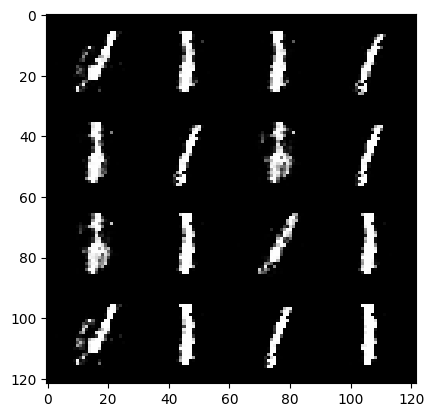

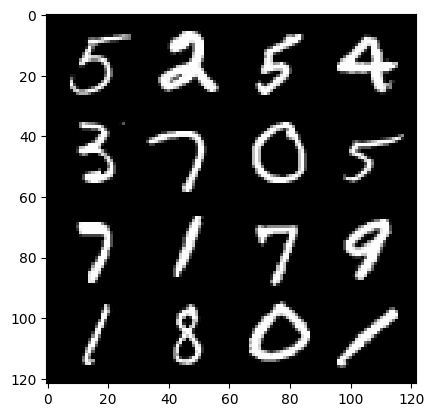

Epoch :64 , Step :35964 , Generator Loss :3.2280130938247393 , Discriminator Loss :0.1610035609315943


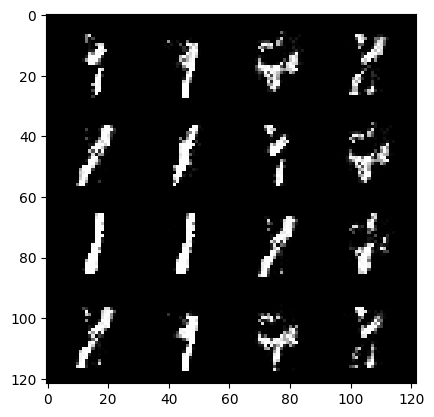

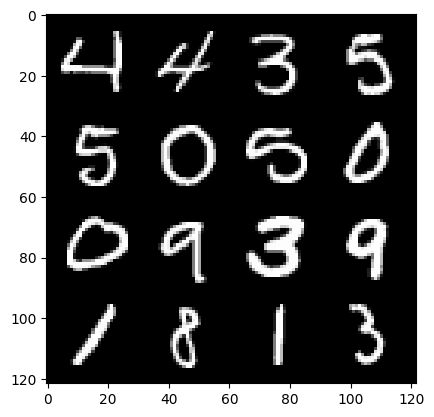

Epoch :64 , Step :36072 , Generator Loss :2.749250270702221 , Discriminator Loss :0.2232408337295055


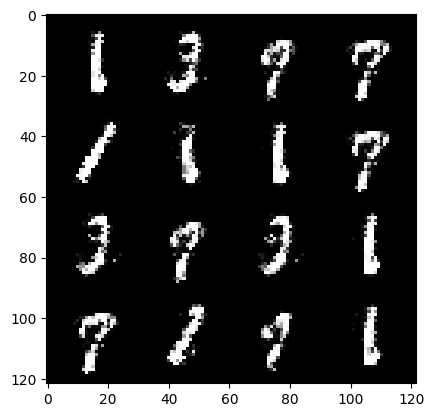

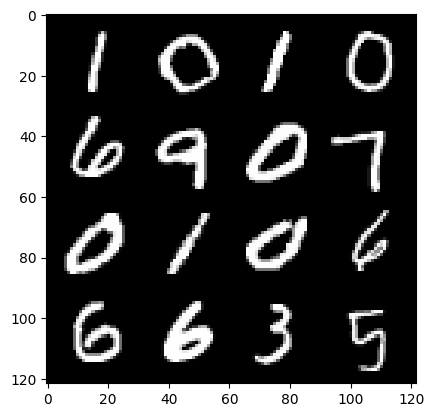

Epoch :64 , Step :36180 , Generator Loss :2.8101333070684382 , Discriminator Loss :0.1696437736628233


  0%|          | 0/469 [00:00<?, ?it/s]

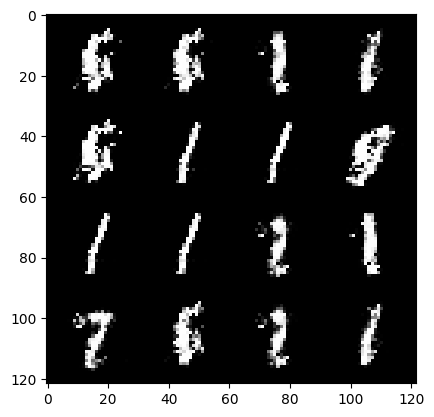

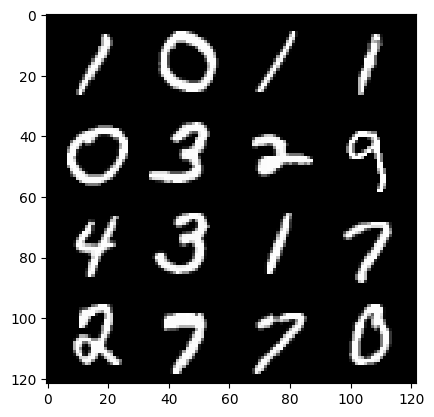

Epoch :65 , Step :36288 , Generator Loss :2.442088283874371 , Discriminator Loss :0.1922467005335623


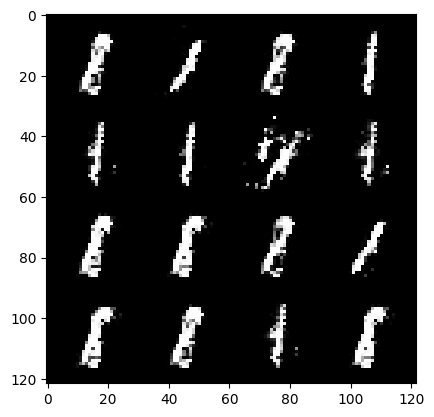

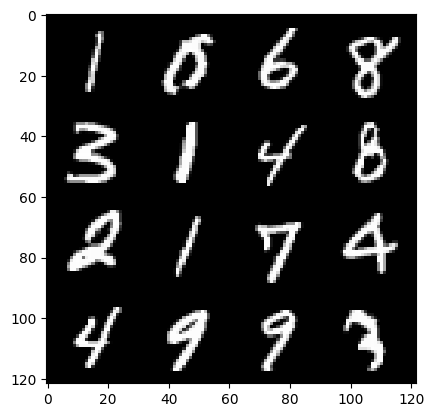

Epoch :65 , Step :36396 , Generator Loss :2.780003538838139 , Discriminator Loss :0.19665533531871118


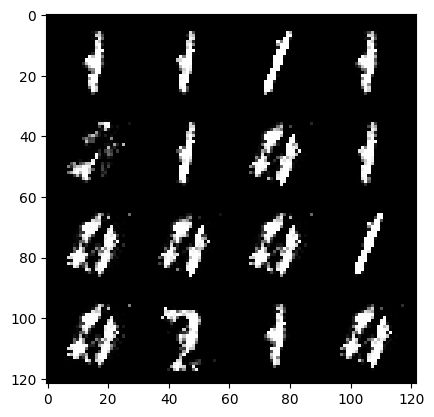

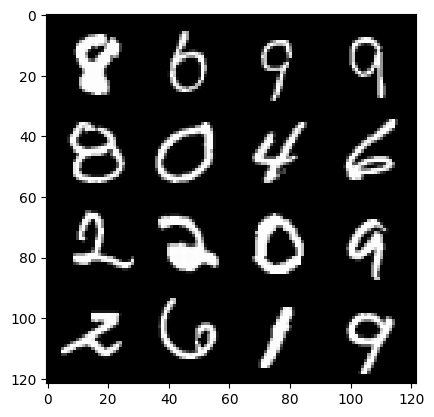

Epoch :65 , Step :36504 , Generator Loss :2.588787017045198 , Discriminator Loss :0.20122410129341814


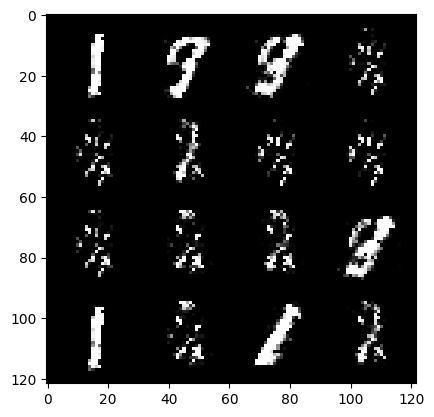

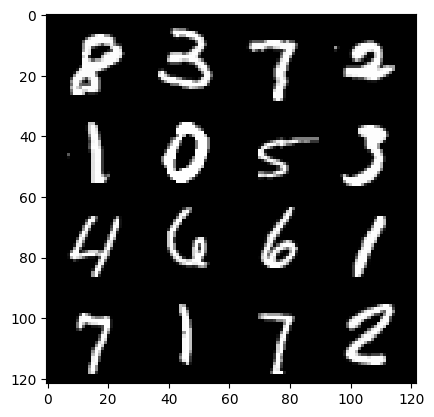

Epoch :65 , Step :36612 , Generator Loss :2.833690252568987 , Discriminator Loss :0.1369342017504904


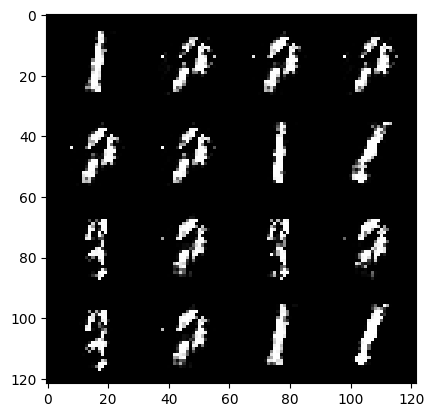

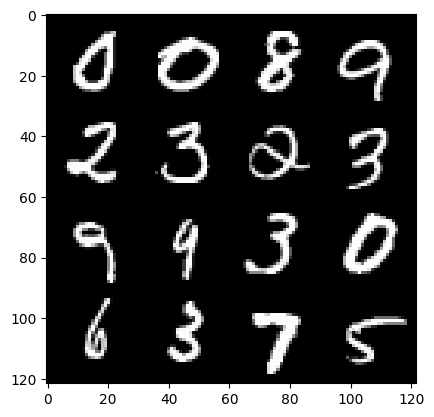

Epoch :65 , Step :36720 , Generator Loss :3.069779808874482 , Discriminator Loss :0.15776641404739136


  0%|          | 0/469 [00:00<?, ?it/s]

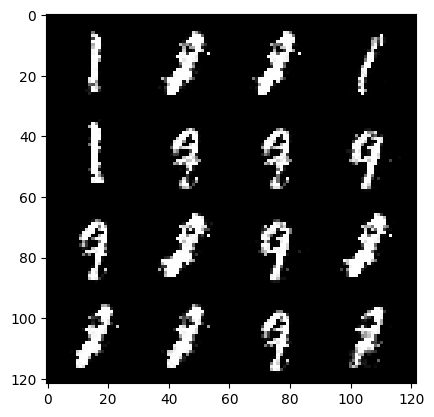

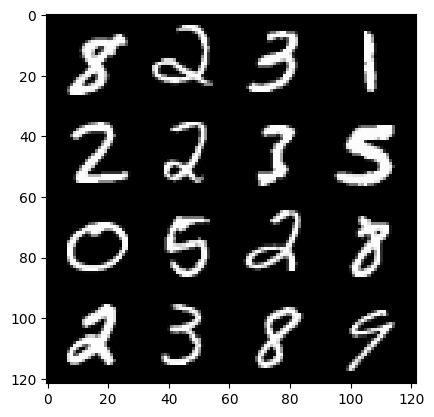

Epoch :66 , Step :36828 , Generator Loss :2.7893876808661004 , Discriminator Loss :0.16765488359939168


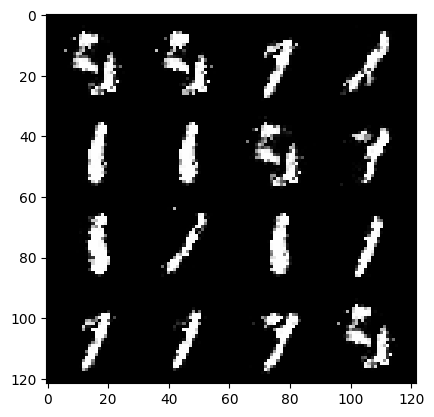

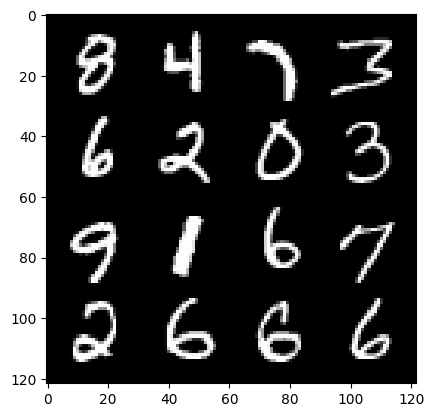

Epoch :66 , Step :36936 , Generator Loss :2.7905646121060412 , Discriminator Loss :0.19894353383117258


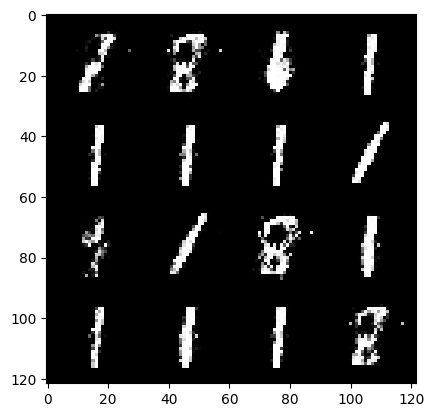

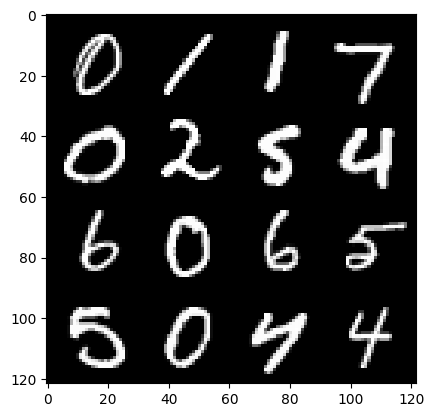

Epoch :66 , Step :37044 , Generator Loss :2.567977733082242 , Discriminator Loss :0.16941444872430078


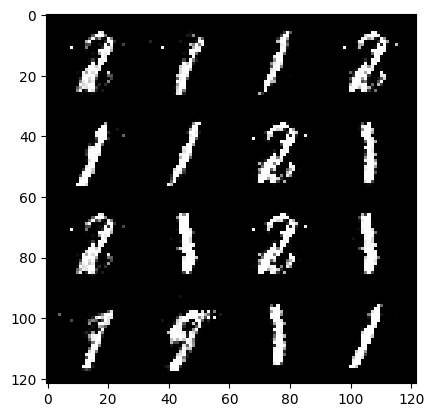

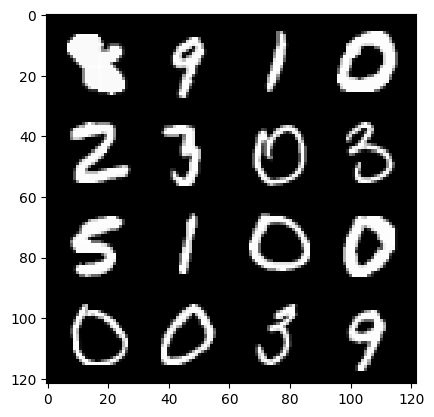

Epoch :66 , Step :37152 , Generator Loss :2.7650106460959822 , Discriminator Loss :0.15769117304848296


  0%|          | 0/469 [00:00<?, ?it/s]

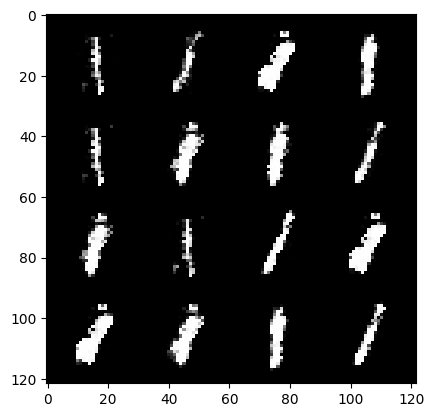

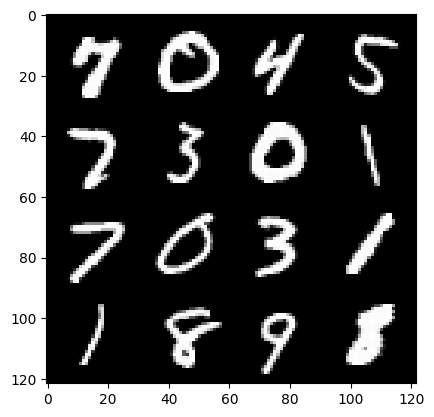

Epoch :67 , Step :37260 , Generator Loss :2.8325548149921267 , Discriminator Loss :0.156527874853324


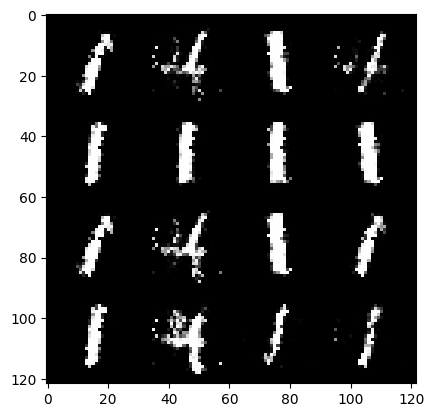

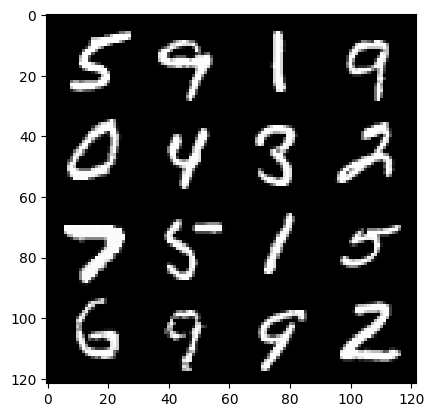

Epoch :67 , Step :37368 , Generator Loss :2.628890412825125 , Discriminator Loss :0.18681379752578547


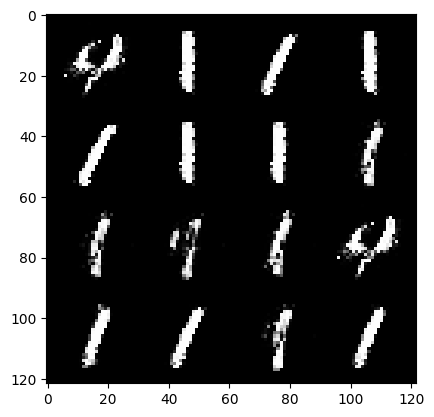

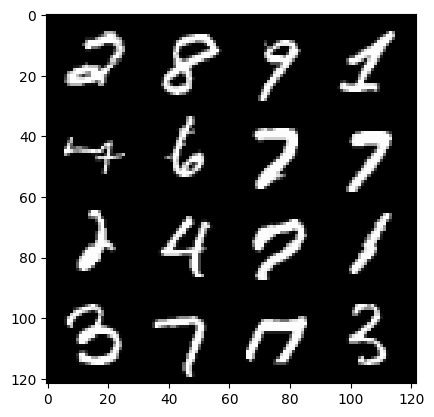

Epoch :67 , Step :37476 , Generator Loss :2.6253941677234782 , Discriminator Loss :0.1825206368747684


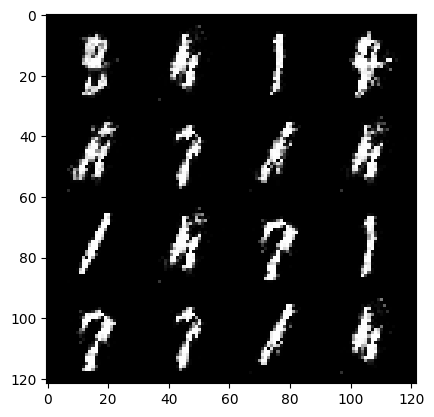

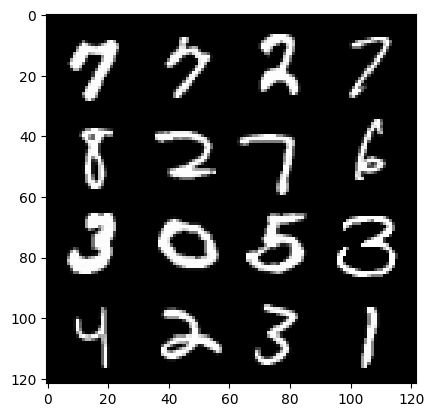

Epoch :67 , Step :37584 , Generator Loss :2.6774932013617634 , Discriminator Loss :0.18979120813310138


  0%|          | 0/469 [00:00<?, ?it/s]

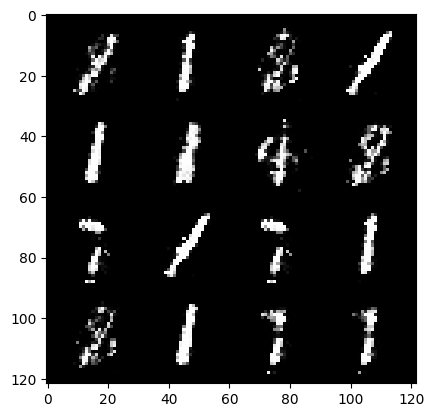

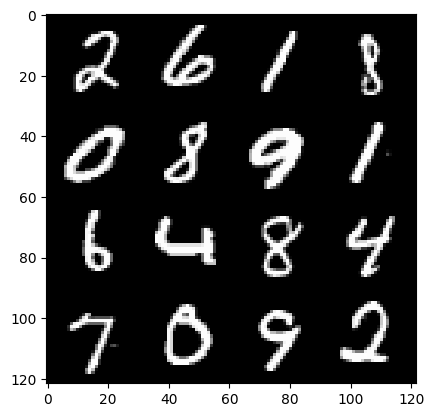

Epoch :68 , Step :37692 , Generator Loss :2.456905685089251 , Discriminator Loss :0.20149908035441683


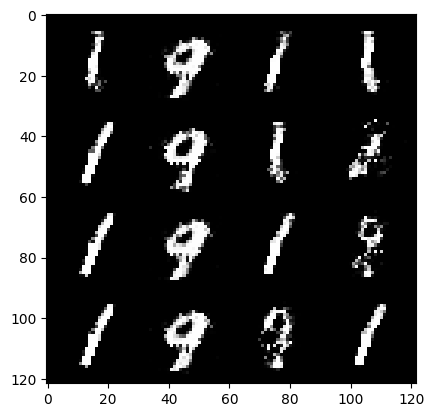

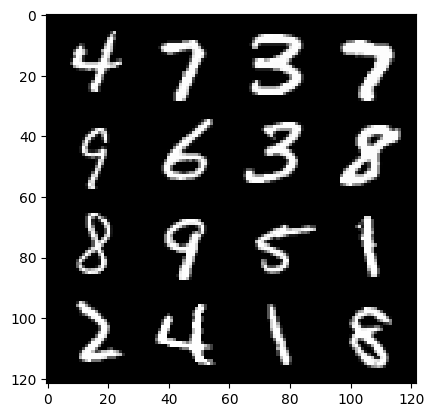

Epoch :68 , Step :37800 , Generator Loss :2.6326168775558467 , Discriminator Loss :0.18949211788950135


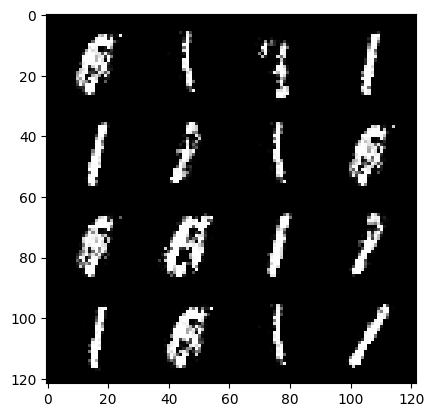

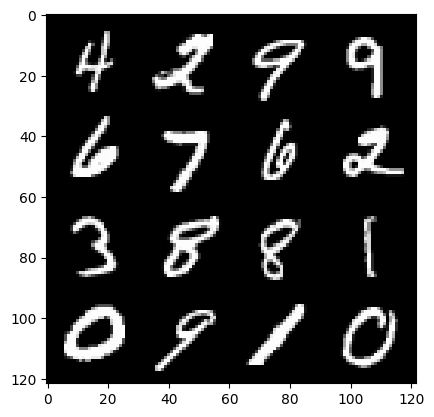

Epoch :68 , Step :37908 , Generator Loss :2.677104958781489 , Discriminator Loss :0.1674471362321465


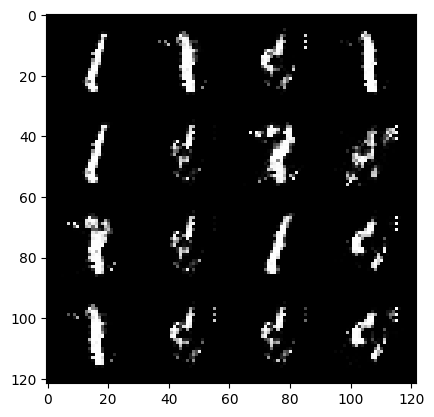

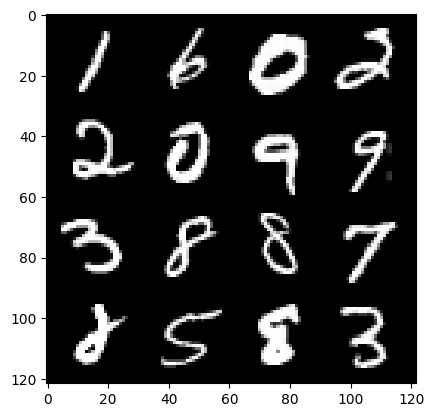

Epoch :68 , Step :38016 , Generator Loss :2.574522181793495 , Discriminator Loss :0.19773563287324372


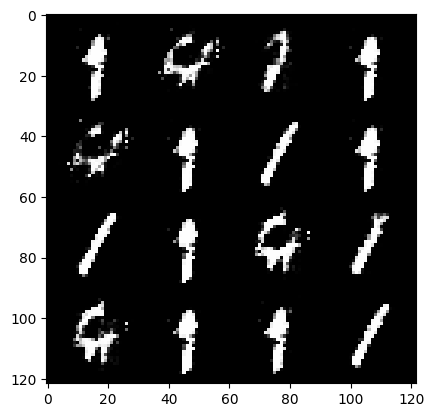

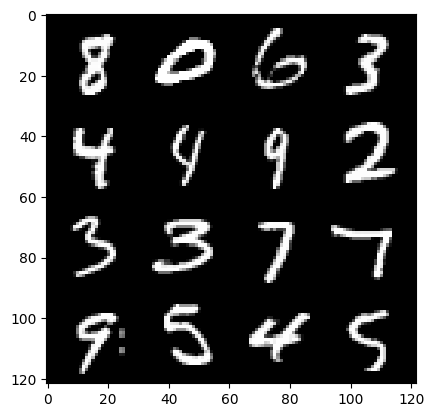

Epoch :68 , Step :38124 , Generator Loss :2.5656745522110542 , Discriminator Loss :0.20214824116340396


  0%|          | 0/469 [00:00<?, ?it/s]

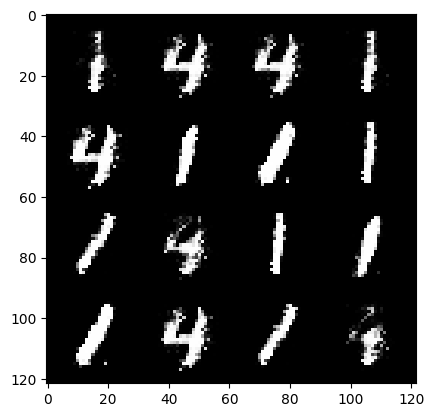

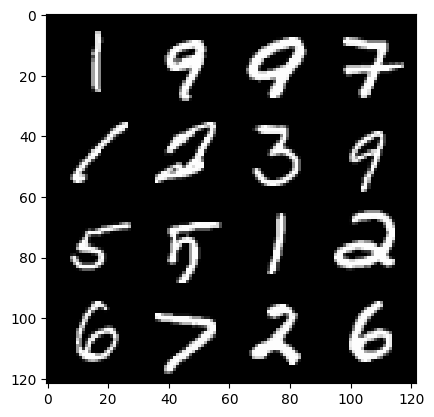

Epoch :69 , Step :38232 , Generator Loss :2.752245092833485 , Discriminator Loss :0.15687541794721727


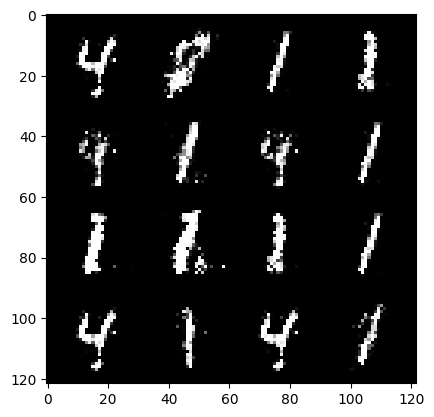

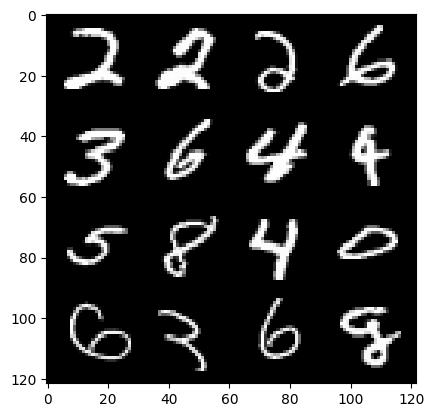

Epoch :69 , Step :38340 , Generator Loss :2.910034358501433 , Discriminator Loss :0.15292290674039616


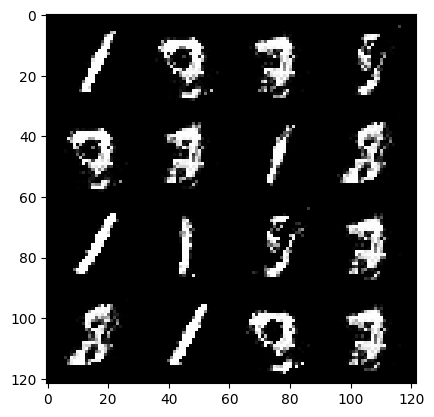

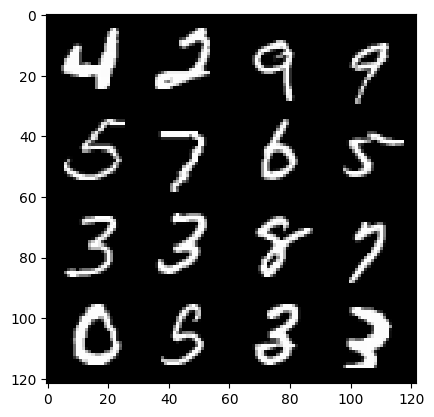

Epoch :69 , Step :38448 , Generator Loss :2.584674289932957 , Discriminator Loss :0.21135352979655625


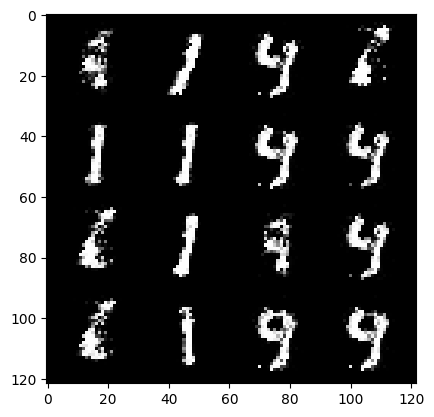

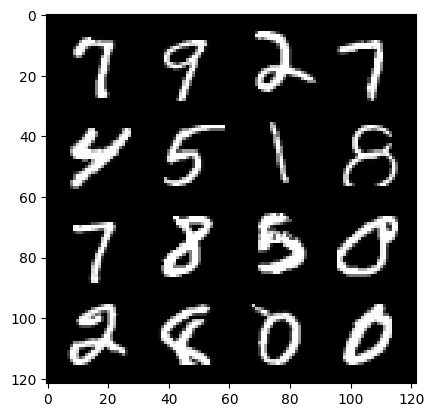

Epoch :69 , Step :38556 , Generator Loss :2.4991268603890036 , Discriminator Loss :0.1849993752936522


  0%|          | 0/469 [00:00<?, ?it/s]

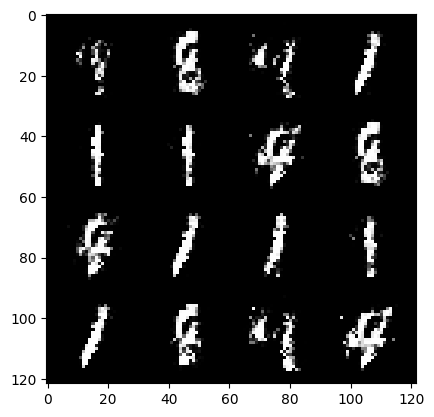

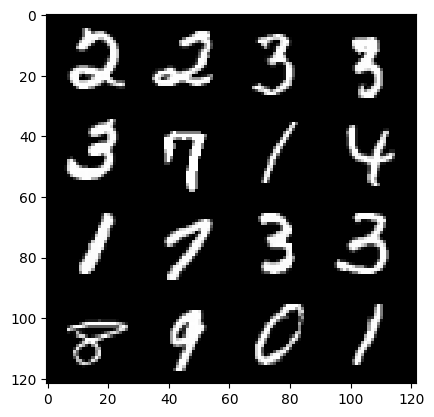

Epoch :70 , Step :38664 , Generator Loss :2.605073851567727 , Discriminator Loss :0.1853292284326421


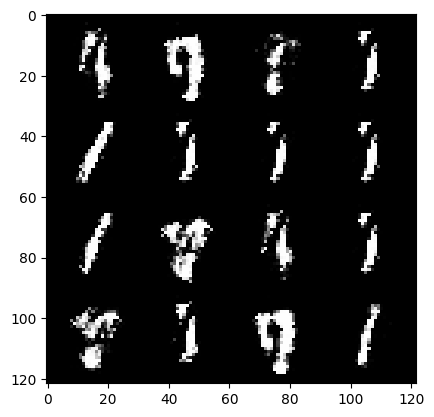

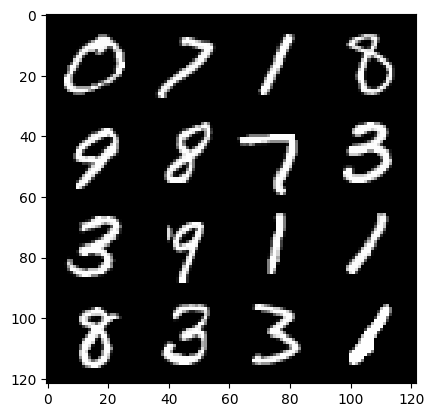

Epoch :70 , Step :38772 , Generator Loss :2.89209160760597 , Discriminator Loss :0.1679251229183541


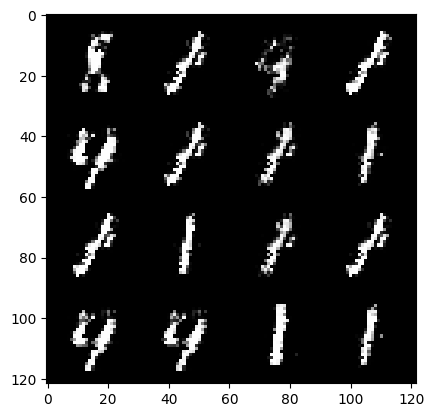

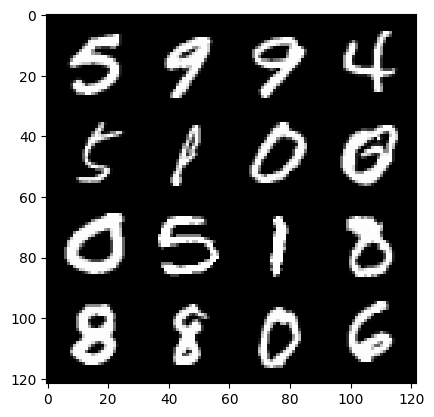

Epoch :70 , Step :38880 , Generator Loss :3.2487700802308552 , Discriminator Loss :0.14693053480651644


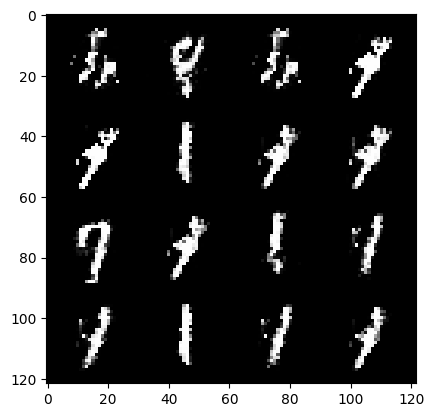

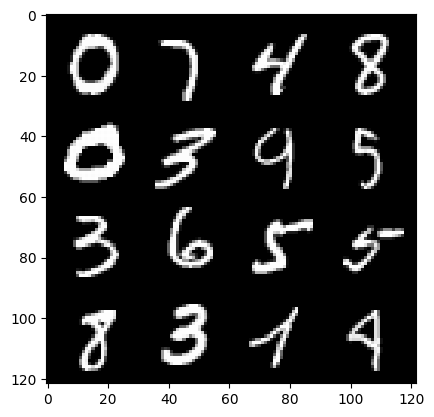

Epoch :70 , Step :38988 , Generator Loss :2.7227859254236577 , Discriminator Loss :0.21057497358156577


  0%|          | 0/469 [00:00<?, ?it/s]

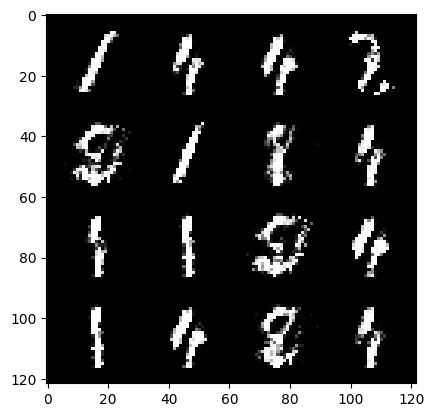

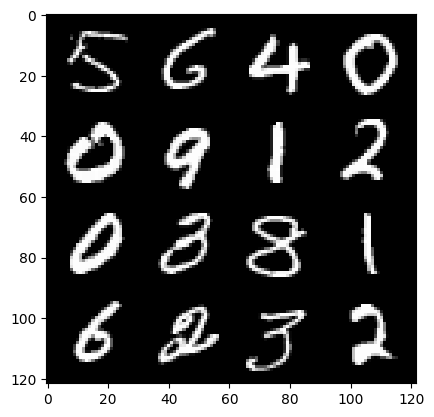

Epoch :71 , Step :39096 , Generator Loss :3.0559078256289176 , Discriminator Loss :0.15581633116084123


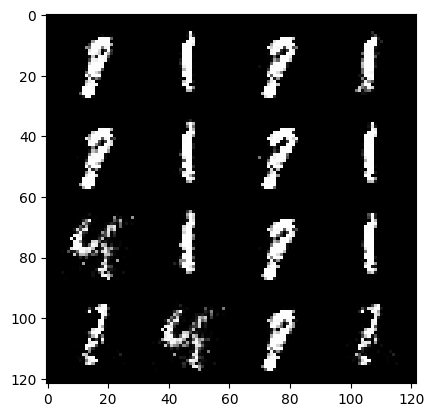

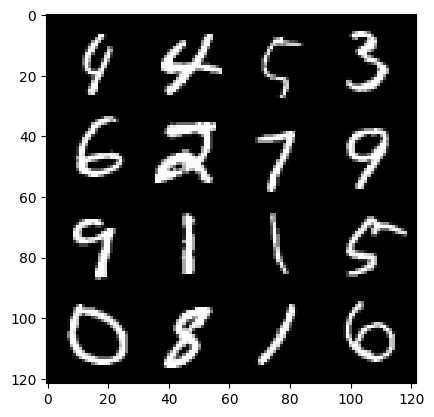

Epoch :71 , Step :39204 , Generator Loss :3.0669196733721975 , Discriminator Loss :0.14727734388024713


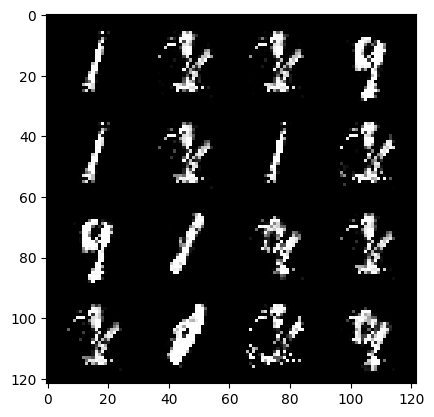

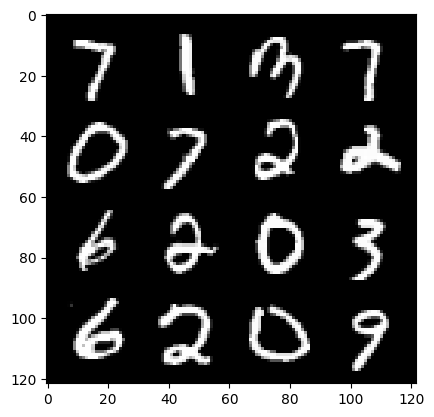

Epoch :71 , Step :39312 , Generator Loss :3.2371444680072656 , Discriminator Loss :0.18581956707768976


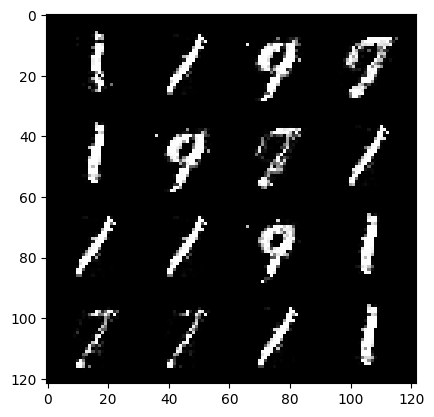

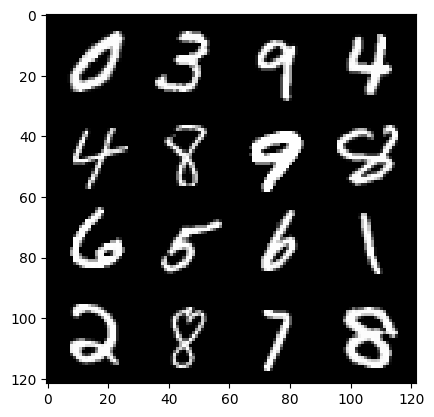

Epoch :71 , Step :39420 , Generator Loss :2.833288852815275 , Discriminator Loss :0.21056114675270196


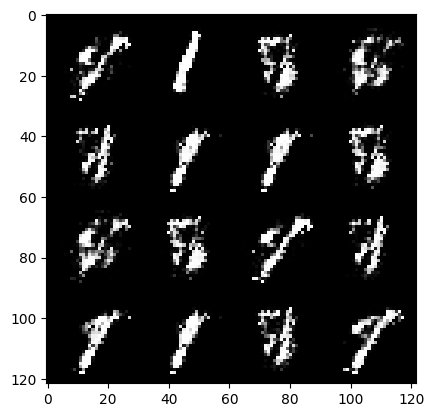

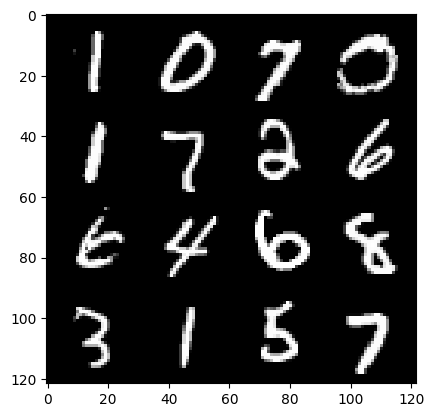

Epoch :71 , Step :39528 , Generator Loss :2.585888527057789 , Discriminator Loss :0.1768103513038821


  0%|          | 0/469 [00:00<?, ?it/s]

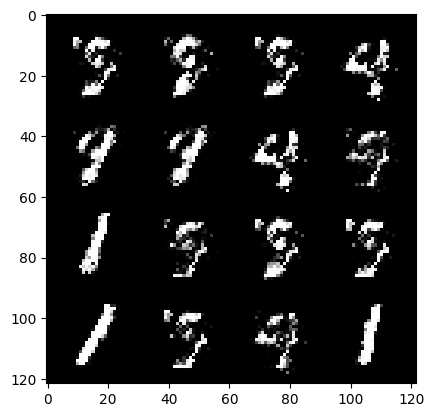

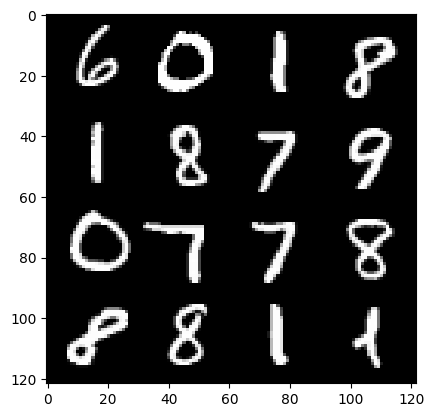

Epoch :72 , Step :39636 , Generator Loss :2.6176745648737314 , Discriminator Loss :0.1744076570978871


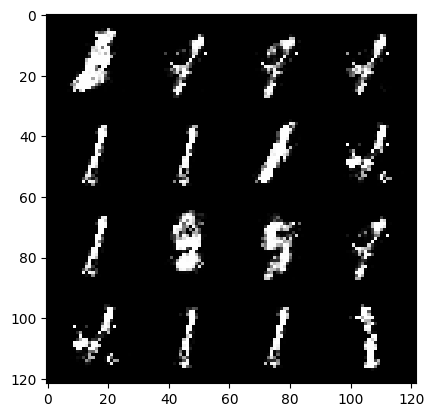

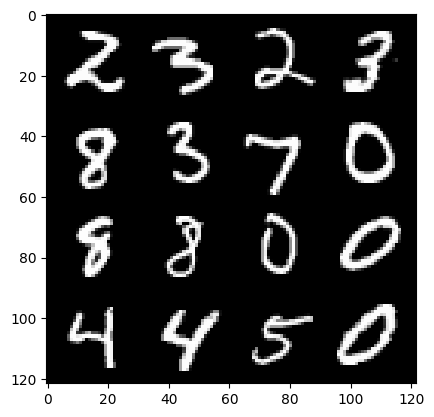

Epoch :72 , Step :39744 , Generator Loss :2.6157616685937946 , Discriminator Loss :0.17526247814573623


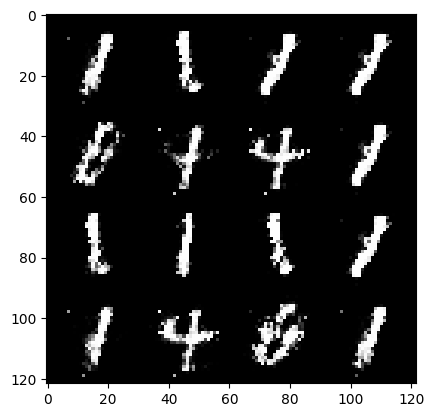

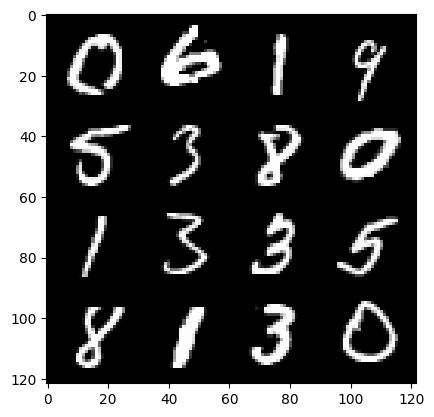

Epoch :72 , Step :39852 , Generator Loss :2.6693930427233354 , Discriminator Loss :0.19420797074282597


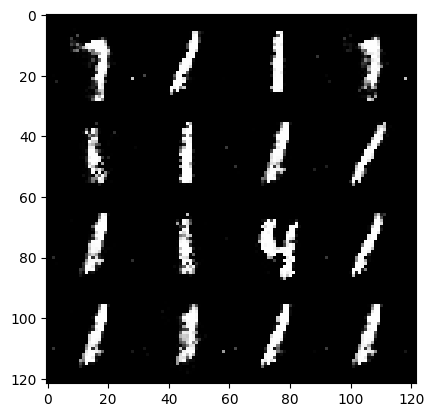

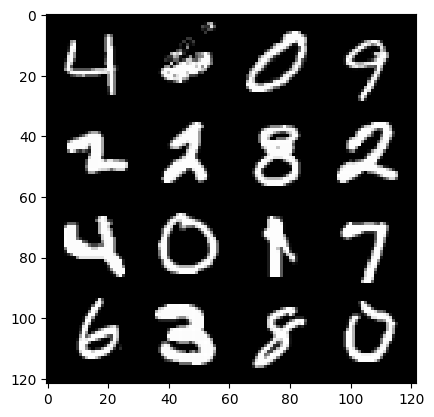

Epoch :72 , Step :39960 , Generator Loss :2.473614778783588 , Discriminator Loss :0.19533727028303682


  0%|          | 0/469 [00:00<?, ?it/s]

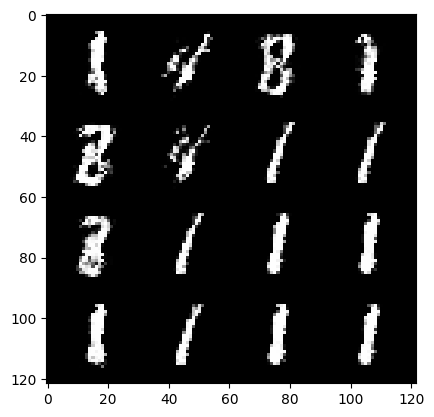

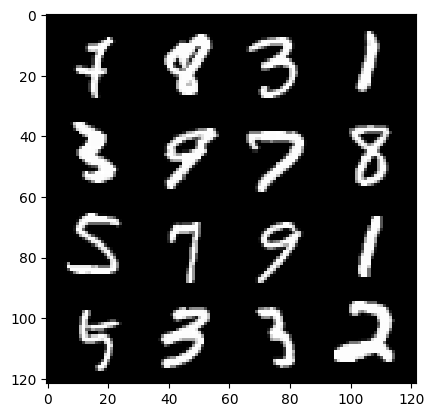

Epoch :73 , Step :40068 , Generator Loss :2.4988741631861084 , Discriminator Loss :0.20493643827460434


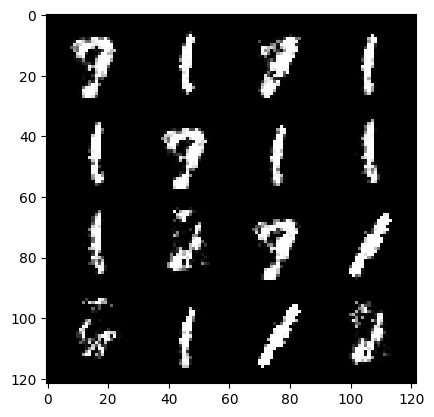

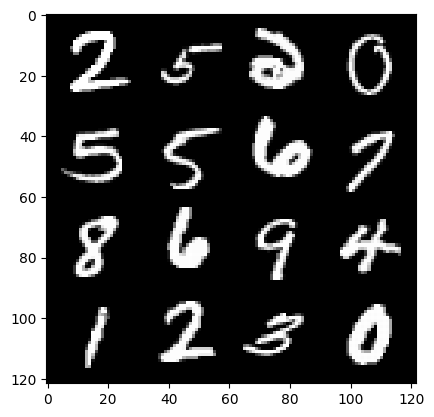

Epoch :73 , Step :40176 , Generator Loss :2.529623537151902 , Discriminator Loss :0.22848590546184114


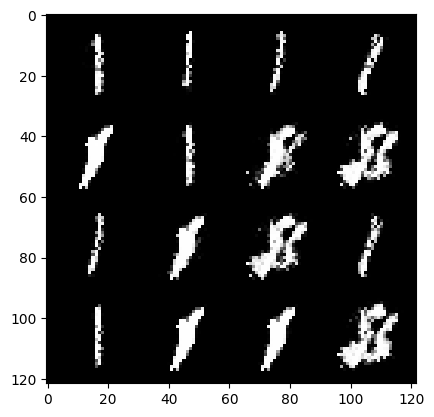

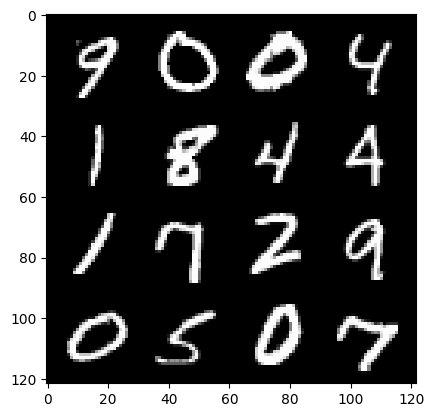

Epoch :73 , Step :40284 , Generator Loss :2.34997840391265 , Discriminator Loss :0.2133220603896511


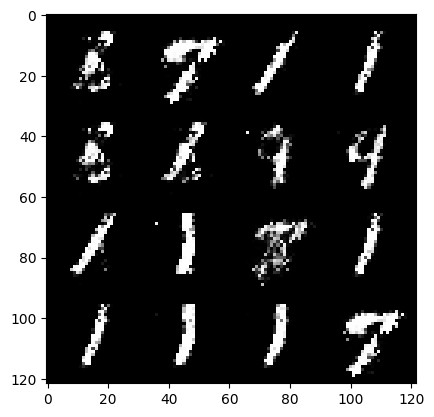

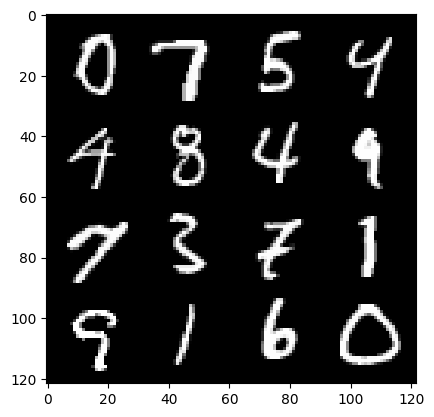

Epoch :73 , Step :40392 , Generator Loss :2.776904867755043 , Discriminator Loss :0.17685196879837248


  0%|          | 0/469 [00:00<?, ?it/s]

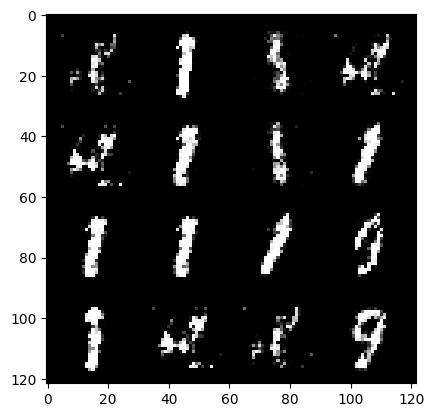

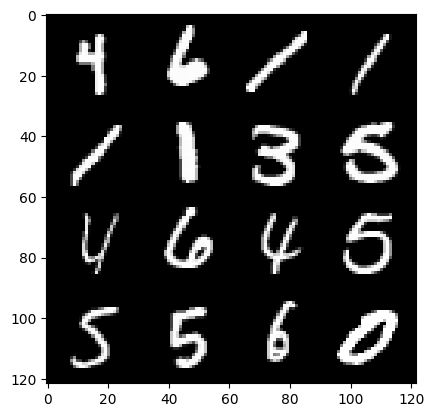

Epoch :74 , Step :40500 , Generator Loss :2.493741680074621 , Discriminator Loss :0.22263912008040485


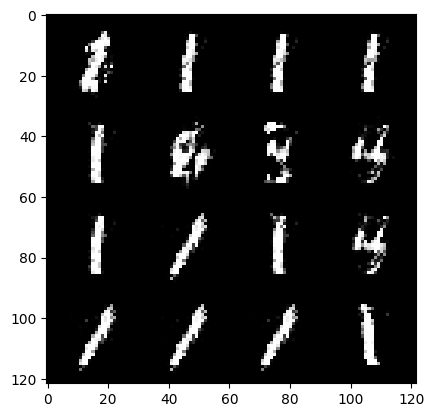

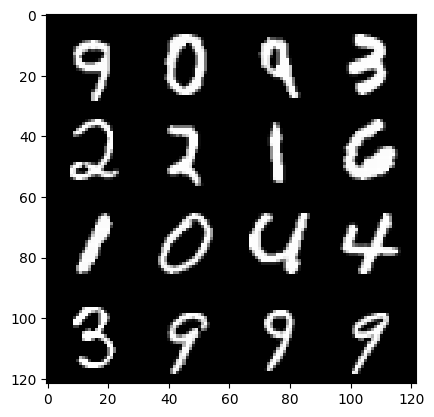

Epoch :74 , Step :40608 , Generator Loss :2.4078784275937966 , Discriminator Loss :0.19602489471435539


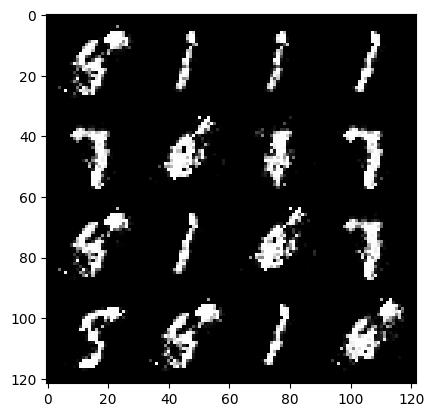

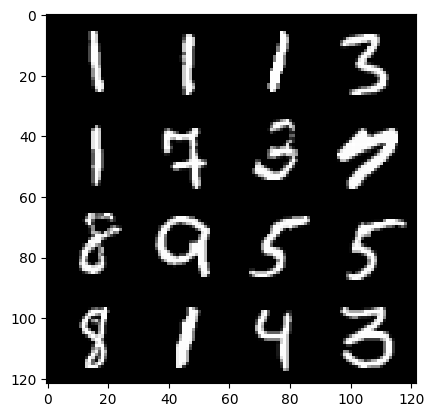

Epoch :74 , Step :40716 , Generator Loss :2.4597836975698124 , Discriminator Loss :0.26035834793691276


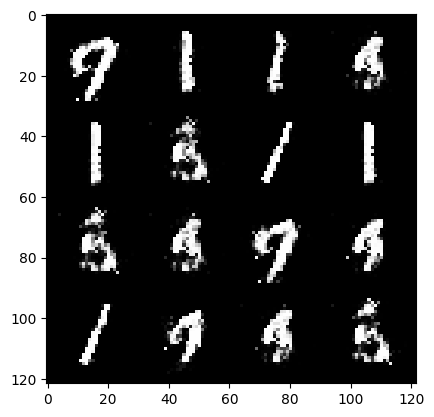

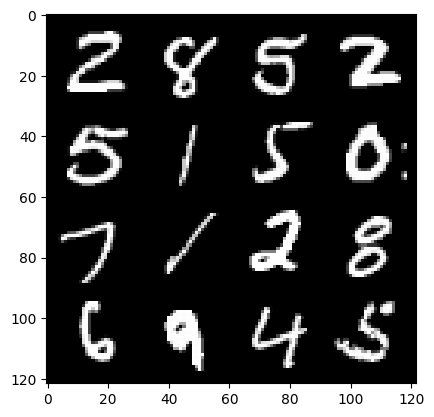

Epoch :74 , Step :40824 , Generator Loss :2.5519361562199063 , Discriminator Loss :0.22172374740518905


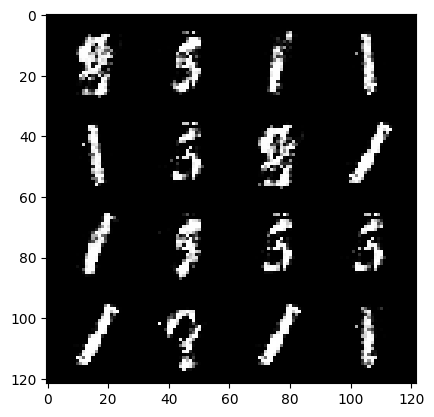

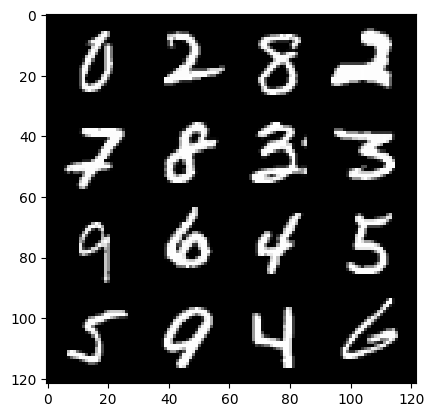

Epoch :74 , Step :40932 , Generator Loss :2.2156410382853626 , Discriminator Loss :0.21176508269100278


  0%|          | 0/469 [00:00<?, ?it/s]

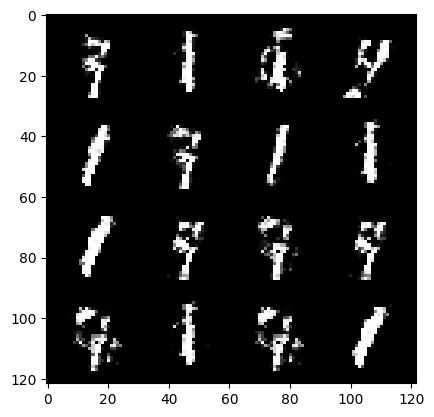

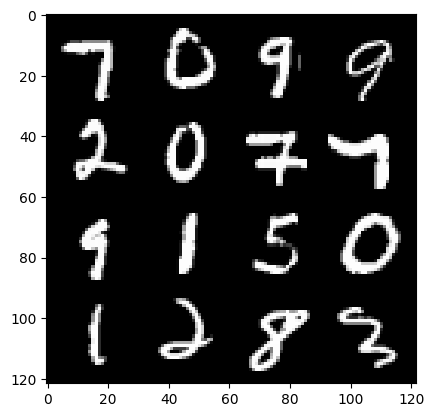

Epoch :75 , Step :41040 , Generator Loss :2.2129065780727952 , Discriminator Loss :0.23035199691851935


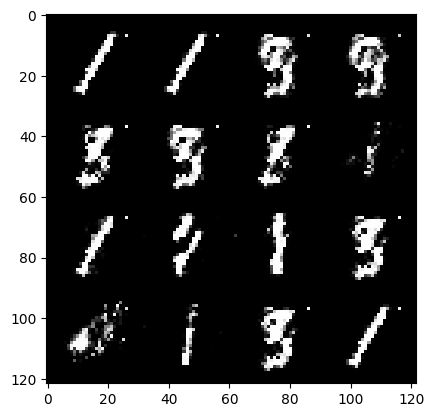

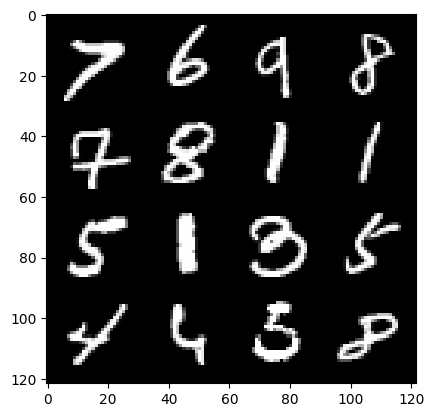

Epoch :75 , Step :41148 , Generator Loss :2.720963483607327 , Discriminator Loss :0.18359321266136783


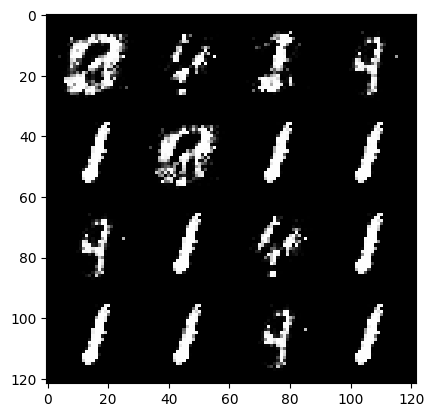

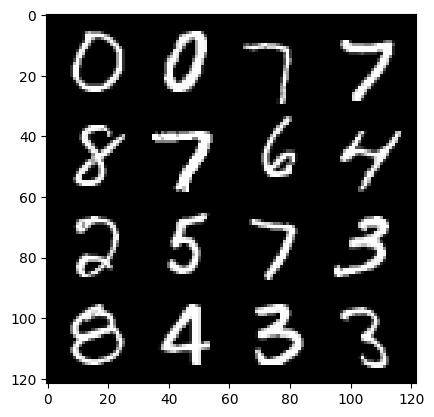

Epoch :75 , Step :41256 , Generator Loss :2.693741063276926 , Discriminator Loss :0.2098420647973264


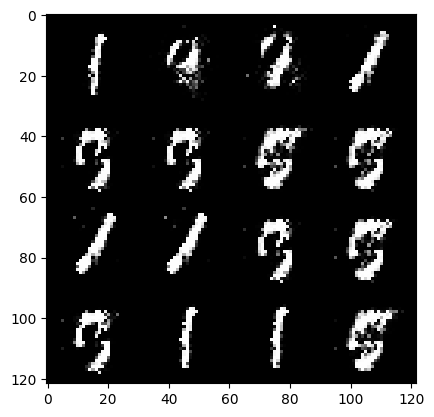

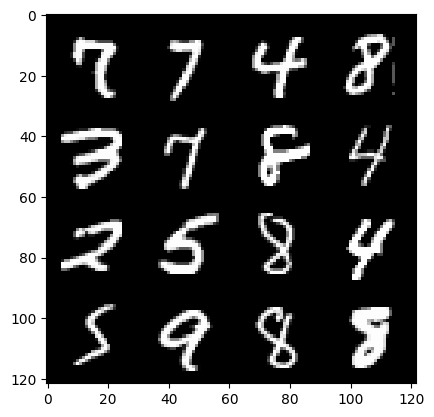

Epoch :75 , Step :41364 , Generator Loss :2.5069906821957355 , Discriminator Loss :0.2118981926253548


  0%|          | 0/469 [00:00<?, ?it/s]

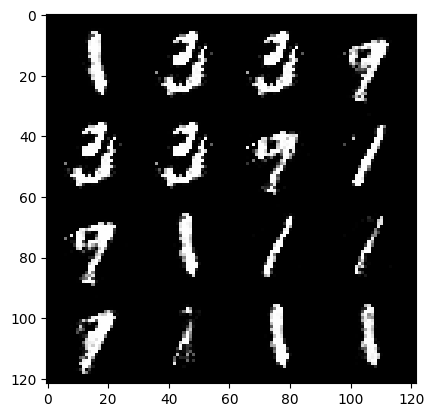

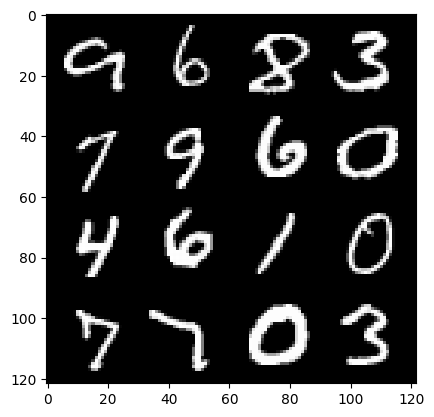

Epoch :76 , Step :41472 , Generator Loss :2.4400332040256925 , Discriminator Loss :0.1862006069471439


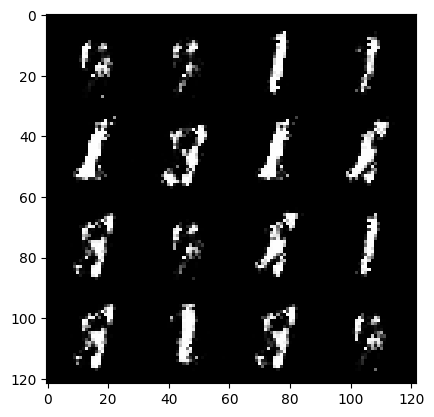

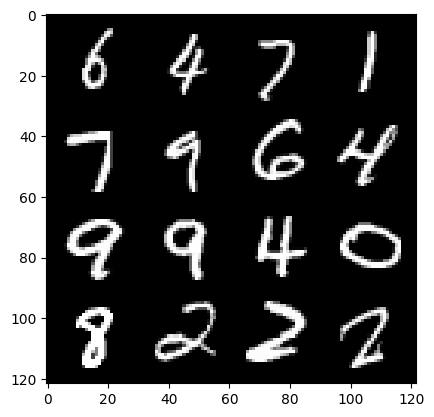

Epoch :76 , Step :41580 , Generator Loss :2.803627316598538 , Discriminator Loss :0.2046554785359789


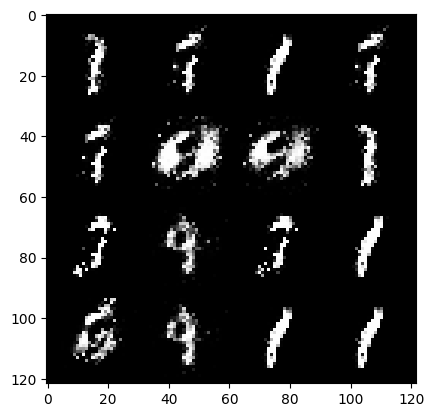

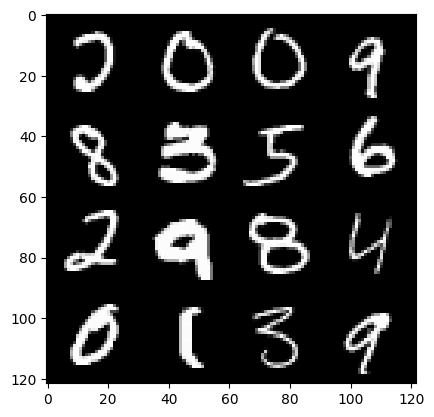

Epoch :76 , Step :41688 , Generator Loss :2.7714751296573223 , Discriminator Loss :0.16552936637567142


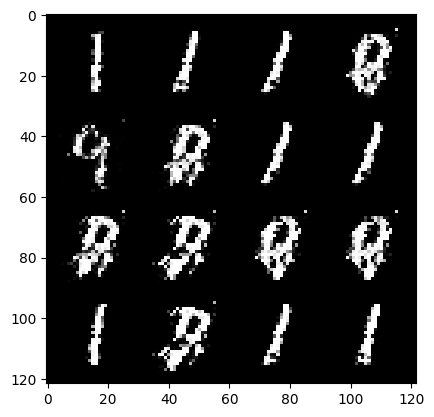

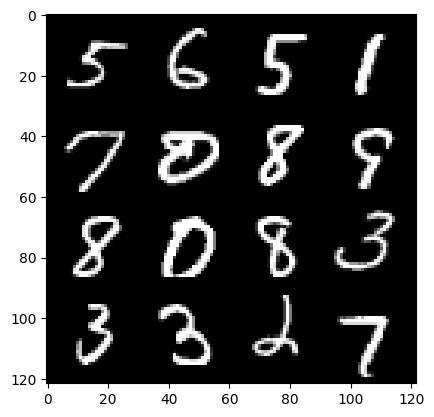

Epoch :76 , Step :41796 , Generator Loss :3.020814094278547 , Discriminator Loss :0.13018422898043078


  0%|          | 0/469 [00:00<?, ?it/s]

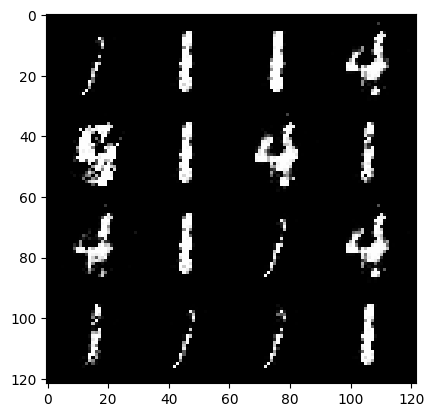

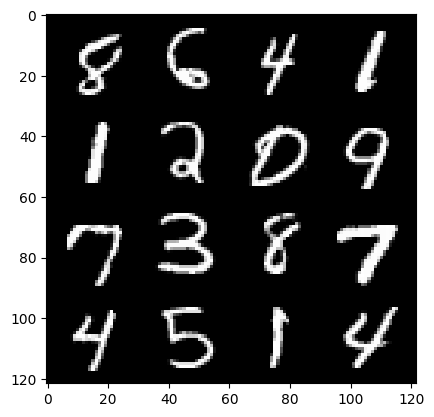

Epoch :77 , Step :41904 , Generator Loss :3.267239402841637 , Discriminator Loss :0.1767154522240161


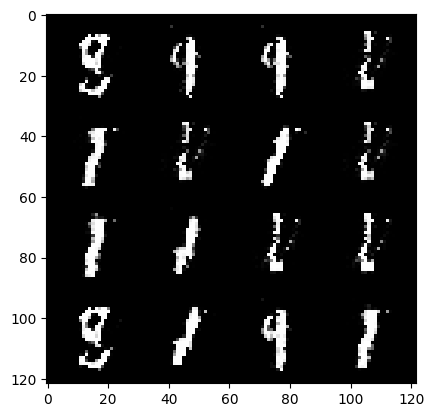

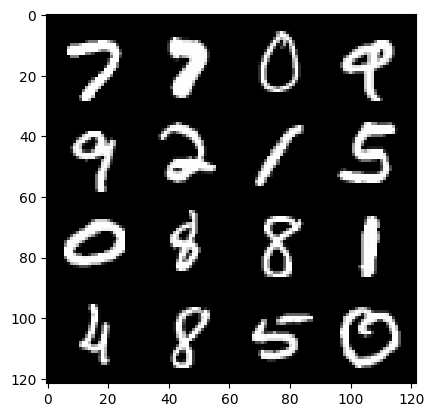

Epoch :77 , Step :42012 , Generator Loss :3.0721560495871083 , Discriminator Loss :0.12132041018318246


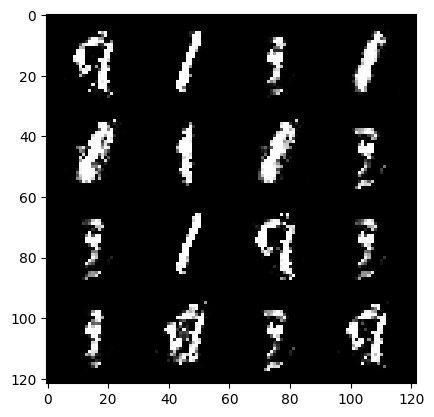

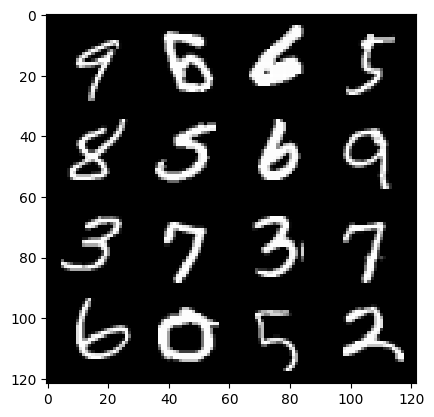

Epoch :77 , Step :42120 , Generator Loss :3.7425410460542765 , Discriminator Loss :0.1407670631176896


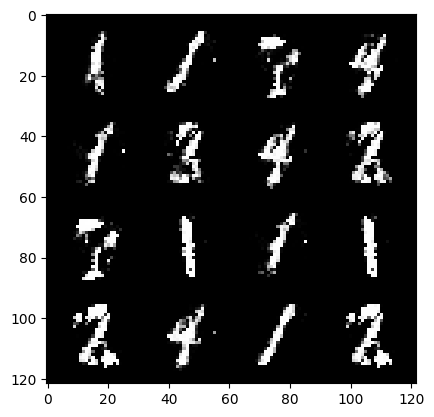

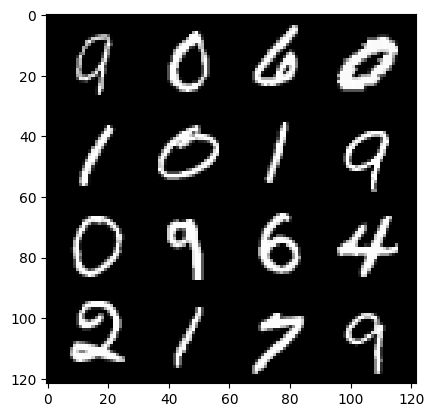

Epoch :77 , Step :42228 , Generator Loss :2.8727489489096185 , Discriminator Loss :0.18592671718862316


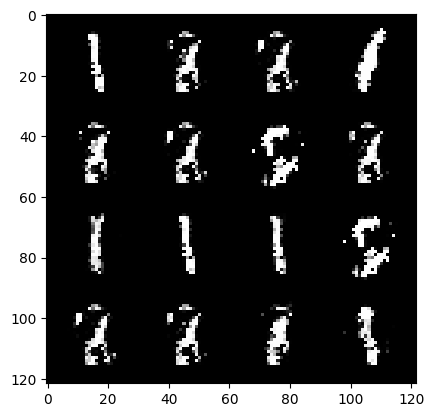

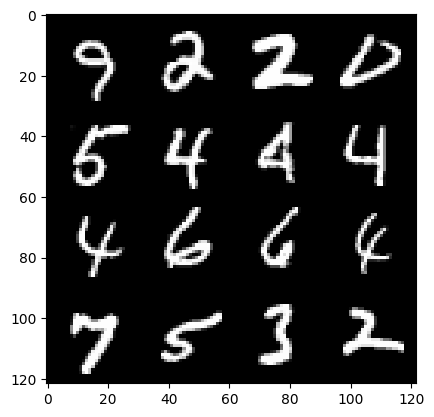

Epoch :77 , Step :42336 , Generator Loss :2.9920846709498647 , Discriminator Loss :0.12590991450404676


  0%|          | 0/469 [00:00<?, ?it/s]

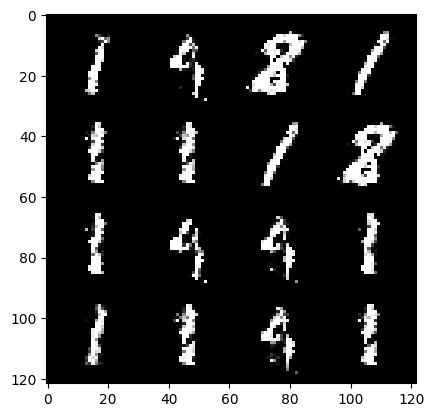

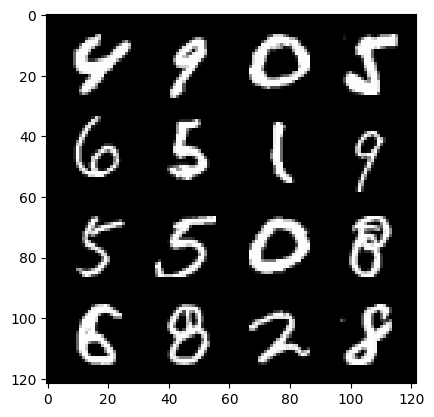

Epoch :78 , Step :42444 , Generator Loss :3.2528698907958127 , Discriminator Loss :0.19076593744534034


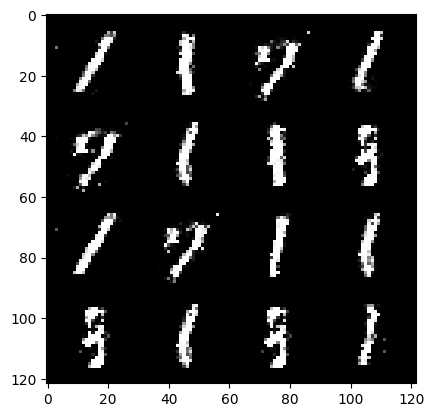

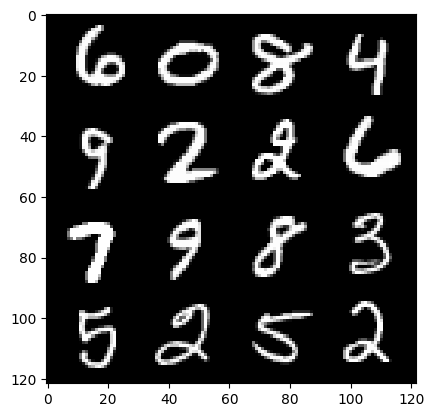

Epoch :78 , Step :42552 , Generator Loss :2.9031638547226226 , Discriminator Loss :0.14893924920923182


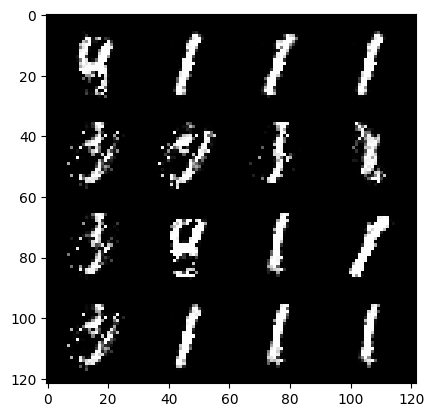

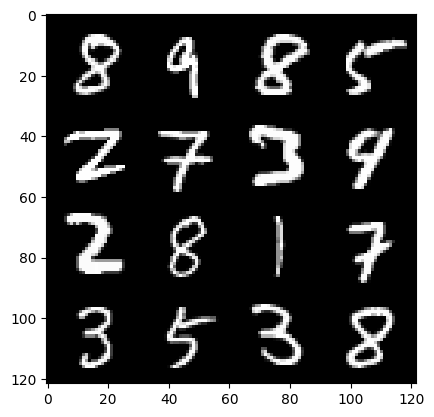

Epoch :78 , Step :42660 , Generator Loss :3.1224379296656 , Discriminator Loss :0.15338543916328087


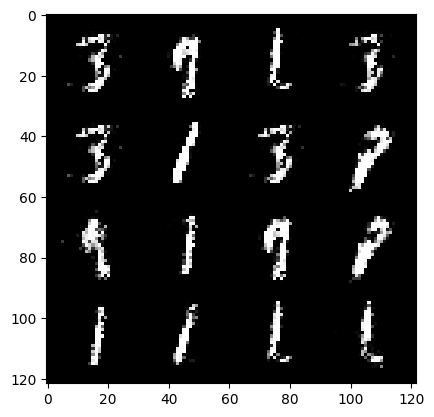

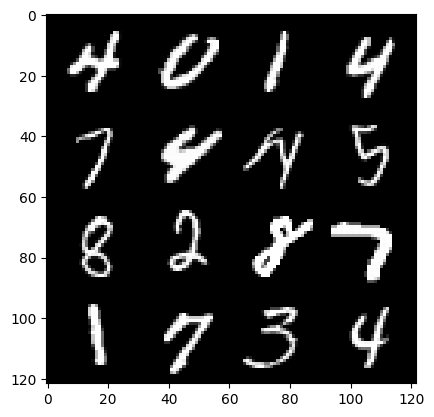

Epoch :78 , Step :42768 , Generator Loss :2.9793583772800583 , Discriminator Loss :0.21671833898182283


  0%|          | 0/469 [00:00<?, ?it/s]

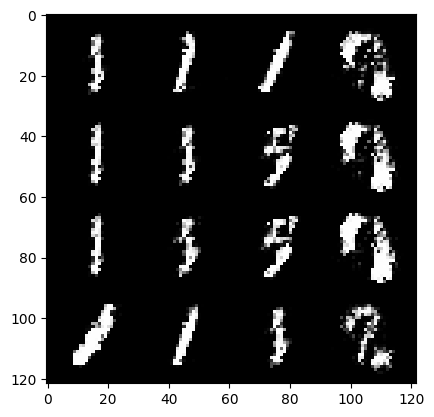

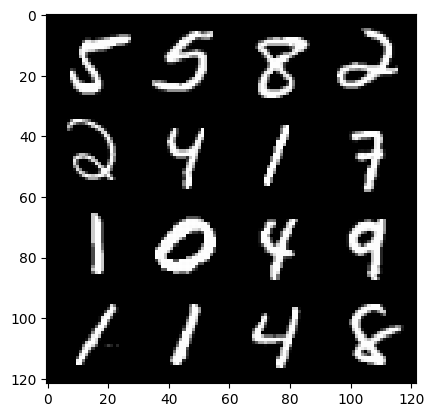

Epoch :79 , Step :42876 , Generator Loss :2.5764632313339795 , Discriminator Loss :0.18464443115172563


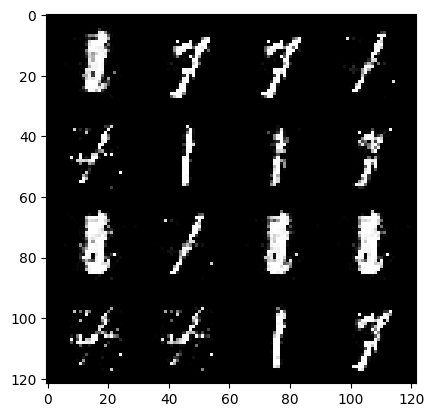

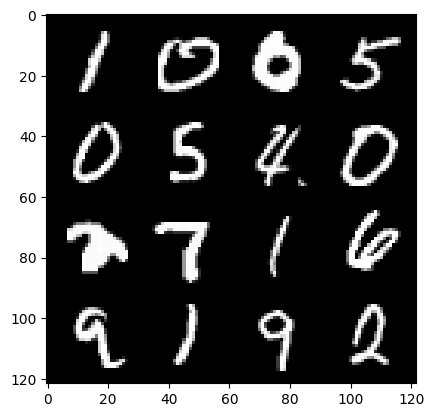

Epoch :79 , Step :42984 , Generator Loss :2.6733312032840857 , Discriminator Loss :0.22372517238060638


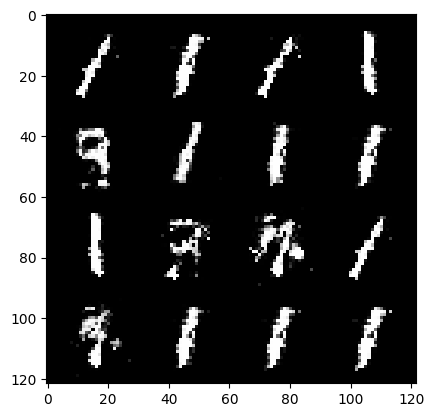

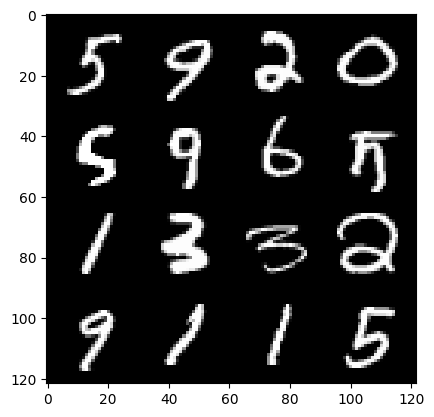

Epoch :79 , Step :43092 , Generator Loss :2.456432923122688 , Discriminator Loss :0.18339535207660113


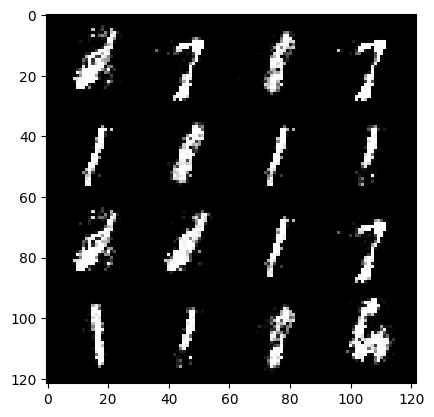

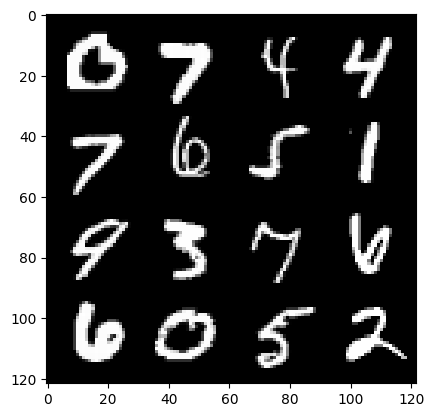

Epoch :79 , Step :43200 , Generator Loss :2.762962354554071 , Discriminator Loss :0.19304379572470987


  0%|          | 0/469 [00:00<?, ?it/s]

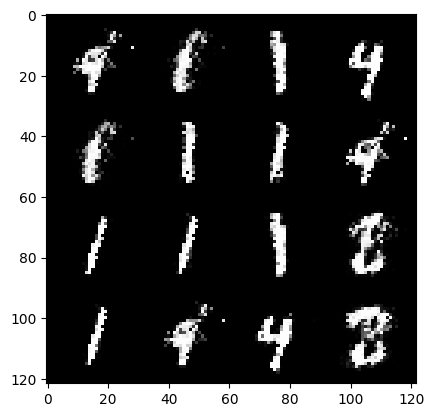

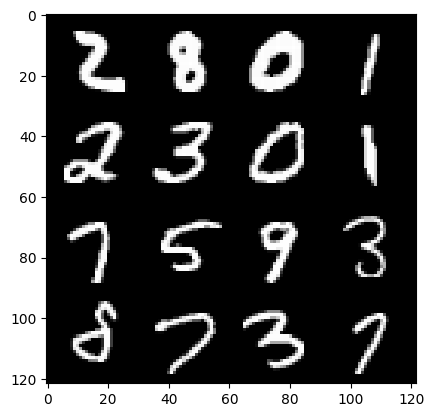

Epoch :80 , Step :43308 , Generator Loss :2.550729135672252 , Discriminator Loss :0.15927468971521774


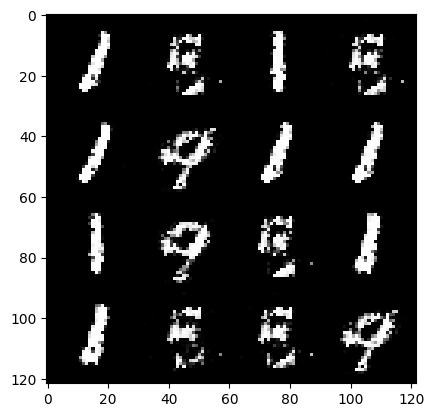

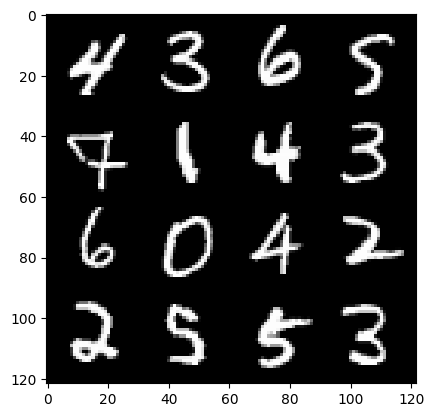

Epoch :80 , Step :43416 , Generator Loss :2.9528215549610275 , Discriminator Loss :0.1580355393665809


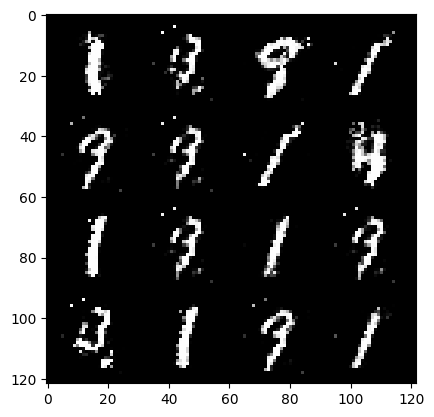

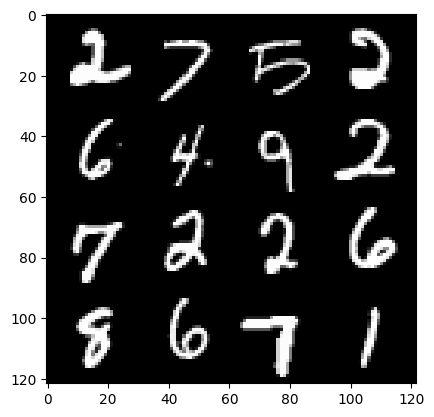

Epoch :80 , Step :43524 , Generator Loss :3.0416466262605435 , Discriminator Loss :0.1855804263441651


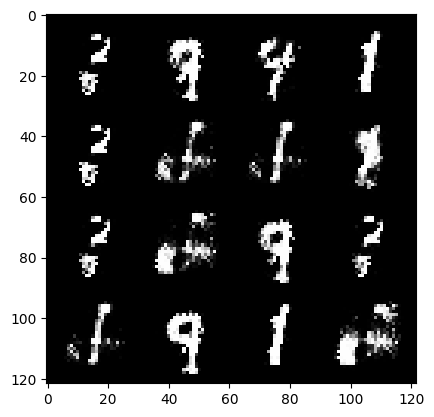

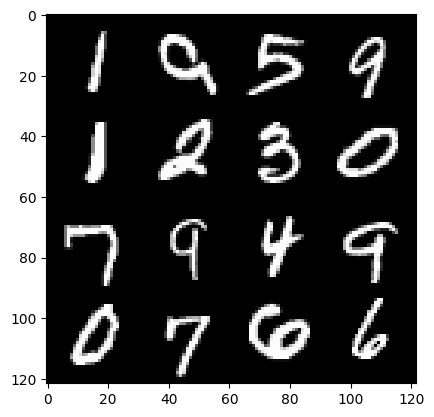

Epoch :80 , Step :43632 , Generator Loss :2.813210052472574 , Discriminator Loss :0.17102479824313416


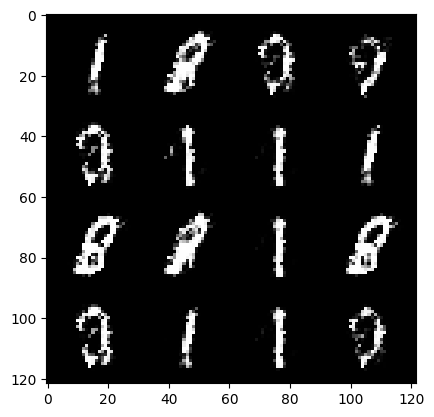

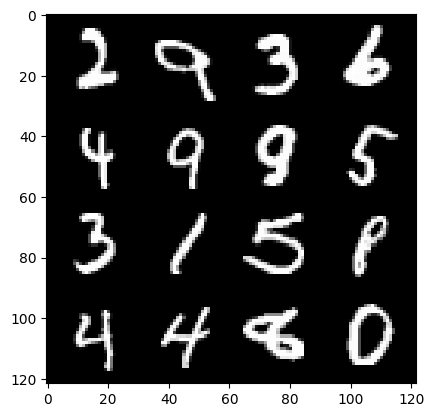

Epoch :80 , Step :43740 , Generator Loss :2.937566582803372 , Discriminator Loss :0.1749280387604678


  0%|          | 0/469 [00:00<?, ?it/s]

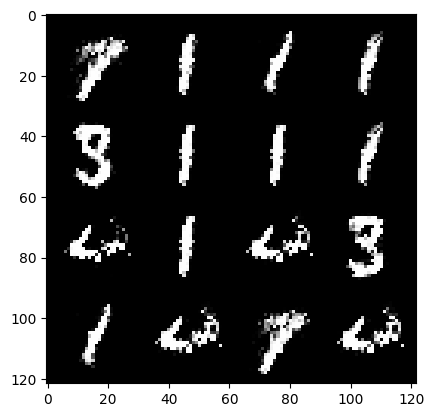

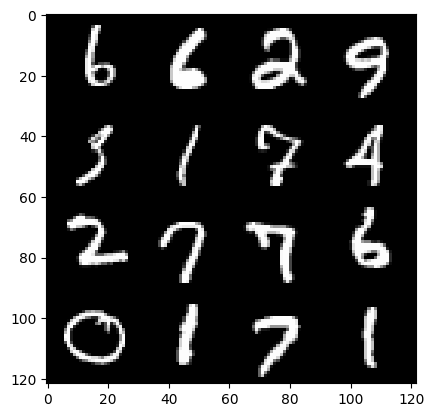

Epoch :81 , Step :43848 , Generator Loss :2.709330488134313 , Discriminator Loss :0.19795296865480916


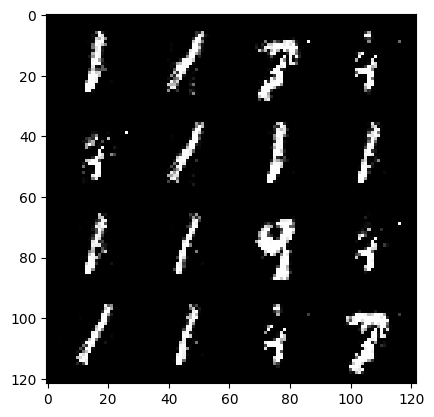

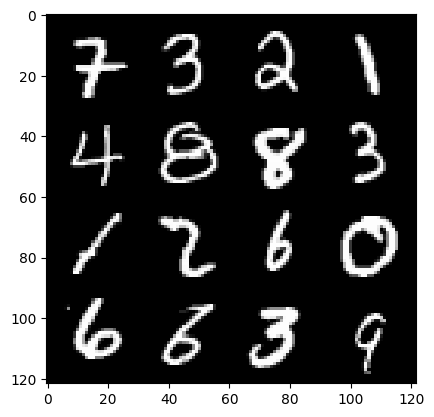

Epoch :81 , Step :43956 , Generator Loss :2.837602463033465 , Discriminator Loss :0.15630123550417244


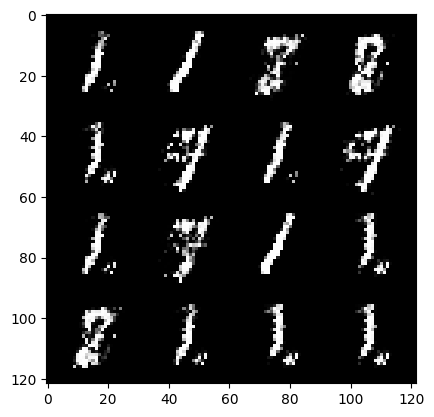

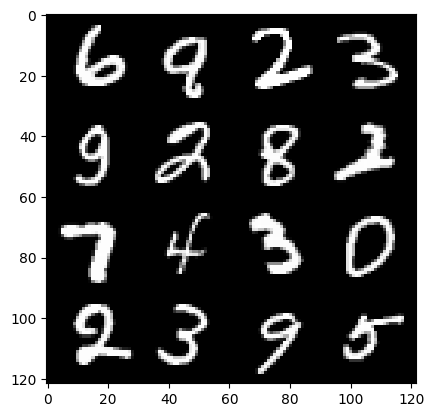

Epoch :81 , Step :44064 , Generator Loss :2.687123230210056 , Discriminator Loss :0.15573199010557592


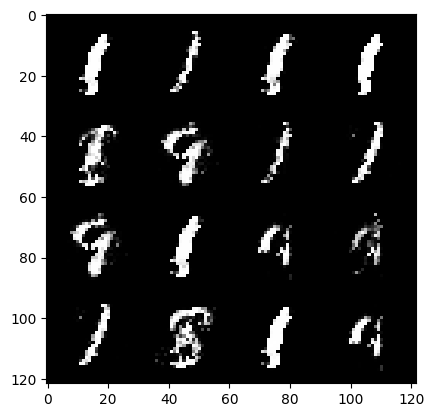

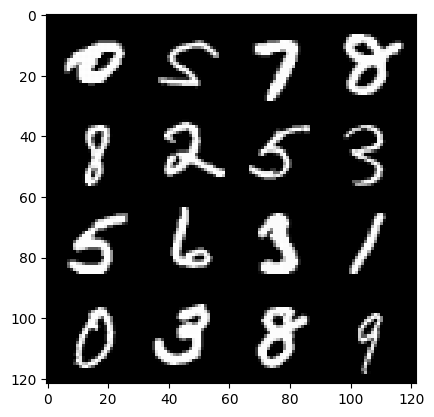

Epoch :81 , Step :44172 , Generator Loss :3.142356177171072 , Discriminator Loss :0.14325288828048444


  0%|          | 0/469 [00:00<?, ?it/s]

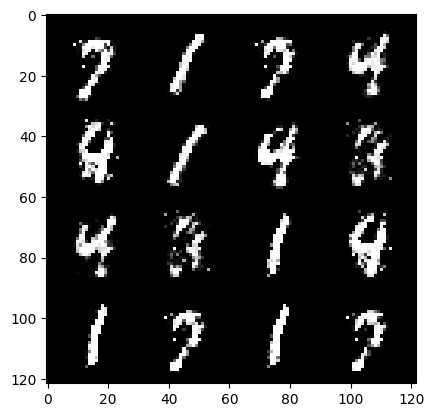

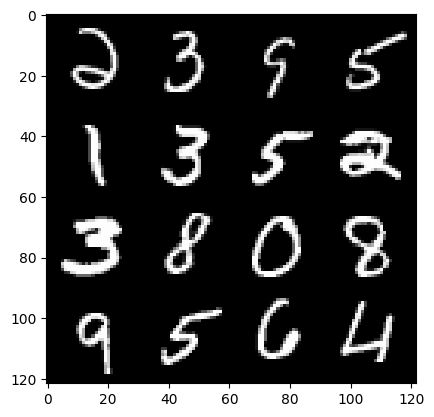

Epoch :82 , Step :44280 , Generator Loss :3.6505342479105347 , Discriminator Loss :0.12869313207489474


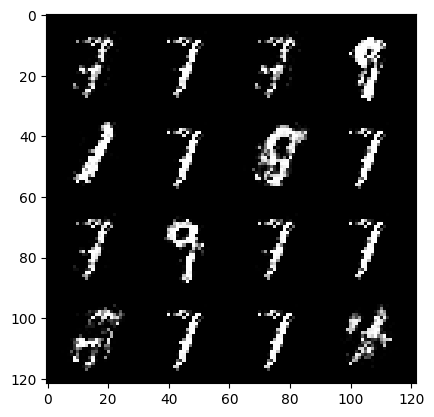

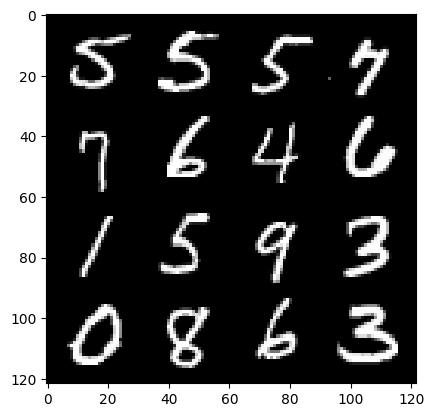

Epoch :82 , Step :44388 , Generator Loss :3.1263761630764715 , Discriminator Loss :0.17209517472872032


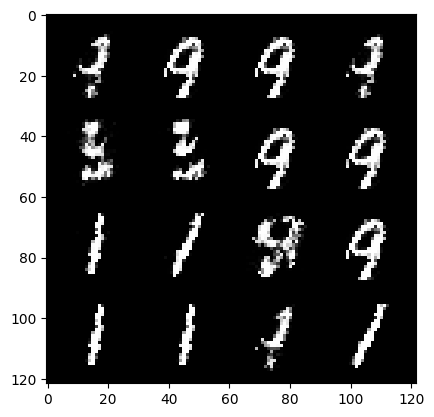

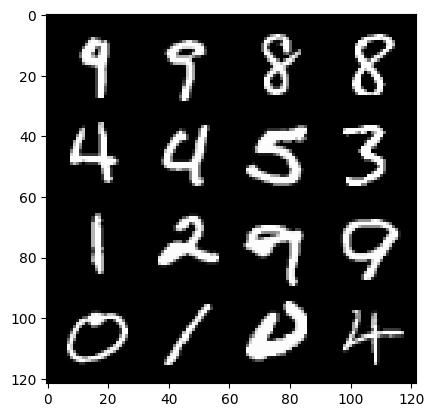

Epoch :82 , Step :44496 , Generator Loss :2.671064529154037 , Discriminator Loss :0.15648462230132684


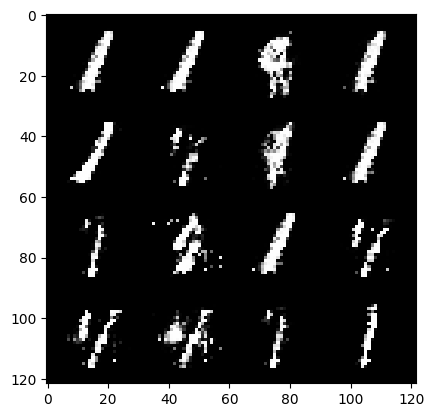

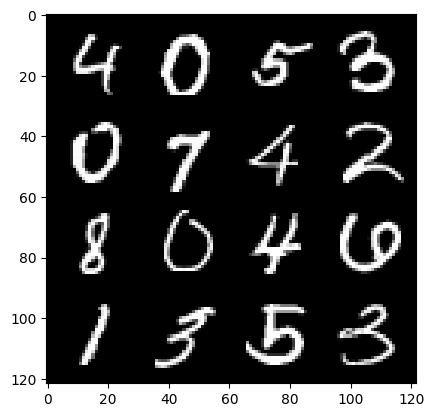

Epoch :82 , Step :44604 , Generator Loss :2.936493288587641 , Discriminator Loss :0.15230934356373765


  0%|          | 0/469 [00:00<?, ?it/s]

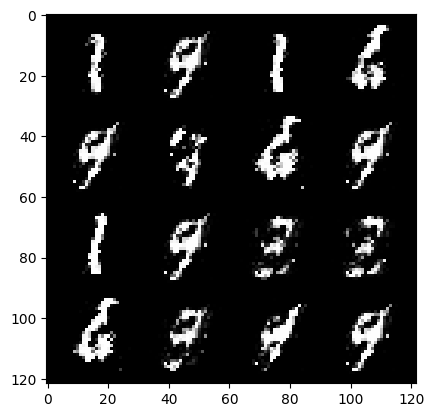

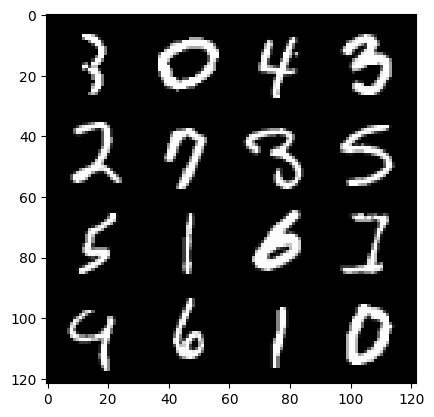

Epoch :83 , Step :44712 , Generator Loss :3.169741131641246 , Discriminator Loss :0.1947459915169962


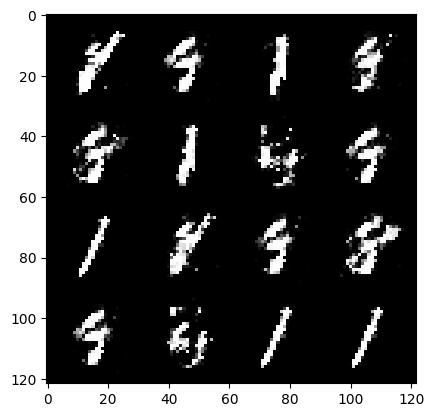

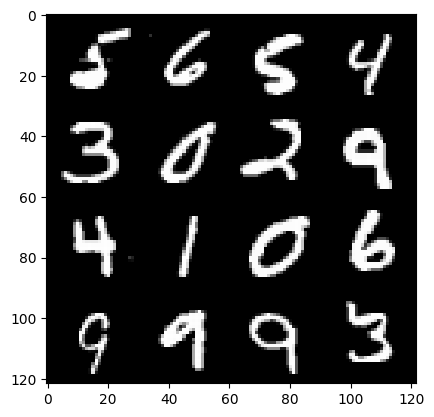

Epoch :83 , Step :44820 , Generator Loss :2.8982353210449223 , Discriminator Loss :0.18599103570536332


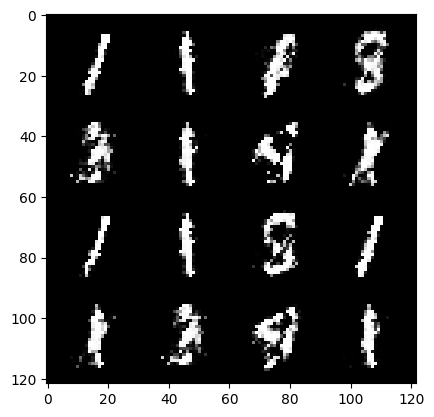

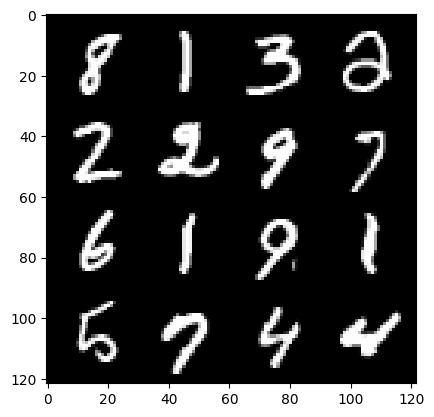

Epoch :83 , Step :44928 , Generator Loss :2.612072901593314 , Discriminator Loss :0.20496302525754317


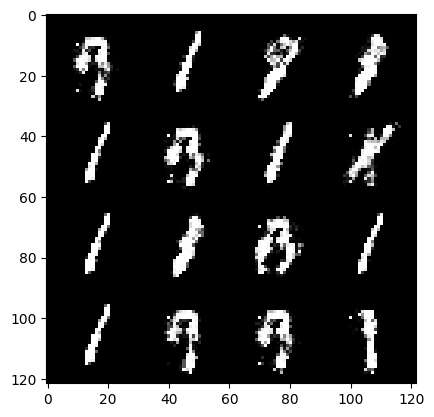

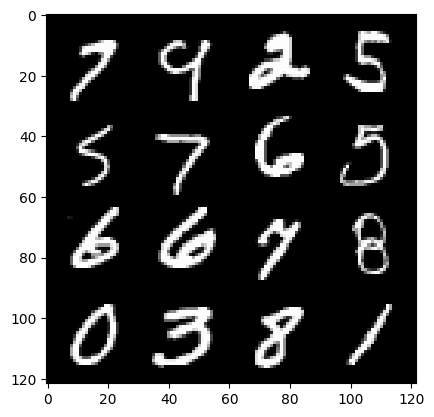

Epoch :83 , Step :45036 , Generator Loss :2.6357829769452414 , Discriminator Loss :0.2065477091129179


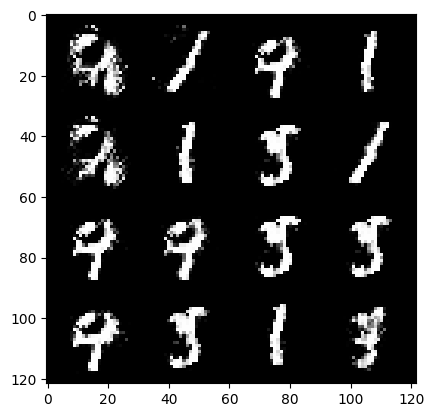

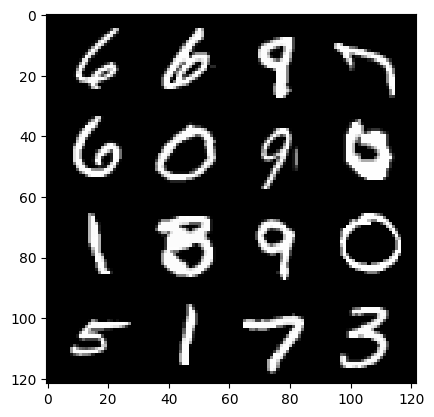

Epoch :83 , Step :45144 , Generator Loss :2.7611320371981023 , Discriminator Loss :0.23026827557219404


  0%|          | 0/469 [00:00<?, ?it/s]

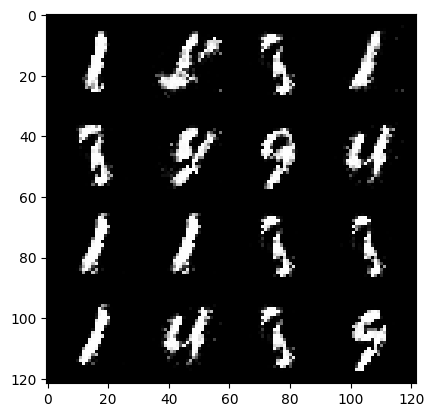

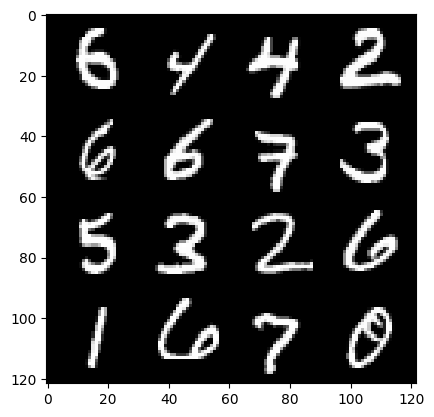

Epoch :84 , Step :45252 , Generator Loss :2.192232055796517 , Discriminator Loss :0.2690085696953315


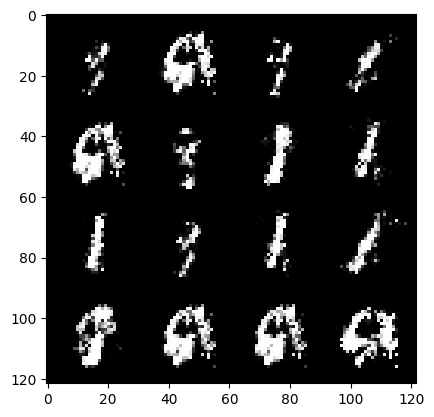

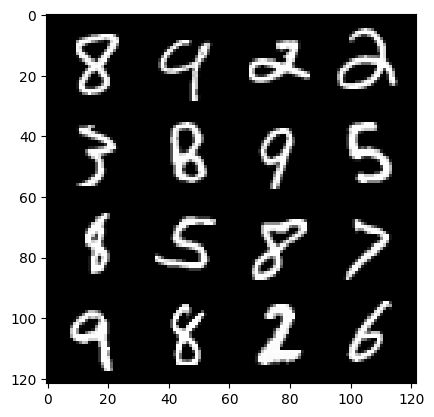

Epoch :84 , Step :45360 , Generator Loss :2.1819671756691394 , Discriminator Loss :0.1983449576353586


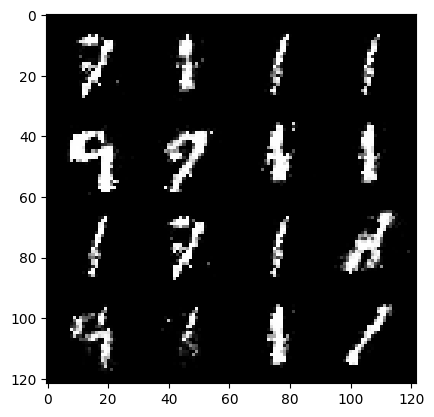

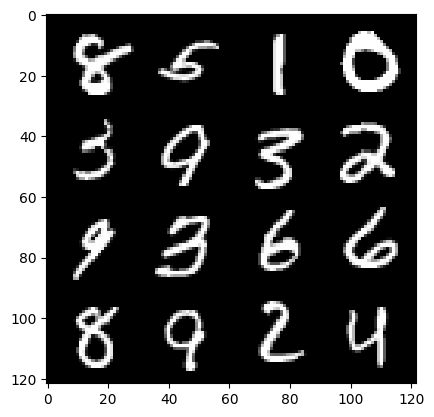

Epoch :84 , Step :45468 , Generator Loss :2.432803285342675 , Discriminator Loss :0.21064418685381064


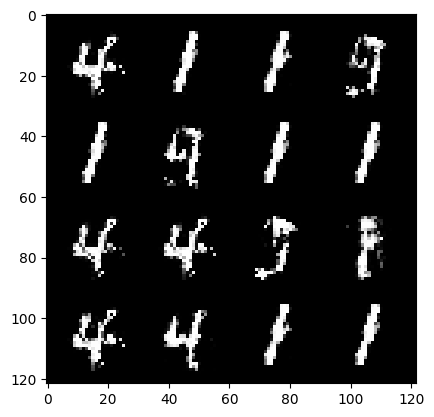

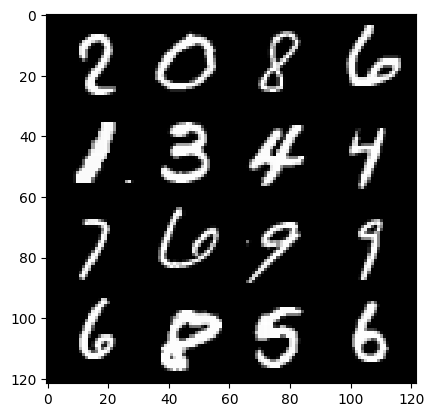

Epoch :84 , Step :45576 , Generator Loss :2.176282596808892 , Discriminator Loss :0.2384573687557822


  0%|          | 0/469 [00:00<?, ?it/s]

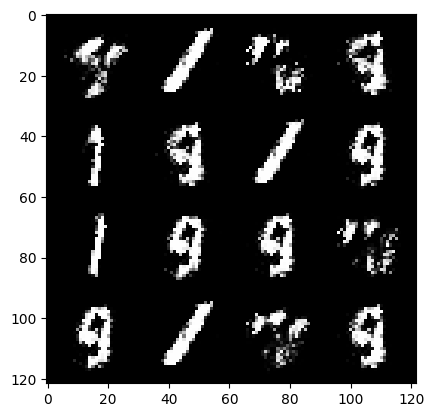

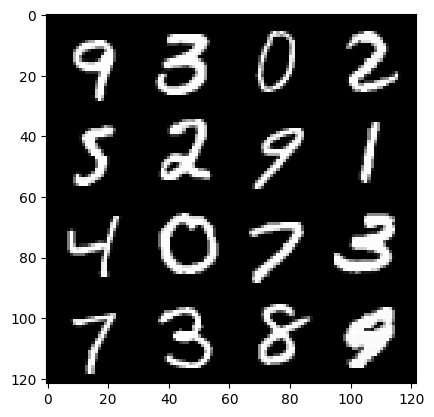

Epoch :85 , Step :45684 , Generator Loss :2.5687221686045345 , Discriminator Loss :0.20212585685981646


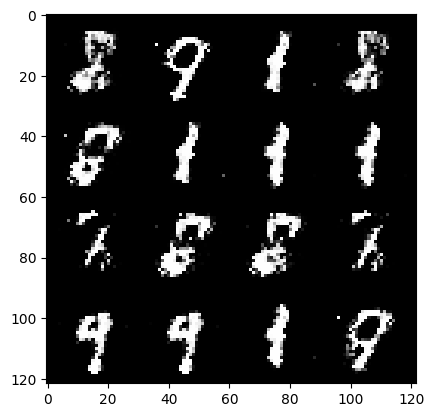

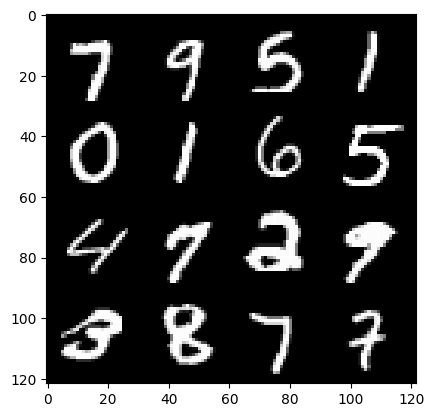

Epoch :85 , Step :45792 , Generator Loss :2.6677633634320004 , Discriminator Loss :0.19411402216388102


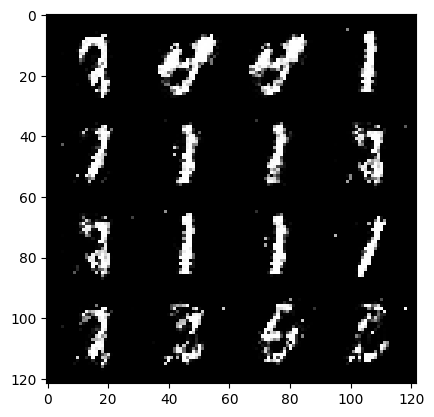

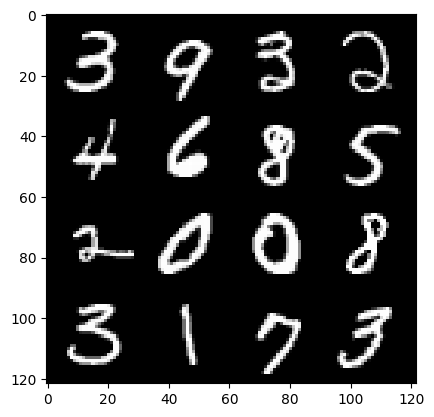

Epoch :85 , Step :45900 , Generator Loss :2.7585567854068893 , Discriminator Loss :0.2186936446362071


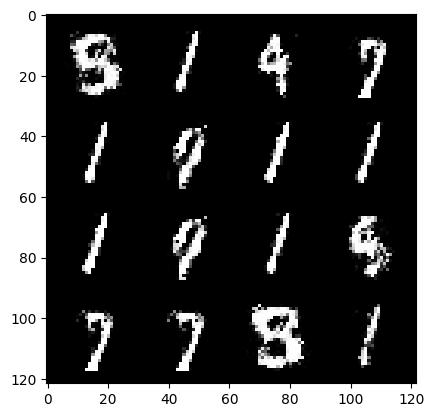

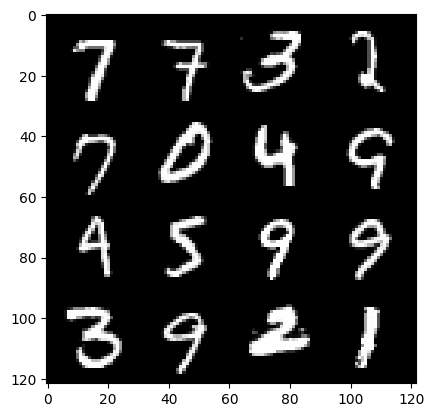

Epoch :85 , Step :46008 , Generator Loss :2.8862145388567897 , Discriminator Loss :0.23778558839802388


  0%|          | 0/469 [00:00<?, ?it/s]

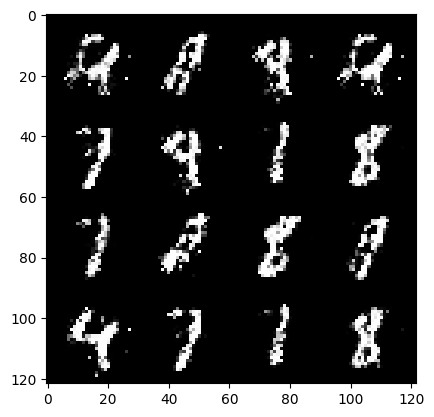

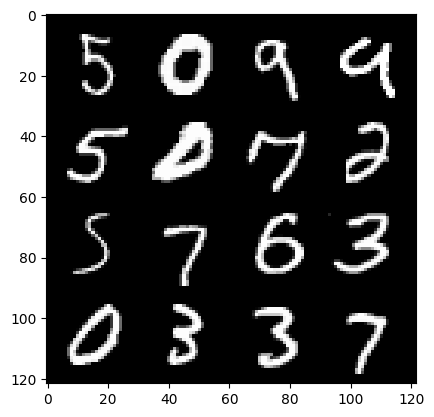

Epoch :86 , Step :46116 , Generator Loss :2.4730481240484443 , Discriminator Loss :0.2237724414854137


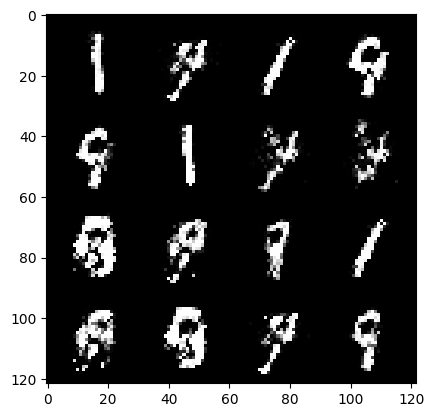

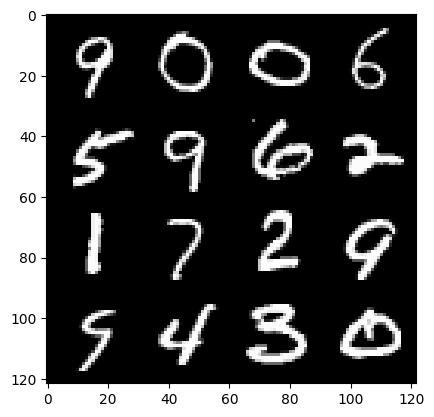

Epoch :86 , Step :46224 , Generator Loss :2.291186721236617 , Discriminator Loss :0.23470995078484216


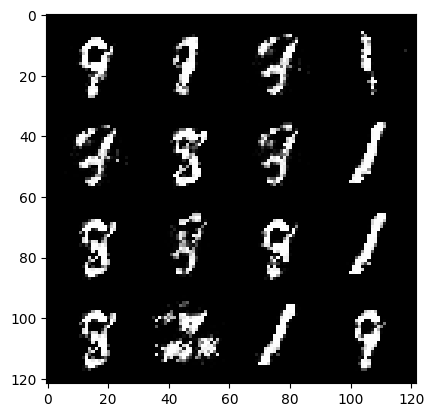

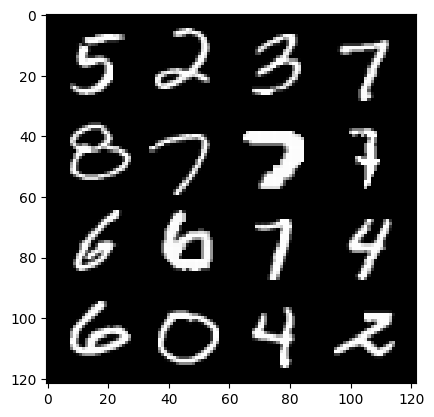

Epoch :86 , Step :46332 , Generator Loss :2.539917742764507 , Discriminator Loss :0.23419054721792545


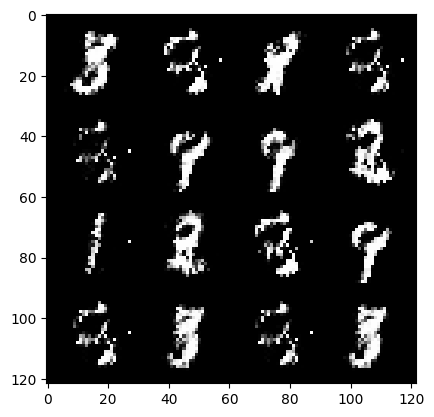

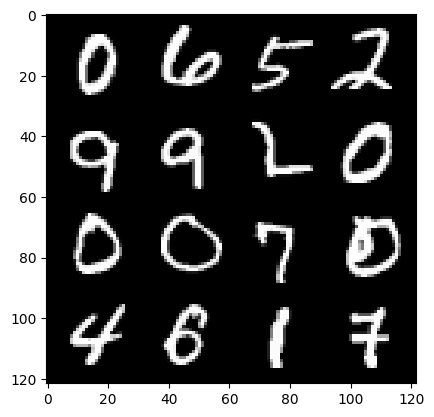

Epoch :86 , Step :46440 , Generator Loss :2.2937693055029262 , Discriminator Loss :0.2581950005281854


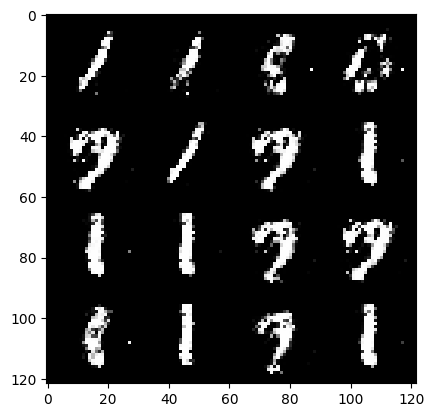

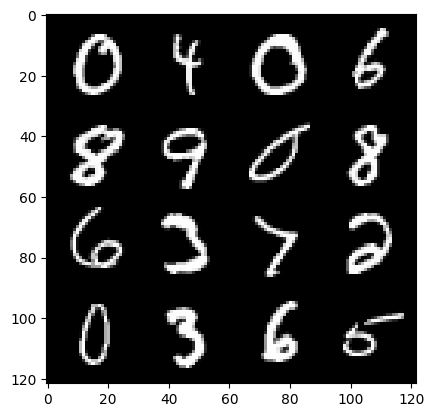

Epoch :86 , Step :46548 , Generator Loss :2.3990574854391595 , Discriminator Loss :0.2512885677041831


  0%|          | 0/469 [00:00<?, ?it/s]

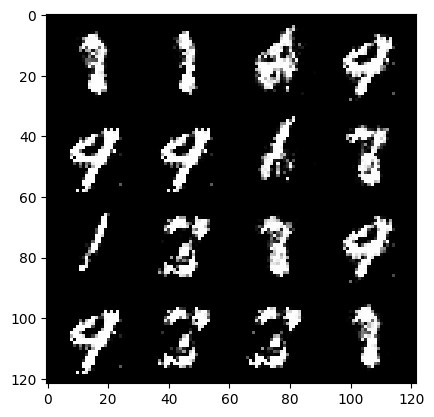

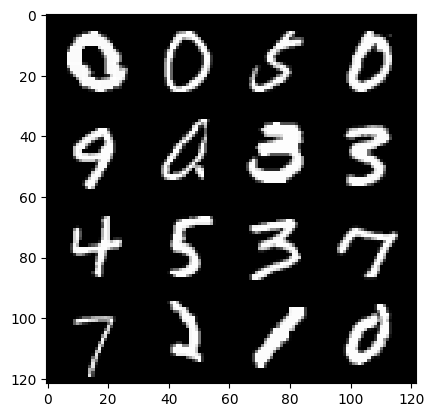

Epoch :87 , Step :46656 , Generator Loss :2.4326932606873695 , Discriminator Loss :0.21442060144963088


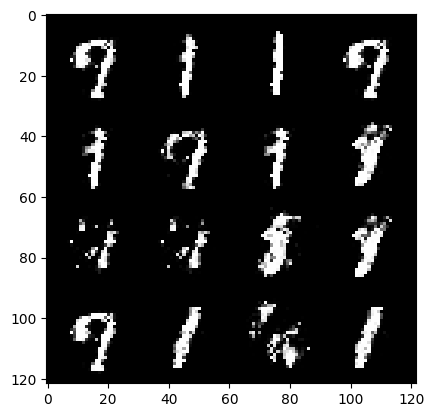

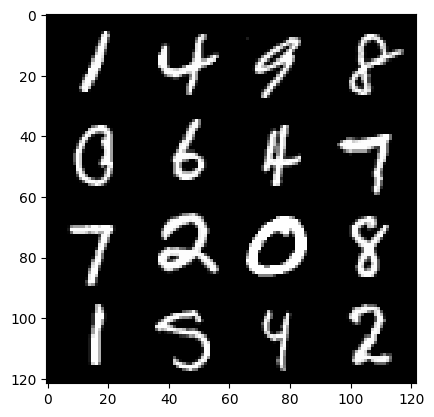

Epoch :87 , Step :46764 , Generator Loss :2.6584716726232456 , Discriminator Loss :0.19180356793933448


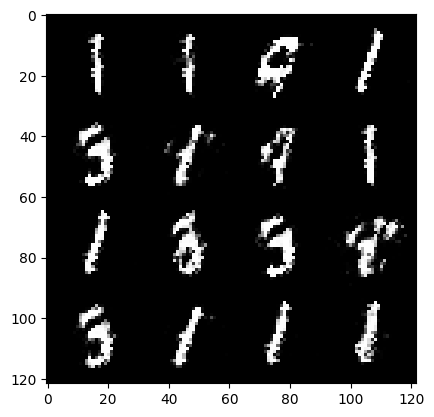

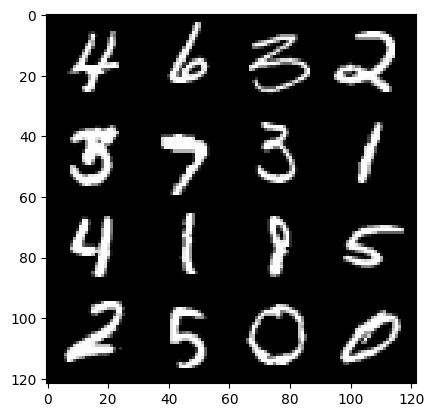

Epoch :87 , Step :46872 , Generator Loss :2.6485306002475597 , Discriminator Loss :0.21306333194176355


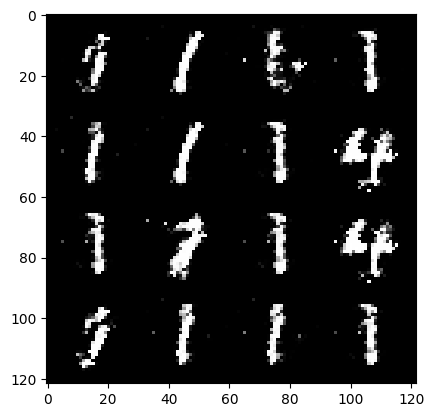

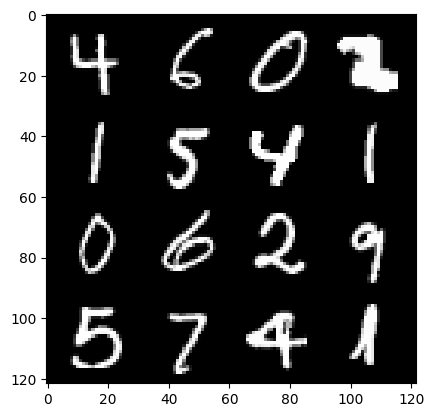

Epoch :87 , Step :46980 , Generator Loss :2.3551437545705722 , Discriminator Loss :0.22097239008656258


  0%|          | 0/469 [00:00<?, ?it/s]

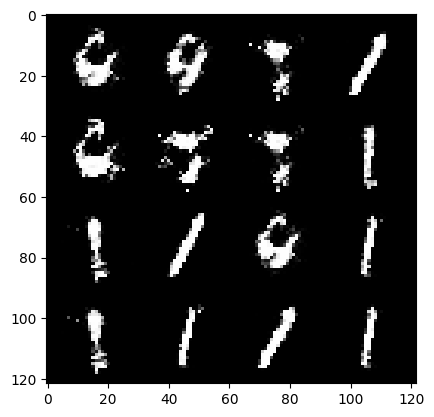

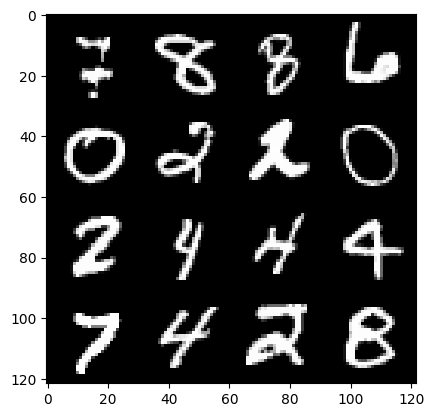

Epoch :88 , Step :47088 , Generator Loss :2.476978176169925 , Discriminator Loss :0.2156063063001191


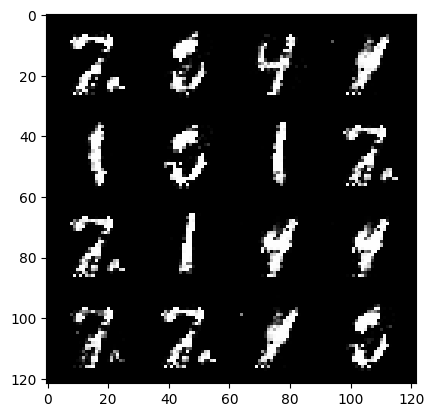

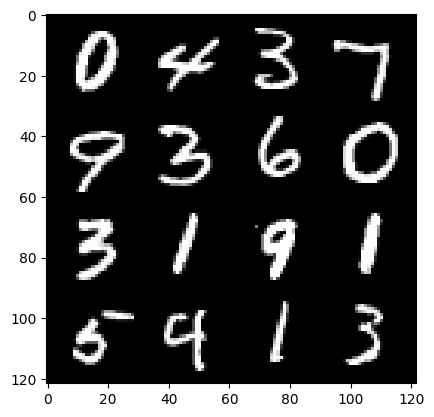

Epoch :88 , Step :47196 , Generator Loss :2.379665474096934 , Discriminator Loss :0.1926673369965067


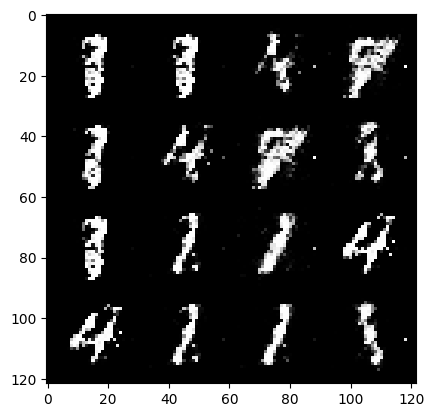

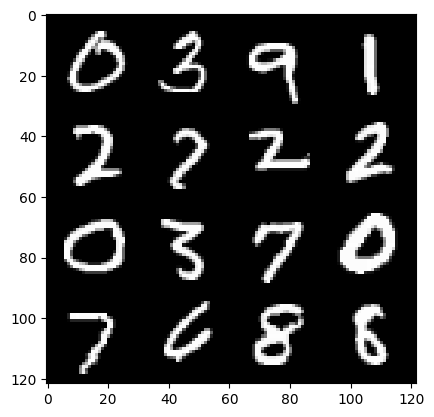

Epoch :88 , Step :47304 , Generator Loss :2.748240179485746 , Discriminator Loss :0.1858706034168049


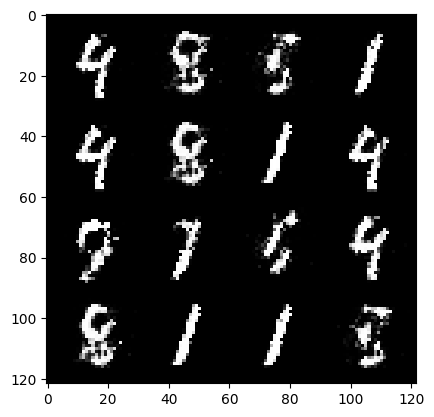

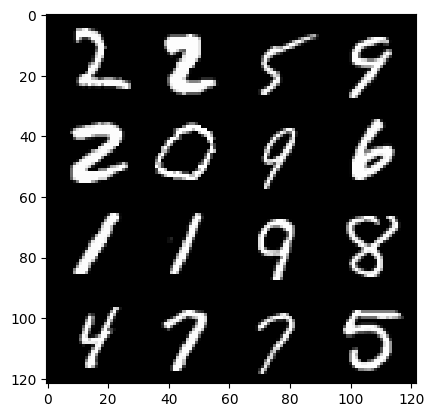

Epoch :88 , Step :47412 , Generator Loss :2.6605303927704136 , Discriminator Loss :0.19154514537917242


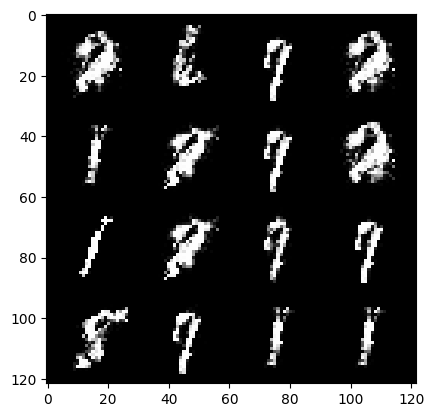

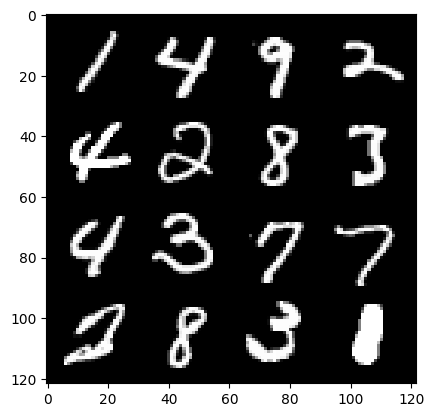

Epoch :88 , Step :47520 , Generator Loss :2.4434604534396427 , Discriminator Loss :0.2292572945632316


  0%|          | 0/469 [00:00<?, ?it/s]

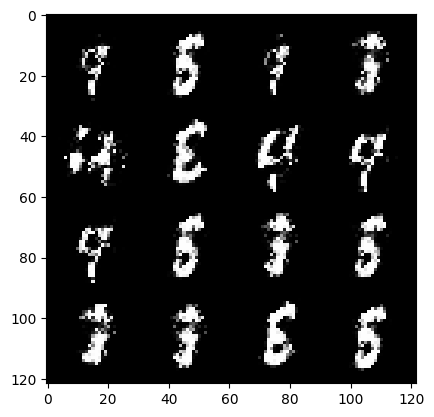

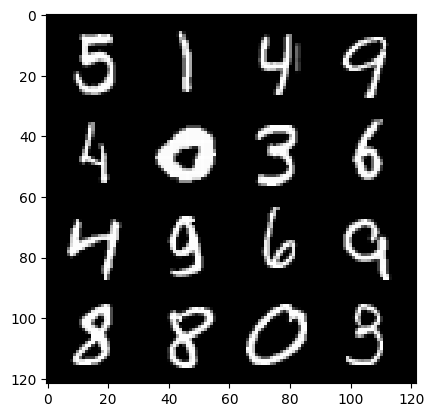

Epoch :89 , Step :47628 , Generator Loss :2.5286837816238394 , Discriminator Loss :0.20088826161291876


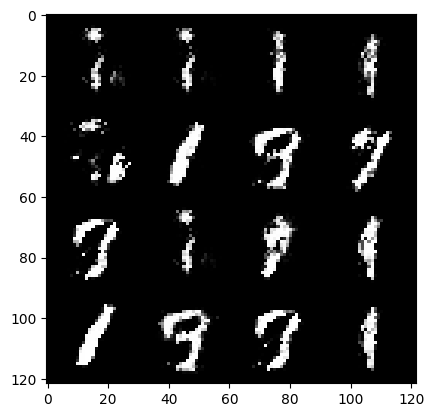

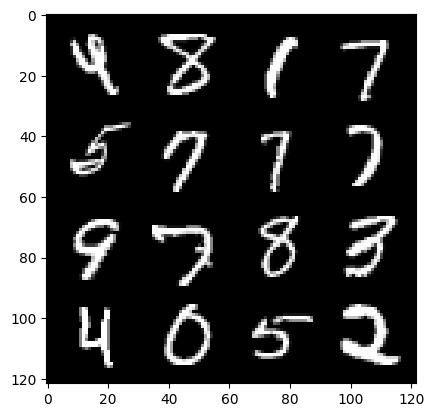

Epoch :89 , Step :47736 , Generator Loss :2.4856885384630267 , Discriminator Loss :0.24516707741551927


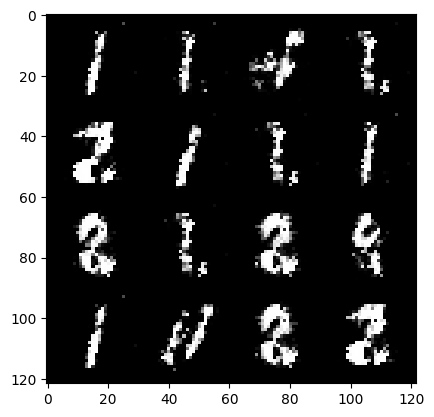

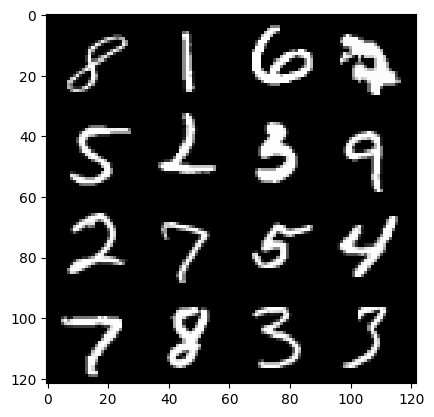

Epoch :89 , Step :47844 , Generator Loss :2.120676833170431 , Discriminator Loss :0.23709952086210254


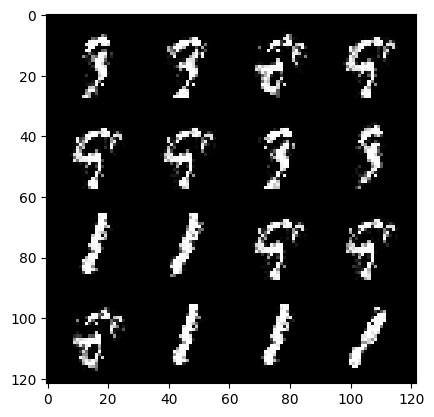

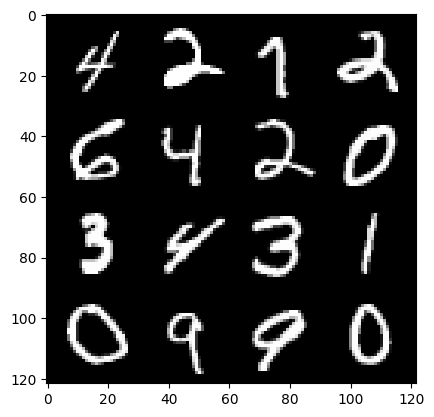

Epoch :89 , Step :47952 , Generator Loss :2.3828365681348034 , Discriminator Loss :0.2553917030217471


  0%|          | 0/469 [00:00<?, ?it/s]

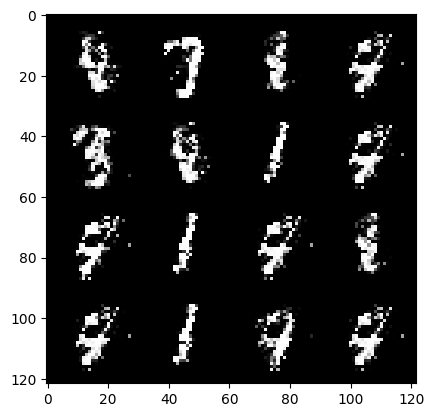

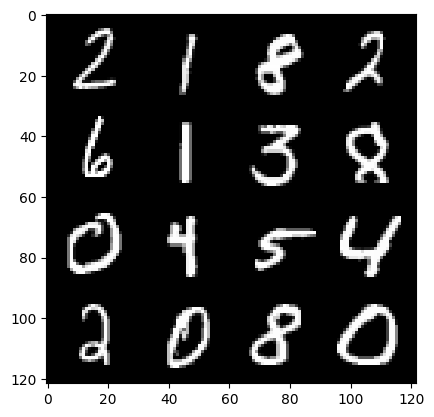

Epoch :90 , Step :48060 , Generator Loss :2.1143334143691592 , Discriminator Loss :0.24952799744076196


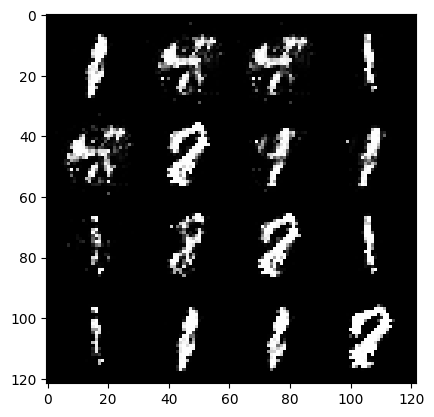

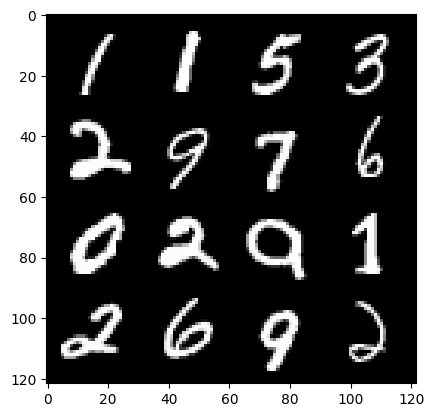

Epoch :90 , Step :48168 , Generator Loss :2.6212900457558814 , Discriminator Loss :0.18887314310780284


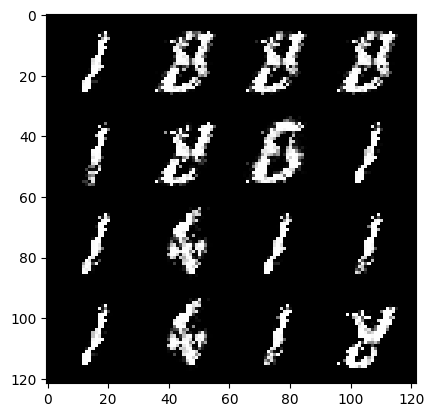

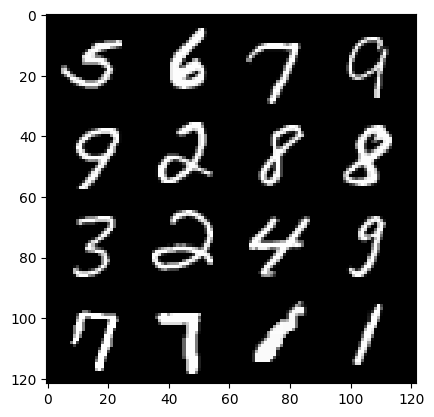

Epoch :90 , Step :48276 , Generator Loss :3.0071424025076414 , Discriminator Loss :0.20257015519396024


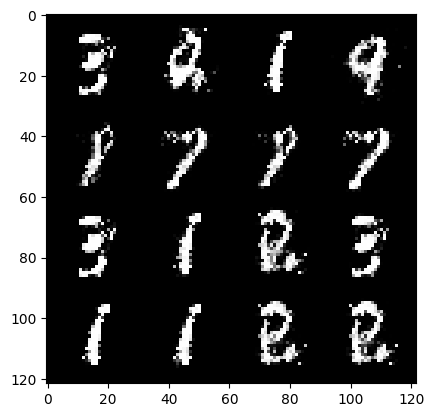

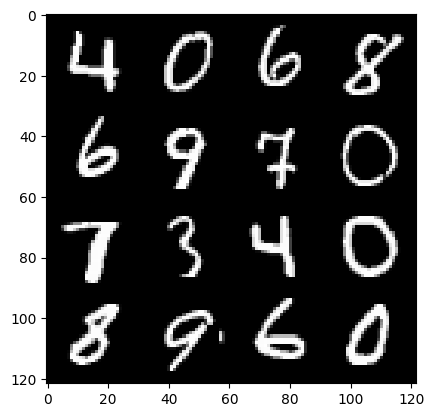

Epoch :90 , Step :48384 , Generator Loss :2.7718811851960634 , Discriminator Loss :0.1859283276178219


  0%|          | 0/469 [00:00<?, ?it/s]

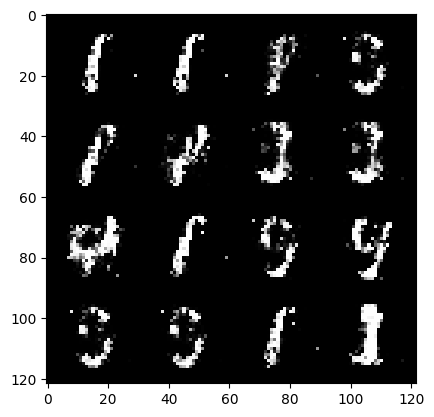

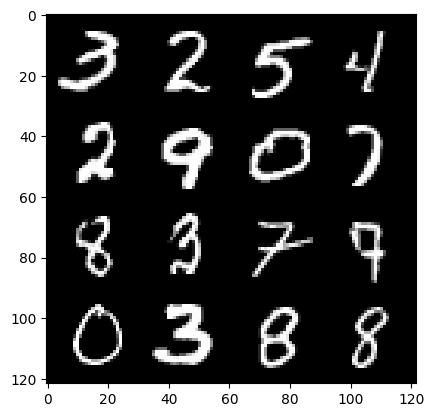

Epoch :91 , Step :48492 , Generator Loss :2.707268944493046 , Discriminator Loss :0.15043721906840798


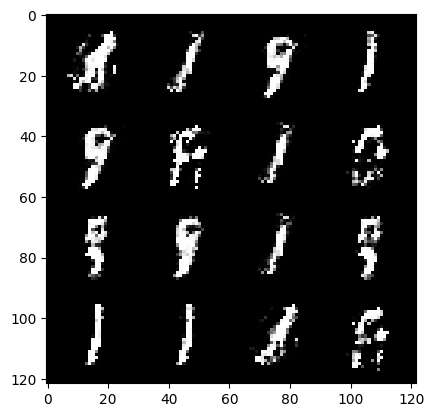

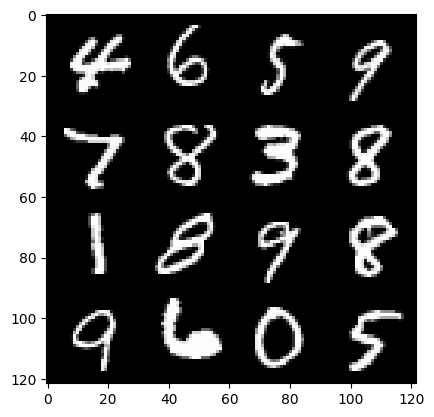

Epoch :91 , Step :48600 , Generator Loss :2.9153911250608937 , Discriminator Loss :0.1501320778495736


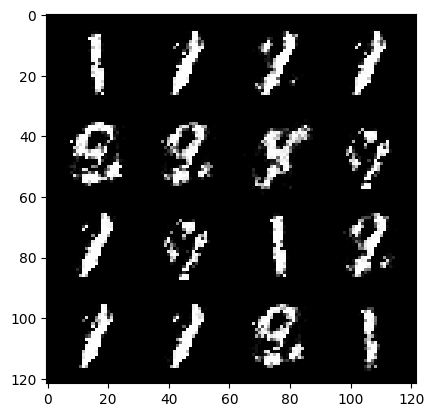

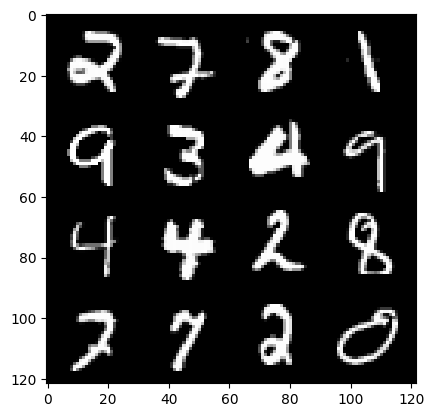

Epoch :91 , Step :48708 , Generator Loss :2.966837750540839 , Discriminator Loss :0.17947683848992538


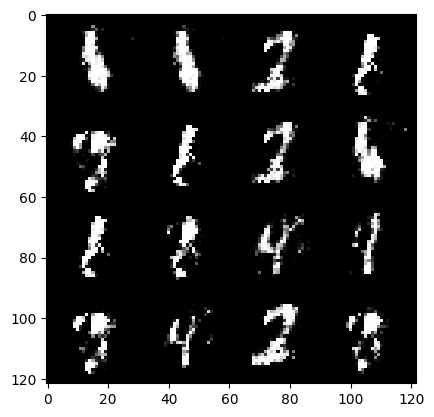

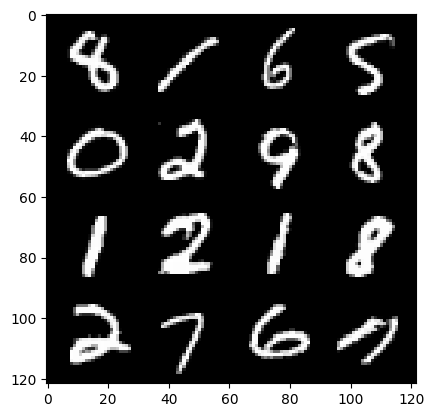

Epoch :91 , Step :48816 , Generator Loss :2.6612742300386785 , Discriminator Loss :0.1683569137972815


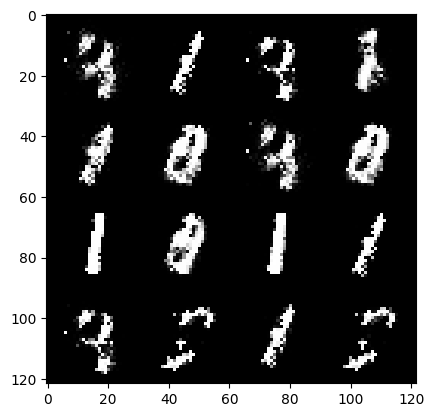

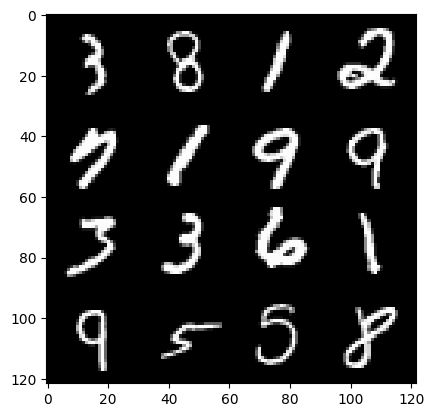

Epoch :91 , Step :48924 , Generator Loss :2.951658165013348 , Discriminator Loss :0.20691431886344044


  0%|          | 0/469 [00:00<?, ?it/s]

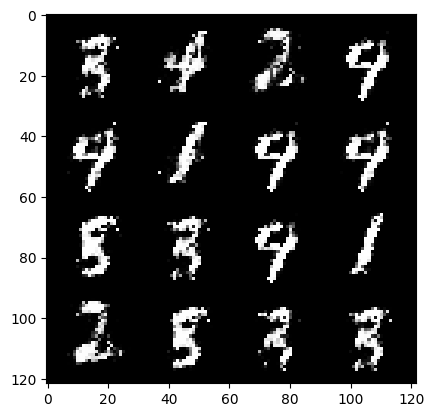

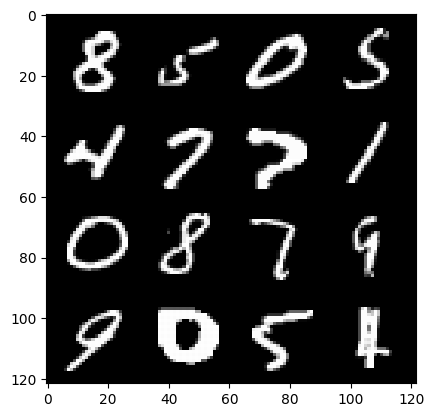

Epoch :92 , Step :49032 , Generator Loss :2.63932557017715 , Discriminator Loss :0.17015704726455394


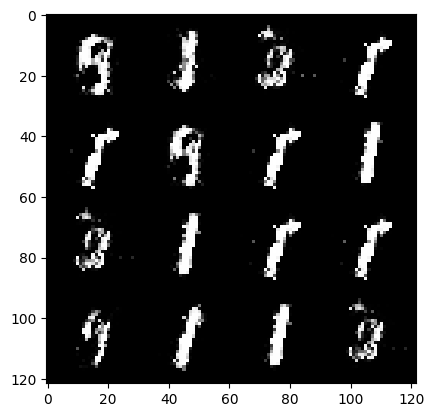

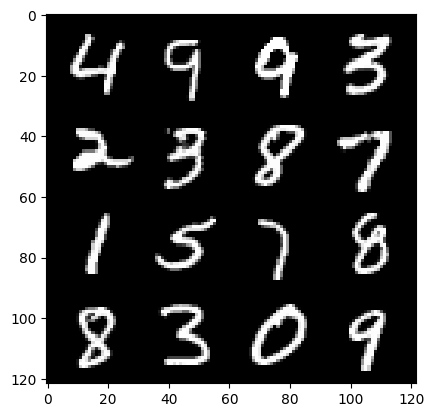

Epoch :92 , Step :49140 , Generator Loss :2.832185919638033 , Discriminator Loss :0.1526368530812088


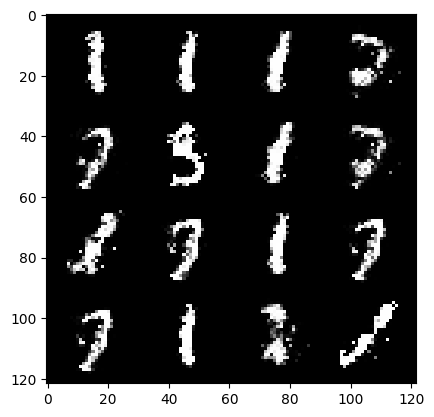

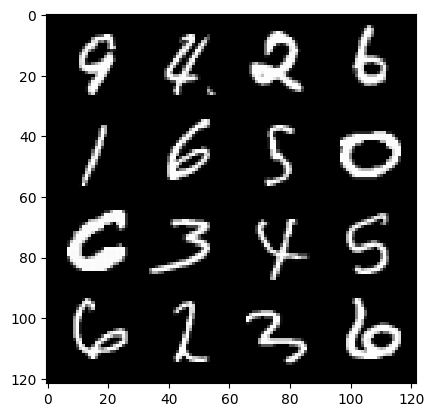

Epoch :92 , Step :49248 , Generator Loss :3.110550004023094 , Discriminator Loss :0.1269123780506629


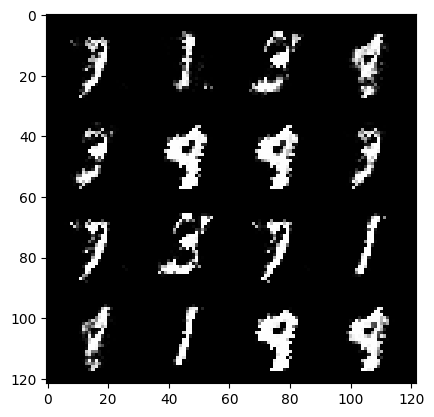

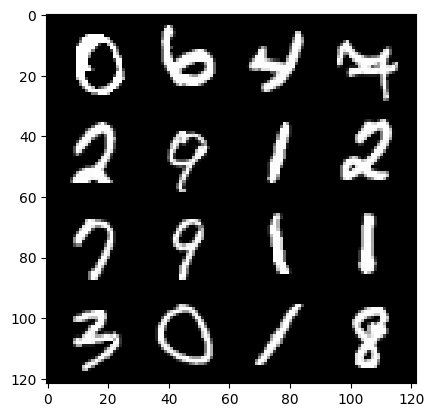

Epoch :92 , Step :49356 , Generator Loss :3.0945054888725276 , Discriminator Loss :0.19654922014861187


  0%|          | 0/469 [00:00<?, ?it/s]

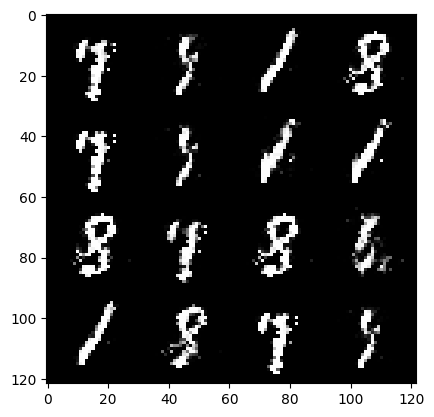

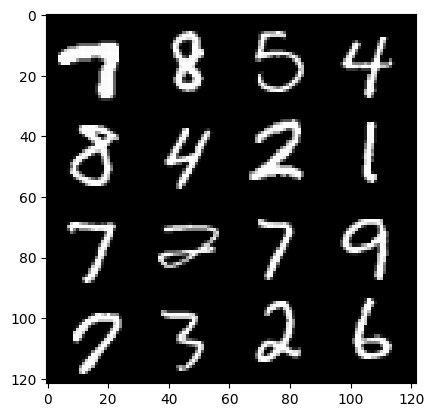

Epoch :93 , Step :49464 , Generator Loss :2.907459376034912 , Discriminator Loss :0.1737968972711651


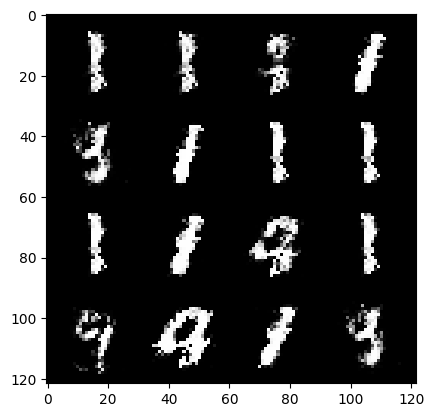

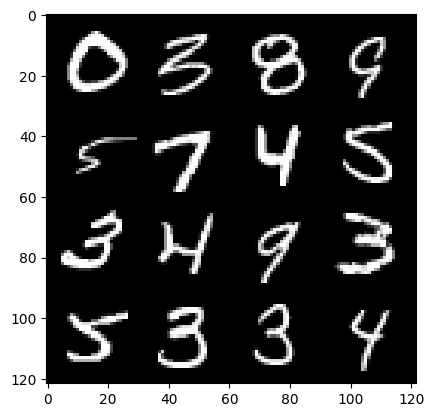

Epoch :93 , Step :49572 , Generator Loss :2.943729193122298 , Discriminator Loss :0.1983903340167469


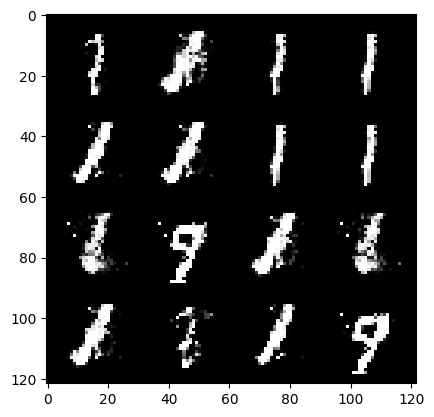

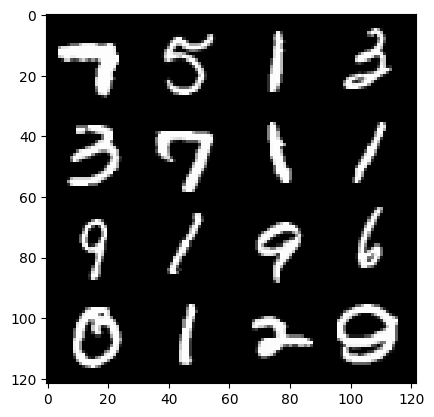

Epoch :93 , Step :49680 , Generator Loss :2.491180943118201 , Discriminator Loss :0.20627222603393924


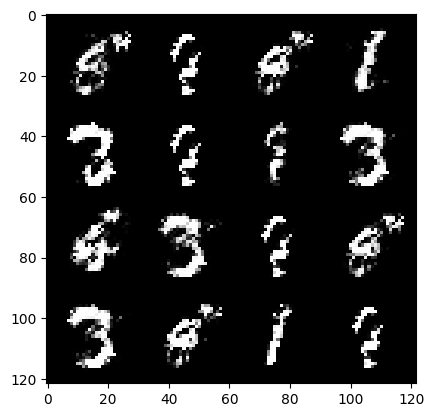

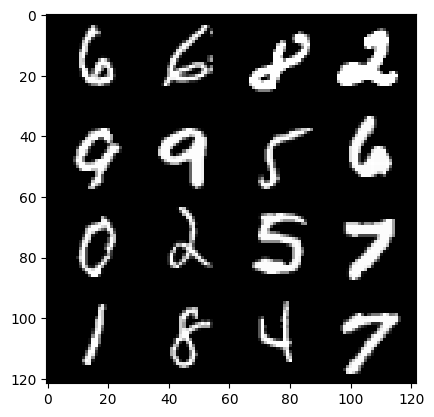

Epoch :93 , Step :49788 , Generator Loss :2.8353814372309913 , Discriminator Loss :0.18428810534101936


  0%|          | 0/469 [00:00<?, ?it/s]

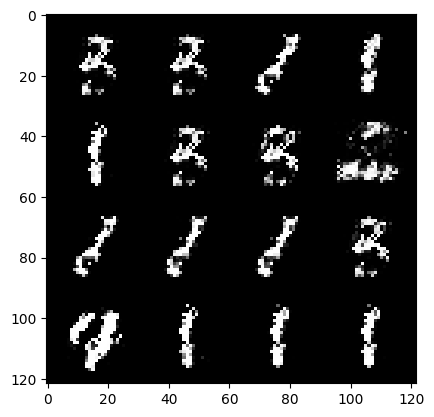

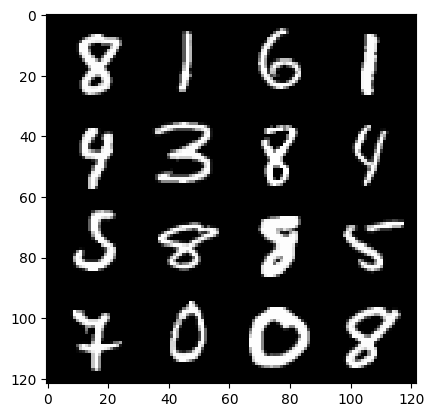

Epoch :94 , Step :49896 , Generator Loss :2.765502600758165 , Discriminator Loss :0.16184557450038417


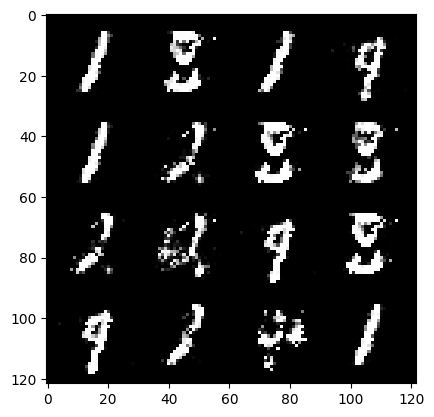

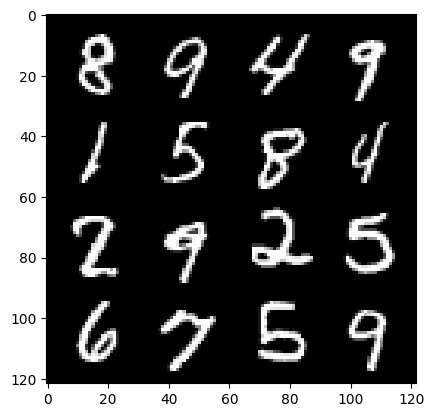

Epoch :94 , Step :50004 , Generator Loss :3.31111063780608 , Discriminator Loss :0.14502399959773926


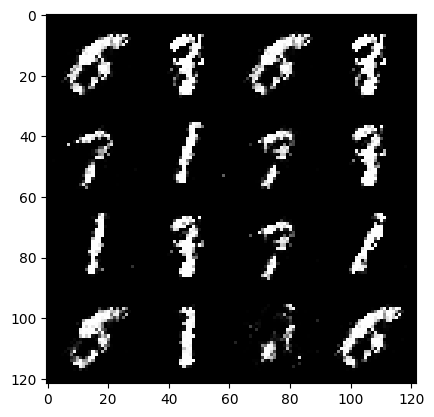

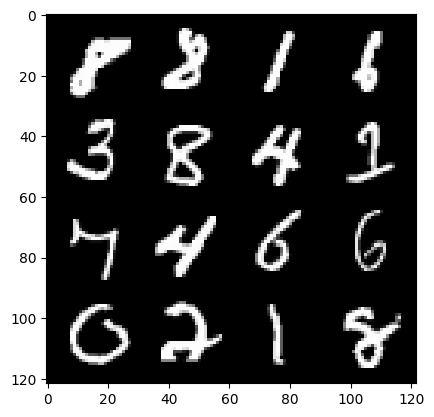

Epoch :94 , Step :50112 , Generator Loss :3.6291787800965474 , Discriminator Loss :0.14713786977032822


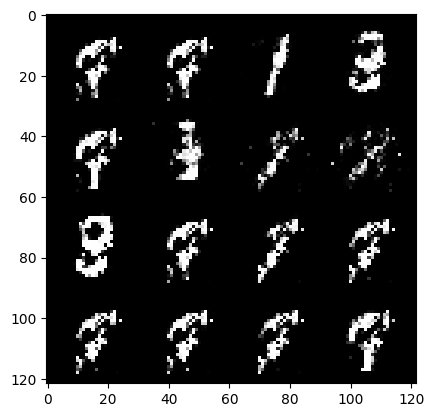

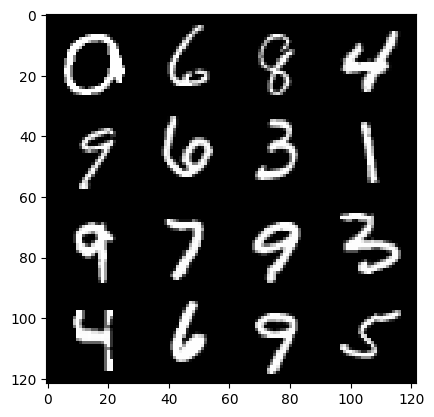

Epoch :94 , Step :50220 , Generator Loss :3.0412500677285377 , Discriminator Loss :0.1635785149065433


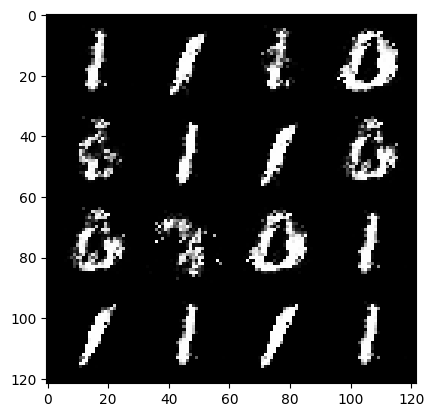

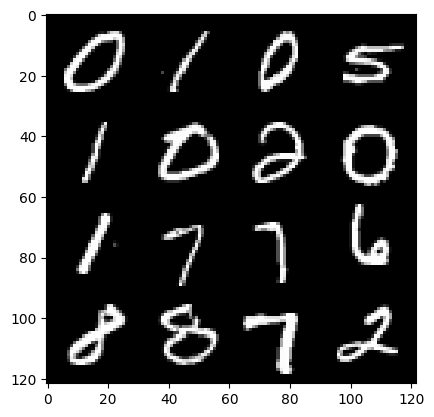

Epoch :94 , Step :50328 , Generator Loss :3.0960238046116304 , Discriminator Loss :0.17204235894260583


  0%|          | 0/469 [00:00<?, ?it/s]

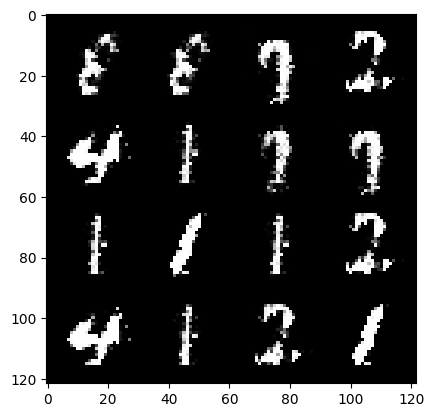

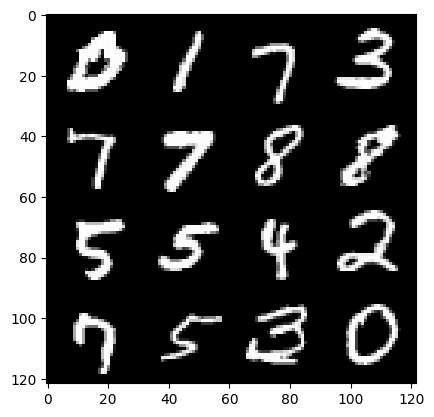

Epoch :95 , Step :50436 , Generator Loss :2.659189372150988 , Discriminator Loss :0.19870937843289646


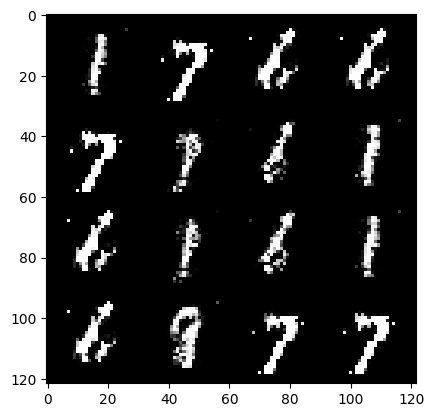

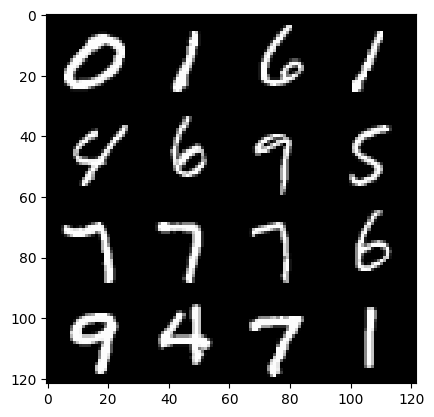

Epoch :95 , Step :50544 , Generator Loss :2.6922370570677288 , Discriminator Loss :0.1963786864308295


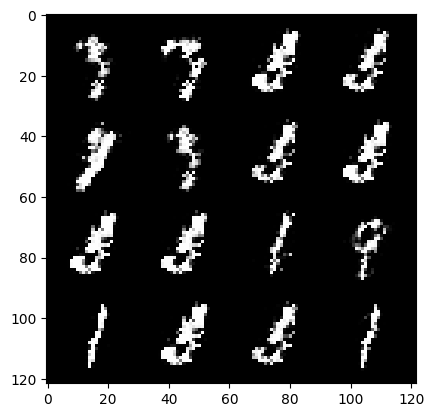

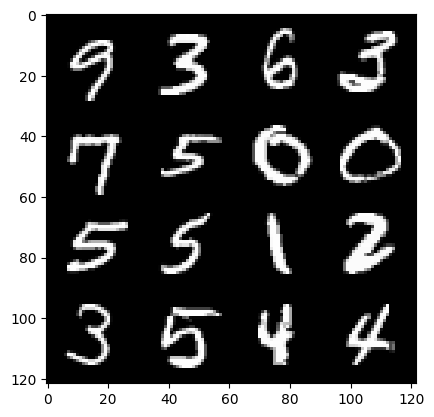

Epoch :95 , Step :50652 , Generator Loss :2.4878272745344376 , Discriminator Loss :0.18459706946655552


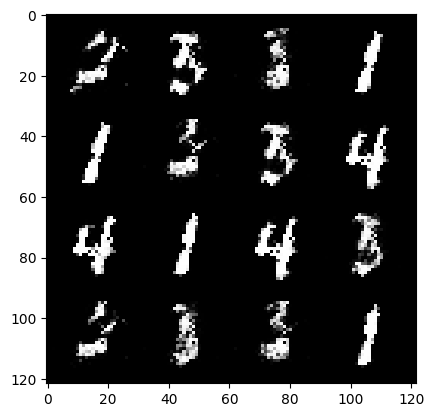

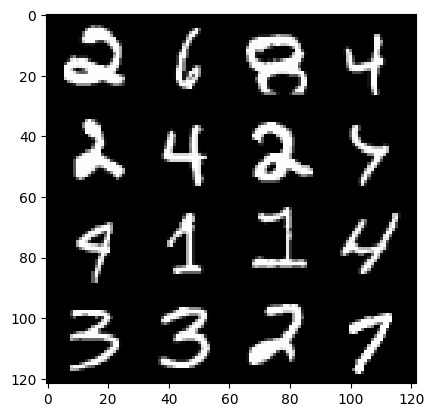

Epoch :95 , Step :50760 , Generator Loss :2.7557075354788036 , Discriminator Loss :0.19579047544134986


  0%|          | 0/469 [00:00<?, ?it/s]

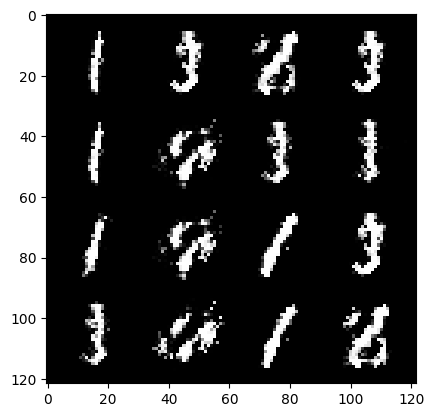

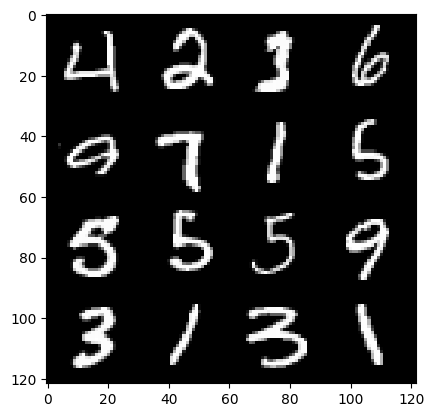

Epoch :96 , Step :50868 , Generator Loss :2.830815955444619 , Discriminator Loss :0.20936098646510531


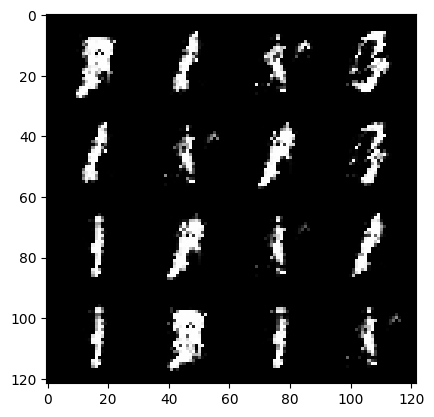

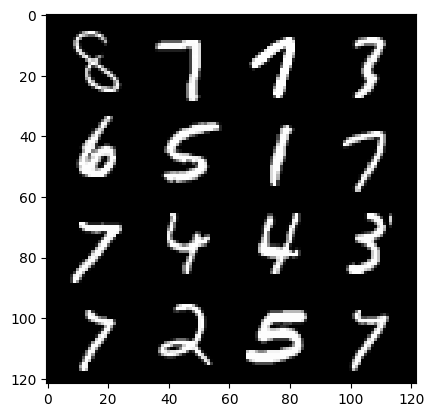

Epoch :96 , Step :50976 , Generator Loss :2.795773715884598 , Discriminator Loss :0.17090077580953095


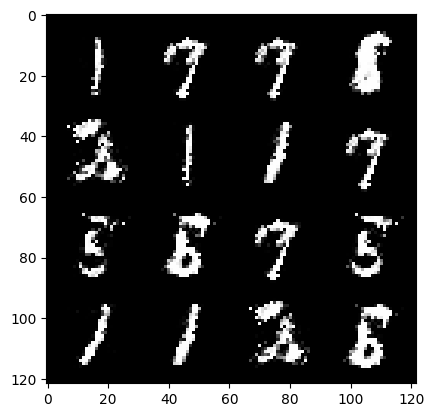

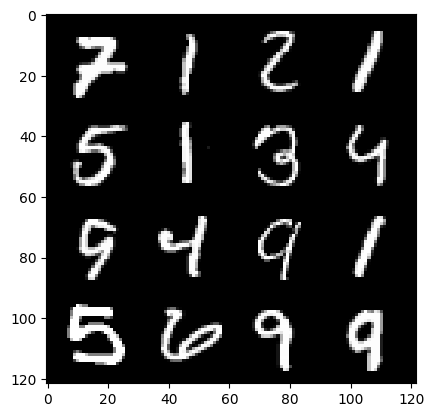

Epoch :96 , Step :51084 , Generator Loss :2.8314501312043934 , Discriminator Loss :0.18655509232646886


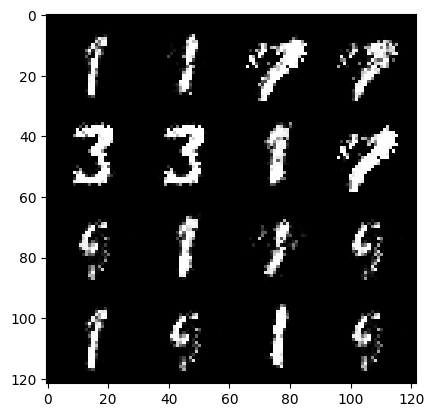

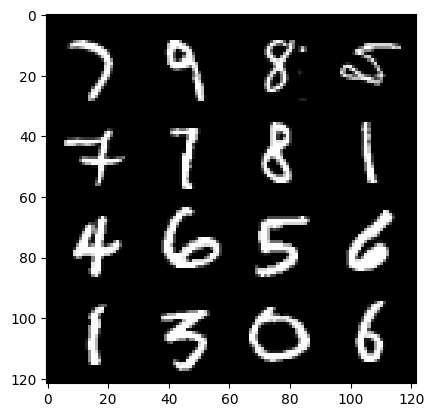

Epoch :96 , Step :51192 , Generator Loss :2.631661902975155 , Discriminator Loss :0.21486838506879616


  0%|          | 0/469 [00:00<?, ?it/s]

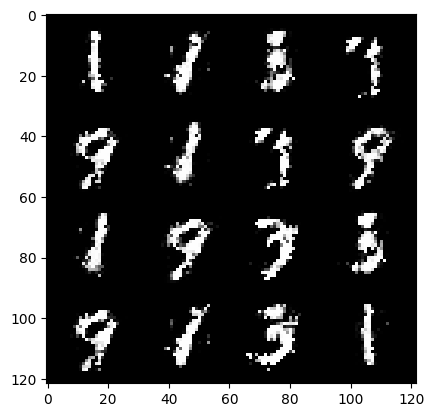

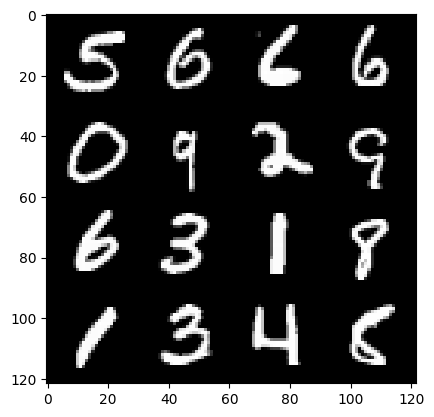

Epoch :97 , Step :51300 , Generator Loss :2.83227715448097 , Discriminator Loss :0.19694430732892612


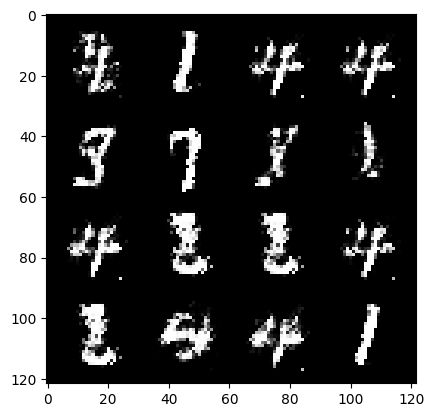

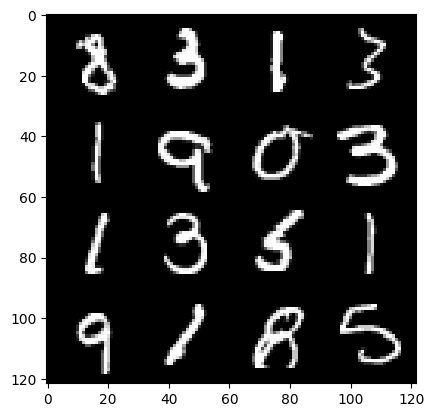

Epoch :97 , Step :51408 , Generator Loss :2.693144222100576 , Discriminator Loss :0.19469081410379313


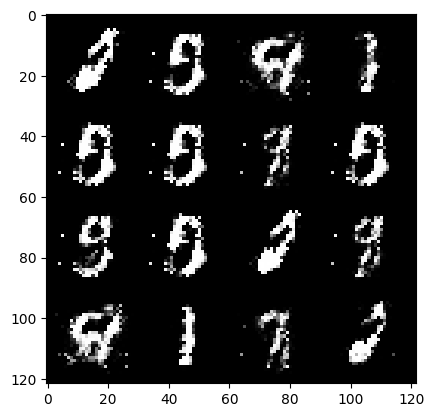

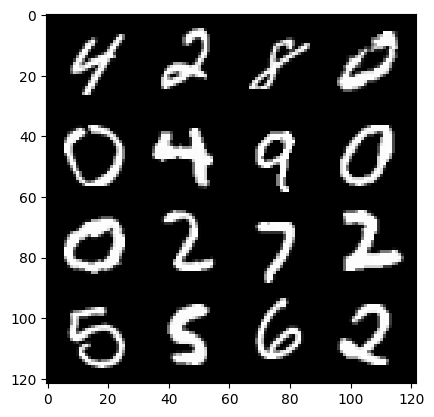

Epoch :97 , Step :51516 , Generator Loss :2.7212901247872248 , Discriminator Loss :0.21273919650250012


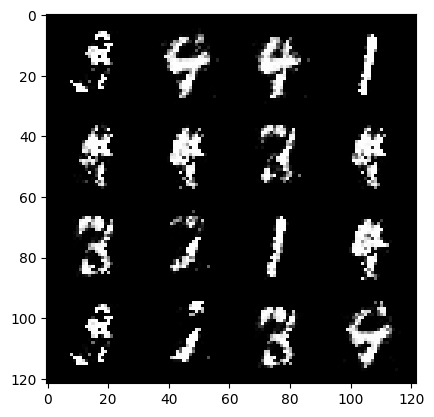

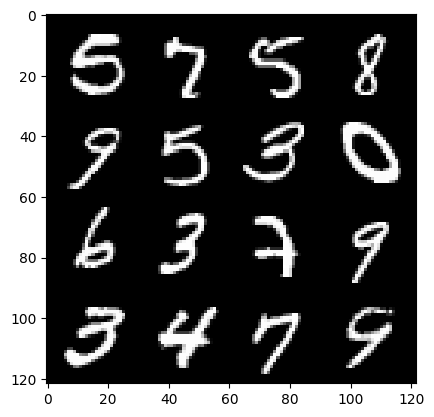

Epoch :97 , Step :51624 , Generator Loss :3.123359810422967 , Discriminator Loss :0.14636956479538368


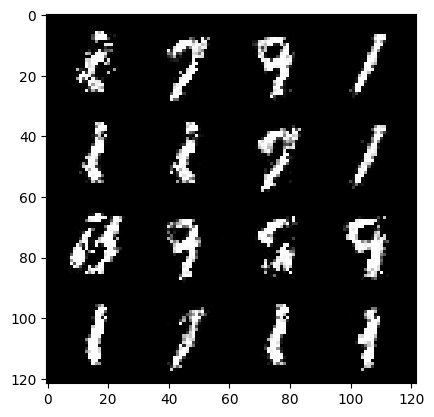

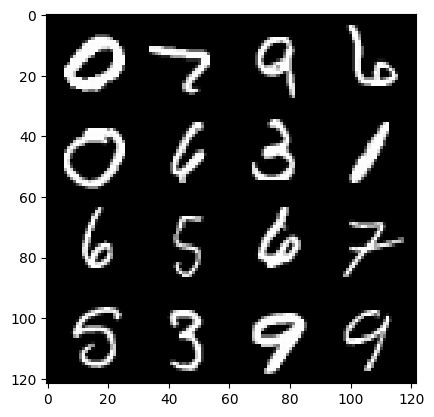

Epoch :97 , Step :51732 , Generator Loss :3.228577609415408 , Discriminator Loss :0.14339498585710922


  0%|          | 0/469 [00:00<?, ?it/s]

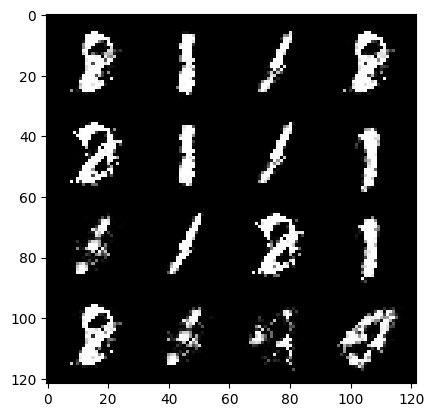

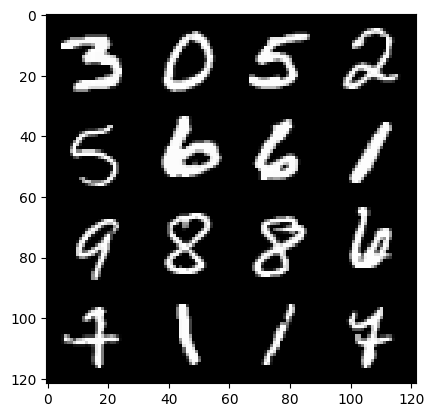

Epoch :98 , Step :51840 , Generator Loss :2.9229197391757262 , Discriminator Loss :0.20287840254604822


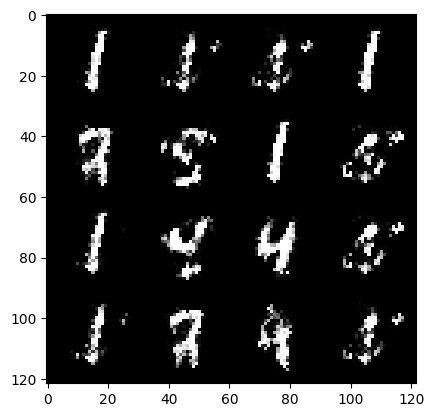

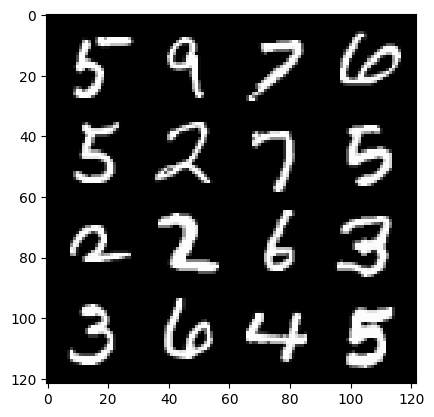

Epoch :98 , Step :51948 , Generator Loss :2.7137319555989006 , Discriminator Loss :0.16209537294451848


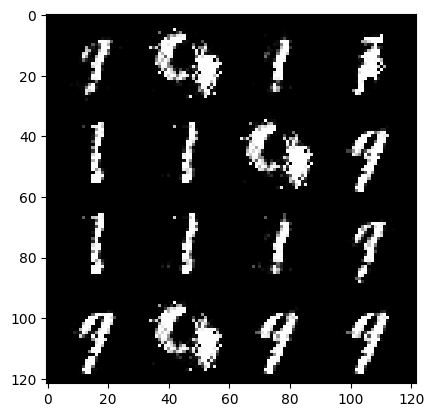

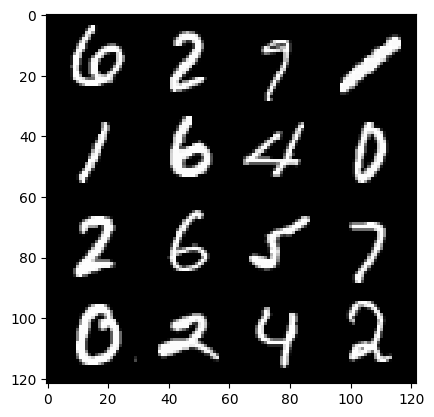

Epoch :98 , Step :52056 , Generator Loss :3.1100061425456302 , Discriminator Loss :0.18376663037472302


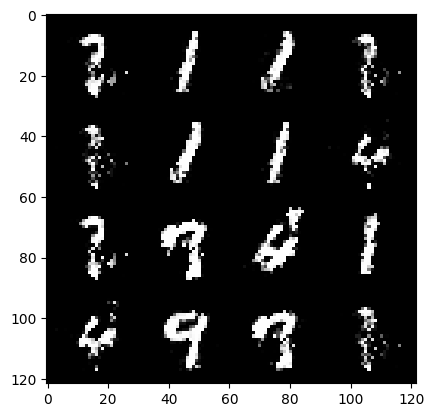

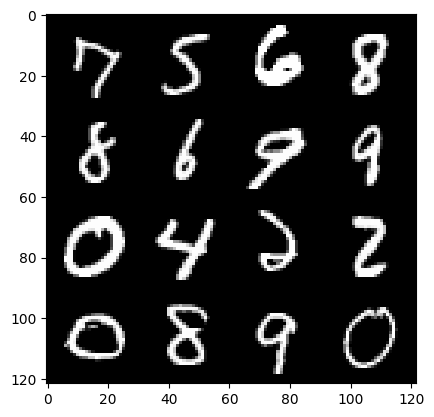

Epoch :98 , Step :52164 , Generator Loss :2.8721257072907918 , Discriminator Loss :0.2005602308307533


  0%|          | 0/469 [00:00<?, ?it/s]

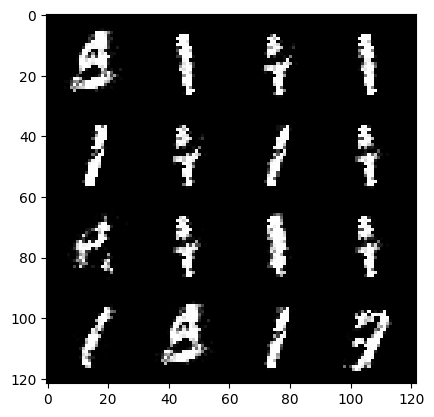

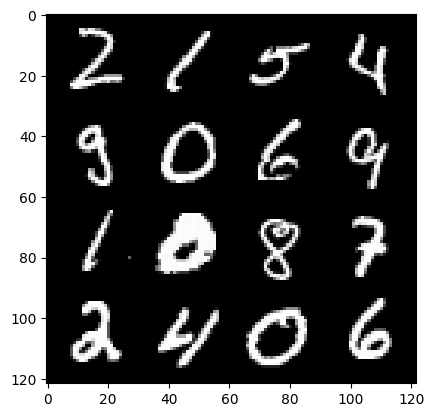

Epoch :99 , Step :52272 , Generator Loss :2.751168063393345 , Discriminator Loss :0.1742483414019698


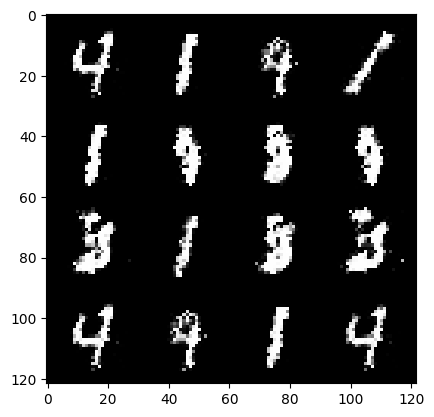

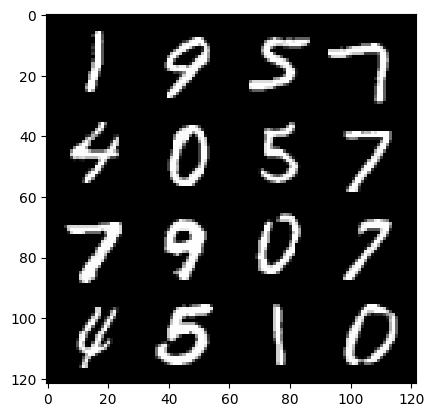

Epoch :99 , Step :52380 , Generator Loss :2.8457751229957293 , Discriminator Loss :0.15255560491372036


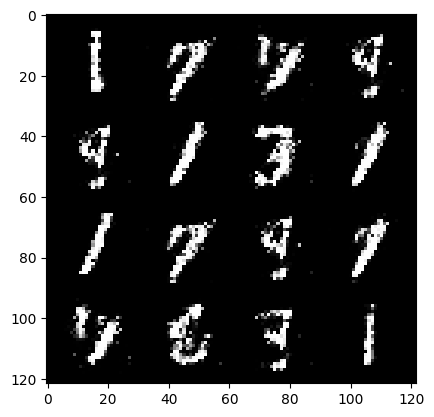

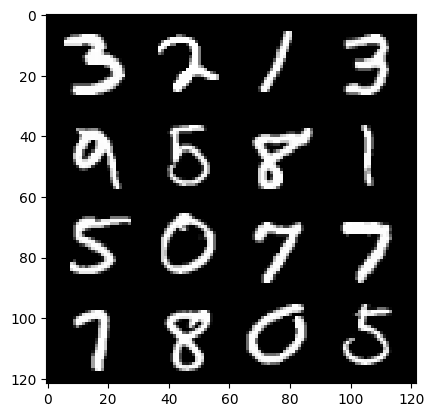

Epoch :99 , Step :52488 , Generator Loss :2.7547965336728986 , Discriminator Loss :0.22937247308867945


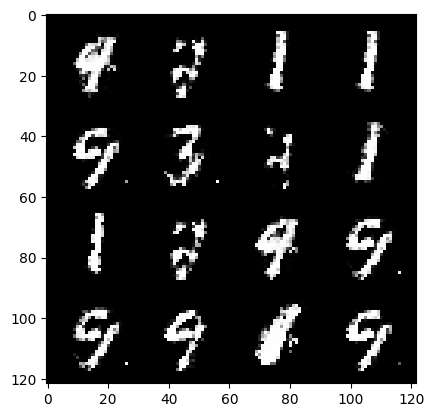

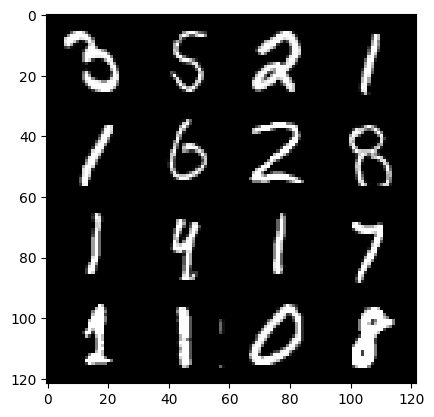

Epoch :99 , Step :52596 , Generator Loss :2.2218861359137083 , Discriminator Loss :0.24017151183000318


  0%|          | 0/469 [00:00<?, ?it/s]

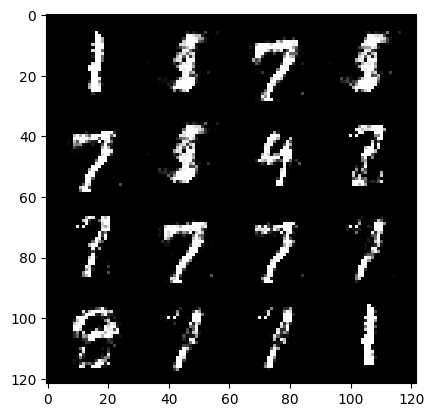

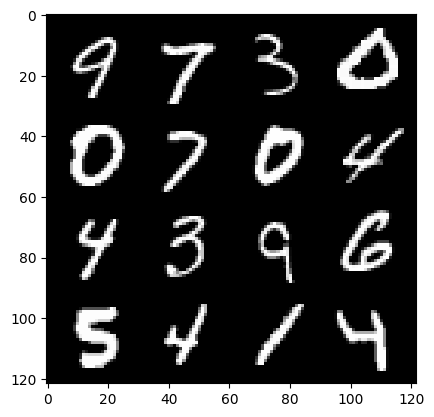

Epoch :100 , Step :52704 , Generator Loss :2.4625975688298554 , Discriminator Loss :0.1957502382359019


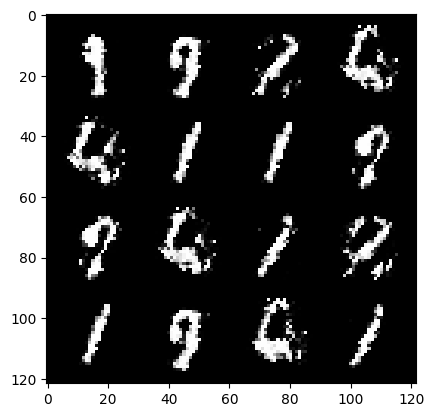

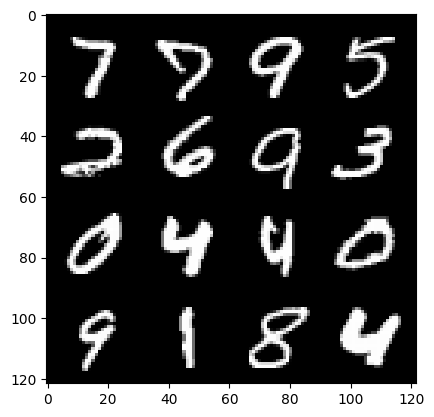

Epoch :100 , Step :52812 , Generator Loss :2.5670818708561094 , Discriminator Loss :0.24989828343192733


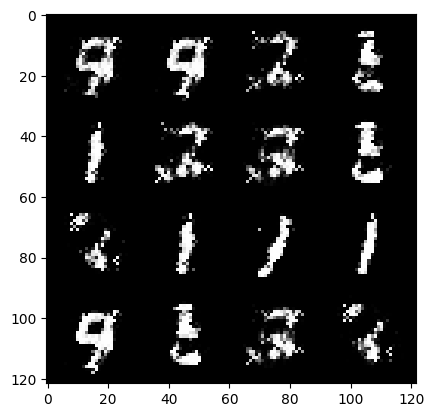

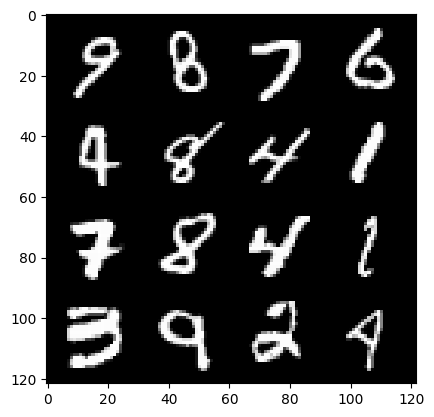

Epoch :100 , Step :52920 , Generator Loss :2.3379151313393205 , Discriminator Loss :0.23318331812818852


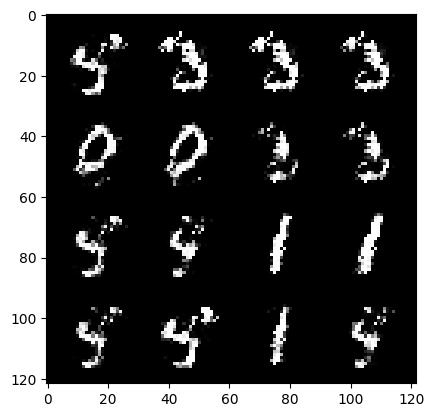

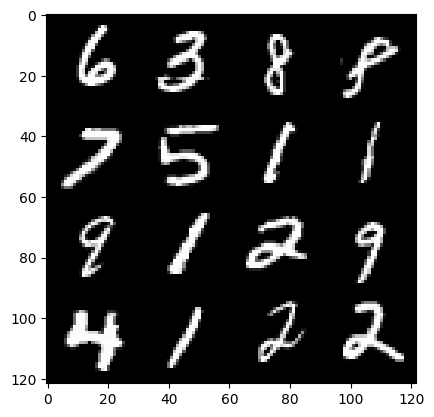

Epoch :100 , Step :53028 , Generator Loss :2.6740996219493725 , Discriminator Loss :0.16546189840193137


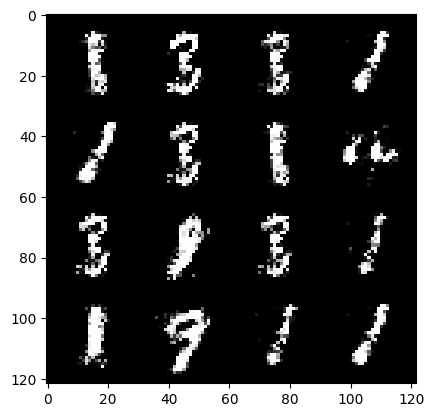

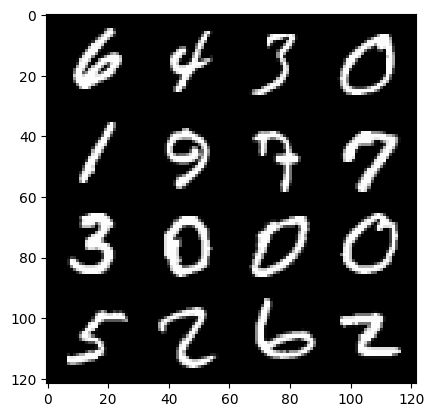

Epoch :100 , Step :53136 , Generator Loss :2.9588722454177017 , Discriminator Loss :0.1668149971713622


  0%|          | 0/469 [00:00<?, ?it/s]

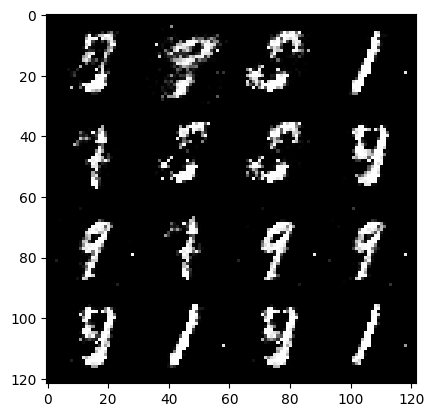

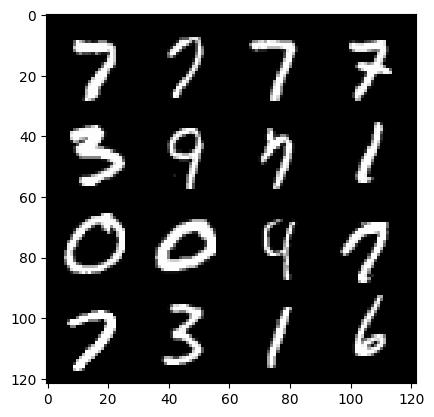

Epoch :101 , Step :53244 , Generator Loss :2.8225388813901837 , Discriminator Loss :0.21796232799964926


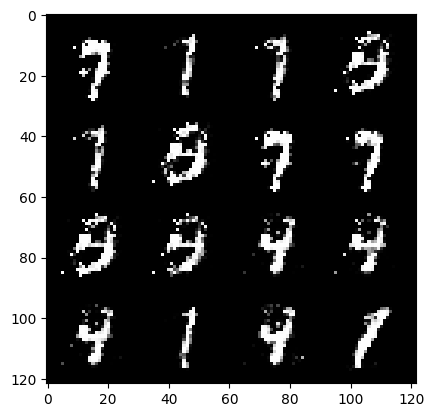

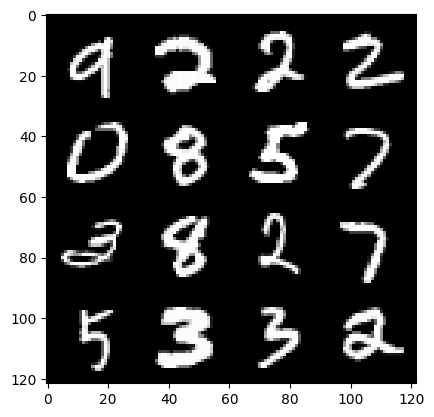

Epoch :101 , Step :53352 , Generator Loss :2.4813316839712645 , Discriminator Loss :0.19926644378790143


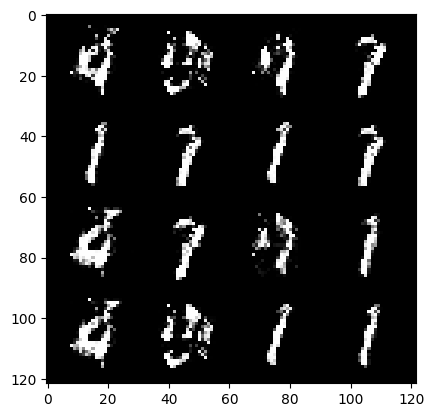

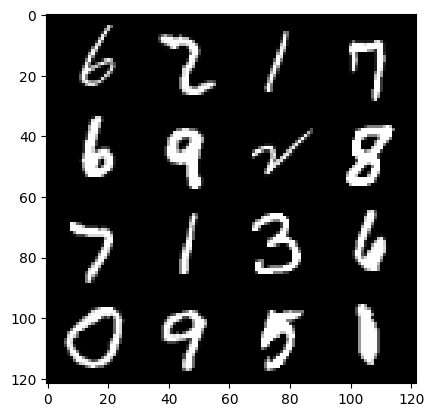

Epoch :101 , Step :53460 , Generator Loss :2.6298273161605548 , Discriminator Loss :0.17662152592782623


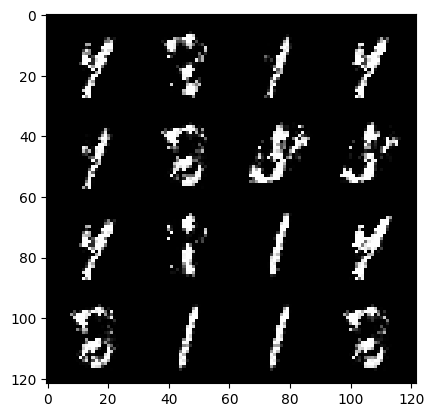

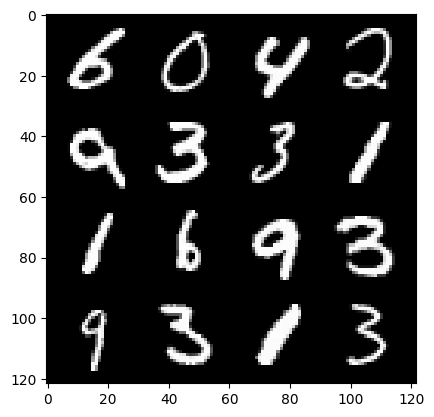

Epoch :101 , Step :53568 , Generator Loss :2.7448814334692773 , Discriminator Loss :0.18853754370852746


  0%|          | 0/469 [00:00<?, ?it/s]

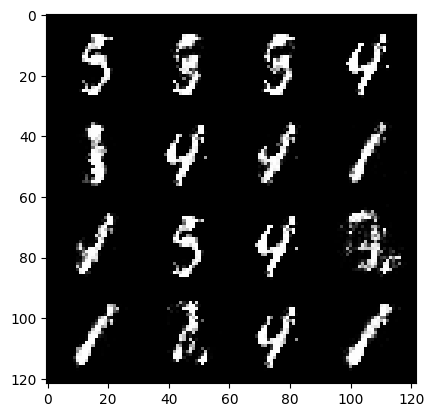

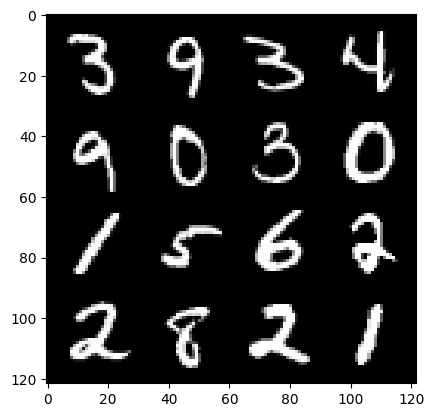

Epoch :102 , Step :53676 , Generator Loss :2.589094439038525 , Discriminator Loss :0.24144864178918024


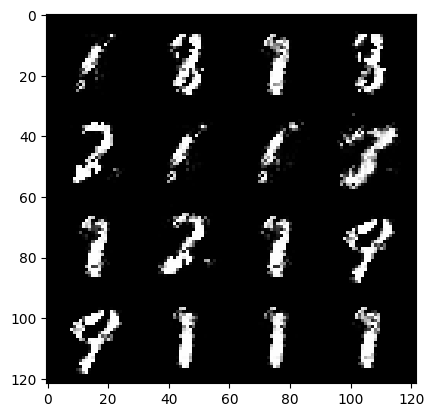

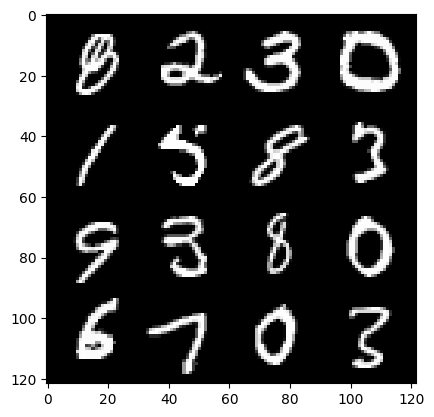

Epoch :102 , Step :53784 , Generator Loss :2.203716038553803 , Discriminator Loss :0.20776808848259623


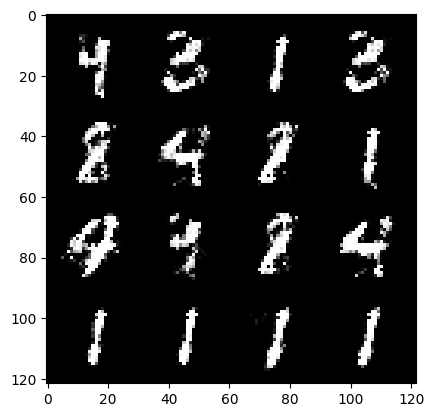

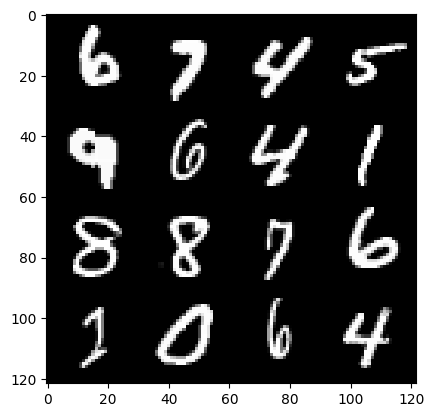

Epoch :102 , Step :53892 , Generator Loss :2.5707325780833203 , Discriminator Loss :0.25222755154525794


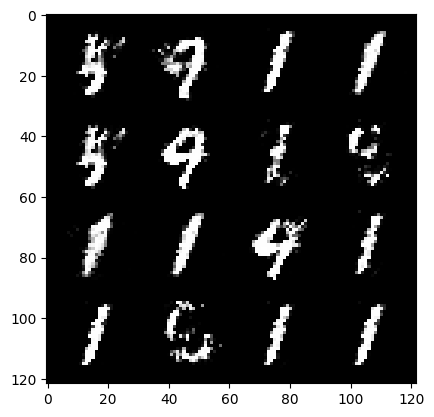

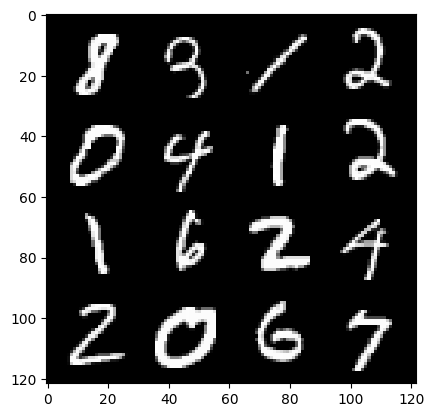

Epoch :102 , Step :54000 , Generator Loss :2.3950129890883414 , Discriminator Loss :0.23996364311487595


  0%|          | 0/469 [00:00<?, ?it/s]

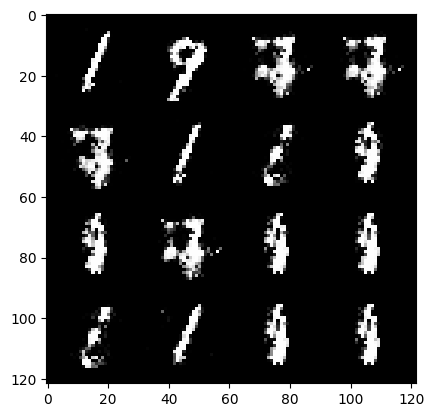

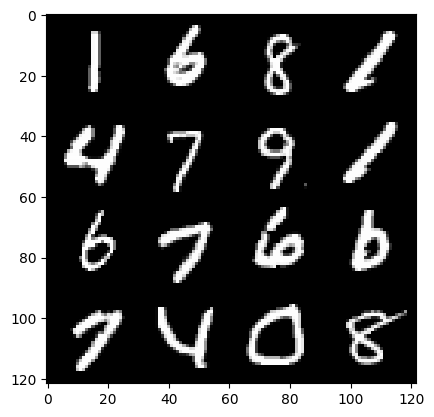

Epoch :103 , Step :54108 , Generator Loss :2.691696685773355 , Discriminator Loss :0.21078815097334205


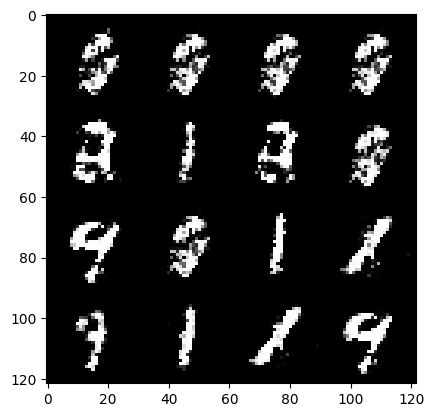

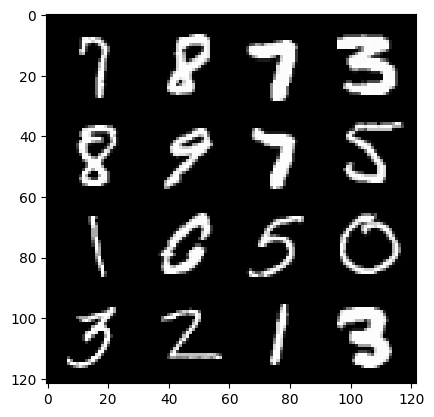

Epoch :103 , Step :54216 , Generator Loss :2.6923647500850545 , Discriminator Loss :0.2134011913504864


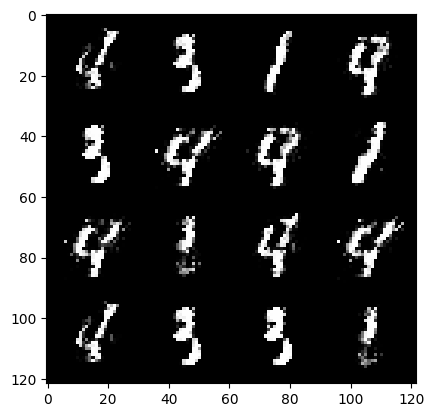

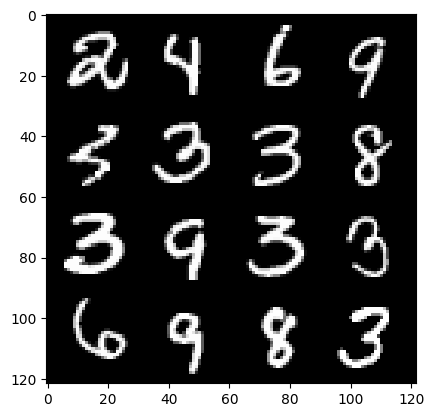

Epoch :103 , Step :54324 , Generator Loss :2.2573471323207586 , Discriminator Loss :0.24916357616031615


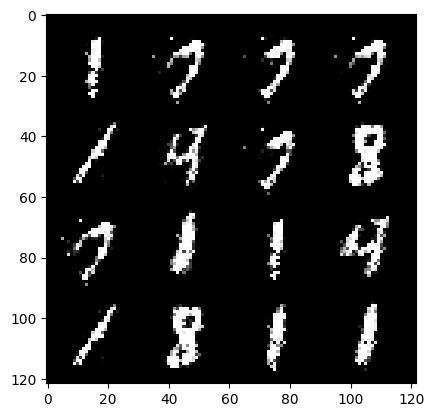

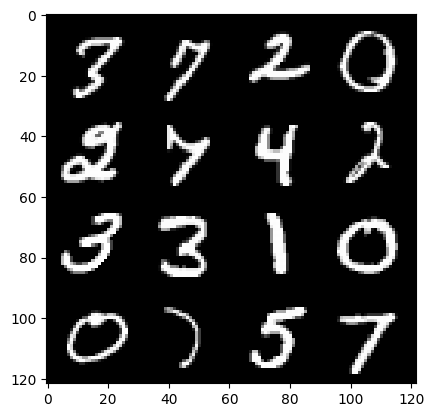

Epoch :103 , Step :54432 , Generator Loss :2.434176921844483 , Discriminator Loss :0.19858861507640946


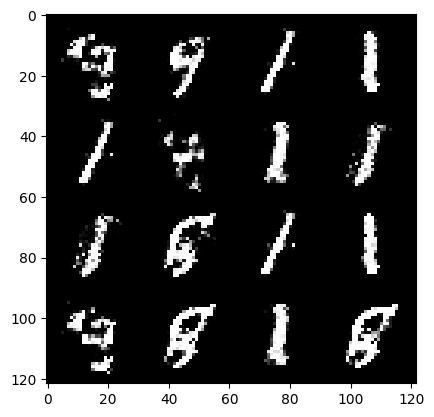

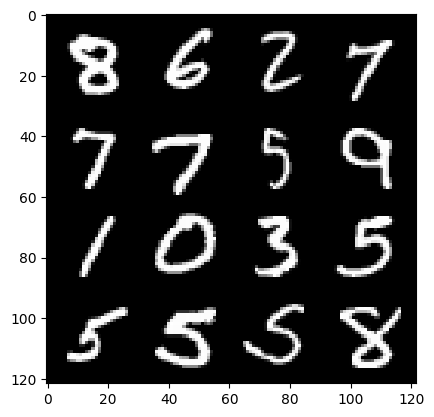

Epoch :103 , Step :54540 , Generator Loss :2.6465264095200434 , Discriminator Loss :0.20705182643400286


  0%|          | 0/469 [00:00<?, ?it/s]

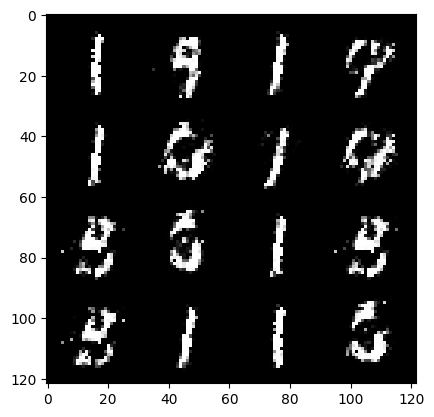

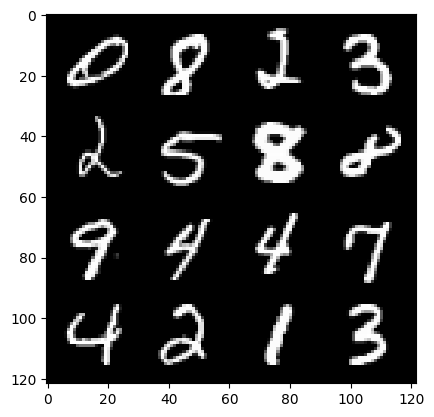

Epoch :104 , Step :54648 , Generator Loss :2.3153207235866127 , Discriminator Loss :0.2274976785260218


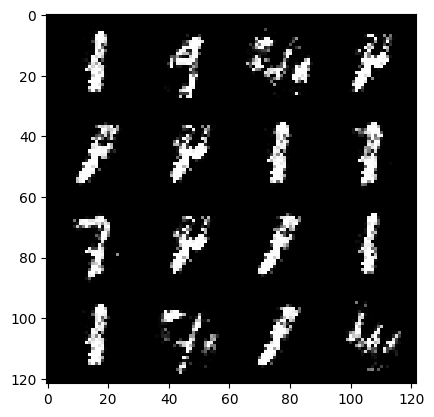

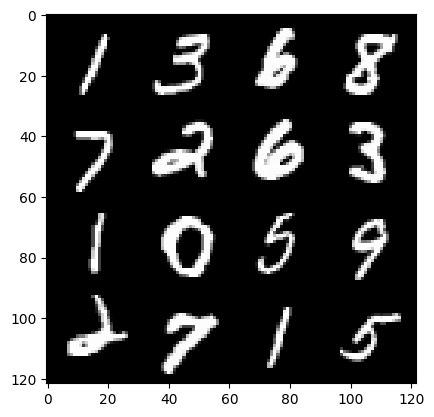

Epoch :104 , Step :54756 , Generator Loss :2.4720436091776246 , Discriminator Loss :0.19563090304533634


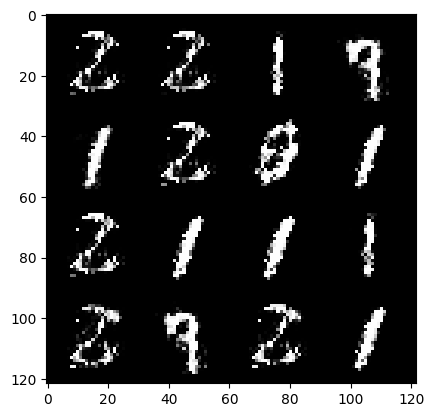

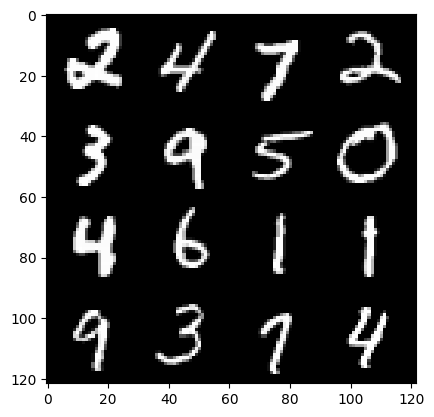

Epoch :104 , Step :54864 , Generator Loss :2.614081033953914 , Discriminator Loss :0.20193548341868112


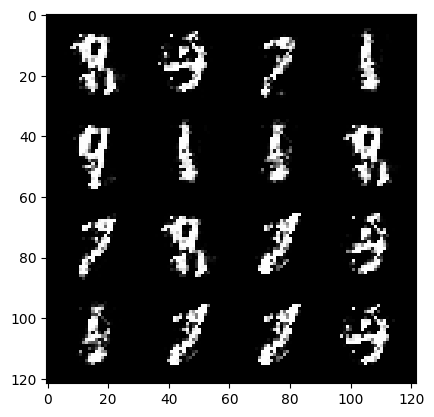

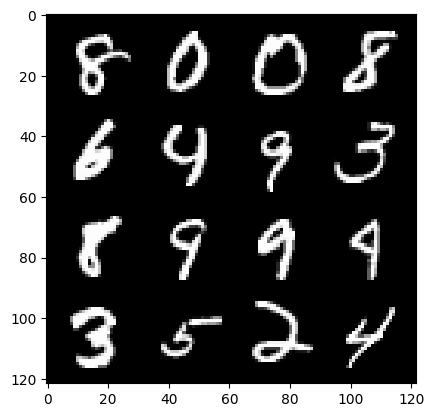

Epoch :104 , Step :54972 , Generator Loss :2.730387185458784 , Discriminator Loss :0.19420409995924542


  0%|          | 0/469 [00:00<?, ?it/s]

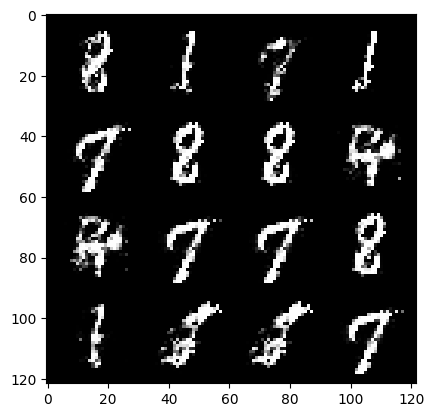

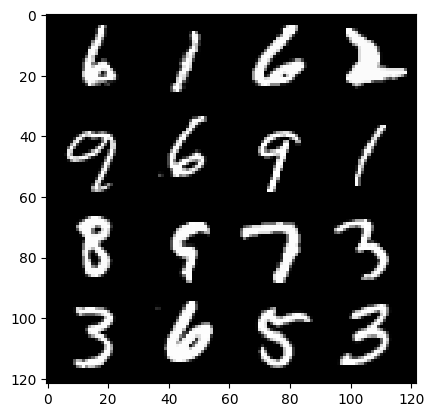

Epoch :105 , Step :55080 , Generator Loss :2.6912659781950503 , Discriminator Loss :0.19384543356244213


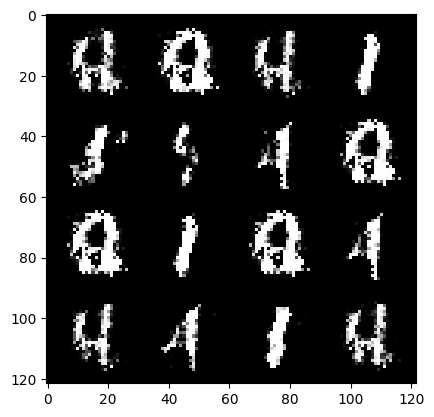

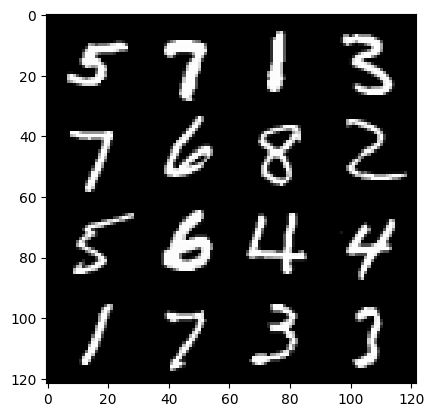

Epoch :105 , Step :55188 , Generator Loss :2.66005927986569 , Discriminator Loss :0.18616468887086268


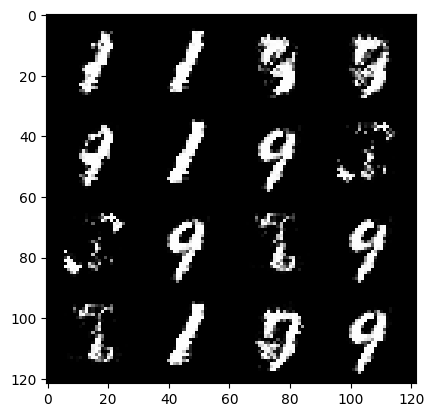

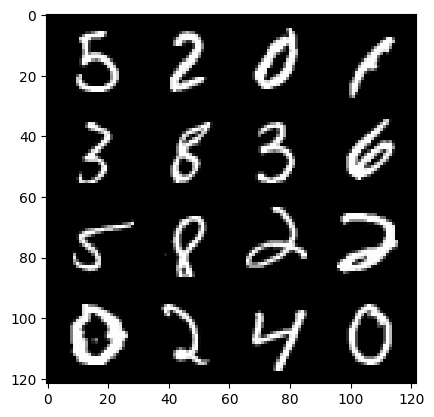

Epoch :105 , Step :55296 , Generator Loss :2.606214024402476 , Discriminator Loss :0.20085338392743357


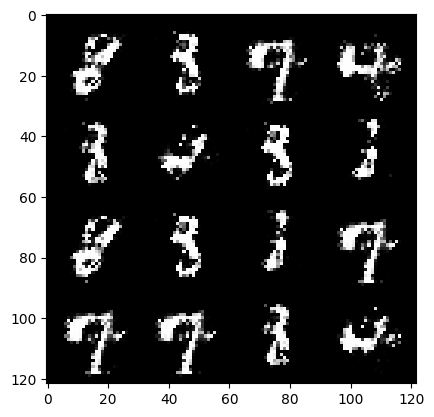

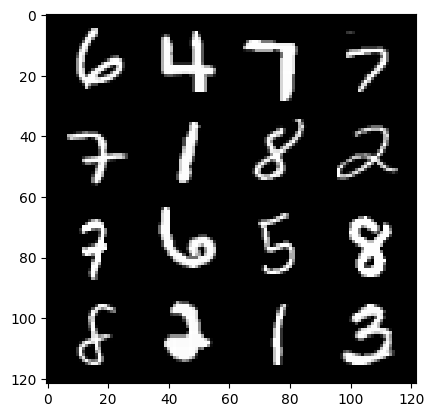

Epoch :105 , Step :55404 , Generator Loss :2.8648239948131424 , Discriminator Loss :0.2038913874162568


  0%|          | 0/469 [00:00<?, ?it/s]

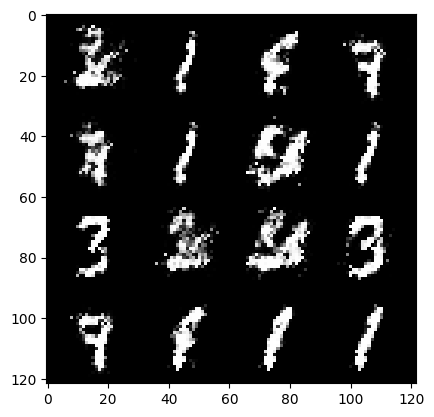

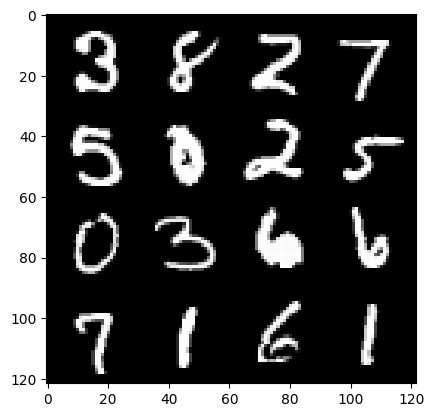

Epoch :106 , Step :55512 , Generator Loss :2.6865730660933025 , Discriminator Loss :0.237421215960273


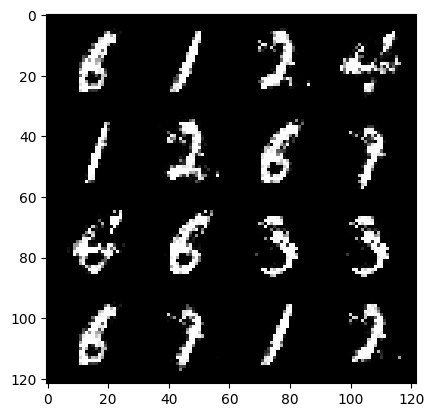

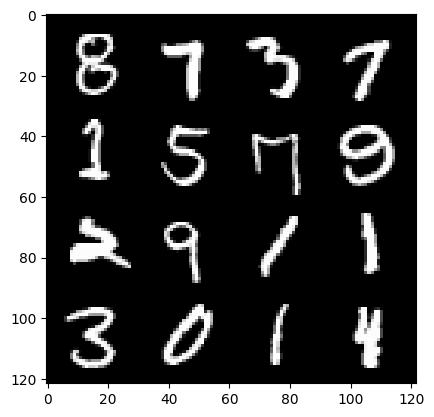

Epoch :106 , Step :55620 , Generator Loss :2.458430914967149 , Discriminator Loss :0.20654802741827794


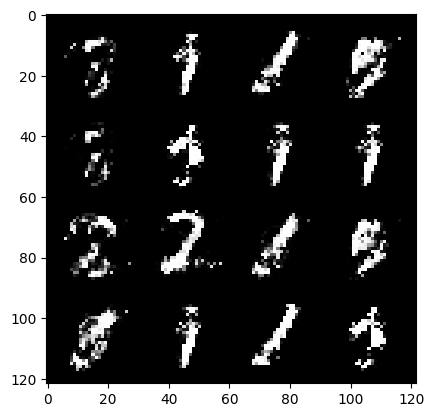

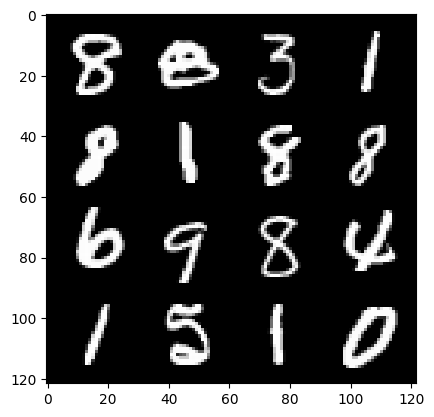

Epoch :106 , Step :55728 , Generator Loss :2.48299330914462 , Discriminator Loss :0.1867837781707446


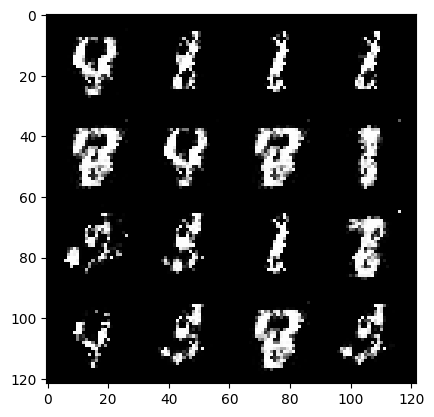

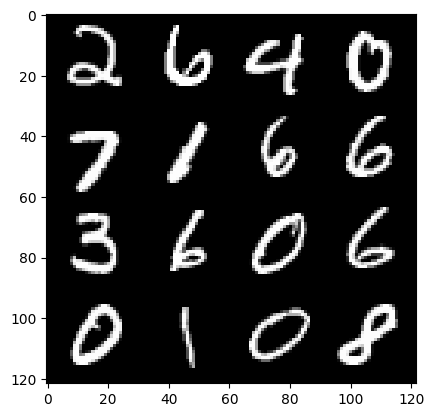

Epoch :106 , Step :55836 , Generator Loss :2.8307333875585483 , Discriminator Loss :0.16622244821930376


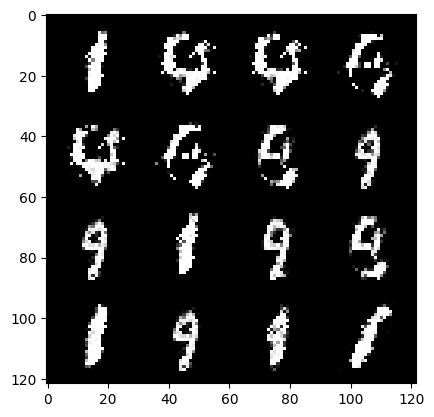

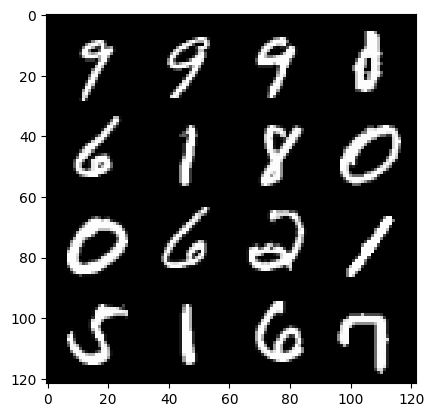

Epoch :106 , Step :55944 , Generator Loss :3.110558119085102 , Discriminator Loss :0.17420882366045765


  0%|          | 0/469 [00:00<?, ?it/s]

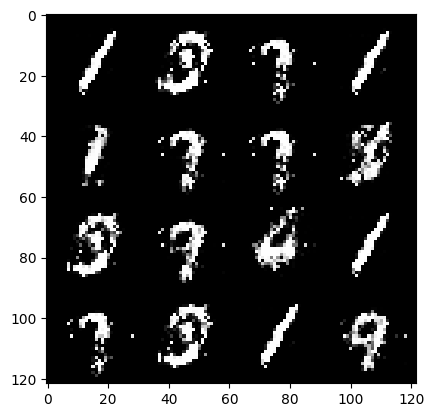

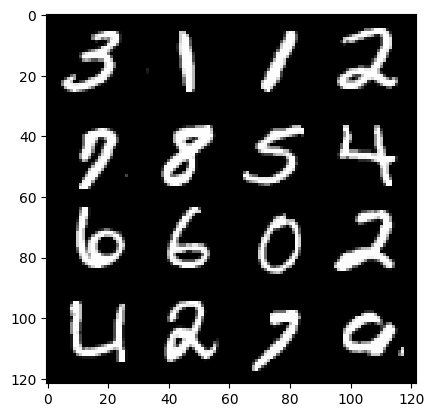

Epoch :107 , Step :56052 , Generator Loss :3.419856665311038 , Discriminator Loss :0.13219710925800934


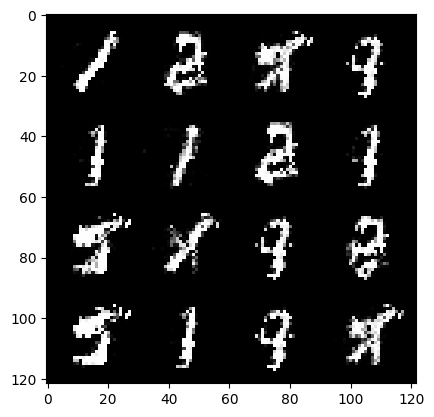

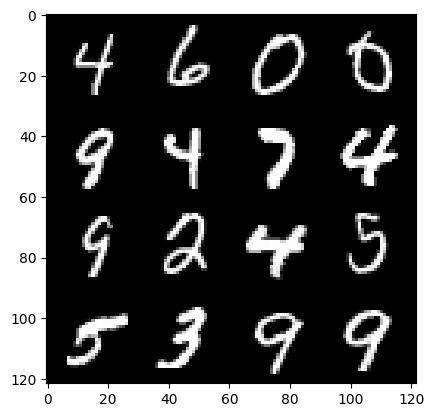

Epoch :107 , Step :56160 , Generator Loss :3.2791483777540686 , Discriminator Loss :0.13283130154013634


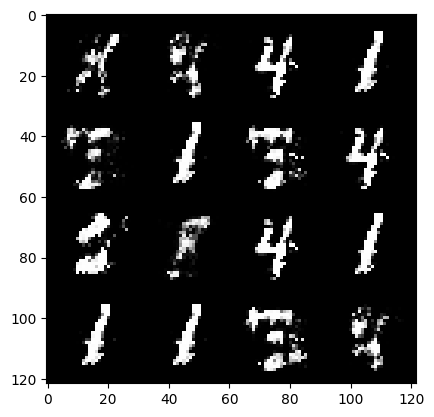

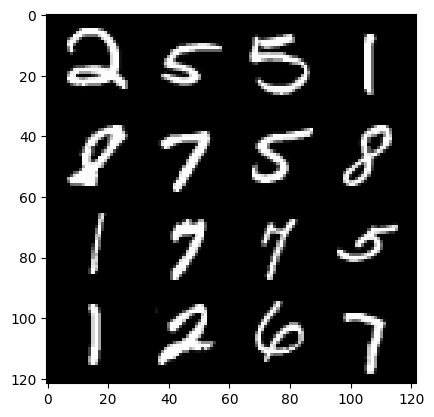

Epoch :107 , Step :56268 , Generator Loss :3.4309904950636407 , Discriminator Loss :0.1273418079233832


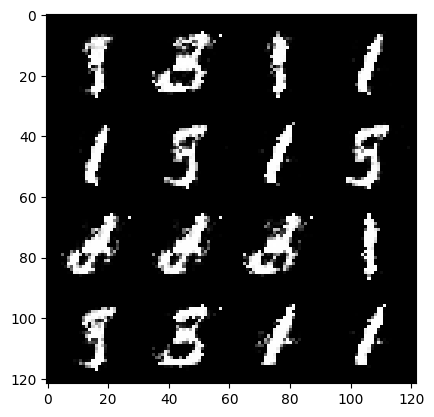

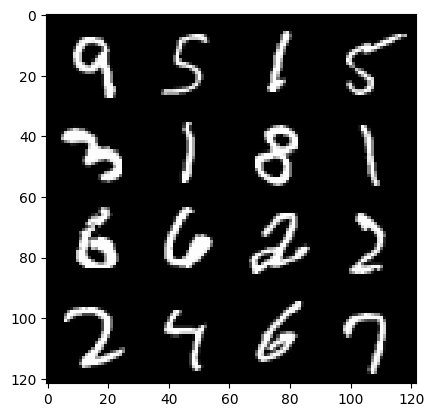

Epoch :107 , Step :56376 , Generator Loss :3.327343247554921 , Discriminator Loss :0.188739703140325


  0%|          | 0/469 [00:00<?, ?it/s]

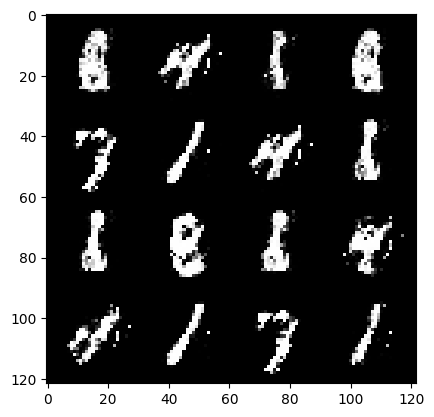

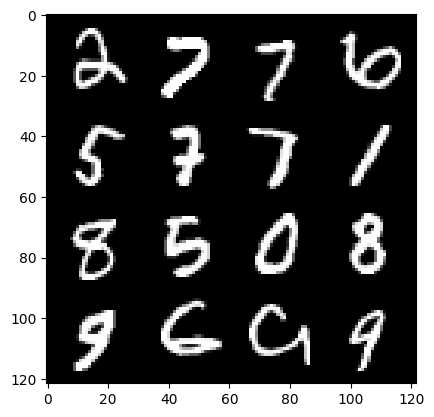

Epoch :108 , Step :56484 , Generator Loss :2.89203859700097 , Discriminator Loss :0.20016658416500802


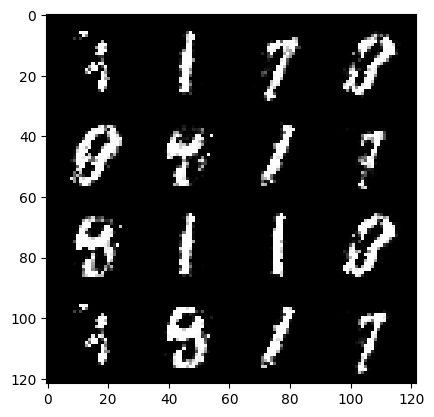

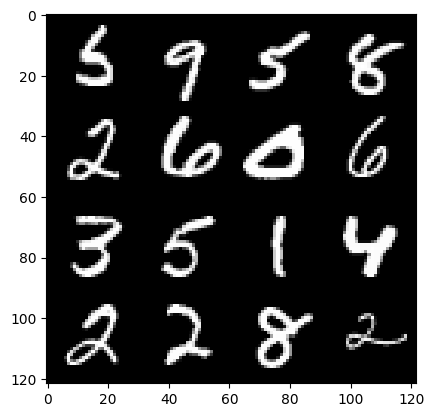

Epoch :108 , Step :56592 , Generator Loss :2.732833873342585 , Discriminator Loss :0.18666408542129725


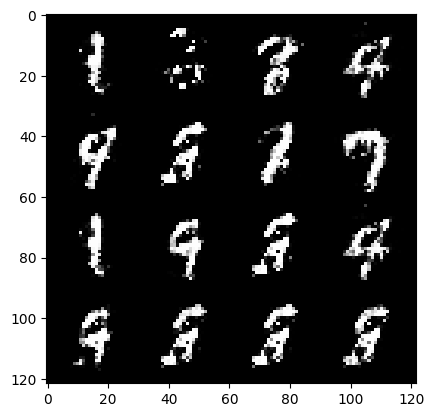

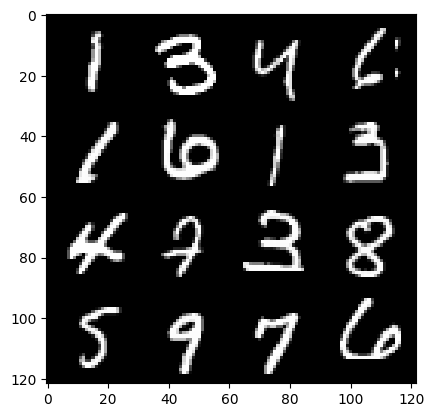

Epoch :108 , Step :56700 , Generator Loss :2.345917356235008 , Discriminator Loss :0.2473411317224855


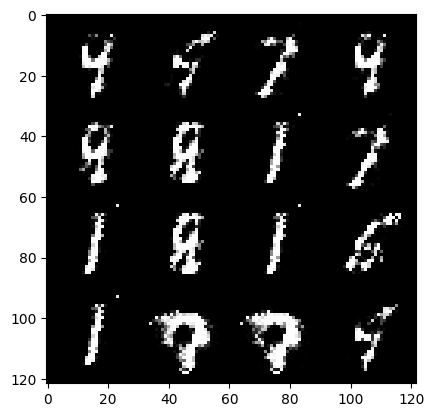

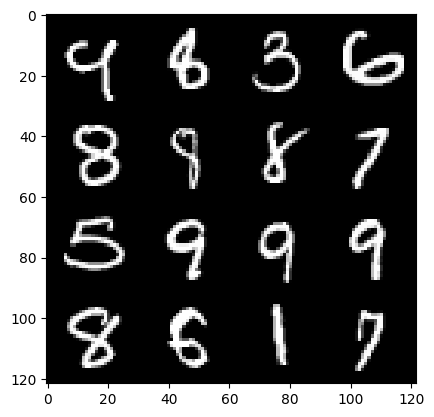

Epoch :108 , Step :56808 , Generator Loss :2.3917413353919974 , Discriminator Loss :0.20776417506513775


  0%|          | 0/469 [00:00<?, ?it/s]

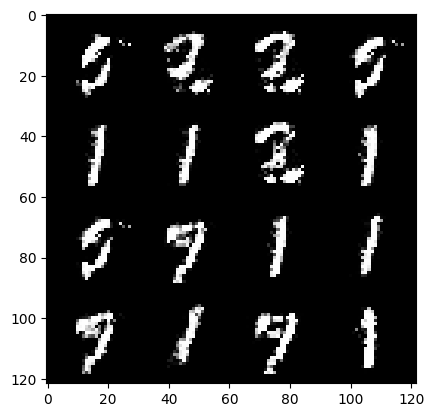

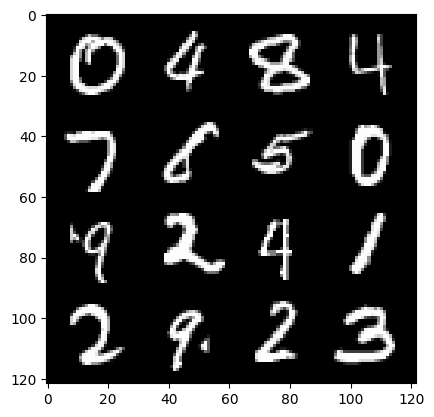

Epoch :109 , Step :56916 , Generator Loss :2.5425644494869095 , Discriminator Loss :0.25846732600971506


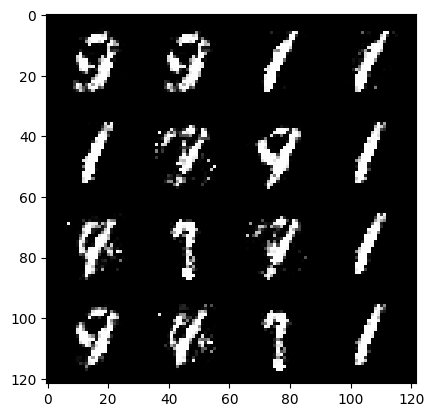

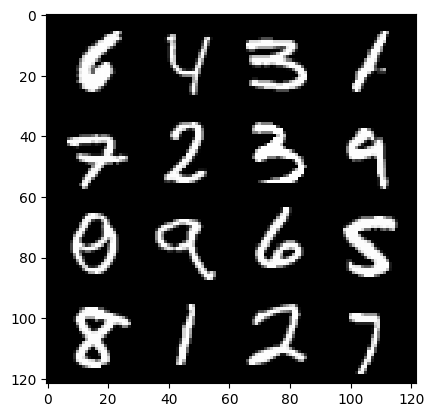

Epoch :109 , Step :57024 , Generator Loss :2.423623349931504 , Discriminator Loss :0.23450775692860282


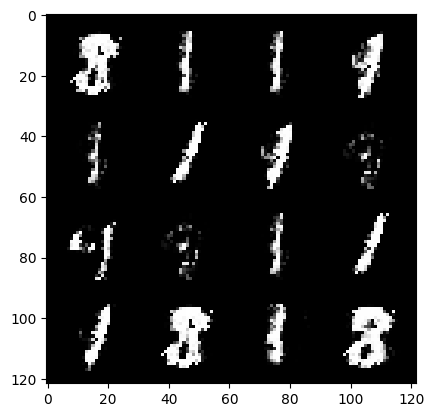

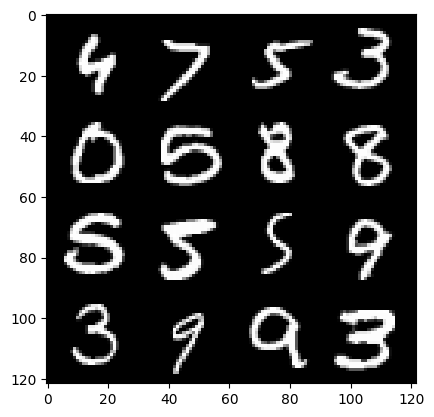

Epoch :109 , Step :57132 , Generator Loss :2.3576110844258906 , Discriminator Loss :0.25763827038032044


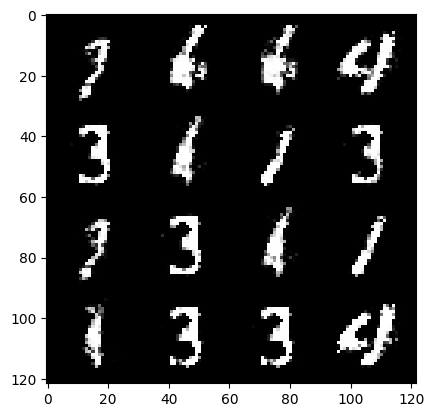

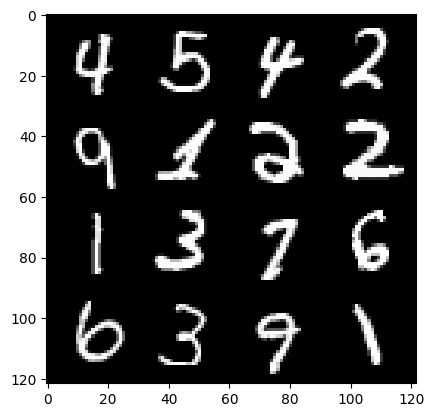

Epoch :109 , Step :57240 , Generator Loss :2.2647969557179346 , Discriminator Loss :0.233014403393975


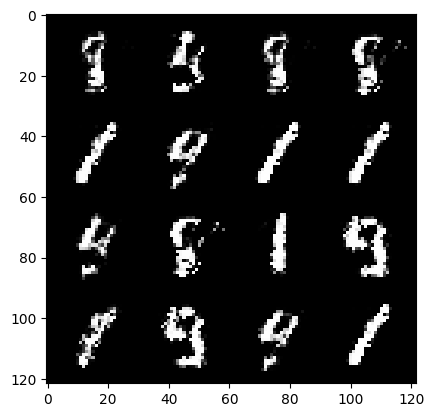

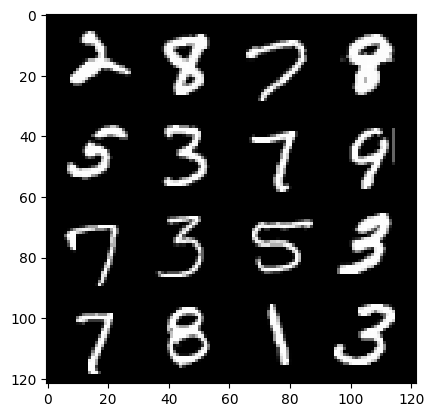

Epoch :109 , Step :57348 , Generator Loss :2.4762606687015953 , Discriminator Loss :0.2202203700111972


  0%|          | 0/469 [00:00<?, ?it/s]

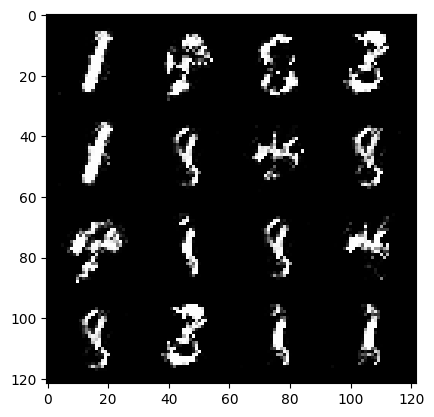

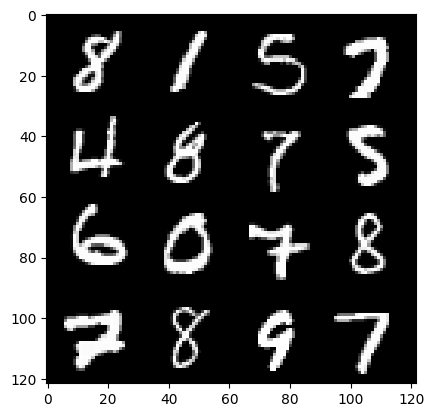

Epoch :110 , Step :57456 , Generator Loss :2.4405439926518335 , Discriminator Loss :0.18525138759502663


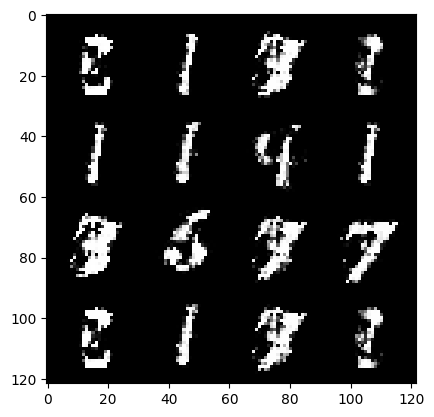

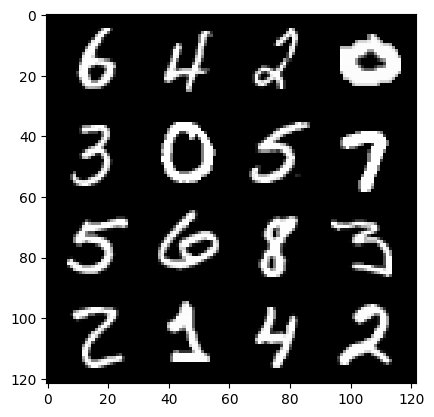

Epoch :110 , Step :57564 , Generator Loss :2.7842373185687603 , Discriminator Loss :0.1996072083021756


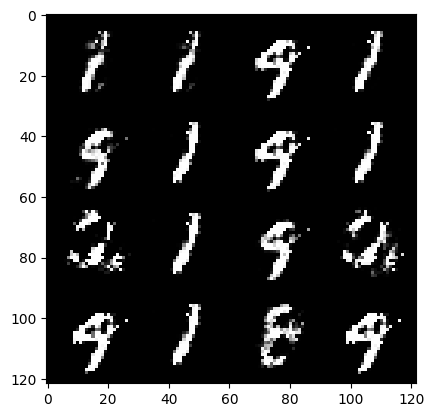

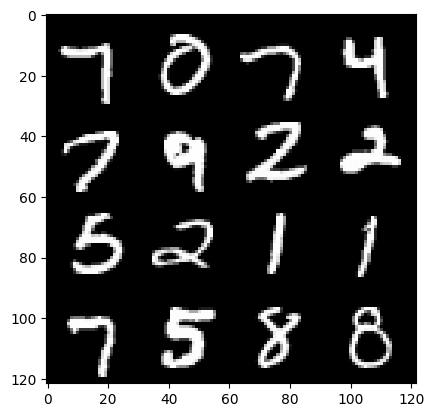

Epoch :110 , Step :57672 , Generator Loss :2.7228330130930303 , Discriminator Loss :0.235618576200472


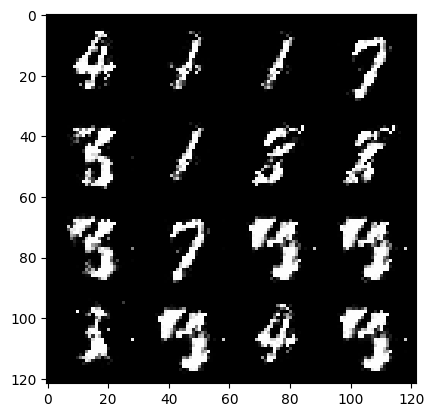

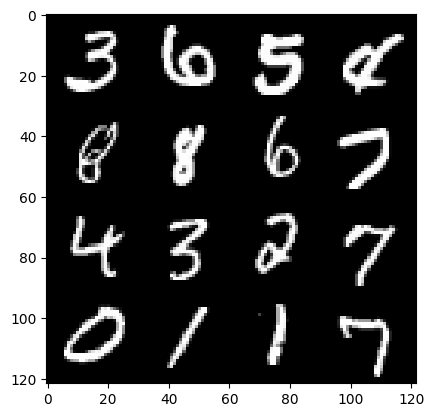

Epoch :110 , Step :57780 , Generator Loss :2.730338531511801 , Discriminator Loss :0.23037010251923853


  0%|          | 0/469 [00:00<?, ?it/s]

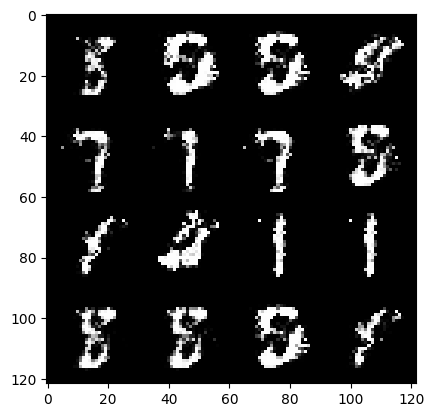

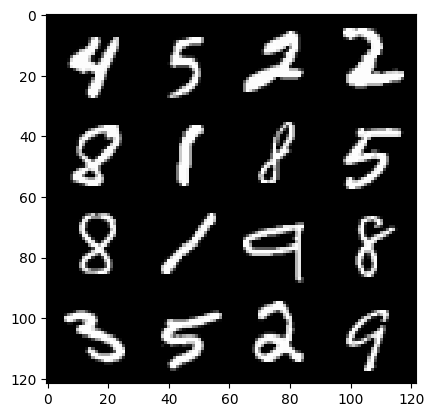

Epoch :111 , Step :57888 , Generator Loss :2.5905664055435755 , Discriminator Loss :0.20314148220199127


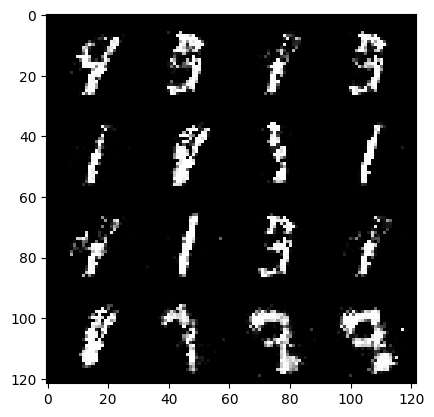

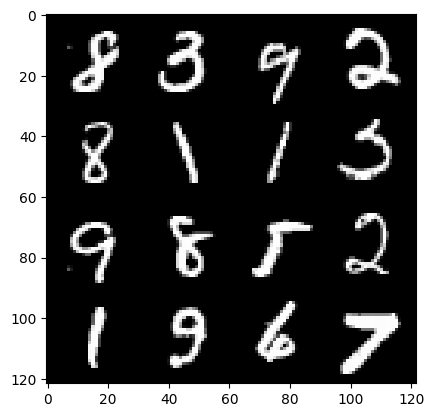

Epoch :111 , Step :57996 , Generator Loss :2.6305140941231344 , Discriminator Loss :0.27800555403033894


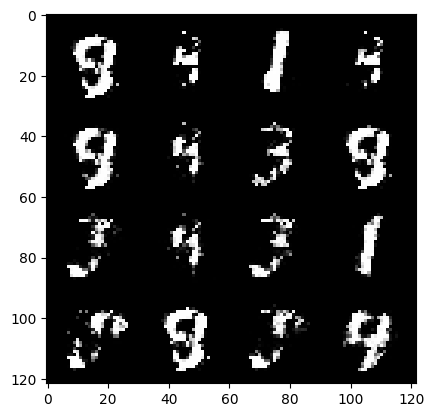

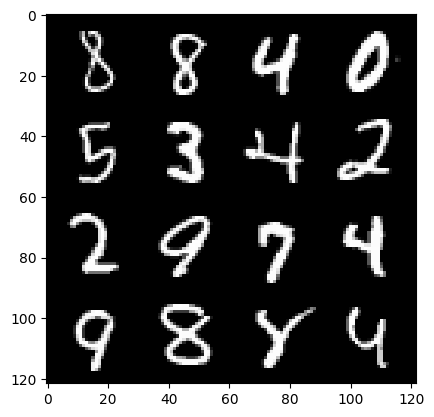

Epoch :111 , Step :58104 , Generator Loss :2.617708301102674 , Discriminator Loss :0.21531015172324805


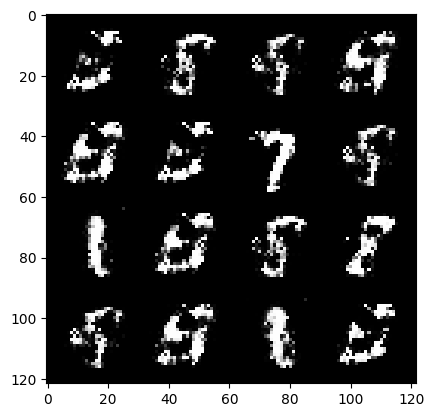

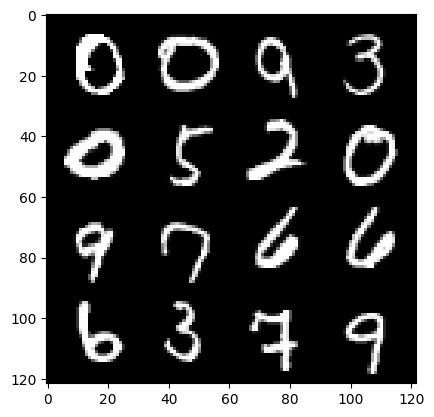

Epoch :111 , Step :58212 , Generator Loss :2.670888576242658 , Discriminator Loss :0.22905847830352966


  0%|          | 0/469 [00:00<?, ?it/s]

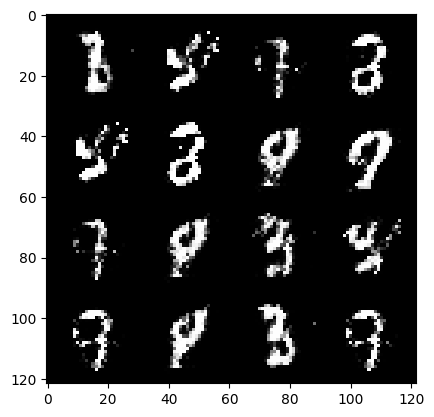

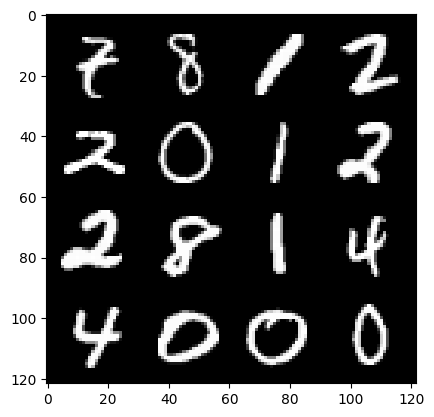

Epoch :112 , Step :58320 , Generator Loss :2.2363848200550787 , Discriminator Loss :0.26901965671115463


In [ ]:
for epoch in range(n_epochs):
  for real,_ in tqdm(data):
    #discriminator
    disc_opt.zero_grad()
    cur_bs = len(real)

    real = real.view(cur_bs , -1)
    real = real.to(device)
    disc_loss = calc_disc_loss(loss,gen,disc,real,cur_bs,z_dim)
    disc_loss.backward(retain_graph = True)
    disc_opt.step()

    ### generator
    gen_opt.zero_grad()
    gen_loss = calc_gen_loss(loss,gen,disc,cur_bs,z_dim)
    gen_loss.backward(retain_graph = True)
    gen_opt.step()

    mean_gen_loss += gen_loss.item() / info_step
    mean_disc_loss += disc_loss.item() / info_step

    if cur_step % info_step == 0 and cur_step > 0:
      noise = genNoise(cur_bs,z_dim)
      fake = gen(noise)
      view(fake)
      view(real)
      print(f"Epoch :{epoch} , Step :{cur_step} , Generator Loss :{mean_gen_loss} , Discriminator Loss :{mean_disc_loss}")
      mean_gen_loss,mean_disc_loss = 0,0
    cur_step += 1

